In [1]:
tracks={}
for no in ['A','B','C','D']:
    tracks[no] = pd.read_csv("dataset/track_" + no + ".csv", parse_dates=["date"])

In [2]:
equipments={}
for no in ['A','B','C','D']:
    equipments[no] = pd.read_csv("dataset/equipment_" + no + ".csv")

In [3]:
import datetime
from tqdm import tqdm
import random
import sys

In [4]:
from sklearn.neighbors import KernelDensity
bandwidth = [0.1, 1, 10, 50, 100]
kernel = ['gaussian', 'tophat', 'epanechnikov', 'exponential', 'linear', 'cosine']
metric = ['minkowski', 'cityblock', 'cosine', 'euclidean', 'l1', 'l2', 'manhattan']
leaf_size = [10, 40, 400, 4000]
kd = KernelDensity(bandwidth=bandwidth[3], kernel=kernel[0], metric=metric[0], leaf_size=leaf_size[1])

In [25]:
def get_day(dates):
    day = [(date - datetime.datetime(2017, 4, 1)).days for date in dates]
    return day

In [5]:
def feature_engineering(df, dmm, mv, admm):
    if dmm:
        df['diff_moving_mean'] = df['高低左'] - df['高低左'].rolling(window=7, min_periods=1, center=True).median()
    if mv:
        df['moving_variance'] = df['高低左'].rolling(window=7, min_periods=1, center=True).kurt()
    if admm:
        df['accumulation_diff_moving_mean'] = np.cumsum(abs(df['高低左'] -
                                                            df['高低左'].rolling(window=15, min_periods=1, center=False).median()))
    return df

In [6]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()

In [7]:
def scaling(df, w1, w2, w3, w4):
    df['day'] = ss.fit_transform(df['day'].astype(float).values.reshape(len(df), 1))
    if w1 != 0:
        df['高低左'] = ss.fit_transform(df['高低左'].values.reshape(len(df), 1))*w1
    if w2 != 0:
        df['diff_moving_mean'] = ss.fit_transform(df['diff_moving_mean'].values.reshape(len(df), 1))*w2
    if w3 != 0:
        df['moving_variance'] = df['moving_variance'].fillna(0) #rollingした高低左が全部同じ値のときはNANになる
        df['moving_variance'] = ss.fit_transform(df['moving_variance'].values.reshape(len(df), 1))*w3
    if w4 != 0:
        df['accumulation_diff_moving_mean'] = ss.fit_transform(df['accumulation_diff_moving_mean'].values.reshape(len(df), 1))*w4
    return df

In [101]:
def kd_outliers1(df):
    df = feature_engineering(df, True, True, True)
    df = scaling(df, 50, 50, 0.5, 50)
    kd.fit(df)
    score_pred = kd.score_samples(df)
    normal_id = df[np.where(score_pred <= np.average(score_pred)*0.999, False, True)].index.values
    return normal_id

In [102]:
def kd_outliers2(df):
    df = feature_engineering(df, True, False, True)
    df = scaling(df, 10, 10, 0, 100)
    kd.fit(df)
    score_pred = kd.score_samples(df)
    normal_id = df[np.where(score_pred <= np.average(score_pred)*0.99996, False, True)].index.values
    return normal_id

In [91]:
from sklearn.neighbors import LocalOutlierFactor
#algorithm = ['auto', 'ball_tree', 'kd_tree', 'brute']
#metric = ['minkowsk', 'cityblock', 'cosine', 'euclidean', 'l1', 'l2', 'manhattan']
#lof = LocalOutlierFactor(n_neighbors=20, contamination=0.5, algorithm=algorithm[0], metric=metric[0])
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.5)

In [106]:
def lof_outliers(df):
    df = feature_engineering(df, True, False, False)
    df = scaling(df, 10, 50, 0, 0)
    normal_id = df[np.where(lof.fit_predict(df) == -1 , False, True)].index.values
    return normal_id

In [88]:
def remove_outliers(raw):
    local_global = [[[], []], [[], []], [[], []], [[], []]]
    local_global[0][1].extend(raw.index.values)
    df1 = raw.copy()
    local_global[1][1].extend(kd_outliers1(df1))

    df2 = raw.loc[local_global[1][1]]
    df2 = df2.reset_index(drop=True)
    local_global[2][0].extend(kd_outliers2(df2))
    local_global[2][1].extend([local_global[1][1][i] for i in local_global[2][0]])

    df3 = raw.loc[local_global[2][1]]
    df3 = df3.reset_index(drop=True)
    local_global[3][0].extend(lof_outliers(df3))
    local_global[3][1].extend([local_global[2][1][i] for i in local_global[3][0]])
    return local_global[3][1]

In [86]:
def flag_outliers(raw):
    local_global = [[[], []], [[], []], [[], []], [[], []]]
    local_global[0][1].extend(raw.index.values)
    df1 = raw.copy()
    local_global[1][1].extend(kd_outliers1(df1))

    df2 = raw.loc[local_global[1][1]]
    df2 = df2.reset_index(drop=True)
    local_global[2][0].extend(kd_outliers2(df2))
    local_global[2][1].extend([local_global[1][1][i] for i in local_global[2][0]])

    df3 = raw.loc[local_global[2][1]]
    df3 = df3.reset_index(drop=True)
    local_global[3][0].extend(lof_outliers(df3))
    local_global[3][1].extend([local_global[2][1][i] for i in local_global[3][0]])

    out1 = set(local_global[0][1]) - set(local_global[1][1])
    out2 = set(local_global[1][1]) - set(local_global[2][1])
    out3 = set(local_global[2][1]) - set(local_global[3][1])
    normal = local_global[3][1]
    return out1, out2, out3, normal

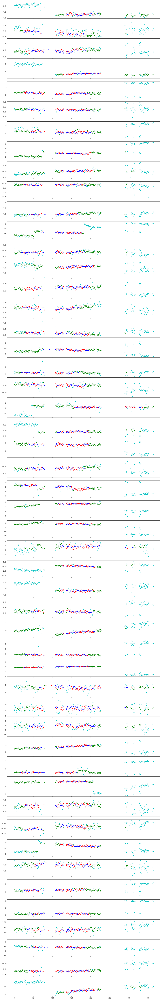

In [108]:
fig, axes = plt.subplots(50, 1, figsize=(15, 100), sharex=True)
random.seed(110)
track = tracks['C']
kilos = track['キロ程'].unique()

for i, kilo in enumerate(random.sample(list(kilos), 50)):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    if len(data) < 20:
        print(i)
        continue
    out1, out2, out3, normal = flag_outliers(data)

    datao1 = data.loc[out1]
    datao2 = data.loc[out2]
    datao3 = data.loc[out3]
    datal = data.loc[normal]

    axes[i].plot(datao1['day'], datao1['高低左'], marker='.', linewidth=0, c='c')
    axes[i].plot(datao2['day'], datao2['高低左'], marker='.', linewidth=0, c='g')
    axes[i].plot(datao3['day'], datao3['高低左'], marker='.', linewidth=0, c='r')
    axes[i].plot(datal['day'], datal['高低左'], marker='.', linewidth=0, c='b')

In [109]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()

In [110]:
def get_slope(day, koutei):
    if len(day) == 0:
        print('!!!!!   no data... why?   !!!!!\n*10')
        return -100
    X = day
    X = [[x] for x in X]
    y = koutei

    lr.fit(X, y)
    slope = lr.coef_[0]

    return slope

In [111]:
import warnings
warnings.filterwarnings(action="ignore", module="scipy", message="^internal gelsd")

In [200]:
%%time
random.seed(0)

for no in tqdm(['A', 'B', 'C', 'D']):
    track = tracks[no]
    equipment = equipments[no]
    track = track.dropna(subset=['高低左'])
    track = track.reset_index(drop=True)

#    kilos = random.sample(list(track['キロ程'].unique()), 100)
#    track = track[track['キロ程'].isin(kilos)]
#    track = track.reset_index(drop=True)
#    equipment = equipment[equipment['キロ程'].isin(kilos)]
#    equipment = equipment.reset_index(drop=True)

    kilos = track['キロ程'].unique()

    slopes = []
    sokuteis = []
    last_medians = []
    num_datas = []
    sigmas = []
    for kilo in tqdm(kilos):
        data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
        data = data.dropna(subset=['高低左'])
        data = data.reset_index(drop=True)
        data['day'] = get_day(data['date'])
        data = data.drop('date', axis=1)
        sokutei = len(data)
        sokuteis.append(sokutei)
        kouteis = data['高低左'].values
        last_median = np.median(kouteis[-30:])
        last_medians.append(last_median)
        sigma = kouteis[-30:].std(ddof=1)
        sigmas.append(sigma)
        if sokutei < 30:
            num_data = -100
            num_datas.append(num_data)
            slope = -100
            slopes.append(slope)
            continue

        normal_id = remove_outliers(data)
        data = data.loc[normal_id]
        data = data.reset_index(drop=True)
        num_data = len(data)
        num_datas.append(num_data)
        if num_data < 10:
            print('!!!   len(data) < 10 after remove_outliers   !!!')
            print(no, kilo)
            slope = -100
            slopes.append(slope)
            continue
        days = data['day']
        kouteis = data['高低左']
        slope = get_slope(days, kouteis)
        slopes.append(slope)

    summary = pd.DataFrame(columns=['路線', 'キロ程', '傾き', '切片', '標本標準偏差', '測定回数', 'データ数'])
    summary['キロ程'] = kilos
    summary['路線'] = no
    summary['切片'] = last_medians
    summary['測定回数'] = sokuteis
    summary['データ数'] = num_datas
    summary['傾き'] = slopes
    summary['標本標準偏差'] = sigmas

    summary = pd.concat([summary, equipment.drop('キロ程', axis=1)], axis=1)
    summary.to_csv(f'summary3_{no}.csv')


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/27612 [00:00<?, ?it/s]

  0%|          | 1/27612 [00:00<48:53,  9.41it/s]

  0%|          | 3/27612 [00:00<46:38,  9.87it/s]

  0%|          | 4/27612 [00:00<47:26,  9.70it/s]

  0%|          | 6/27612 [00:00<47:23,  9.71it/s]

  0%|          | 7/27612 [00:00<47:52,  9.61it/s]

  0%|          | 8/27612 [00:00<53:27,  8.61it/s]

  0%|          | 9/27612 [00:01<54:12,  8.49it/s]

  0%|          | 11/27612 [00:01<52:53,  8.70it/s]

  0%|          | 13/27612 [00:01<49:20,  9.32it/s]

  0%|          | 15/27612 [00:01<47:24,  9.70it/s]

  0%|          | 17/27612 [00:01<45:48, 10.04it/s]

  0%|          | 19/27612 [00:01<45:22, 10.14it/s]

  0%|          | 21/27612 [00:02<47:46,  9.63it/s]

  0%|          | 23/27612 [00:02<49:06,  9.36it/s]

  0%|          | 24/27612 [00:02<49:17,  9.33it/s]

  0%|          | 26/27612 [00:02<47:57,  9.59it/s]

  0%|          | 28/27612 [00:02<47:04,  9.77it/s]

  0%|          | 30/27612 [00:03<46:34, 

  2%|▏         | 516/27612 [00:43<38:24, 11.76it/s]

  2%|▏         | 517/27612 [00:44<38:26, 11.75it/s]

  2%|▏         | 518/27612 [00:44<38:27, 11.74it/s]

  2%|▏         | 519/27612 [00:44<38:28, 11.73it/s]

  2%|▏         | 520/27612 [00:44<38:30, 11.72it/s]

  2%|▏         | 521/27612 [00:44<38:31, 11.72it/s]

  2%|▏         | 522/27612 [00:44<38:32, 11.71it/s]

  2%|▏         | 524/27612 [00:44<38:30, 11.72it/s]

  2%|▏         | 526/27612 [00:44<38:28, 11.74it/s]

  2%|▏         | 528/27612 [00:44<38:27, 11.74it/s]

  2%|▏         | 530/27612 [00:45<38:30, 11.72it/s]

  2%|▏         | 532/27612 [00:45<38:33, 11.71it/s]

  2%|▏         | 534/27612 [00:45<38:35, 11.69it/s]

  2%|▏         | 536/27612 [00:45<38:38, 11.68it/s]

  2%|▏         | 537/27612 [00:46<38:39, 11.67it/s]

  2%|▏         | 538/27612 [00:46<38:41, 11.66it/s]

  2%|▏         | 539/27612 [00:46<38:43, 11.65it/s]

  2%|▏         | 540/27612 [00:46<38:44, 11.64it/s]

  2%|▏         | 541/27612 [00:46<38:47, 11.63

  4%|▎         | 1033/27612 [01:31<39:10, 11.31it/s]

  4%|▎         | 1035/27612 [01:31<39:10, 11.31it/s]

  4%|▍         | 1037/27612 [01:31<39:10, 11.31it/s]

  4%|▍         | 1039/27612 [01:31<39:10, 11.30it/s]

  4%|▍         | 1041/27612 [01:32<39:10, 11.30it/s]

  4%|▍         | 1043/27612 [01:32<39:11, 11.30it/s]

  4%|▍         | 1045/27612 [01:32<39:11, 11.30it/s]

  4%|▍         | 1047/27612 [01:32<39:11, 11.30it/s]

  4%|▍         | 1049/27612 [01:32<39:09, 11.31it/s]

  4%|▍         | 1051/27612 [01:32<39:07, 11.31it/s]

  4%|▍         | 1053/27612 [01:33<39:08, 11.31it/s]

  4%|▍         | 1055/27612 [01:33<39:08, 11.31it/s]

  4%|▍         | 1057/27612 [01:33<39:09, 11.30it/s]

  4%|▍         | 1059/27612 [01:33<39:09, 11.30it/s]

  4%|▍         | 1061/27612 [01:33<39:09, 11.30it/s]

  4%|▍         | 1063/27612 [01:34<39:10, 11.30it/s]

  4%|▍         | 1065/27612 [01:34<39:10, 11.30it/s]

  4%|▍         | 1067/27612 [01:34<39:10, 11.29it/s]

  4%|▍         | 1069/27612 

  6%|▌         | 1576/27612 [02:19<38:16, 11.34it/s]

  6%|▌         | 1578/27612 [02:19<38:17, 11.33it/s]

  6%|▌         | 1580/27612 [02:19<38:17, 11.33it/s]

  6%|▌         | 1582/27612 [02:19<38:17, 11.33it/s]

  6%|▌         | 1584/27612 [02:19<38:17, 11.33it/s]

  6%|▌         | 1586/27612 [02:19<38:17, 11.33it/s]

  6%|▌         | 1588/27612 [02:20<38:18, 11.32it/s]

  6%|▌         | 1590/27612 [02:20<38:18, 11.32it/s]

  6%|▌         | 1592/27612 [02:20<38:18, 11.32it/s]

  6%|▌         | 1594/27612 [02:20<38:16, 11.33it/s]

  6%|▌         | 1596/27612 [02:20<38:15, 11.33it/s]

  6%|▌         | 1598/27612 [02:20<38:14, 11.34it/s]

  6%|▌         | 1600/27612 [02:21<38:14, 11.34it/s]

  6%|▌         | 1602/27612 [02:21<38:15, 11.33it/s]

  6%|▌         | 1604/27612 [02:21<38:15, 11.33it/s]

  6%|▌         | 1606/27612 [02:21<38:15, 11.33it/s]

  6%|▌         | 1608/27612 [02:21<38:15, 11.33it/s]

  6%|▌         | 1610/27612 [02:22<38:15, 11.33it/s]

  6%|▌         | 1612/27612 

  8%|▊         | 2116/27612 [03:06<37:31, 11.33it/s]

  8%|▊         | 2118/27612 [03:06<37:30, 11.33it/s]

  8%|▊         | 2120/27612 [03:07<37:30, 11.33it/s]

  8%|▊         | 2122/27612 [03:07<37:31, 11.32it/s]

  8%|▊         | 2124/27612 [03:07<37:31, 11.32it/s]

  8%|▊         | 2126/27612 [03:07<37:31, 11.32it/s]

  8%|▊         | 2128/27612 [03:07<37:31, 11.32it/s]

  8%|▊         | 2130/27612 [03:08<37:31, 11.32it/s]

  8%|▊         | 2132/27612 [03:08<37:31, 11.32it/s]

  8%|▊         | 2134/27612 [03:08<37:31, 11.32it/s]

  8%|▊         | 2136/27612 [03:08<37:30, 11.32it/s]

  8%|▊         | 2138/27612 [03:08<37:29, 11.33it/s]

  8%|▊         | 2140/27612 [03:08<37:28, 11.33it/s]

  8%|▊         | 2142/27612 [03:09<37:28, 11.33it/s]

  8%|▊         | 2144/27612 [03:09<37:28, 11.33it/s]

  8%|▊         | 2146/27612 [03:09<37:28, 11.33it/s]

  8%|▊         | 2148/27612 [03:09<37:28, 11.33it/s]

  8%|▊         | 2150/27612 [03:09<37:28, 11.33it/s]

  8%|▊         | 2152/27612 

!!!   len(data) < 10 after remove_outliers   !!!
A 12565




  9%|▉         | 2472/27612 [03:38<36:58, 11.33it/s]

  9%|▉         | 2474/27612 [03:38<36:58, 11.33it/s]

  9%|▉         | 2476/27612 [03:38<36:58, 11.33it/s]

  9%|▉         | 2478/27612 [03:38<36:57, 11.33it/s]

  9%|▉         | 2480/27612 [03:38<36:56, 11.34it/s]

  9%|▉         | 2482/27612 [03:38<36:55, 11.34it/s]

  9%|▉         | 2484/27612 [03:39<36:55, 11.34it/s]

  9%|▉         | 2486/27612 [03:39<36:55, 11.34it/s]

  9%|▉         | 2488/27612 [03:39<36:56, 11.34it/s]

  9%|▉         | 2490/27612 [03:39<36:55, 11.34it/s]

  9%|▉         | 2492/27612 [03:39<36:55, 11.34it/s]

  9%|▉         | 2494/27612 [03:40<36:55, 11.34it/s]

  9%|▉         | 2496/27612 [03:40<36:55, 11.34it/s]

  9%|▉         | 2498/27612 [03:40<36:55, 11.33it/s]

  9%|▉         | 2500/27612 [03:40<36:55, 11.33it/s]

  9%|▉         | 2502/27612 [03:40<36:54, 11.34it/s]

  9%|▉         | 2504/27612 [03:40<36:53, 11.34it/s]

  9%|▉         | 2506/27612 [03:40<36:53, 11.34it/s]

  9%|▉         | 2508/2761

 11%|█         | 3011/27612 [04:25<36:09, 11.34it/s]

 11%|█         | 3013/27612 [04:25<36:09, 11.34it/s]

 11%|█         | 3015/27612 [04:25<36:09, 11.34it/s]

 11%|█         | 3017/27612 [04:26<36:09, 11.34it/s]

 11%|█         | 3019/27612 [04:26<36:09, 11.33it/s]

 11%|█         | 3021/27612 [04:26<36:09, 11.33it/s]

 11%|█         | 3023/27612 [04:26<36:09, 11.34it/s]

 11%|█         | 3025/27612 [04:26<36:08, 11.34it/s]

 11%|█         | 3027/27612 [04:26<36:07, 11.34it/s]

 11%|█         | 3029/27612 [04:27<36:07, 11.34it/s]

 11%|█         | 3031/27612 [04:27<36:07, 11.34it/s]

 11%|█         | 3033/27612 [04:27<36:07, 11.34it/s]

 11%|█         | 3035/27612 [04:27<36:07, 11.34it/s]

 11%|█         | 3037/27612 [04:27<36:07, 11.34it/s]

 11%|█         | 3039/27612 [04:28<36:07, 11.34it/s]

 11%|█         | 3041/27612 [04:28<36:07, 11.34it/s]

 11%|█         | 3043/27612 [04:28<36:07, 11.33it/s]

 11%|█         | 3045/27612 [04:28<36:07, 11.33it/s]

 11%|█         | 3047/27612 

 13%|█▎        | 3534/27612 [05:13<35:35, 11.27it/s]

 13%|█▎        | 3536/27612 [05:13<35:35, 11.27it/s]

 13%|█▎        | 3538/27612 [05:13<35:36, 11.27it/s]

 13%|█▎        | 3540/27612 [05:14<35:35, 11.27it/s]

 13%|█▎        | 3542/27612 [05:14<35:36, 11.27it/s]

 13%|█▎        | 3543/27612 [05:14<35:36, 11.27it/s]

 13%|█▎        | 3545/27612 [05:14<35:35, 11.27it/s]

 13%|█▎        | 3547/27612 [05:14<35:35, 11.27it/s]

 13%|█▎        | 3549/27612 [05:14<35:34, 11.27it/s]

 13%|█▎        | 3551/27612 [05:14<35:34, 11.27it/s]

 13%|█▎        | 3553/27612 [05:15<35:34, 11.27it/s]

 13%|█▎        | 3555/27612 [05:15<35:34, 11.27it/s]

 13%|█▎        | 3557/27612 [05:15<35:34, 11.27it/s]

 13%|█▎        | 3559/27612 [05:15<35:35, 11.27it/s]

 13%|█▎        | 3561/27612 [05:16<35:34, 11.27it/s]

 13%|█▎        | 3563/27612 [05:16<35:34, 11.26it/s]

 13%|█▎        | 3565/27612 [05:16<35:35, 11.26it/s]

 13%|█▎        | 3567/27612 [05:16<35:34, 11.26it/s]

 13%|█▎        | 3569/27612 

 15%|█▍        | 4112/27612 [05:59<34:12, 11.45it/s]

 15%|█▍        | 4115/27612 [05:59<34:11, 11.46it/s]

 15%|█▍        | 4118/27612 [05:59<34:10, 11.46it/s]

 15%|█▍        | 4121/27612 [05:59<34:09, 11.46it/s]

 15%|█▍        | 4124/27612 [05:59<34:08, 11.47it/s]

 15%|█▍        | 4127/27612 [05:59<34:07, 11.47it/s]

 15%|█▍        | 4130/27612 [05:59<34:05, 11.48it/s]

 15%|█▍        | 4133/27612 [05:59<34:04, 11.48it/s]

 15%|█▍        | 4136/27612 [06:00<34:03, 11.49it/s]

 15%|█▍        | 4139/27612 [06:00<34:02, 11.49it/s]

 15%|█▌        | 4142/27612 [06:00<34:01, 11.49it/s]

 15%|█▌        | 4145/27612 [06:00<34:00, 11.50it/s]

 15%|█▌        | 4148/27612 [06:00<33:59, 11.50it/s]

 15%|█▌        | 4151/27612 [06:00<33:58, 11.51it/s]

 15%|█▌        | 4154/27612 [06:00<33:57, 11.51it/s]

 15%|█▌        | 4157/27612 [06:00<33:56, 11.52it/s]

 15%|█▌        | 4160/27612 [06:01<33:55, 11.52it/s]

 15%|█▌        | 4163/27612 [06:01<33:54, 11.52it/s]

 15%|█▌        | 4166/27612 

 18%|█▊        | 4920/27612 [06:33<30:14, 12.51it/s]

 18%|█▊        | 4922/27612 [06:33<30:13, 12.51it/s]

 18%|█▊        | 4924/27612 [06:33<30:13, 12.51it/s]

 18%|█▊        | 4926/27612 [06:33<30:13, 12.51it/s]

 18%|█▊        | 4928/27612 [06:33<30:13, 12.51it/s]

 18%|█▊        | 4930/27612 [06:33<30:12, 12.51it/s]

 18%|█▊        | 4932/27612 [06:34<30:12, 12.51it/s]

 18%|█▊        | 4934/27612 [06:34<30:12, 12.51it/s]

 18%|█▊        | 4936/27612 [06:34<30:12, 12.51it/s]

 18%|█▊        | 4939/27612 [06:34<30:11, 12.52it/s]

 18%|█▊        | 4942/27612 [06:34<30:10, 12.52it/s]

 18%|█▊        | 4945/27612 [06:34<30:09, 12.52it/s]

 18%|█▊        | 4948/27612 [06:34<30:09, 12.53it/s]

 18%|█▊        | 4951/27612 [06:35<30:08, 12.53it/s]

 18%|█▊        | 4954/27612 [06:35<30:08, 12.53it/s]

 18%|█▊        | 4956/27612 [06:35<30:07, 12.53it/s]

 18%|█▊        | 4959/27612 [06:35<30:06, 12.54it/s]

 18%|█▊        | 4962/27612 [06:35<30:06, 12.54it/s]

 18%|█▊        | 4965/27612 

 21%|██        | 5727/27612 [07:08<27:15, 13.38it/s]

 21%|██        | 5730/27612 [07:08<27:15, 13.38it/s]

 21%|██        | 5733/27612 [07:08<27:14, 13.39it/s]

 21%|██        | 5736/27612 [07:08<27:13, 13.39it/s]

 21%|██        | 5739/27612 [07:08<27:13, 13.39it/s]

 21%|██        | 5742/27612 [07:08<27:12, 13.39it/s]

 21%|██        | 5745/27612 [07:08<27:12, 13.40it/s]

 21%|██        | 5748/27612 [07:08<27:11, 13.40it/s]

 21%|██        | 5751/27612 [07:09<27:10, 13.40it/s]

 21%|██        | 5754/27612 [07:09<27:10, 13.41it/s]

 21%|██        | 5757/27612 [07:09<27:09, 13.41it/s]

 21%|██        | 5760/27612 [07:09<27:09, 13.41it/s]

 21%|██        | 5763/27612 [07:09<27:08, 13.42it/s]

 21%|██        | 5766/27612 [07:09<27:08, 13.42it/s]

 21%|██        | 5769/27612 [07:09<27:07, 13.42it/s]

 21%|██        | 5772/27612 [07:09<27:06, 13.42it/s]

 21%|██        | 5775/27612 [07:10<27:06, 13.43it/s]

 21%|██        | 5778/27612 [07:10<27:05, 13.43it/s]

 21%|██        | 5781/27612 

 24%|██▎       | 6556/27612 [07:41<24:43, 14.19it/s]

 24%|██▍       | 6559/27612 [07:42<24:43, 14.19it/s]

 24%|██▍       | 6562/27612 [07:42<24:42, 14.20it/s]

 24%|██▍       | 6565/27612 [07:42<24:42, 14.20it/s]

 24%|██▍       | 6568/27612 [07:42<24:41, 14.20it/s]

 24%|██▍       | 6571/27612 [07:42<24:41, 14.20it/s]

 24%|██▍       | 6574/27612 [07:42<24:40, 14.21it/s]

 24%|██▍       | 6577/27612 [07:42<24:40, 14.21it/s]

 24%|██▍       | 6580/27612 [07:43<24:39, 14.21it/s]

 24%|██▍       | 6583/27612 [07:43<24:39, 14.21it/s]

 24%|██▍       | 6586/27612 [07:43<24:38, 14.22it/s]

 24%|██▍       | 6589/27612 [07:43<24:38, 14.22it/s]

 24%|██▍       | 6592/27612 [07:43<24:38, 14.22it/s]

 24%|██▍       | 6595/27612 [07:43<24:37, 14.22it/s]

 24%|██▍       | 6598/27612 [07:43<24:37, 14.23it/s]

 24%|██▍       | 6601/27612 [07:43<24:36, 14.23it/s]

 24%|██▍       | 6604/27612 [07:44<24:36, 14.23it/s]

 24%|██▍       | 6607/27612 [07:44<24:35, 14.23it/s]

 24%|██▍       | 6610/27612 

 27%|██▋       | 7372/27612 [08:16<22:42, 14.85it/s]

 27%|██▋       | 7375/27612 [08:16<22:42, 14.85it/s]

 27%|██▋       | 7378/27612 [08:16<22:42, 14.86it/s]

 27%|██▋       | 7381/27612 [08:16<22:41, 14.86it/s]

 27%|██▋       | 7384/27612 [08:16<22:41, 14.86it/s]

 27%|██▋       | 7387/27612 [08:17<22:40, 14.86it/s]

 27%|██▋       | 7390/27612 [08:17<22:40, 14.86it/s]

 27%|██▋       | 7393/27612 [08:17<22:40, 14.87it/s]

 27%|██▋       | 7396/27612 [08:17<22:39, 14.87it/s]

 27%|██▋       | 7399/27612 [08:17<22:39, 14.87it/s]

 27%|██▋       | 7402/27612 [08:17<22:38, 14.87it/s]

 27%|██▋       | 7405/27612 [08:17<22:38, 14.88it/s]

 27%|██▋       | 7408/27612 [08:17<22:37, 14.88it/s]

 27%|██▋       | 7411/27612 [08:18<22:37, 14.88it/s]

 27%|██▋       | 7414/27612 [08:18<22:37, 14.88it/s]

 27%|██▋       | 7417/27612 [08:18<22:36, 14.88it/s]

 27%|██▋       | 7420/27612 [08:18<22:36, 14.89it/s]

 27%|██▋       | 7423/27612 [08:18<22:35, 14.89it/s]

 27%|██▋       | 7426/27612 

 30%|██▉       | 8181/27612 [08:51<21:01, 15.40it/s]

 30%|██▉       | 8184/27612 [08:51<21:01, 15.41it/s]

 30%|██▉       | 8187/27612 [08:51<21:00, 15.41it/s]

 30%|██▉       | 8190/27612 [08:51<21:00, 15.41it/s]

 30%|██▉       | 8193/27612 [08:51<21:00, 15.41it/s]

 30%|██▉       | 8196/27612 [08:51<20:59, 15.41it/s]

 30%|██▉       | 8199/27612 [08:51<20:59, 15.42it/s]

 30%|██▉       | 8202/27612 [08:52<20:58, 15.42it/s]

 30%|██▉       | 8205/27612 [08:52<20:58, 15.42it/s]

 30%|██▉       | 8208/27612 [08:52<20:58, 15.42it/s]

 30%|██▉       | 8211/27612 [08:52<20:57, 15.42it/s]

 30%|██▉       | 8214/27612 [08:52<20:57, 15.42it/s]

 30%|██▉       | 8217/27612 [08:52<20:57, 15.43it/s]

 30%|██▉       | 8220/27612 [08:52<20:56, 15.43it/s]

 30%|██▉       | 8223/27612 [08:52<20:56, 15.43it/s]

 30%|██▉       | 8226/27612 [08:53<20:56, 15.43it/s]

 30%|██▉       | 8229/27612 [08:53<20:55, 15.43it/s]

 30%|██▉       | 8232/27612 [08:53<20:55, 15.44it/s]

 30%|██▉       | 8235/27612 

 33%|███▎      | 8997/27612 [09:26<19:31, 15.88it/s]

 33%|███▎      | 9000/27612 [09:26<19:31, 15.88it/s]

 33%|███▎      | 9003/27612 [09:26<19:31, 15.89it/s]

 33%|███▎      | 9006/27612 [09:26<19:31, 15.89it/s]

 33%|███▎      | 9009/27612 [09:26<19:30, 15.89it/s]

 33%|███▎      | 9012/27612 [09:27<19:30, 15.89it/s]

 33%|███▎      | 9015/27612 [09:27<19:30, 15.89it/s]

 33%|███▎      | 9018/27612 [09:27<19:29, 15.90it/s]

 33%|███▎      | 9021/27612 [09:27<19:29, 15.90it/s]

 33%|███▎      | 9024/27612 [09:27<19:29, 15.90it/s]

 33%|███▎      | 9027/27612 [09:27<19:28, 15.90it/s]

 33%|███▎      | 9030/27612 [09:27<19:28, 15.90it/s]

 33%|███▎      | 9033/27612 [09:27<19:28, 15.90it/s]

 33%|███▎      | 9036/27612 [09:28<19:27, 15.91it/s]

 33%|███▎      | 9039/27612 [09:28<19:27, 15.91it/s]

 33%|███▎      | 9042/27612 [09:28<19:27, 15.91it/s]

 33%|███▎      | 9045/27612 [09:28<19:26, 15.91it/s]

 33%|███▎      | 9048/27612 [09:28<19:26, 15.91it/s]

 33%|███▎      | 9051/27612 

 36%|███▌      | 9813/27612 [10:01<18:10, 16.32it/s]

 36%|███▌      | 9816/27612 [10:01<18:10, 16.32it/s]

 36%|███▌      | 9819/27612 [10:01<18:09, 16.32it/s]

 36%|███▌      | 9822/27612 [10:01<18:09, 16.33it/s]

 36%|███▌      | 9825/27612 [10:01<18:09, 16.33it/s]

 36%|███▌      | 9828/27612 [10:01<18:09, 16.33it/s]

 36%|███▌      | 9831/27612 [10:02<18:08, 16.33it/s]

 36%|███▌      | 9834/27612 [10:02<18:08, 16.33it/s]

 36%|███▌      | 9837/27612 [10:02<18:08, 16.33it/s]

 36%|███▌      | 9840/27612 [10:02<18:08, 16.33it/s]

 36%|███▌      | 9843/27612 [10:02<18:07, 16.33it/s]

 36%|███▌      | 9846/27612 [10:02<18:07, 16.33it/s]

 36%|███▌      | 9849/27612 [10:02<18:07, 16.34it/s]

 36%|███▌      | 9852/27612 [10:03<18:07, 16.34it/s]

 36%|███▌      | 9855/27612 [10:03<18:06, 16.34it/s]

 36%|███▌      | 9858/27612 [10:03<18:06, 16.34it/s]

 36%|███▌      | 9861/27612 [10:03<18:06, 16.34it/s]

 36%|███▌      | 9864/27612 [10:03<18:05, 16.34it/s]

 36%|███▌      | 9867/27612 

 38%|███▊      | 10617/27612 [10:36<16:58, 16.68it/s]

 38%|███▊      | 10620/27612 [10:36<16:58, 16.69it/s]

 38%|███▊      | 10623/27612 [10:36<16:58, 16.69it/s]

 38%|███▊      | 10626/27612 [10:36<16:57, 16.69it/s]

 38%|███▊      | 10629/27612 [10:36<16:57, 16.69it/s]

 39%|███▊      | 10632/27612 [10:36<16:57, 16.69it/s]

 39%|███▊      | 10635/27612 [10:37<16:57, 16.69it/s]

 39%|███▊      | 10638/27612 [10:37<16:56, 16.69it/s]

 39%|███▊      | 10641/27612 [10:37<16:56, 16.69it/s]

 39%|███▊      | 10644/27612 [10:37<16:56, 16.70it/s]

 39%|███▊      | 10647/27612 [10:37<16:56, 16.70it/s]

 39%|███▊      | 10650/27612 [10:37<16:55, 16.70it/s]

 39%|███▊      | 10653/27612 [10:37<16:55, 16.70it/s]

 39%|███▊      | 10656/27612 [10:38<16:55, 16.70it/s]

 39%|███▊      | 10659/27612 [10:38<16:54, 16.70it/s]

 39%|███▊      | 10662/27612 [10:38<16:54, 16.70it/s]

 39%|███▊      | 10665/27612 [10:38<16:54, 16.71it/s]

 39%|███▊      | 10668/27612 [10:38<16:54, 16.71it/s]

 39%|███▊ 

 41%|████▏     | 11421/27612 [11:10<15:51, 17.02it/s]

 41%|████▏     | 11424/27612 [11:11<15:50, 17.02it/s]

 41%|████▏     | 11427/27612 [11:11<15:50, 17.03it/s]

 41%|████▏     | 11430/27612 [11:11<15:50, 17.03it/s]

 41%|████▏     | 11433/27612 [11:11<15:50, 17.03it/s]

 41%|████▏     | 11436/27612 [11:11<15:49, 17.03it/s]

 41%|████▏     | 11439/27612 [11:11<15:49, 17.03it/s]

 41%|████▏     | 11442/27612 [11:11<15:49, 17.03it/s]

 41%|████▏     | 11445/27612 [11:11<15:49, 17.03it/s]

 41%|████▏     | 11448/27612 [11:12<15:48, 17.03it/s]

 41%|████▏     | 11451/27612 [11:12<15:48, 17.04it/s]

 41%|████▏     | 11454/27612 [11:12<15:48, 17.04it/s]

 41%|████▏     | 11457/27612 [11:12<15:48, 17.04it/s]

 42%|████▏     | 11460/27612 [11:12<15:47, 17.04it/s]

 42%|████▏     | 11463/27612 [11:12<15:47, 17.04it/s]

 42%|████▏     | 11466/27612 [11:12<15:47, 17.04it/s]

 42%|████▏     | 11469/27612 [11:12<15:47, 17.04it/s]

 42%|████▏     | 11472/27612 [11:13<15:46, 17.04it/s]

 42%|████▏

 44%|████▍     | 12230/27612 [11:44<14:45, 17.36it/s]

 44%|████▍     | 12234/27612 [11:44<14:45, 17.37it/s]

 44%|████▍     | 12237/27612 [11:44<14:45, 17.37it/s]

 44%|████▍     | 12240/27612 [11:44<14:45, 17.37it/s]

 44%|████▍     | 12243/27612 [11:44<14:44, 17.37it/s]

 44%|████▍     | 12246/27612 [11:44<14:44, 17.37it/s]

 44%|████▍     | 12249/27612 [11:45<14:44, 17.37it/s]

 44%|████▍     | 12252/27612 [11:45<14:44, 17.37it/s]

 44%|████▍     | 12255/27612 [11:45<14:43, 17.37it/s]

 44%|████▍     | 12258/27612 [11:45<14:43, 17.38it/s]

 44%|████▍     | 12261/27612 [11:45<14:43, 17.38it/s]

 44%|████▍     | 12264/27612 [11:45<14:43, 17.38it/s]

 44%|████▍     | 12267/27612 [11:45<14:42, 17.38it/s]

 44%|████▍     | 12270/27612 [11:45<14:42, 17.38it/s]

 44%|████▍     | 12273/27612 [11:46<14:42, 17.38it/s]

 44%|████▍     | 12276/27612 [11:46<14:42, 17.38it/s]

 44%|████▍     | 12279/27612 [11:46<14:42, 17.38it/s]

 44%|████▍     | 12282/27612 [11:46<14:41, 17.39it/s]

 44%|████▍

 47%|████▋     | 13035/27612 [12:17<13:44, 17.67it/s]

 47%|████▋     | 13038/27612 [12:17<13:44, 17.67it/s]

 47%|████▋     | 13041/27612 [12:17<13:44, 17.67it/s]

 47%|████▋     | 13044/27612 [12:17<13:44, 17.68it/s]

 47%|████▋     | 13047/27612 [12:18<13:43, 17.68it/s]

 47%|████▋     | 13050/27612 [12:18<13:43, 17.68it/s]

 47%|████▋     | 13053/27612 [12:18<13:43, 17.68it/s]

 47%|████▋     | 13056/27612 [12:18<13:43, 17.68it/s]

 47%|████▋     | 13059/27612 [12:18<13:43, 17.68it/s]

 47%|████▋     | 13062/27612 [12:18<13:42, 17.68it/s]

 47%|████▋     | 13065/27612 [12:18<13:42, 17.68it/s]

 47%|████▋     | 13068/27612 [12:18<13:42, 17.68it/s]

 47%|████▋     | 13071/27612 [12:19<13:42, 17.69it/s]

 47%|████▋     | 13074/27612 [12:19<13:41, 17.69it/s]

 47%|████▋     | 13077/27612 [12:19<13:41, 17.69it/s]

 47%|████▋     | 13080/27612 [12:19<13:41, 17.69it/s]

 47%|████▋     | 13083/27612 [12:19<13:41, 17.69it/s]

 47%|████▋     | 13086/27612 [12:19<13:41, 17.69it/s]

 47%|████▋

 50%|█████     | 13838/27612 [12:51<12:47, 17.94it/s]

 50%|█████     | 13841/27612 [12:51<12:47, 17.94it/s]

 50%|█████     | 13844/27612 [12:51<12:47, 17.94it/s]

 50%|█████     | 13847/27612 [12:51<12:47, 17.94it/s]

 50%|█████     | 13850/27612 [12:51<12:46, 17.95it/s]

 50%|█████     | 13853/27612 [12:51<12:46, 17.95it/s]

 50%|█████     | 13856/27612 [12:52<12:46, 17.95it/s]

 50%|█████     | 13859/27612 [12:52<12:46, 17.95it/s]

 50%|█████     | 13862/27612 [12:52<12:46, 17.95it/s]

 50%|█████     | 13865/27612 [12:52<12:45, 17.95it/s]

 50%|█████     | 13868/27612 [12:52<12:45, 17.95it/s]

 50%|█████     | 13871/27612 [12:52<12:45, 17.95it/s]

 50%|█████     | 13874/27612 [12:52<12:45, 17.95it/s]

 50%|█████     | 13877/27612 [12:52<12:44, 17.95it/s]

 50%|█████     | 13880/27612 [12:53<12:44, 17.96it/s]

 50%|█████     | 13883/27612 [12:53<12:44, 17.96it/s]

 50%|█████     | 13886/27612 [12:53<12:44, 17.96it/s]

 50%|█████     | 13889/27612 [12:53<12:44, 17.96it/s]

 50%|█████

 53%|█████▎    | 14642/27612 [13:24<11:52, 18.20it/s]

 53%|█████▎    | 14645/27612 [13:24<11:52, 18.21it/s]

 53%|█████▎    | 14648/27612 [13:24<11:52, 18.21it/s]

 53%|█████▎    | 14651/27612 [13:24<11:51, 18.21it/s]

 53%|█████▎    | 14654/27612 [13:24<11:51, 18.21it/s]

 53%|█████▎    | 14657/27612 [13:24<11:51, 18.21it/s]

 53%|█████▎    | 14660/27612 [13:25<11:51, 18.21it/s]

 53%|█████▎    | 14663/27612 [13:25<11:51, 18.21it/s]

 53%|█████▎    | 14666/27612 [13:25<11:50, 18.21it/s]

 53%|█████▎    | 14669/27612 [13:25<11:50, 18.21it/s]

 53%|█████▎    | 14672/27612 [13:25<11:50, 18.21it/s]

 53%|█████▎    | 14675/27612 [13:25<11:50, 18.22it/s]

 53%|█████▎    | 14678/27612 [13:25<11:50, 18.22it/s]

 53%|█████▎    | 14681/27612 [13:25<11:49, 18.22it/s]

 53%|█████▎    | 14684/27612 [13:26<11:49, 18.22it/s]

 53%|█████▎    | 14687/27612 [13:26<11:49, 18.22it/s]

 53%|█████▎    | 14690/27612 [13:26<11:49, 18.22it/s]

 53%|█████▎    | 14693/27612 [13:26<11:49, 18.22it/s]

 53%|█████

!!!   len(data) < 10 after remove_outliers   !!!
A 25885




 54%|█████▍    | 14943/27612 [13:36<11:32, 18.30it/s]

 54%|█████▍    | 14946/27612 [13:36<11:32, 18.30it/s]

 54%|█████▍    | 14949/27612 [13:36<11:31, 18.30it/s]

 54%|█████▍    | 14952/27612 [13:36<11:31, 18.30it/s]

 54%|█████▍    | 14955/27612 [13:37<11:31, 18.30it/s]

 54%|█████▍    | 14958/27612 [13:37<11:31, 18.30it/s]

 54%|█████▍    | 14961/27612 [13:37<11:31, 18.30it/s]

 54%|█████▍    | 14964/27612 [13:37<11:30, 18.31it/s]

 54%|█████▍    | 14967/27612 [13:37<11:30, 18.31it/s]

 54%|█████▍    | 14970/27612 [13:37<11:30, 18.31it/s]

 54%|█████▍    | 14973/27612 [13:37<11:30, 18.31it/s]

 54%|█████▍    | 14976/27612 [13:37<11:30, 18.31it/s]

 54%|█████▍    | 14979/27612 [13:38<11:29, 18.31it/s]

 54%|█████▍    | 14982/27612 [13:38<11:29, 18.31it/s]

 54%|█████▍    | 14985/27612 [13:38<11:29, 18.31it/s]

 54%|█████▍    | 14988/27612 [13:38<11:29, 18.31it/s]

 54%|█████▍    | 14991/27612 [13:38<11:29, 18.32it/s]

 54%|█████▍    | 14994/27612 [13:38<11:28, 18.32it/s]

 54%|███

 57%|█████▋    | 15747/27612 [14:09<10:40, 18.53it/s]

 57%|█████▋    | 15750/27612 [14:09<10:40, 18.53it/s]

 57%|█████▋    | 15753/27612 [14:09<10:39, 18.53it/s]

 57%|█████▋    | 15756/27612 [14:10<10:39, 18.53it/s]

 57%|█████▋    | 15759/27612 [14:10<10:39, 18.53it/s]

 57%|█████▋    | 15762/27612 [14:10<10:39, 18.54it/s]

 57%|█████▋    | 15765/27612 [14:10<10:39, 18.54it/s]

 57%|█████▋    | 15768/27612 [14:10<10:38, 18.54it/s]

 57%|█████▋    | 15771/27612 [14:10<10:38, 18.54it/s]

 57%|█████▋    | 15774/27612 [14:10<10:38, 18.54it/s]

 57%|█████▋    | 15777/27612 [14:10<10:38, 18.54it/s]

 57%|█████▋    | 15780/27612 [14:11<10:38, 18.54it/s]

 57%|█████▋    | 15783/27612 [14:11<10:37, 18.54it/s]

 57%|█████▋    | 15786/27612 [14:11<10:37, 18.54it/s]

 57%|█████▋    | 15789/27612 [14:11<10:37, 18.54it/s]

 57%|█████▋    | 15792/27612 [14:11<10:37, 18.54it/s]

 57%|█████▋    | 15795/27612 [14:11<10:37, 18.55it/s]

 57%|█████▋    | 15798/27612 [14:11<10:37, 18.55it/s]

 57%|█████

 60%|█████▉    | 16547/27612 [14:43<09:50, 18.74it/s]

 60%|█████▉    | 16550/27612 [14:43<09:50, 18.74it/s]

 60%|█████▉    | 16553/27612 [14:43<09:50, 18.74it/s]

 60%|█████▉    | 16556/27612 [14:43<09:49, 18.74it/s]

 60%|█████▉    | 16559/27612 [14:43<09:49, 18.74it/s]

 60%|█████▉    | 16562/27612 [14:43<09:49, 18.74it/s]

 60%|█████▉    | 16565/27612 [14:43<09:49, 18.74it/s]

 60%|██████    | 16568/27612 [14:43<09:49, 18.74it/s]

 60%|██████    | 16571/27612 [14:44<09:49, 18.74it/s]

 60%|██████    | 16574/27612 [14:44<09:48, 18.74it/s]

 60%|██████    | 16577/27612 [14:44<09:48, 18.74it/s]

 60%|██████    | 16580/27612 [14:44<09:48, 18.75it/s]

 60%|██████    | 16583/27612 [14:44<09:48, 18.75it/s]

 60%|██████    | 16586/27612 [14:44<09:48, 18.75it/s]

 60%|██████    | 16589/27612 [14:44<09:47, 18.75it/s]

 60%|██████    | 16592/27612 [14:44<09:47, 18.75it/s]

 60%|██████    | 16595/27612 [14:45<09:47, 18.75it/s]

 60%|██████    | 16598/27612 [14:45<09:47, 18.75it/s]

 60%|█████

 63%|██████▎   | 17347/27612 [15:16<09:02, 18.93it/s]

 63%|██████▎   | 17350/27612 [15:16<09:02, 18.93it/s]

 63%|██████▎   | 17353/27612 [15:16<09:01, 18.93it/s]

 63%|██████▎   | 17356/27612 [15:16<09:01, 18.93it/s]

 63%|██████▎   | 17359/27612 [15:16<09:01, 18.93it/s]

 63%|██████▎   | 17362/27612 [15:16<09:01, 18.93it/s]

 63%|██████▎   | 17365/27612 [15:17<09:01, 18.93it/s]

 63%|██████▎   | 17368/27612 [15:17<09:01, 18.94it/s]

 63%|██████▎   | 17371/27612 [15:17<09:00, 18.94it/s]

 63%|██████▎   | 17374/27612 [15:17<09:00, 18.94it/s]

 63%|██████▎   | 17377/27612 [15:17<09:00, 18.94it/s]

 63%|██████▎   | 17380/27612 [15:17<09:00, 18.94it/s]

 63%|██████▎   | 17383/27612 [15:17<09:00, 18.94it/s]

 63%|██████▎   | 17386/27612 [15:17<08:59, 18.94it/s]

 63%|██████▎   | 17389/27612 [15:18<08:59, 18.94it/s]

 63%|██████▎   | 17392/27612 [15:18<08:59, 18.94it/s]

 63%|██████▎   | 17395/27612 [15:18<08:59, 18.94it/s]

 63%|██████▎   | 17398/27612 [15:18<08:59, 18.94it/s]

 63%|█████

 66%|██████▌   | 18151/27612 [15:49<08:14, 19.12it/s]

 66%|██████▌   | 18154/27612 [15:49<08:14, 19.12it/s]

 66%|██████▌   | 18157/27612 [15:49<08:14, 19.12it/s]

 66%|██████▌   | 18160/27612 [15:49<08:14, 19.12it/s]

 66%|██████▌   | 18163/27612 [15:49<08:14, 19.13it/s]

 66%|██████▌   | 18166/27612 [15:49<08:13, 19.13it/s]

 66%|██████▌   | 18169/27612 [15:49<08:13, 19.13it/s]

 66%|██████▌   | 18172/27612 [15:50<08:13, 19.13it/s]

 66%|██████▌   | 18175/27612 [15:50<08:13, 19.13it/s]

 66%|██████▌   | 18178/27612 [15:50<08:13, 19.13it/s]

 66%|██████▌   | 18181/27612 [15:50<08:13, 19.13it/s]

 66%|██████▌   | 18184/27612 [15:50<08:12, 19.13it/s]

 66%|██████▌   | 18187/27612 [15:50<08:12, 19.13it/s]

 66%|██████▌   | 18190/27612 [15:50<08:12, 19.13it/s]

 66%|██████▌   | 18193/27612 [15:50<08:12, 19.13it/s]

 66%|██████▌   | 18196/27612 [15:51<08:12, 19.13it/s]

 66%|██████▌   | 18199/27612 [15:51<08:11, 19.13it/s]

 66%|██████▌   | 18202/27612 [15:51<08:11, 19.13it/s]

 66%|█████

 69%|██████▊   | 18955/27612 [16:22<07:28, 19.29it/s]

 69%|██████▊   | 18958/27612 [16:22<07:28, 19.29it/s]

 69%|██████▊   | 18961/27612 [16:22<07:28, 19.29it/s]

 69%|██████▊   | 18964/27612 [16:22<07:28, 19.29it/s]

 69%|██████▊   | 18967/27612 [16:23<07:28, 19.29it/s]

 69%|██████▊   | 18970/27612 [16:23<07:27, 19.29it/s]

 69%|██████▊   | 18973/27612 [16:23<07:27, 19.29it/s]

 69%|██████▊   | 18976/27612 [16:23<07:27, 19.30it/s]

 69%|██████▊   | 18979/27612 [16:23<07:27, 19.30it/s]

 69%|██████▊   | 18982/27612 [16:23<07:27, 19.30it/s]

 69%|██████▉   | 18985/27612 [16:23<07:27, 19.30it/s]

 69%|██████▉   | 18988/27612 [16:23<07:26, 19.30it/s]

 69%|██████▉   | 18991/27612 [16:24<07:26, 19.30it/s]

 69%|██████▉   | 18994/27612 [16:24<07:26, 19.30it/s]

 69%|██████▉   | 18997/27612 [16:24<07:26, 19.30it/s]

 69%|██████▉   | 19000/27612 [16:24<07:26, 19.30it/s]

 69%|██████▉   | 19003/27612 [16:24<07:26, 19.30it/s]

 69%|██████▉   | 19006/27612 [16:24<07:25, 19.30it/s]

 69%|█████

 72%|███████▏  | 19757/27612 [16:55<06:43, 19.45it/s]

 72%|███████▏  | 19760/27612 [16:55<06:43, 19.45it/s]

 72%|███████▏  | 19763/27612 [16:56<06:43, 19.45it/s]

 72%|███████▏  | 19766/27612 [16:56<06:43, 19.45it/s]

 72%|███████▏  | 19769/27612 [16:56<06:43, 19.45it/s]

 72%|███████▏  | 19772/27612 [16:56<06:43, 19.45it/s]

 72%|███████▏  | 19775/27612 [16:56<06:42, 19.45it/s]

 72%|███████▏  | 19778/27612 [16:56<06:42, 19.45it/s]

 72%|███████▏  | 19781/27612 [16:56<06:42, 19.45it/s]

 72%|███████▏  | 19784/27612 [16:56<06:42, 19.46it/s]

 72%|███████▏  | 19787/27612 [16:57<06:42, 19.46it/s]

 72%|███████▏  | 19790/27612 [16:57<06:42, 19.46it/s]

 72%|███████▏  | 19793/27612 [16:57<06:41, 19.46it/s]

 72%|███████▏  | 19796/27612 [16:57<06:41, 19.46it/s]

 72%|███████▏  | 19799/27612 [16:57<06:41, 19.46it/s]

 72%|███████▏  | 19802/27612 [16:57<06:41, 19.46it/s]

 72%|███████▏  | 19805/27612 [16:57<06:41, 19.46it/s]

 72%|███████▏  | 19808/27612 [16:57<06:41, 19.46it/s]

 72%|█████

 74%|███████▍  | 20561/27612 [17:29<05:59, 19.60it/s]

 74%|███████▍  | 20564/27612 [17:29<05:59, 19.60it/s]

 74%|███████▍  | 20567/27612 [17:29<05:59, 19.60it/s]

 74%|███████▍  | 20570/27612 [17:29<05:59, 19.60it/s]

 75%|███████▍  | 20573/27612 [17:29<05:59, 19.60it/s]

 75%|███████▍  | 20576/27612 [17:29<05:58, 19.60it/s]

 75%|███████▍  | 20579/27612 [17:29<05:58, 19.60it/s]

 75%|███████▍  | 20582/27612 [17:29<05:58, 19.60it/s]

 75%|███████▍  | 20585/27612 [17:30<05:58, 19.60it/s]

 75%|███████▍  | 20588/27612 [17:30<05:58, 19.60it/s]

 75%|███████▍  | 20591/27612 [17:30<05:58, 19.61it/s]

 75%|███████▍  | 20594/27612 [17:30<05:57, 19.61it/s]

 75%|███████▍  | 20597/27612 [17:30<05:57, 19.61it/s]

 75%|███████▍  | 20600/27612 [17:30<05:57, 19.61it/s]

 75%|███████▍  | 20603/27612 [17:30<05:57, 19.61it/s]

 75%|███████▍  | 20606/27612 [17:30<05:57, 19.61it/s]

 75%|███████▍  | 20609/27612 [17:31<05:57, 19.61it/s]

 75%|███████▍  | 20612/27612 [17:31<05:56, 19.61it/s]

 75%|█████

 77%|███████▋  | 21365/27612 [18:01<05:16, 19.75it/s]

 77%|███████▋  | 21368/27612 [18:01<05:16, 19.75it/s]

 77%|███████▋  | 21371/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21374/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21377/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21380/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21383/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21386/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21389/27612 [18:02<05:15, 19.75it/s]

 77%|███████▋  | 21392/27612 [18:02<05:14, 19.75it/s]

 77%|███████▋  | 21395/27612 [18:03<05:14, 19.76it/s]

 77%|███████▋  | 21398/27612 [18:03<05:14, 19.76it/s]

 78%|███████▊  | 21401/27612 [18:03<05:14, 19.76it/s]

 78%|███████▊  | 21404/27612 [18:03<05:14, 19.76it/s]

 78%|███████▊  | 21407/27612 [18:03<05:14, 19.76it/s]

 78%|███████▊  | 21410/27612 [18:03<05:13, 19.76it/s]

 78%|███████▊  | 21413/27612 [18:03<05:13, 19.76it/s]

 78%|███████▊  | 21416/27612 [18:03<05:13, 19.76it/s]

 78%|█████

 80%|████████  | 22169/27612 [18:35<04:33, 19.88it/s]

 80%|████████  | 22172/27612 [18:35<04:33, 19.88it/s]

 80%|████████  | 22175/27612 [18:35<04:33, 19.88it/s]

 80%|████████  | 22178/27612 [18:35<04:33, 19.88it/s]

 80%|████████  | 22181/27612 [18:35<04:33, 19.88it/s]

 80%|████████  | 22184/27612 [18:35<04:33, 19.88it/s]

 80%|████████  | 22187/27612 [18:36<04:32, 19.88it/s]

 80%|████████  | 22190/27612 [18:36<04:32, 19.88it/s]

 80%|████████  | 22193/27612 [18:36<04:32, 19.88it/s]

 80%|████████  | 22196/27612 [18:36<04:32, 19.88it/s]

 80%|████████  | 22199/27612 [18:36<04:32, 19.88it/s]

 80%|████████  | 22202/27612 [18:36<04:32, 19.88it/s]

 80%|████████  | 22205/27612 [18:36<04:31, 19.88it/s]

 80%|████████  | 22208/27612 [18:36<04:31, 19.88it/s]

 80%|████████  | 22211/27612 [18:37<04:31, 19.88it/s]

 80%|████████  | 22214/27612 [18:37<04:31, 19.88it/s]

 80%|████████  | 22217/27612 [18:37<04:31, 19.89it/s]

 80%|████████  | 22220/27612 [18:37<04:31, 19.89it/s]

 80%|█████

 83%|████████▎ | 22973/27612 [19:08<03:51, 20.01it/s]

 83%|████████▎ | 22976/27612 [19:08<03:51, 20.01it/s]

 83%|████████▎ | 22979/27612 [19:08<03:51, 20.01it/s]

 83%|████████▎ | 22982/27612 [19:08<03:51, 20.01it/s]

 83%|████████▎ | 22985/27612 [19:08<03:51, 20.01it/s]

 83%|████████▎ | 22988/27612 [19:08<03:51, 20.01it/s]

 83%|████████▎ | 22991/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 22994/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 22997/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 23000/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 23003/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 23006/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 23009/27612 [19:09<03:50, 20.01it/s]

 83%|████████▎ | 23012/27612 [19:09<03:49, 20.01it/s]

 83%|████████▎ | 23015/27612 [19:10<03:49, 20.01it/s]

 83%|████████▎ | 23018/27612 [19:10<03:49, 20.01it/s]

 83%|████████▎ | 23021/27612 [19:10<03:49, 20.01it/s]

 83%|████████▎ | 23024/27612 [19:10<03:49, 20.01it/s]

 83%|█████

 86%|████████▌ | 23777/27612 [19:40<03:10, 20.13it/s]

 86%|████████▌ | 23780/27612 [19:41<03:10, 20.13it/s]

 86%|████████▌ | 23783/27612 [19:41<03:10, 20.14it/s]

 86%|████████▌ | 23786/27612 [19:41<03:10, 20.14it/s]

 86%|████████▌ | 23789/27612 [19:41<03:09, 20.14it/s]

 86%|████████▌ | 23792/27612 [19:41<03:09, 20.14it/s]

 86%|████████▌ | 23795/27612 [19:41<03:09, 20.14it/s]

 86%|████████▌ | 23798/27612 [19:41<03:09, 20.14it/s]

 86%|████████▌ | 23801/27612 [19:41<03:09, 20.14it/s]

 86%|████████▌ | 23804/27612 [19:42<03:09, 20.14it/s]

 86%|████████▌ | 23807/27612 [19:42<03:08, 20.14it/s]

 86%|████████▌ | 23810/27612 [19:42<03:08, 20.14it/s]

 86%|████████▌ | 23813/27612 [19:42<03:08, 20.14it/s]

 86%|████████▋ | 23816/27612 [19:42<03:08, 20.14it/s]

 86%|████████▋ | 23819/27612 [19:42<03:08, 20.14it/s]

 86%|████████▋ | 23822/27612 [19:42<03:08, 20.14it/s]

 86%|████████▋ | 23825/27612 [19:42<03:08, 20.14it/s]

 86%|████████▋ | 23828/27612 [19:42<03:07, 20.14it/s]

 86%|█████

 89%|████████▉ | 24581/27612 [20:14<02:29, 20.24it/s]

 89%|████████▉ | 24584/27612 [20:14<02:29, 20.24it/s]

 89%|████████▉ | 24587/27612 [20:14<02:29, 20.24it/s]

 89%|████████▉ | 24590/27612 [20:14<02:29, 20.25it/s]

 89%|████████▉ | 24593/27612 [20:14<02:29, 20.25it/s]

 89%|████████▉ | 24596/27612 [20:14<02:28, 20.25it/s]

 89%|████████▉ | 24599/27612 [20:14<02:28, 20.25it/s]

 89%|████████▉ | 24602/27612 [20:15<02:28, 20.25it/s]

 89%|████████▉ | 24605/27612 [20:15<02:28, 20.25it/s]

 89%|████████▉ | 24608/27612 [20:15<02:28, 20.25it/s]

 89%|████████▉ | 24611/27612 [20:15<02:28, 20.25it/s]

 89%|████████▉ | 24614/27612 [20:15<02:28, 20.25it/s]

 89%|████████▉ | 24617/27612 [20:15<02:27, 20.25it/s]

 89%|████████▉ | 24620/27612 [20:15<02:27, 20.25it/s]

 89%|████████▉ | 24623/27612 [20:15<02:27, 20.25it/s]

 89%|████████▉ | 24626/27612 [20:16<02:27, 20.25it/s]

 89%|████████▉ | 24629/27612 [20:16<02:27, 20.25it/s]

 89%|████████▉ | 24632/27612 [20:16<02:27, 20.25it/s]

 89%|█████

 92%|█████████▏| 25385/27612 [20:47<01:49, 20.35it/s]

 92%|█████████▏| 25388/27612 [20:47<01:49, 20.35it/s]

 92%|█████████▏| 25391/27612 [20:47<01:49, 20.35it/s]

 92%|█████████▏| 25394/27612 [20:47<01:48, 20.35it/s]

 92%|█████████▏| 25397/27612 [20:47<01:48, 20.35it/s]

 92%|█████████▏| 25400/27612 [20:47<01:48, 20.35it/s]

 92%|█████████▏| 25403/27612 [20:48<01:48, 20.35it/s]

 92%|█████████▏| 25406/27612 [20:48<01:48, 20.35it/s]

 92%|█████████▏| 25409/27612 [20:48<01:48, 20.36it/s]

 92%|█████████▏| 25412/27612 [20:48<01:48, 20.36it/s]

 92%|█████████▏| 25415/27612 [20:48<01:47, 20.36it/s]

 92%|█████████▏| 25418/27612 [20:48<01:47, 20.36it/s]

 92%|█████████▏| 25421/27612 [20:48<01:47, 20.36it/s]

 92%|█████████▏| 25424/27612 [20:48<01:47, 20.36it/s]

 92%|█████████▏| 25427/27612 [20:49<01:47, 20.36it/s]

 92%|█████████▏| 25430/27612 [20:49<01:47, 20.36it/s]

 92%|█████████▏| 25433/27612 [20:49<01:47, 20.36it/s]

 92%|█████████▏| 25436/27612 [20:49<01:46, 20.36it/s]

 92%|█████

!!!   len(data) < 10 after remove_outliers   !!!
A 25251




 95%|█████████▍| 26149/27612 [21:17<01:11, 20.46it/s]

 95%|█████████▍| 26153/27612 [21:18<01:11, 20.46it/s]

 95%|█████████▍| 26156/27612 [21:18<01:11, 20.46it/s]

 95%|█████████▍| 26159/27612 [21:18<01:11, 20.46it/s]

 95%|█████████▍| 26163/27612 [21:18<01:10, 20.46it/s]

 95%|█████████▍| 26171/27612 [21:18<01:10, 20.47it/s]

 95%|█████████▍| 26179/27612 [21:18<01:09, 20.47it/s]

 95%|█████████▍| 26187/27612 [21:18<01:09, 20.48it/s]

 95%|█████████▍| 26195/27612 [21:18<01:09, 20.48it/s]/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (12). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (10). n_neighbors will be set to (n_samples -

!!!   len(data) < 10 after remove_outliers   !!!
A 26517
!!!   len(data) < 10 after remove_outliers   !!!
A 26518
!!!   len(data) < 10 after remove_outliers   !!!
A 26519
!!!   len(data) < 10 after remove_outliers   !!!
A 26520
!!!   len(data) < 10 after remove_outliers   !!!
A 26521
!!!   len(data) < 10 after remove_outliers   !!!
A 26522
!!!   len(data) < 10 after remove_outliers   !!!
A 26524


/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (11). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


 95%|█████████▍| 26208/27612 [21:19<01:08, 20.49it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 26525
!!!   len(data) < 10 after remove_outliers   !!!
A 26526
!!!   len(data) < 10 after remove_outliers   !!!
A 26527
!!!   len(data) < 10 after remove_outliers   !!!
A 26528
!!!   len(data) < 10 after remove_outliers   !!!
A 26529
!!!   len(data) < 10 after remove_outliers   !!!
A 26530


/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (15). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


 95%|█████████▍| 26214/27612 [21:19<01:08, 20.49it/s]

 95%|█████████▍| 26220/27612 [21:19<01:07, 20.49it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28000
!!!   len(data) < 10 after remove_outliers   !!!
A 28001
!!!   len(data) < 10 after remove_outliers   !!!
A 28003
!!!   len(data) < 10 after remove_outliers   !!!
A 28005
!!!   len(data) < 10 after remove_outliers   !!!
A 28010


/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (8). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


 95%|█████████▍| 26225/27612 [21:19<01:07, 20.49it/s]

 95%|█████████▍| 26230/27612 [21:19<01:07, 20.50it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28012
!!!   len(data) < 10 after remove_outliers   !!!
A 28013
!!!   len(data) < 10 after remove_outliers   !!!
A 28015
!!!   len(data) < 10 after remove_outliers   !!!
A 28016
!!!   len(data) < 10 after remove_outliers   !!!
A 28017
!!!   len(data) < 10 after remove_outliers   !!!
A 28018
!!!   len(data) < 10 after remove_outliers   !!!
A 28019


/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (9). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (13). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


 95%|█████████▌| 26235/27612 [21:19<01:07, 20.50it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28020
!!!   len(data) < 10 after remove_outliers   !!!
A 28021
!!!   len(data) < 10 after remove_outliers   !!!
A 28022
!!!   len(data) < 10 after remove_outliers   !!!
A 28023
!!!   len(data) < 10 after remove_outliers   !!!
A 28024
!!!   len(data) < 10 after remove_outliers   !!!
A 28025
!!!   len(data) < 10 after remove_outliers   !!!
A 28026
!!!   len(data) < 10 after remove_outliers   !!!
A 28027




 95%|█████████▌| 26240/27612 [21:20<01:06, 20.50it/s]

 95%|█████████▌| 26245/27612 [21:20<01:06, 20.50it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28028
!!!   len(data) < 10 after remove_outliers   !!!
A 28029




 95%|█████████▌| 26253/27612 [21:20<01:06, 20.51it/s]

 95%|█████████▌| 26261/27612 [21:20<01:05, 20.51it/s]

 95%|█████████▌| 26267/27612 [21:20<01:05, 20.51it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28225
!!!   len(data) < 10 after remove_outliers   !!!
A 28226
!!!   len(data) < 10 after remove_outliers   !!!
A 28227
!!!   len(data) < 10 after remove_outliers   !!!
A 28228
!!!   len(data) < 10 after remove_outliers   !!!
A 28229
!!!   len(data) < 10 after remove_outliers   !!!
A 28230
!!!   len(data) < 10 after remove_outliers   !!!
A 28231
!!!   len(data) < 10 after remove_outliers   !!!
A 28232




 95%|█████████▌| 26273/27612 [21:20<01:05, 20.52it/s]

 95%|█████████▌| 26280/27612 [21:20<01:04, 20.52it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28233
!!!   len(data) < 10 after remove_outliers   !!!
A 28481




 95%|█████████▌| 26288/27612 [21:20<01:04, 20.52it/s]

 95%|█████████▌| 26296/27612 [21:20<01:04, 20.53it/s]

 95%|█████████▌| 26304/27612 [21:21<01:03, 20.53it/s]/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (17). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


 95%|█████████▌| 26311/27612 [21:21<01:03, 20.54it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28563
!!!   len(data) < 10 after remove_outliers   !!!
A 28564
!!!   len(data) < 10 after remove_outliers   !!!
A 28629
!!!   len(data) < 10 after remove_outliers   !!!
A 28630
!!!   len(data) < 10 after remove_outliers   !!!
A 28631




 95%|█████████▌| 26317/27612 [21:21<01:03, 20.54it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28632
!!!   len(data) < 10 after remove_outliers   !!!
A 28633
!!!   len(data) < 10 after remove_outliers   !!!
A 28634
!!!   len(data) < 10 after remove_outliers   !!!
A 28635
!!!   len(data) < 10 after remove_outliers   !!!
A 28636
!!!   len(data) < 10 after remove_outliers   !!!
A 28637
!!!   len(data) < 10 after remove_outliers   !!!
A 28638
!!!   len(data) < 10 after remove_outliers   !!!
A 28639




 95%|█████████▌| 26323/27612 [21:21<01:02, 20.54it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28640
!!!   len(data) < 10 after remove_outliers   !!!
A 28641
!!!   len(data) < 10 after remove_outliers   !!!
A 28642
!!!   len(data) < 10 after remove_outliers   !!!
A 28643
!!!   len(data) < 10 after remove_outliers   !!!
A 28644
!!!   len(data) < 10 after remove_outliers   !!!
A 28645
!!!   len(data) < 10 after remove_outliers   !!!
A 28646
!!!   len(data) < 10 after remove_outliers   !!!
A 28647




 95%|█████████▌| 26328/27612 [21:21<01:02, 20.54it/s]

 95%|█████████▌| 26333/27612 [21:21<01:02, 20.54it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28648
!!!   len(data) < 10 after remove_outliers   !!!
A 28649
!!!   len(data) < 10 after remove_outliers   !!!
A 28650
!!!   len(data) < 10 after remove_outliers   !!!
A 28651
!!!   len(data) < 10 after remove_outliers   !!!
A 28652
!!!   len(data) < 10 after remove_outliers   !!!
A 28653
!!!   len(data) < 10 after remove_outliers   !!!
A 28654
!!!   len(data) < 10 after remove_outliers   !!!
A 28655




 95%|█████████▌| 26338/27612 [21:22<01:02, 20.54it/s]

 95%|█████████▌| 26342/27612 [21:22<01:01, 20.55it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28656
!!!   len(data) < 10 after remove_outliers   !!!
A 28657
!!!   len(data) < 10 after remove_outliers   !!!
A 28658




 95%|█████████▌| 26348/27612 [21:22<01:01, 20.55it/s]

 95%|█████████▌| 26356/27612 [21:22<01:01, 20.55it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 30487
!!!   len(data) < 10 after remove_outliers   !!!
A 30491




 95%|█████████▌| 26362/27612 [21:22<01:00, 20.56it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 30501
!!!   len(data) < 10 after remove_outliers   !!!
A 30502
!!!   len(data) < 10 after remove_outliers   !!!
A 30504
!!!   len(data) < 10 after remove_outliers   !!!
A 30505
!!!   len(data) < 10 after remove_outliers   !!!
A 30506
!!!   len(data) < 10 after remove_outliers   !!!
A 30507
!!!   len(data) < 10 after remove_outliers   !!!
A 30508
!!!   len(data) < 10 after remove_outliers   !!!
A 30509




 95%|█████████▌| 26367/27612 [21:22<01:00, 20.56it/s]

 96%|█████████▌| 26372/27612 [21:22<01:00, 20.56it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 30510
!!!   len(data) < 10 after remove_outliers   !!!
A 30511
!!!   len(data) < 10 after remove_outliers   !!!
A 30512
!!!   len(data) < 10 after remove_outliers   !!!
A 30513
!!!   len(data) < 10 after remove_outliers   !!!
A 30514




 96%|█████████▌| 26377/27612 [21:22<01:00, 20.56it/s]

 96%|█████████▌| 26381/27612 [21:23<00:59, 20.56it/s]

 96%|█████████▌| 26385/27612 [21:23<00:59, 20.56it/s]

 96%|█████████▌| 26389/27612 [21:23<00:59, 20.56it/s]

 96%|█████████▌| 26392/27612 [21:23<00:59, 20.56it/s]

 96%|█████████▌| 26395/27612 [21:23<00:59, 20.56it/s]

 96%|█████████▌| 26398/27612 [21:23<00:59, 20.56it/s]

 96%|█████████▌| 26401/27612 [21:23<00:58, 20.56it/s]

 96%|█████████▌| 26404/27612 [21:24<00:58, 20.56it/s]

 96%|█████████▌| 26410/27612 [21:24<00:58, 20.57it/s]

 96%|█████████▌| 26418/27612 [21:24<00:58, 20.57it/s]

 96%|█████████▌| 26426/27612 [21:24<00:57, 20.58it/s]

 96%|█████████▌| 26434/27612 [21:24<00:57, 20.58it/s]

 96%|█████████▌| 26442/27612 [21:24<00:56, 20.59it/s]

 96%|█████████▌| 26449/27612 [21:24<00:56, 20.59it/s]

 96%|█████████▌| 26455/27612 [21:24<00:56, 20.59it/s]

 96%|█████████▌| 26460/27612 [21:25<00:55, 20.59it/s]

 96%|█████████▌| 26465/27612 [21:25<00:55, 20.59it/s]

 96%|███

!!!   len(data) < 10 after remove_outliers   !!!
A 32972




 96%|█████████▌| 26522/27612 [21:26<00:52, 20.62it/s]

 96%|█████████▌| 26528/27612 [21:26<00:52, 20.62it/s]

 96%|█████████▌| 26533/27612 [21:26<00:52, 20.62it/s]

 96%|█████████▌| 26538/27612 [21:27<00:52, 20.62it/s]

 96%|█████████▌| 26542/27612 [21:27<00:51, 20.62it/s]

 96%|█████████▌| 26546/27612 [21:27<00:51, 20.62it/s]

 96%|█████████▌| 26550/27612 [21:27<00:51, 20.62it/s]

 96%|█████████▌| 26554/27612 [21:27<00:51, 20.62it/s]

 96%|█████████▌| 26558/27612 [21:27<00:51, 20.62it/s]

 96%|█████████▌| 26562/27612 [21:27<00:50, 20.63it/s]

 96%|█████████▌| 26566/27612 [21:27<00:50, 20.63it/s]

 96%|█████████▌| 26570/27612 [21:28<00:50, 20.63it/s]

 96%|█████████▌| 26574/27612 [21:28<00:50, 20.63it/s]

 96%|█████████▋| 26578/27612 [21:28<00:50, 20.63it/s]

 96%|█████████▋| 26582/27612 [21:28<00:49, 20.63it/s]

 96%|█████████▋| 26586/27612 [21:28<00:49, 20.63it/s]

 96%|█████████▋| 26590/27612 [21:28<00:49, 20.63it/s]

 96%|█████████▋| 26594/27612 [21:28<00:49, 20.63it/s]

 96%|███

!!!   len(data) < 10 after remove_outliers   !!!
A 28480
!!!   len(data) < 10 after remove_outliers   !!!
A 28482
!!!   len(data) < 10 after remove_outliers   !!!
A 28483
!!!   len(data) < 10 after remove_outliers   !!!
A 28484
!!!   len(data) < 10 after remove_outliers   !!!
A 28485
!!!   len(data) < 10 after remove_outliers   !!!
A 28486
!!!   len(data) < 10 after remove_outliers   !!!
A 28487
!!!   len(data) < 10 after remove_outliers   !!!
A 28488




 96%|█████████▋| 26602/27612 [21:29<00:48, 20.64it/s]

 96%|█████████▋| 26606/27612 [21:29<00:48, 20.64it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28489
!!!   len(data) < 10 after remove_outliers   !!!
A 28490
!!!   len(data) < 10 after remove_outliers   !!!
A 28491
!!!   len(data) < 10 after remove_outliers   !!!
A 28492
!!!   len(data) < 10 after remove_outliers   !!!
A 28493
!!!   len(data) < 10 after remove_outliers   !!!
A 28494
!!!   len(data) < 10 after remove_outliers   !!!
A 28495
!!!   len(data) < 10 after remove_outliers   !!!
A 28496




 96%|█████████▋| 26611/27612 [21:29<00:48, 20.64it/s]

 96%|█████████▋| 26619/27612 [21:29<00:48, 20.65it/s]

 96%|█████████▋| 26624/27612 [21:29<00:47, 20.65it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28510




 96%|█████████▋| 26629/27612 [21:29<00:47, 20.65it/s]

 96%|█████████▋| 26634/27612 [21:29<00:47, 20.65it/s]

 96%|█████████▋| 26638/27612 [21:30<00:47, 20.65it/s]

 96%|█████████▋| 26642/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26646/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26649/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26652/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26655/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26658/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26661/27612 [21:30<00:46, 20.65it/s]

 97%|█████████▋| 26664/27612 [21:31<00:45, 20.65it/s]

 97%|█████████▋| 26667/27612 [21:31<00:45, 20.65it/s]

 97%|█████████▋| 26670/27612 [21:31<00:45, 20.65it/s]

 97%|█████████▋| 26673/27612 [21:31<00:45, 20.65it/s]

 97%|█████████▋| 26676/27612 [21:31<00:45, 20.66it/s]

 97%|█████████▋| 26679/27612 [21:31<00:45, 20.66it/s]

 97%|█████████▋| 26683/27612 [21:31<00:44, 20.66it/s]

 97%|█████████▋| 26687/27612 [21:31<00:44, 20.66it/s]

 97%|███

!!!   len(data) < 10 after remove_outliers   !!!
A 32905




 97%|█████████▋| 26735/27612 [21:33<00:42, 20.67it/s]

 97%|█████████▋| 26739/27612 [21:33<00:42, 20.67it/s]

 97%|█████████▋| 26743/27612 [21:33<00:42, 20.67it/s]

 97%|█████████▋| 26747/27612 [21:33<00:41, 20.68it/s]

 97%|█████████▋| 26751/27612 [21:33<00:41, 20.68it/s]

 97%|█████████▋| 26755/27612 [21:33<00:41, 20.68it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 10188




 97%|█████████▋| 26759/27612 [21:34<00:41, 20.68it/s]

 97%|█████████▋| 26763/27612 [21:34<00:41, 20.68it/s]

 97%|█████████▋| 26767/27612 [21:34<00:40, 20.68it/s]

 97%|█████████▋| 26771/27612 [21:34<00:40, 20.68it/s]

 97%|█████████▋| 26775/27612 [21:34<00:40, 20.68it/s]

 97%|█████████▋| 26779/27612 [21:34<00:40, 20.68it/s]

 97%|█████████▋| 26783/27612 [21:34<00:40, 20.69it/s]

 97%|█████████▋| 26787/27612 [21:34<00:39, 20.69it/s]

 97%|█████████▋| 26791/27612 [21:35<00:39, 20.69it/s]

 97%|█████████▋| 26795/27612 [21:35<00:39, 20.69it/s]

 97%|█████████▋| 26799/27612 [21:35<00:39, 20.69it/s]

 97%|█████████▋| 26803/27612 [21:35<00:39, 20.69it/s]

 97%|█████████▋| 26807/27612 [21:35<00:38, 20.69it/s]

 97%|█████████▋| 26811/27612 [21:35<00:38, 20.69it/s]

 97%|█████████▋| 26815/27612 [21:35<00:38, 20.69it/s]

 97%|█████████▋| 26819/27612 [21:35<00:38, 20.70it/s]

 97%|█████████▋| 26823/27612 [21:36<00:38, 20.70it/s]

 97%|█████████▋| 26827/27612 [21:36<00:37, 20.70it/s]

 97%|███

!!!   len(data) < 10 after remove_outliers   !!!
A 11368
!!!   len(data) < 10 after remove_outliers   !!!
A 19416




 97%|█████████▋| 26851/27612 [21:36<00:36, 20.70it/s]

 97%|█████████▋| 26855/27612 [21:37<00:36, 20.70it/s]

 97%|█████████▋| 26859/27612 [21:37<00:36, 20.71it/s]

 97%|█████████▋| 26864/27612 [21:37<00:36, 20.71it/s]

 97%|█████████▋| 26871/27612 [21:37<00:35, 20.71it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 24639




 97%|█████████▋| 26879/27612 [21:37<00:35, 20.72it/s]/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/numpy/core/_methods.py:135: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/numpy/core/_methods.py:127: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


 97%|█████████▋| 26887/27612 [21:37<00:34, 20.72it/s]

 97%|█████████▋| 26894/27612 [21:37<00:34, 20.72it/s]

 97%|█████████▋| 26901/27612 [21:37<00:34, 20.73it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 14035
!!!   len(data) < 10 after remove_outliers   !!!
A 14566
!!!   len(data) < 10 after remove_outliers   !!!
A 16433




 97%|█████████▋| 26908/27612 [21:37<00:33, 20.73it/s]

 97%|█████████▋| 26914/27612 [21:38<00:33, 20.73it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 32281
!!!   len(data) < 10 after remove_outliers   !!!
A 32282
!!!   len(data) < 10 after remove_outliers   !!!
A 32283
!!!   len(data) < 10 after remove_outliers   !!!
A 32284
!!!   len(data) < 10 after remove_outliers   !!!
A 32285
!!!   len(data) < 10 after remove_outliers   !!!
A 32286
!!!   len(data) < 10 after remove_outliers   !!!
A 32287




 97%|█████████▋| 26920/27612 [21:38<00:33, 20.74it/s]

 98%|█████████▊| 26926/27612 [21:38<00:33, 20.74it/s]

 98%|█████████▊| 26932/27612 [21:38<00:32, 20.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 25917
!!!   len(data) < 10 after remove_outliers   !!!
A 20175
!!!   len(data) < 10 after remove_outliers   !!!
A 14036
!!!   len(data) < 10 after remove_outliers   !!!
A 14037
!!!   len(data) < 10 after remove_outliers   !!!
A 14038




 98%|█████████▊| 26937/27612 [21:38<00:32, 20.74it/s]/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (6). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


 98%|█████████▊| 26942/27612 [21:38<00:32, 20.74it/s]/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (7). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


!!!   len(data) < 10 after remove_outliers   !!!
A 14039
!!!   len(data) < 10 after remove_outliers   !!!
A 14040
!!!   len(data) < 10 after remove_outliers   !!!
A 14041
!!!   len(data) < 10 after remove_outliers   !!!
A 14042
!!!   len(data) < 10 after remove_outliers   !!!
A 14043
!!!   len(data) < 10 after remove_outliers   !!!
A 14044
!!!   len(data) < 10 after remove_outliers   !!!
A 14045
!!!   len(data) < 10 after remove_outliers   !!!
A 14046




 98%|█████████▊| 26947/27612 [21:38<00:32, 20.75it/s]

 98%|█████████▊| 26951/27612 [21:39<00:31, 20.75it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 14047
!!!   len(data) < 10 after remove_outliers   !!!
A 14048
!!!   len(data) < 10 after remove_outliers   !!!
A 14049
!!!   len(data) < 10 after remove_outliers   !!!
A 14050
!!!   len(data) < 10 after remove_outliers   !!!
A 14051
!!!   len(data) < 10 after remove_outliers   !!!
A 14052
!!!   len(data) < 10 after remove_outliers   !!!
A 14053
!!!   len(data) < 10 after remove_outliers   !!!
A 14054




 98%|█████████▊| 26956/27612 [21:39<00:31, 20.75it/s]

 98%|█████████▊| 26962/27612 [21:39<00:31, 20.75it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 14055
!!!   len(data) < 10 after remove_outliers   !!!
A 26040




 98%|█████████▊| 26969/27612 [21:39<00:30, 20.76it/s]

 98%|█████████▊| 26977/27612 [21:39<00:30, 20.76it/s]

 98%|█████████▊| 26985/27612 [21:39<00:30, 20.76it/s]

 98%|█████████▊| 26992/27612 [21:39<00:29, 20.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 28145
!!!   len(data) < 10 after remove_outliers   !!!
A 11332




 98%|█████████▊| 26999/27612 [21:39<00:29, 20.77it/s]

 98%|█████████▊| 27005/27612 [21:40<00:29, 20.77it/s]

 98%|█████████▊| 27011/27612 [21:40<00:28, 20.77it/s]

 98%|█████████▊| 27016/27612 [21:40<00:28, 20.78it/s]

 98%|█████████▊| 27021/27612 [21:40<00:28, 20.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 12591
!!!   len(data) < 10 after remove_outliers   !!!
A 12592




 98%|█████████▊| 27027/27612 [21:40<00:28, 20.78it/s]

 98%|█████████▊| 27032/27612 [21:40<00:27, 20.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 13074
!!!   len(data) < 10 after remove_outliers   !!!
A 13075




 98%|█████████▊| 27038/27612 [21:40<00:27, 20.79it/s]

 98%|█████████▊| 27043/27612 [21:40<00:27, 20.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 14088
!!!   len(data) < 10 after remove_outliers   !!!
A 14089
!!!   len(data) < 10 after remove_outliers   !!!
A 14091




 98%|█████████▊| 27049/27612 [21:41<00:27, 20.79it/s]

 98%|█████████▊| 27054/27612 [21:41<00:26, 20.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 14614
!!!   len(data) < 10 after remove_outliers   !!!
A 14615
!!!   len(data) < 10 after remove_outliers   !!!
A 14616
!!!   len(data) < 10 after remove_outliers   !!!
A 14617




 98%|█████████▊| 27060/27612 [21:41<00:26, 20.79it/s]

 98%|█████████▊| 27066/27612 [21:41<00:26, 20.80it/s]

 98%|█████████▊| 27072/27612 [21:41<00:25, 20.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 16481
!!!   len(data) < 10 after remove_outliers   !!!
A 16482
!!!   len(data) < 10 after remove_outliers   !!!
A 16483
!!!   len(data) < 10 after remove_outliers   !!!
A 16484
!!!   len(data) < 10 after remove_outliers   !!!
A 16485




 98%|█████████▊| 27079/27612 [21:41<00:25, 20.80it/s]

 98%|█████████▊| 27085/27612 [21:41<00:25, 20.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 16534
!!!   len(data) < 10 after remove_outliers   !!!
A 16536
!!!   len(data) < 10 after remove_outliers   !!!
A 16538
!!!   len(data) < 10 after remove_outliers   !!!
A 16539




 98%|█████████▊| 27093/27612 [21:41<00:24, 20.81it/s]

 98%|█████████▊| 27099/27612 [21:42<00:24, 20.81it/s]

 98%|█████████▊| 27106/27612 [21:42<00:24, 20.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 16951
!!!   len(data) < 10 after remove_outliers   !!!
A 16954
!!!   len(data) < 10 after remove_outliers   !!!
A 16955
!!!   len(data) < 10 after remove_outliers   !!!
A 16956




 98%|█████████▊| 27112/27612 [21:42<00:24, 20.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 19437
!!!   len(data) < 10 after remove_outliers   !!!
A 19438
!!!   len(data) < 10 after remove_outliers   !!!
A 19439
!!!   len(data) < 10 after remove_outliers   !!!
A 19440
!!!   len(data) < 10 after remove_outliers   !!!
A 19441
!!!   len(data) < 10 after remove_outliers   !!!
A 19443




 98%|█████████▊| 27118/27612 [21:42<00:23, 20.82it/s]

 98%|█████████▊| 27126/27612 [21:42<00:23, 20.83it/s]

 98%|█████████▊| 27132/27612 [21:42<00:23, 20.83it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 19617
!!!   len(data) < 10 after remove_outliers   !!!
A 19618
!!!   len(data) < 10 after remove_outliers   !!!
A 19619
!!!   len(data) < 10 after remove_outliers   !!!
A 19622




 98%|█████████▊| 27138/27612 [21:42<00:22, 20.83it/s]

 98%|█████████▊| 27146/27612 [21:42<00:22, 20.83it/s]

 98%|█████████▊| 27152/27612 [21:43<00:22, 20.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 20167
!!!   len(data) < 10 after remove_outliers   !!!
A 20168
!!!   len(data) < 10 after remove_outliers   !!!
A 20169
!!!   len(data) < 10 after remove_outliers   !!!
A 20170
!!!   len(data) < 10 after remove_outliers   !!!
A 20171
!!!   len(data) < 10 after remove_outliers   !!!
A 20172
!!!   len(data) < 10 after remove_outliers   !!!
A 20173
!!!   len(data) < 10 after remove_outliers   !!!
A 20174




 98%|█████████▊| 27159/27612 [21:43<00:21, 20.84it/s]

 98%|█████████▊| 27167/27612 [21:43<00:21, 20.84it/s]

 98%|█████████▊| 27174/27612 [21:43<00:21, 20.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 22369
!!!   len(data) < 10 after remove_outliers   !!!
A 22370
!!!   len(data) < 10 after remove_outliers   !!!
A 22371
!!!   len(data) < 10 after remove_outliers   !!!
A 22461
!!!   len(data) < 10 after remove_outliers   !!!
A 22462




 98%|█████████▊| 27180/27612 [21:43<00:20, 20.85it/s]

 98%|█████████▊| 27187/27612 [21:43<00:20, 20.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 22463
!!!   len(data) < 10 after remove_outliers   !!!
A 22464




 98%|█████████▊| 27195/27612 [21:43<00:19, 20.86it/s]

 99%|█████████▊| 27202/27612 [21:43<00:19, 20.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 23089
!!!   len(data) < 10 after remove_outliers   !!!
A 23090
!!!   len(data) < 10 after remove_outliers   !!!
A 23091
!!!   len(data) < 10 after remove_outliers   !!!
A 23092




 99%|█████████▊| 27210/27612 [21:44<00:19, 20.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 24659
!!!   len(data) < 10 after remove_outliers   !!!
A 24660
!!!   len(data) < 10 after remove_outliers   !!!
A 24661
!!!   len(data) < 10 after remove_outliers   !!!
A 24662
!!!   len(data) < 10 after remove_outliers   !!!
A 24663
!!!   len(data) < 10 after remove_outliers   !!!
A 24664
!!!   len(data) < 10 after remove_outliers   !!!
A 24665
!!!   len(data) < 10 after remove_outliers   !!!
A 24666




 99%|█████████▊| 27217/27612 [21:44<00:18, 20.87it/s]

 99%|█████████▊| 27223/27612 [21:44<00:18, 20.87it/s]

 99%|█████████▊| 27231/27612 [21:44<00:18, 20.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 24667
!!!   len(data) < 10 after remove_outliers   !!!
A 24668




 99%|█████████▊| 27239/27612 [21:44<00:17, 20.88it/s]

 99%|█████████▊| 27247/27612 [21:44<00:17, 20.88it/s]

 99%|█████████▊| 27255/27612 [21:44<00:17, 20.89it/s]

 99%|█████████▊| 27263/27612 [21:44<00:16, 20.89it/s]

 99%|█████████▉| 27271/27612 [21:44<00:16, 20.90it/s]

 99%|█████████▉| 27279/27612 [21:45<00:15, 20.90it/s]

 99%|█████████▉| 27287/27612 [21:45<00:15, 20.91it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 22954




 99%|█████████▉| 27295/27612 [21:45<00:15, 20.91it/s]

 99%|█████████▉| 27304/27612 [21:45<00:14, 20.92it/s]

 99%|█████████▉| 27312/27612 [21:45<00:14, 20.92it/s]

 99%|█████████▉| 27320/27612 [21:45<00:13, 20.92it/s]

 99%|█████████▉| 27328/27612 [21:45<00:13, 20.93it/s]

 99%|█████████▉| 27336/27612 [21:45<00:13, 20.93it/s]

 99%|█████████▉| 27344/27612 [21:45<00:12, 20.94it/s]

 99%|█████████▉| 27352/27612 [21:46<00:12, 20.94it/s]

 99%|█████████▉| 27360/27612 [21:46<00:12, 20.95it/s]

 99%|█████████▉| 27368/27612 [21:46<00:11, 20.95it/s]

 99%|█████████▉| 27376/27612 [21:46<00:11, 20.96it/s]

 99%|█████████▉| 27385/27612 [21:46<00:10, 20.96it/s]

!!!   len(data) < 10 after remove_outliers   !!!
A 22399




 99%|█████████▉| 27393/27612 [21:46<00:10, 20.97it/s]

 99%|█████████▉| 27401/27612 [21:46<00:10, 20.97it/s]



!!!   len(data) < 10 after remove_outliers   !!!
A 24640
!!!   len(data) < 10 after remove_outliers   !!!
A 24641
!!!   len(data) < 10 after remove_outliers   !!!
A 24642
!!!   len(data) < 10 after remove_outliers   !!!
A 24643
!!!   len(data) < 10 after remove_outliers   !!!
A 24644


 99%|█████████▉| 27408/27612 [21:46<00:09, 20.97it/s]

 99%|█████████▉| 27416/27612 [21:46<00:09, 20.98it/s]

 99%|█████████▉| 27424/27612 [21:47<00:08, 20.98it/s]

 99%|█████████▉| 27432/27612 [21:47<00:08, 20.99it/s]

 99%|█████████▉| 27440/27612 [21:47<00:08, 20.99it/s]

 99%|█████████▉| 27448/27612 [21:47<00:07, 20.99it/s]

 99%|█████████▉| 27456/27612 [21:47<00:07, 21.00it/s]

 99%|█████████▉| 27465/27612 [21:47<00:06, 21.00it/s]

 99%|█████████▉| 27473/27612 [21:47<00:06, 21.01it/s]

100%|█████████▉| 27481/27612 [21:47<00:06, 21.01it/s]

100%|█████████▉| 27489/27612 [21:47<00:05, 21.02it/s]

100%|█████████▉| 27497/27612 [21:48<00:05, 21.02it/s]

100%|█████████▉| 27505/27612 [21:48<00:05, 21.03it/s]

100%|█████████▉| 27514/27612 [21:48<00:04, 21.03it/s]

100%|█████████▉| 27522/27612 [21:48<00:04, 21.04it/s]

100%|█████████▉| 27530/27612 [21:48<00:03, 21.04it/s]

100%|█████████▉| 27538/27612 [21:48<00:03, 21.04it/s]

100%|█████████▉| 27546/27612 [21:48<00:03, 21.05it/s]

100%|█████

  4%|▍         | 931/21070 [00:30<11:06, 30.23it/s]

  4%|▍         | 935/21070 [00:30<11:06, 30.23it/s]

  4%|▍         | 939/21070 [00:31<11:05, 30.23it/s]

  4%|▍         | 943/21070 [00:31<11:05, 30.23it/s]

  4%|▍         | 947/21070 [00:31<11:05, 30.23it/s]

  5%|▍         | 951/21070 [00:31<11:05, 30.23it/s]

  5%|▍         | 955/21070 [00:31<11:05, 30.24it/s]

  5%|▍         | 959/21070 [00:31<11:05, 30.23it/s]

  5%|▍         | 963/21070 [00:31<11:05, 30.23it/s]

  5%|▍         | 967/21070 [00:31<11:04, 30.23it/s]

  5%|▍         | 971/21070 [00:32<11:04, 30.23it/s]

  5%|▍         | 975/21070 [00:32<11:04, 30.23it/s]

  5%|▍         | 979/21070 [00:32<11:04, 30.23it/s]

  5%|▍         | 983/21070 [00:32<11:04, 30.23it/s]

  5%|▍         | 987/21070 [00:32<11:04, 30.22it/s]

  5%|▍         | 990/21070 [00:32<11:04, 30.22it/s]

  5%|▍         | 994/21070 [00:32<11:04, 30.22it/s]

  5%|▍         | 997/21070 [00:32<11:04, 30.22it/s]

  5%|▍         | 1001/21070 [00:33<11:04, 30.2

!!!   len(data) < 10 after remove_outliers   !!!
B 11651
!!!   len(data) < 10 after remove_outliers   !!!
B 11654
!!!   len(data) < 10 after remove_outliers   !!!
B 11655
!!!   len(data) < 10 after remove_outliers   !!!
B 11656
!!!   len(data) < 10 after remove_outliers   !!!
B 11658
!!!   len(data) < 10 after remove_outliers   !!!
B 11659
!!!   len(data) < 10 after remove_outliers   !!!
B 11660
!!!   len(data) < 10 after remove_outliers   !!!
B 11661
!!!   len(data) < 10 after remove_outliers   !!!
B 11662


  8%|▊         | 1592/21070 [00:53<10:49, 29.99it/s]

  8%|▊         | 1597/21070 [00:53<10:48, 30.01it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11664
!!!   len(data) < 10 after remove_outliers   !!!
B 11665




  8%|▊         | 1602/21070 [00:53<10:48, 30.01it/s]

  8%|▊         | 1606/21070 [00:53<10:48, 30.02it/s]

  8%|▊         | 1610/21070 [00:53<10:48, 30.01it/s]

  8%|▊         | 1614/21070 [00:53<10:48, 30.02it/s]

  8%|▊         | 1618/21070 [00:53<10:47, 30.03it/s]

  8%|▊         | 1622/21070 [00:54<10:47, 30.03it/s]

  8%|▊         | 1626/21070 [00:54<10:47, 30.04it/s]

  8%|▊         | 1630/21070 [00:54<10:47, 30.04it/s]

  8%|▊         | 1634/21070 [00:54<10:46, 30.05it/s]

  8%|▊         | 1638/21070 [00:54<10:46, 30.06it/s]

  8%|▊         | 1642/21070 [00:54<10:46, 30.06it/s]

  8%|▊         | 1646/21070 [00:54<10:46, 30.06it/s]

  8%|▊         | 1650/21070 [00:54<10:45, 30.07it/s]

  8%|▊         | 1654/21070 [00:54<10:45, 30.07it/s]

  8%|▊         | 1658/21070 [00:55<10:45, 30.08it/s]

  8%|▊         | 1662/21070 [00:55<10:45, 30.08it/s]

  8%|▊         | 1666/21070 [00:55<10:44, 30.09it/s]

  8%|▊         | 1670/21070 [00:55<10:44, 30.09it/s]

  8%|▊         | 1674/2107

 13%|█▎        | 2690/21070 [01:27<09:55, 30.84it/s]

 13%|█▎        | 2694/21070 [01:27<09:55, 30.85it/s]

 13%|█▎        | 2698/21070 [01:27<09:55, 30.85it/s]

 13%|█▎        | 2702/21070 [01:27<09:55, 30.85it/s]

 13%|█▎        | 2706/21070 [01:27<09:55, 30.85it/s]

 13%|█▎        | 2710/21070 [01:27<09:55, 30.85it/s]

 13%|█▎        | 2714/21070 [01:27<09:54, 30.86it/s]

 13%|█▎        | 2718/21070 [01:28<09:54, 30.86it/s]

 13%|█▎        | 2722/21070 [01:28<09:54, 30.86it/s]

 13%|█▎        | 2726/21070 [01:28<09:54, 30.86it/s]

 13%|█▎        | 2730/21070 [01:28<09:54, 30.86it/s]

 13%|█▎        | 2734/21070 [01:28<09:54, 30.86it/s]

 13%|█▎        | 2738/21070 [01:28<09:53, 30.86it/s]

 13%|█▎        | 2742/21070 [01:28<09:53, 30.87it/s]

 13%|█▎        | 2746/21070 [01:28<09:53, 30.87it/s]

 13%|█▎        | 2750/21070 [01:29<09:53, 30.87it/s]

 13%|█▎        | 2754/21070 [01:29<09:53, 30.87it/s]

 13%|█▎        | 2758/21070 [01:29<09:53, 30.88it/s]

 13%|█▎        | 2762/21070 

 18%|█▊        | 3778/21070 [02:00<09:13, 31.25it/s]

 18%|█▊        | 3782/21070 [02:01<09:13, 31.25it/s]

 18%|█▊        | 3786/21070 [02:01<09:13, 31.25it/s]

 18%|█▊        | 3790/21070 [02:01<09:12, 31.25it/s]

 18%|█▊        | 3794/21070 [02:01<09:12, 31.25it/s]

 18%|█▊        | 3798/21070 [02:01<09:12, 31.25it/s]

 18%|█▊        | 3802/21070 [02:01<09:12, 31.25it/s]

 18%|█▊        | 3806/21070 [02:01<09:12, 31.25it/s]

 18%|█▊        | 3810/21070 [02:01<09:12, 31.26it/s]

 18%|█▊        | 3814/21070 [02:02<09:12, 31.26it/s]

 18%|█▊        | 3818/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3822/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3826/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3830/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3834/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3838/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3842/21070 [02:02<09:11, 31.26it/s]

 18%|█▊        | 3846/21070 [02:03<09:10, 31.26it/s]

 18%|█▊        | 3850/21070 

 23%|██▎       | 4866/21070 [02:34<08:35, 31.46it/s]

 23%|██▎       | 4870/21070 [02:34<08:35, 31.46it/s]

 23%|██▎       | 4874/21070 [02:34<08:34, 31.46it/s]

 23%|██▎       | 4878/21070 [02:35<08:34, 31.46it/s]

 23%|██▎       | 4882/21070 [02:35<08:34, 31.46it/s]

 23%|██▎       | 4886/21070 [02:35<08:34, 31.46it/s]

 23%|██▎       | 4890/21070 [02:35<08:34, 31.46it/s]

 23%|██▎       | 4894/21070 [02:35<08:34, 31.46it/s]

 23%|██▎       | 4898/21070 [02:35<08:34, 31.46it/s]

 23%|██▎       | 4902/21070 [02:35<08:33, 31.46it/s]

 23%|██▎       | 4906/21070 [02:35<08:33, 31.46it/s]

 23%|██▎       | 4910/21070 [02:36<08:33, 31.46it/s]

 23%|██▎       | 4914/21070 [02:36<08:33, 31.47it/s]

 23%|██▎       | 4918/21070 [02:36<08:33, 31.47it/s]

 23%|██▎       | 4922/21070 [02:36<08:33, 31.47it/s]

 23%|██▎       | 4926/21070 [02:36<08:33, 31.47it/s]

 23%|██▎       | 4930/21070 [02:36<08:32, 31.47it/s]

 23%|██▎       | 4934/21070 [02:36<08:32, 31.47it/s]

 23%|██▎       | 4938/21070 

 28%|██▊       | 5941/21070 [03:08<07:59, 31.54it/s]

 28%|██▊       | 5945/21070 [03:08<07:59, 31.54it/s]

 28%|██▊       | 5949/21070 [03:08<07:59, 31.54it/s]

 28%|██▊       | 5953/21070 [03:08<07:59, 31.54it/s]

 28%|██▊       | 5957/21070 [03:08<07:59, 31.54it/s]

 28%|██▊       | 5961/21070 [03:08<07:58, 31.55it/s]

 28%|██▊       | 5965/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5969/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5973/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5977/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5981/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5985/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5989/21070 [03:09<07:58, 31.55it/s]

 28%|██▊       | 5993/21070 [03:09<07:57, 31.55it/s]

 28%|██▊       | 5997/21070 [03:10<07:57, 31.55it/s]

 28%|██▊       | 6001/21070 [03:10<07:57, 31.54it/s]

 28%|██▊       | 6004/21070 [03:10<07:57, 31.54it/s]

 29%|██▊       | 6007/21070 [03:10<07:57, 31.54it/s]

 29%|██▊       | 6010/21070 

 33%|███▎      | 7025/21070 [03:41<07:23, 31.65it/s]

 33%|███▎      | 7029/21070 [03:42<07:23, 31.65it/s]

 33%|███▎      | 7033/21070 [03:42<07:23, 31.65it/s]

 33%|███▎      | 7037/21070 [03:42<07:23, 31.65it/s]

 33%|███▎      | 7041/21070 [03:42<07:23, 31.65it/s]

 33%|███▎      | 7045/21070 [03:42<07:23, 31.65it/s]

 33%|███▎      | 7049/21070 [03:42<07:22, 31.65it/s]

 33%|███▎      | 7053/21070 [03:42<07:22, 31.65it/s]

 33%|███▎      | 7057/21070 [03:42<07:22, 31.65it/s]

 34%|███▎      | 7061/21070 [03:43<07:22, 31.65it/s]

 34%|███▎      | 7065/21070 [03:43<07:22, 31.65it/s]

 34%|███▎      | 7069/21070 [03:43<07:22, 31.65it/s]

 34%|███▎      | 7073/21070 [03:43<07:22, 31.66it/s]

 34%|███▎      | 7077/21070 [03:43<07:22, 31.66it/s]

 34%|███▎      | 7081/21070 [03:43<07:21, 31.66it/s]

 34%|███▎      | 7085/21070 [03:43<07:21, 31.66it/s]

 34%|███▎      | 7089/21070 [03:43<07:21, 31.66it/s]

 34%|███▎      | 7093/21070 [03:44<07:21, 31.66it/s]

 34%|███▎      | 7097/21070 

!!!   len(data) < 10 after remove_outliers   !!!
B 11853
!!!   len(data) < 10 after remove_outliers   !!!
B 11854
!!!   len(data) < 10 after remove_outliers   !!!
B 11861




 37%|███▋      | 7704/21070 [04:02<07:01, 31.72it/s]

 37%|███▋      | 7709/21070 [04:02<07:01, 31.73it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11862
!!!   len(data) < 10 after remove_outliers   !!!
B 11867




 37%|███▋      | 7713/21070 [04:03<07:00, 31.73it/s]

 37%|███▋      | 7718/21070 [04:03<07:00, 31.74it/s]

 37%|███▋      | 7723/21070 [04:03<07:00, 31.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11908
!!!   len(data) < 10 after remove_outliers   !!!
B 11916




 37%|███▋      | 7727/21070 [04:03<07:00, 31.74it/s]

 37%|███▋      | 7732/21070 [04:03<07:00, 31.75it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11921




 37%|███▋      | 7736/21070 [04:03<07:00, 31.75it/s]

 37%|███▋      | 7740/21070 [04:03<06:59, 31.75it/s]

 37%|███▋      | 7744/21070 [04:03<06:59, 31.75it/s]

 37%|███▋      | 7748/21070 [04:04<06:59, 31.74it/s]

 37%|███▋      | 7752/21070 [04:04<06:59, 31.74it/s]

 37%|███▋      | 7756/21070 [04:04<06:59, 31.74it/s]

 37%|███▋      | 7760/21070 [04:04<06:59, 31.74it/s]

 37%|███▋      | 7764/21070 [04:04<06:59, 31.74it/s]

 37%|███▋      | 7768/21070 [04:04<06:59, 31.74it/s]

 37%|███▋      | 7772/21070 [04:04<06:58, 31.74it/s]

 37%|███▋      | 7776/21070 [04:04<06:58, 31.74it/s]

 37%|███▋      | 7780/21070 [04:05<06:58, 31.74it/s]

 37%|███▋      | 7784/21070 [04:05<06:58, 31.74it/s]

 37%|███▋      | 7788/21070 [04:05<06:58, 31.74it/s]

 37%|███▋      | 7792/21070 [04:05<06:58, 31.74it/s]

 37%|███▋      | 7796/21070 [04:05<06:58, 31.74it/s]

 37%|███▋      | 7800/21070 [04:05<06:58, 31.74it/s]

 37%|███▋      | 7804/21070 [04:05<06:57, 31.74it/s]

 37%|███▋      | 7808/2107

 42%|████▏     | 8824/21070 [04:38<06:26, 31.69it/s]

 42%|████▏     | 8828/21070 [04:38<06:26, 31.69it/s]

 42%|████▏     | 8832/21070 [04:38<06:26, 31.69it/s]

 42%|████▏     | 8836/21070 [04:38<06:26, 31.69it/s]

 42%|████▏     | 8840/21070 [04:38<06:25, 31.69it/s]

 42%|████▏     | 8844/21070 [04:39<06:25, 31.69it/s]

 42%|████▏     | 8848/21070 [04:39<06:25, 31.69it/s]

 42%|████▏     | 8852/21070 [04:39<06:25, 31.69it/s]

 42%|████▏     | 8856/21070 [04:39<06:25, 31.69it/s]

 42%|████▏     | 8860/21070 [04:39<06:25, 31.69it/s]

 42%|████▏     | 8864/21070 [04:39<06:25, 31.68it/s]

 42%|████▏     | 8868/21070 [04:39<06:25, 31.68it/s]

 42%|████▏     | 8872/21070 [04:40<06:24, 31.68it/s]

 42%|████▏     | 8876/21070 [04:40<06:24, 31.68it/s]

 42%|████▏     | 8880/21070 [04:40<06:24, 31.68it/s]

 42%|████▏     | 8884/21070 [04:40<06:24, 31.68it/s]

 42%|████▏     | 8888/21070 [04:40<06:24, 31.68it/s]

 42%|████▏     | 8892/21070 [04:40<06:24, 31.68it/s]

 42%|████▏     | 8896/21070 

 47%|████▋     | 9890/21070 [05:13<05:54, 31.53it/s]

 47%|████▋     | 9894/21070 [05:13<05:54, 31.53it/s]

 47%|████▋     | 9898/21070 [05:13<05:54, 31.53it/s]

 47%|████▋     | 9902/21070 [05:14<05:54, 31.53it/s]

 47%|████▋     | 9906/21070 [05:14<05:54, 31.53it/s]

 47%|████▋     | 9910/21070 [05:14<05:53, 31.53it/s]

 47%|████▋     | 9914/21070 [05:14<05:53, 31.53it/s]

 47%|████▋     | 9918/21070 [05:14<05:53, 31.53it/s]

 47%|████▋     | 9922/21070 [05:14<05:53, 31.53it/s]

 47%|████▋     | 9926/21070 [05:14<05:53, 31.53it/s]

 47%|████▋     | 9930/21070 [05:14<05:53, 31.53it/s]

 47%|████▋     | 9934/21070 [05:15<05:53, 31.53it/s]

 47%|████▋     | 9938/21070 [05:15<05:53, 31.53it/s]

 47%|████▋     | 9942/21070 [05:15<05:52, 31.53it/s]

 47%|████▋     | 9946/21070 [05:15<05:52, 31.53it/s]

 47%|████▋     | 9950/21070 [05:15<05:52, 31.53it/s]

 47%|████▋     | 9954/21070 [05:15<05:52, 31.53it/s]

 47%|████▋     | 9958/21070 [05:15<05:52, 31.53it/s]

 47%|████▋     | 9962/21070 

 52%|█████▏    | 10958/21070 [05:48<05:21, 31.44it/s]

 52%|█████▏    | 10962/21070 [05:48<05:21, 31.44it/s]

 52%|█████▏    | 10966/21070 [05:48<05:21, 31.44it/s]

 52%|█████▏    | 10970/21070 [05:48<05:21, 31.44it/s]

 52%|█████▏    | 10974/21070 [05:49<05:21, 31.44it/s]

 52%|█████▏    | 10978/21070 [05:49<05:21, 31.44it/s]

 52%|█████▏    | 10982/21070 [05:49<05:20, 31.44it/s]

 52%|█████▏    | 10986/21070 [05:49<05:20, 31.44it/s]

 52%|█████▏    | 10990/21070 [05:49<05:20, 31.44it/s]

 52%|█████▏    | 10994/21070 [05:49<05:20, 31.43it/s]

 52%|█████▏    | 10998/21070 [05:49<05:20, 31.43it/s]

 52%|█████▏    | 11002/21070 [05:50<05:20, 31.43it/s]

 52%|█████▏    | 11006/21070 [05:50<05:20, 31.43it/s]

 52%|█████▏    | 11010/21070 [05:50<05:20, 31.43it/s]

 52%|█████▏    | 11014/21070 [05:50<05:19, 31.43it/s]

 52%|█████▏    | 11018/21070 [05:50<05:19, 31.43it/s]

 52%|█████▏    | 11022/21070 [05:50<05:19, 31.43it/s]

 52%|█████▏    | 11026/21070 [05:50<05:19, 31.43it/s]

 52%|█████

 57%|█████▋    | 12030/21070 [06:23<04:48, 31.37it/s]

 57%|█████▋    | 12034/21070 [06:23<04:48, 31.37it/s]

 57%|█████▋    | 12038/21070 [06:23<04:47, 31.37it/s]

 57%|█████▋    | 12042/21070 [06:23<04:47, 31.37it/s]

 57%|█████▋    | 12046/21070 [06:24<04:47, 31.37it/s]

 57%|█████▋    | 12050/21070 [06:24<04:47, 31.37it/s]

 57%|█████▋    | 12054/21070 [06:24<04:47, 31.37it/s]

 57%|█████▋    | 12058/21070 [06:24<04:47, 31.37it/s]

 57%|█████▋    | 12062/21070 [06:24<04:47, 31.37it/s]

 57%|█████▋    | 12066/21070 [06:24<04:47, 31.37it/s]

 57%|█████▋    | 12069/21070 [06:24<04:46, 31.37it/s]

 57%|█████▋    | 12073/21070 [06:24<04:46, 31.37it/s]

 57%|█████▋    | 12077/21070 [06:25<04:46, 31.37it/s]

 57%|█████▋    | 12081/21070 [06:25<04:46, 31.37it/s]

 57%|█████▋    | 12085/21070 [06:25<04:46, 31.37it/s]

 57%|█████▋    | 12089/21070 [06:25<04:46, 31.37it/s]

 57%|█████▋    | 12094/21070 [06:25<04:46, 31.37it/s]

 57%|█████▋    | 12098/21070 [06:25<04:46, 31.37it/s]

 57%|█████

 62%|██████▏   | 13084/21070 [06:57<04:15, 31.30it/s]

 62%|██████▏   | 13088/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13092/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13096/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13100/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13104/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13108/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13112/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13116/21070 [06:58<04:14, 31.30it/s]

 62%|██████▏   | 13120/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13124/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13128/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13132/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13136/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13140/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13144/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13148/21070 [06:59<04:13, 31.31it/s]

 62%|██████▏   | 13152/21070 [07:00<04:12, 31.31it/s]

 62%|█████

 67%|██████▋   | 14154/21070 [07:32<03:40, 31.30it/s]

 67%|██████▋   | 14158/21070 [07:32<03:40, 31.30it/s]

 67%|██████▋   | 14162/21070 [07:32<03:40, 31.30it/s]

 67%|██████▋   | 14166/21070 [07:32<03:40, 31.30it/s]

 67%|██████▋   | 14170/21070 [07:32<03:40, 31.30it/s]

 67%|██████▋   | 14174/21070 [07:32<03:40, 31.30it/s]

 67%|██████▋   | 14178/21070 [07:33<03:40, 31.30it/s]

 67%|██████▋   | 14182/21070 [07:33<03:40, 31.30it/s]

 67%|██████▋   | 14186/21070 [07:33<03:39, 31.30it/s]

 67%|██████▋   | 14190/21070 [07:33<03:39, 31.30it/s]

 67%|██████▋   | 14194/21070 [07:33<03:39, 31.30it/s]

 67%|██████▋   | 14198/21070 [07:33<03:39, 31.30it/s]

 67%|██████▋   | 14202/21070 [07:33<03:39, 31.30it/s]

 67%|██████▋   | 14206/21070 [07:33<03:39, 31.30it/s]

 67%|██████▋   | 14210/21070 [07:34<03:39, 31.30it/s]

 67%|██████▋   | 14214/21070 [07:34<03:39, 31.30it/s]

 67%|██████▋   | 14218/21070 [07:34<03:38, 31.30it/s]

 67%|██████▋   | 14222/21070 [07:34<03:38, 31.30it/s]

 68%|█████

!!!   len(data) < 10 after remove_outliers   !!!
B 29449




 69%|██████▉   | 14583/21070 [07:45<03:27, 31.30it/s]

 69%|██████▉   | 14587/21070 [07:46<03:27, 31.30it/s]

 69%|██████▉   | 14591/21070 [07:46<03:27, 31.30it/s]

 69%|██████▉   | 14595/21070 [07:46<03:26, 31.30it/s]

 69%|██████▉   | 14600/21070 [07:46<03:26, 31.30it/s]

 69%|██████▉   | 14604/21070 [07:46<03:26, 31.30it/s]

 69%|██████▉   | 14608/21070 [07:46<03:26, 31.30it/s]

 69%|██████▉   | 14612/21070 [07:46<03:26, 31.30it/s]

 69%|██████▉   | 14616/21070 [07:46<03:26, 31.31it/s]

 69%|██████▉   | 14620/21070 [07:46<03:26, 31.31it/s]

 69%|██████▉   | 14624/21070 [07:47<03:25, 31.31it/s]

 69%|██████▉   | 14628/21070 [07:47<03:25, 31.31it/s]

 69%|██████▉   | 14632/21070 [07:47<03:25, 31.31it/s]

 69%|██████▉   | 14636/21070 [07:47<03:25, 31.31it/s]

 69%|██████▉   | 14640/21070 [07:47<03:25, 31.31it/s]

 70%|██████▉   | 14644/21070 [07:47<03:25, 31.31it/s]

 70%|██████▉   | 14648/21070 [07:47<03:25, 31.31it/s]

 70%|██████▉   | 14652/21070 [07:47<03:24, 31.31it/s]

 70%|███

!!!   len(data) < 10 after remove_outliers   !!!
B 12287




 70%|███████   | 14839/21070 [07:53<03:18, 31.36it/s]

 70%|███████   | 14843/21070 [07:53<03:18, 31.36it/s]

 70%|███████   | 14847/21070 [07:53<03:18, 31.36it/s]

 70%|███████   | 14851/21070 [07:53<03:18, 31.36it/s]

 71%|███████   | 14855/21070 [07:53<03:18, 31.36it/s]

 71%|███████   | 14859/21070 [07:53<03:18, 31.36it/s]

 71%|███████   | 14863/21070 [07:53<03:17, 31.36it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 16575




 71%|███████   | 14867/21070 [07:53<03:17, 31.37it/s]

 71%|███████   | 14871/21070 [07:54<03:17, 31.37it/s]

 71%|███████   | 14875/21070 [07:54<03:17, 31.37it/s]

 71%|███████   | 14879/21070 [07:54<03:17, 31.37it/s]

 71%|███████   | 14883/21070 [07:54<03:17, 31.37it/s]

 71%|███████   | 14887/21070 [07:54<03:17, 31.37it/s]

 71%|███████   | 14891/21070 [07:54<03:16, 31.37it/s]

 71%|███████   | 14896/21070 [07:54<03:16, 31.37it/s]

 71%|███████   | 14900/21070 [07:54<03:16, 31.38it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 19314




 71%|███████   | 14904/21070 [07:55<03:16, 31.38it/s]

 71%|███████   | 14908/21070 [07:55<03:16, 31.38it/s]

 71%|███████   | 14912/21070 [07:55<03:16, 31.38it/s]

 71%|███████   | 14916/21070 [07:55<03:16, 31.38it/s]

 71%|███████   | 14920/21070 [07:55<03:15, 31.38it/s]

 71%|███████   | 14924/21070 [07:55<03:15, 31.38it/s]

 71%|███████   | 14928/21070 [07:55<03:15, 31.38it/s]

 71%|███████   | 14932/21070 [07:55<03:15, 31.38it/s]

 71%|███████   | 14936/21070 [07:55<03:15, 31.38it/s]

 71%|███████   | 14940/21070 [07:56<03:15, 31.38it/s]

 71%|███████   | 14944/21070 [07:56<03:15, 31.38it/s]

 71%|███████   | 14948/21070 [07:56<03:15, 31.38it/s]

 71%|███████   | 14952/21070 [07:56<03:14, 31.39it/s]

 71%|███████   | 14956/21070 [07:56<03:14, 31.39it/s]

 71%|███████   | 14960/21070 [07:56<03:14, 31.39it/s]

 71%|███████   | 14964/21070 [07:56<03:14, 31.39it/s]

 71%|███████   | 14968/21070 [07:56<03:14, 31.39it/s]

 71%|███████   | 14972/21070 [07:57<03:14, 31.39it/s]

 71%|███

!!!   len(data) < 10 after remove_outliers   !!!
B 19838
!!!   len(data) < 10 after remove_outliers   !!!
B 19840
!!!   len(data) < 10 after remove_outliers   !!!
B 19843
!!!   len(data) < 10 after remove_outliers   !!!
B 19844




 72%|███████▏  | 15119/21070 [08:01<03:09, 31.41it/s]

 72%|███████▏  | 15123/21070 [08:01<03:09, 31.41it/s]

 72%|███████▏  | 15127/21070 [08:01<03:09, 31.41it/s]

 72%|███████▏  | 15131/21070 [08:01<03:09, 31.41it/s]

 72%|███████▏  | 15135/21070 [08:01<03:08, 31.41it/s]

 72%|███████▏  | 15139/21070 [08:01<03:08, 31.42it/s]

 72%|███████▏  | 15143/21070 [08:02<03:08, 31.42it/s]

 72%|███████▏  | 15147/21070 [08:02<03:08, 31.42it/s]

 72%|███████▏  | 15151/21070 [08:02<03:08, 31.42it/s]

 72%|███████▏  | 15155/21070 [08:02<03:08, 31.42it/s]

 72%|███████▏  | 15159/21070 [08:02<03:08, 31.42it/s]

 72%|███████▏  | 15163/21070 [08:02<03:08, 31.42it/s]

 72%|███████▏  | 15167/21070 [08:02<03:07, 31.42it/s]

 72%|███████▏  | 15171/21070 [08:02<03:07, 31.42it/s]

 72%|███████▏  | 15175/21070 [08:02<03:07, 31.42it/s]

 72%|███████▏  | 15179/21070 [08:03<03:07, 31.42it/s]

 72%|███████▏  | 15183/21070 [08:03<03:07, 31.42it/s]

 72%|███████▏  | 15187/21070 [08:03<03:07, 31.42it/s]

 72%|███

 77%|███████▋  | 16187/21070 [08:33<02:34, 31.51it/s]

 77%|███████▋  | 16191/21070 [08:33<02:34, 31.51it/s]

 77%|███████▋  | 16195/21070 [08:33<02:34, 31.51it/s]

 77%|███████▋  | 16199/21070 [08:34<02:34, 31.51it/s]

 77%|███████▋  | 16203/21070 [08:34<02:34, 31.52it/s]

 77%|███████▋  | 16207/21070 [08:34<02:34, 31.52it/s]

 77%|███████▋  | 16211/21070 [08:34<02:34, 31.52it/s]

 77%|███████▋  | 16215/21070 [08:34<02:34, 31.52it/s]

 77%|███████▋  | 16219/21070 [08:34<02:33, 31.52it/s]

 77%|███████▋  | 16223/21070 [08:34<02:33, 31.52it/s]

 77%|███████▋  | 16227/21070 [08:34<02:33, 31.52it/s]

 77%|███████▋  | 16231/21070 [08:34<02:33, 31.52it/s]

 77%|███████▋  | 16235/21070 [08:35<02:33, 31.52it/s]

 77%|███████▋  | 16239/21070 [08:35<02:33, 31.52it/s]

 77%|███████▋  | 16243/21070 [08:35<02:33, 31.52it/s]

 77%|███████▋  | 16247/21070 [08:35<02:33, 31.52it/s]

 77%|███████▋  | 16251/21070 [08:35<02:32, 31.52it/s]

 77%|███████▋  | 16255/21070 [08:35<02:32, 31.52it/s]

 77%|█████

 82%|████████▏ | 17256/21070 [09:06<02:00, 31.59it/s]

 82%|████████▏ | 17260/21070 [09:06<02:00, 31.59it/s]

 82%|████████▏ | 17264/21070 [09:06<02:00, 31.59it/s]

 82%|████████▏ | 17268/21070 [09:06<02:00, 31.59it/s]

 82%|████████▏ | 17272/21070 [09:06<02:00, 31.59it/s]

 82%|████████▏ | 17276/21070 [09:06<02:00, 31.59it/s]

 82%|████████▏ | 17280/21070 [09:06<01:59, 31.59it/s]

 82%|████████▏ | 17284/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17288/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17292/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17296/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17300/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17304/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17308/21070 [09:07<01:59, 31.59it/s]

 82%|████████▏ | 17312/21070 [09:07<01:58, 31.59it/s]

 82%|████████▏ | 17316/21070 [09:08<01:58, 31.60it/s]

 82%|████████▏ | 17320/21070 [09:08<01:58, 31.60it/s]

 82%|████████▏ | 17324/21070 [09:08<01:58, 31.60it/s]

 82%|█████

 87%|████████▋ | 18328/21070 [09:38<01:26, 31.69it/s]

 87%|████████▋ | 18332/21070 [09:38<01:26, 31.69it/s]

 87%|████████▋ | 18336/21070 [09:38<01:26, 31.69it/s]

 87%|████████▋ | 18340/21070 [09:38<01:26, 31.70it/s]

 87%|████████▋ | 18344/21070 [09:38<01:26, 31.69it/s]

 87%|████████▋ | 18348/21070 [09:38<01:25, 31.70it/s]

 87%|████████▋ | 18352/21070 [09:39<01:25, 31.70it/s]

 87%|████████▋ | 18356/21070 [09:39<01:25, 31.70it/s]

 87%|████████▋ | 18360/21070 [09:39<01:25, 31.70it/s]

 87%|████████▋ | 18364/21070 [09:39<01:25, 31.70it/s]

 87%|████████▋ | 18368/21070 [09:39<01:25, 31.70it/s]

 87%|████████▋ | 18372/21070 [09:39<01:25, 31.70it/s]

 87%|████████▋ | 18376/21070 [09:39<01:24, 31.70it/s]

 87%|████████▋ | 18380/21070 [09:39<01:24, 31.70it/s]

 87%|████████▋ | 18384/21070 [09:39<01:24, 31.70it/s]

 87%|████████▋ | 18388/21070 [09:40<01:24, 31.70it/s]

 87%|████████▋ | 18392/21070 [09:40<01:24, 31.70it/s]

 87%|████████▋ | 18396/21070 [09:40<01:24, 31.70it/s]

 87%|█████

 92%|█████████▏| 19400/21070 [10:10<00:52, 31.79it/s]

 92%|█████████▏| 19404/21070 [10:10<00:52, 31.79it/s]

 92%|█████████▏| 19408/21070 [10:10<00:52, 31.79it/s]

 92%|█████████▏| 19412/21070 [10:10<00:52, 31.79it/s]

 92%|█████████▏| 19416/21070 [10:10<00:52, 31.79it/s]

 92%|█████████▏| 19420/21070 [10:10<00:51, 31.79it/s]

 92%|█████████▏| 19424/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19428/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19432/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19436/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19440/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19444/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19448/21070 [10:11<00:51, 31.79it/s]

 92%|█████████▏| 19452/21070 [10:11<00:50, 31.79it/s]

 92%|█████████▏| 19456/21070 [10:12<00:50, 31.79it/s]

 92%|█████████▏| 19460/21070 [10:12<00:50, 31.79it/s]

 92%|█████████▏| 19464/21070 [10:12<00:50, 31.79it/s]

 92%|█████████▏| 19468/21070 [10:12<00:50, 31.79it/s]

 92%|█████

 97%|█████████▋| 20470/21070 [10:42<00:18, 31.86it/s]

 97%|█████████▋| 20473/21070 [10:42<00:18, 31.86it/s]

 97%|█████████▋| 20476/21070 [10:42<00:18, 31.86it/s]

 97%|█████████▋| 20479/21070 [10:42<00:18, 31.86it/s]

 97%|█████████▋| 20485/21070 [10:42<00:18, 31.86it/s]

 97%|█████████▋| 20489/21070 [10:43<00:18, 31.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11669




 97%|█████████▋| 20493/21070 [10:43<00:18, 31.86it/s]

 97%|█████████▋| 20497/21070 [10:43<00:17, 31.86it/s]

 97%|█████████▋| 20501/21070 [10:43<00:17, 31.86it/s]

 97%|█████████▋| 20505/21070 [10:43<00:17, 31.86it/s]

 97%|█████████▋| 20509/21070 [10:43<00:17, 31.86it/s]

 97%|█████████▋| 20513/21070 [10:43<00:17, 31.86it/s]

 97%|█████████▋| 20517/21070 [10:43<00:17, 31.86it/s]

 97%|█████████▋| 20521/21070 [10:44<00:17, 31.86it/s]

 97%|█████████▋| 20525/21070 [10:44<00:17, 31.86it/s]

 97%|█████████▋| 20529/21070 [10:44<00:16, 31.86it/s]

 97%|█████████▋| 20533/21070 [10:44<00:16, 31.86it/s]

 97%|█████████▋| 20537/21070 [10:44<00:16, 31.86it/s]

 97%|█████████▋| 20541/21070 [10:44<00:16, 31.87it/s]

 98%|█████████▊| 20545/21070 [10:44<00:16, 31.87it/s]

 98%|█████████▊| 20549/21070 [10:44<00:16, 31.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 12749




 98%|█████████▊| 20554/21070 [10:44<00:16, 31.87it/s]

 98%|█████████▊| 20559/21070 [10:45<00:16, 31.87it/s]

 98%|█████████▊| 20564/21070 [10:45<00:15, 31.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 12761




 98%|█████████▊| 20569/21070 [10:45<00:15, 31.87it/s]

 98%|█████████▊| 20574/21070 [10:45<00:15, 31.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 12774




 98%|█████████▊| 20578/21070 [10:45<00:15, 31.88it/s]

 98%|█████████▊| 20582/21070 [10:45<00:15, 31.88it/s]

 98%|█████████▊| 20587/21070 [10:45<00:15, 31.88it/s]

 98%|█████████▊| 20591/21070 [10:45<00:15, 31.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11895
!!!   len(data) < 10 after remove_outliers   !!!
B 11897
!!!   len(data) < 10 after remove_outliers   !!!
B 11898
!!!   len(data) < 10 after remove_outliers   !!!
B 11899




 98%|█████████▊| 20595/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20599/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20603/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20607/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20611/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20615/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20619/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20623/21070 [10:46<00:14, 31.88it/s]

 98%|█████████▊| 20627/21070 [10:46<00:13, 31.88it/s]

 98%|█████████▊| 20631/21070 [10:47<00:13, 31.89it/s]

 98%|█████████▊| 20635/21070 [10:47<00:13, 31.89it/s]

 98%|█████████▊| 20639/21070 [10:47<00:13, 31.89it/s]

 98%|█████████▊| 20643/21070 [10:47<00:13, 31.89it/s]

 98%|█████████▊| 20648/21070 [10:47<00:13, 31.89it/s]

 98%|█████████▊| 20652/21070 [10:47<00:13, 31.89it/s]

 98%|█████████▊| 20656/21070 [10:47<00:12, 31.89it/s]

 98%|█████████▊| 20660/21070 [10:47<00:12, 31.89it/s]

 98%|█████████▊| 20665/21070 [10:47<00:12, 31.90it/s]

 98%|███

!!!   len(data) < 10 after remove_outliers   !!!
B 29485
!!!   len(data) < 10 after remove_outliers   !!!
B 29486
!!!   len(data) < 10 after remove_outliers   !!!
B 29487
!!!   len(data) < 10 after remove_outliers   !!!
B 29488
!!!   len(data) < 10 after remove_outliers   !!!
B 29489
!!!   len(data) < 10 after remove_outliers   !!!
B 29490
!!!   len(data) < 10 after remove_outliers   !!!
B 29491
!!!   len(data) < 10 after remove_outliers   !!!
B 29492
!!!   len(data) < 10 after remove_outliers   !!!
B 29493




 98%|█████████▊| 20711/21070 [10:49<00:11, 31.91it/s]

 98%|█████████▊| 20716/21070 [10:49<00:11, 31.91it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 29494
!!!   len(data) < 10 after remove_outliers   !!!
B 29495
!!!   len(data) < 10 after remove_outliers   !!!
B 29496
!!!   len(data) < 10 after remove_outliers   !!!
B 29497
!!!   len(data) < 10 after remove_outliers   !!!
B 29498
!!!   len(data) < 10 after remove_outliers   !!!
B 29499
!!!   len(data) < 10 after remove_outliers   !!!
B 29500
!!!   len(data) < 10 after remove_outliers   !!!
B 29501
!!!   len(data) < 10 after remove_outliers   !!!
B 29502




 98%|█████████▊| 20721/21070 [10:49<00:10, 31.91it/s]

 98%|█████████▊| 20727/21070 [10:49<00:10, 31.92it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 29503
!!!   len(data) < 10 after remove_outliers   !!!
B 29504
!!!   len(data) < 10 after remove_outliers   !!!
B 28331




 98%|█████████▊| 20737/21070 [10:49<00:10, 31.93it/s]

 98%|█████████▊| 20750/21070 [10:49<00:10, 31.94it/s]

 99%|█████████▊| 20762/21070 [10:49<00:09, 31.96it/s]

 99%|█████████▊| 20775/21070 [10:49<00:09, 31.97it/s]

 99%|█████████▊| 20786/21070 [10:49<00:08, 31.98it/s]

 99%|█████████▊| 20798/21070 [10:50<00:08, 32.00it/s]

 99%|█████████▉| 20809/21070 [10:50<00:08, 32.01it/s]

 99%|█████████▉| 20822/21070 [10:50<00:07, 32.02it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 19880




 99%|█████████▉| 20835/21070 [10:50<00:07, 32.04it/s]

 99%|█████████▉| 20848/21070 [10:50<00:06, 32.05it/s]

 99%|█████████▉| 20861/21070 [10:50<00:06, 32.07it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 15981
!!!   len(data) < 10 after remove_outliers   !!!
B 19267
!!!   len(data) < 10 after remove_outliers   !!!
B 20977
!!!   len(data) < 10 after remove_outliers   !!!
B 23978




 99%|█████████▉| 20873/21070 [10:50<00:06, 32.07it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11590
!!!   len(data) < 10 after remove_outliers   !!!
B 11592
!!!   len(data) < 10 after remove_outliers   !!!
B 11593
!!!   len(data) < 10 after remove_outliers   !!!
B 11597
!!!   len(data) < 10 after remove_outliers   !!!
B 11598




 99%|█████████▉| 20883/21070 [10:51<00:05, 32.07it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11599
!!!   len(data) < 10 after remove_outliers   !!!
B 11600
!!!   len(data) < 10 after remove_outliers   !!!
B 11602
!!!   len(data) < 10 after remove_outliers   !!!
B 11603
!!!   len(data) < 10 after remove_outliers   !!!
B 11607




 99%|█████████▉| 20891/21070 [10:51<00:05, 32.08it/s]

 99%|█████████▉| 20898/21070 [10:51<00:05, 32.08it/s]

!!!   len(data) < 10 after remove_outliers   !!!
B 11609
!!!   len(data) < 10 after remove_outliers   !!!
B 11610
!!!   len(data) < 10 after remove_outliers   !!!
B 11611
!!!   len(data) < 10 after remove_outliers   !!!
B 11612
!!!   len(data) < 10 after remove_outliers   !!!
B 19594




 99%|█████████▉| 20909/21070 [10:51<00:05, 32.09it/s]

 99%|█████████▉| 20921/21070 [10:51<00:04, 32.10it/s]

 99%|█████████▉| 20933/21070 [10:51<00:04, 32.12it/s]

 99%|█████████▉| 20946/21070 [10:51<00:03, 32.13it/s]

 99%|█████████▉| 20959/21070 [10:51<00:03, 32.15it/s]

100%|█████████▉| 20972/21070 [10:52<00:03, 32.16it/s]

100%|█████████▉| 20985/21070 [10:52<00:02, 32.18it/s]

100%|█████████▉| 20998/21070 [10:52<00:02, 32.19it/s]

100%|█████████▉| 21011/21070 [10:52<00:01, 32.21it/s]

100%|█████████▉| 21024/21070 [10:52<00:01, 32.22it/s]

100%|█████████▉| 21037/21070 [10:52<00:01, 32.24it/s]

100%|█████████▉| 21050/21070 [10:52<00:00, 32.25it/s]

100%|█████████▉| 21063/21070 [10:52<00:00, 32.27it/s]

 50%|█████     | 2/4 [32:50<32:50, 985.36s/it]   

  0%|          | 0/55259 [00:00<?, ?it/s]

  0%|          | 2/55259 [00:00<57:14, 16.09it/s]

  0%|          | 5/55259 [00:00<44:43, 20.59it/s]

  0%|          | 8/55259 [00:00<41:26, 22.22it/s]

  0%|          | 11/55259 [00:00<40:

  1%|▏         | 785/55259 [00:31<36:39, 24.77it/s]

  1%|▏         | 788/55259 [00:31<36:39, 24.77it/s]

  1%|▏         | 791/55259 [00:31<36:38, 24.77it/s]

  1%|▏         | 794/55259 [00:32<36:38, 24.77it/s]

  1%|▏         | 797/55259 [00:32<36:38, 24.77it/s]

  1%|▏         | 800/55259 [00:32<36:38, 24.77it/s]

  1%|▏         | 803/55259 [00:32<36:37, 24.78it/s]

  1%|▏         | 806/55259 [00:32<36:38, 24.77it/s]

  1%|▏         | 809/55259 [00:32<36:38, 24.77it/s]

  1%|▏         | 812/55259 [00:32<36:37, 24.77it/s]

  1%|▏         | 815/55259 [00:32<36:37, 24.78it/s]

  1%|▏         | 818/55259 [00:33<36:37, 24.78it/s]

  1%|▏         | 821/55259 [00:33<36:37, 24.78it/s]

  1%|▏         | 824/55259 [00:33<36:36, 24.78it/s]

  1%|▏         | 827/55259 [00:33<36:36, 24.78it/s]

  2%|▏         | 830/55259 [00:33<36:37, 24.77it/s]

  2%|▏         | 833/55259 [00:33<36:36, 24.77it/s]

  2%|▏         | 836/55259 [00:33<36:36, 24.78it/s]

  2%|▏         | 839/55259 [00:33<36:36, 24.78

  3%|▎         | 1604/55259 [01:05<36:14, 24.67it/s]

  3%|▎         | 1607/55259 [01:05<36:14, 24.67it/s]

  3%|▎         | 1610/55259 [01:05<36:14, 24.67it/s]

  3%|▎         | 1613/55259 [01:05<36:14, 24.67it/s]

  3%|▎         | 1616/55259 [01:05<36:14, 24.67it/s]

  3%|▎         | 1619/55259 [01:05<36:14, 24.67it/s]

  3%|▎         | 1622/55259 [01:05<36:13, 24.67it/s]

  3%|▎         | 1625/55259 [01:05<36:13, 24.67it/s]

  3%|▎         | 1628/55259 [01:05<36:13, 24.67it/s]

  3%|▎         | 1631/55259 [01:06<36:13, 24.67it/s]

  3%|▎         | 1634/55259 [01:06<36:13, 24.68it/s]

  3%|▎         | 1637/55259 [01:06<36:13, 24.68it/s]

  3%|▎         | 1640/55259 [01:06<36:13, 24.67it/s]

  3%|▎         | 1643/55259 [01:06<36:12, 24.67it/s]

  3%|▎         | 1646/55259 [01:06<36:12, 24.68it/s]

  3%|▎         | 1649/55259 [01:06<36:12, 24.68it/s]

  3%|▎         | 1652/55259 [01:06<36:12, 24.68it/s]

  3%|▎         | 1655/55259 [01:07<36:12, 24.68it/s]

  3%|▎         | 1658/55259 

  4%|▍         | 2420/55259 [01:37<35:33, 24.77it/s]

  4%|▍         | 2423/55259 [01:37<35:32, 24.77it/s]

  4%|▍         | 2426/55259 [01:37<35:32, 24.77it/s]

  4%|▍         | 2429/55259 [01:38<35:32, 24.77it/s]

  4%|▍         | 2432/55259 [01:38<35:32, 24.77it/s]

  4%|▍         | 2435/55259 [01:38<35:32, 24.78it/s]

  4%|▍         | 2438/55259 [01:38<35:31, 24.78it/s]

  4%|▍         | 2441/55259 [01:38<35:32, 24.77it/s]

  4%|▍         | 2444/55259 [01:38<35:31, 24.77it/s]

  4%|▍         | 2447/55259 [01:38<35:31, 24.77it/s]

  4%|▍         | 2450/55259 [01:38<35:31, 24.77it/s]

  4%|▍         | 2453/55259 [01:39<35:31, 24.77it/s]

  4%|▍         | 2456/55259 [01:39<35:31, 24.77it/s]

  4%|▍         | 2459/55259 [01:39<35:31, 24.77it/s]

  4%|▍         | 2462/55259 [01:39<35:31, 24.77it/s]

  4%|▍         | 2465/55259 [01:39<35:31, 24.77it/s]

  4%|▍         | 2468/55259 [01:39<35:31, 24.77it/s]

  4%|▍         | 2471/55259 [01:39<35:30, 24.77it/s]

  4%|▍         | 2474/55259 

  6%|▌         | 3236/55259 [02:11<35:09, 24.66it/s]

  6%|▌         | 3239/55259 [02:11<35:10, 24.65it/s]

  6%|▌         | 3242/55259 [02:11<35:10, 24.64it/s]

  6%|▌         | 3245/55259 [02:11<35:10, 24.64it/s]

  6%|▌         | 3248/55259 [02:11<35:10, 24.64it/s]

  6%|▌         | 3251/55259 [02:11<35:10, 24.64it/s]

  6%|▌         | 3254/55259 [02:12<35:10, 24.64it/s]

  6%|▌         | 3257/55259 [02:12<35:10, 24.64it/s]

  6%|▌         | 3260/55259 [02:12<35:10, 24.64it/s]

  6%|▌         | 3263/55259 [02:12<35:09, 24.64it/s]

  6%|▌         | 3266/55259 [02:12<35:09, 24.64it/s]

  6%|▌         | 3269/55259 [02:12<35:09, 24.64it/s]

  6%|▌         | 3272/55259 [02:12<35:09, 24.64it/s]

  6%|▌         | 3275/55259 [02:12<35:09, 24.64it/s]

  6%|▌         | 3278/55259 [02:13<35:09, 24.64it/s]

  6%|▌         | 3281/55259 [02:13<35:09, 24.64it/s]

  6%|▌         | 3284/55259 [02:13<35:09, 24.64it/s]

  6%|▌         | 3287/55259 [02:13<35:09, 24.64it/s]

  6%|▌         | 3290/55259 

  7%|▋         | 4052/55259 [02:44<34:34, 24.68it/s]

  7%|▋         | 4055/55259 [02:44<34:34, 24.68it/s]

  7%|▋         | 4058/55259 [02:44<34:34, 24.68it/s]

  7%|▋         | 4061/55259 [02:44<34:34, 24.68it/s]

  7%|▋         | 4064/55259 [02:44<34:34, 24.68it/s]

  7%|▋         | 4067/55259 [02:44<34:33, 24.68it/s]

  7%|▋         | 4070/55259 [02:44<34:33, 24.68it/s]

  7%|▋         | 4073/55259 [02:45<34:33, 24.68it/s]

  7%|▋         | 4076/55259 [02:45<34:33, 24.68it/s]

  7%|▋         | 4079/55259 [02:45<34:33, 24.68it/s]

  7%|▋         | 4082/55259 [02:45<34:33, 24.68it/s]

  7%|▋         | 4085/55259 [02:45<34:33, 24.68it/s]

  7%|▋         | 4088/55259 [02:45<34:33, 24.68it/s]

  7%|▋         | 4091/55259 [02:45<34:32, 24.68it/s]

  7%|▋         | 4094/55259 [02:45<34:32, 24.68it/s]

  7%|▋         | 4097/55259 [02:45<34:32, 24.68it/s]

  7%|▋         | 4100/55259 [02:46<34:32, 24.68it/s]

  7%|▋         | 4103/55259 [02:46<34:32, 24.68it/s]

  7%|▋         | 4106/55259 

  9%|▉         | 4868/55259 [03:17<34:01, 24.68it/s]

  9%|▉         | 4871/55259 [03:17<34:01, 24.68it/s]

  9%|▉         | 4874/55259 [03:17<34:01, 24.68it/s]

  9%|▉         | 4877/55259 [03:17<34:01, 24.68it/s]

  9%|▉         | 4880/55259 [03:17<34:01, 24.68it/s]

  9%|▉         | 4883/55259 [03:17<34:01, 24.68it/s]

  9%|▉         | 4886/55259 [03:17<34:00, 24.68it/s]

  9%|▉         | 4889/55259 [03:18<34:00, 24.68it/s]

  9%|▉         | 4892/55259 [03:18<34:00, 24.68it/s]

  9%|▉         | 4895/55259 [03:18<34:00, 24.68it/s]

  9%|▉         | 4898/55259 [03:18<34:00, 24.68it/s]

  9%|▉         | 4901/55259 [03:18<34:00, 24.68it/s]

  9%|▉         | 4904/55259 [03:18<34:00, 24.68it/s]

  9%|▉         | 4907/55259 [03:18<33:59, 24.68it/s]

  9%|▉         | 4910/55259 [03:18<33:59, 24.68it/s]

  9%|▉         | 4913/55259 [03:19<33:59, 24.68it/s]

  9%|▉         | 4916/55259 [03:19<33:59, 24.68it/s]

  9%|▉         | 4919/55259 [03:19<33:59, 24.68it/s]

  9%|▉         | 4922/55259 

 10%|█         | 5682/55259 [03:50<33:33, 24.62it/s]

 10%|█         | 5685/55259 [03:50<33:33, 24.62it/s]

 10%|█         | 5688/55259 [03:50<33:33, 24.62it/s]

 10%|█         | 5691/55259 [03:51<33:32, 24.62it/s]

 10%|█         | 5694/55259 [03:51<33:32, 24.63it/s]

 10%|█         | 5697/55259 [03:51<33:32, 24.63it/s]

 10%|█         | 5700/55259 [03:51<33:32, 24.62it/s]

 10%|█         | 5703/55259 [03:51<33:32, 24.62it/s]

 10%|█         | 5706/55259 [03:51<33:32, 24.62it/s]

 10%|█         | 5709/55259 [03:51<33:32, 24.62it/s]

 10%|█         | 5712/55259 [03:51<33:32, 24.62it/s]

 10%|█         | 5715/55259 [03:52<33:32, 24.62it/s]

 10%|█         | 5718/55259 [03:52<33:32, 24.62it/s]

 10%|█         | 5721/55259 [03:52<33:32, 24.62it/s]

 10%|█         | 5724/55259 [03:52<33:32, 24.62it/s]

 10%|█         | 5727/55259 [03:52<33:32, 24.62it/s]

 10%|█         | 5730/55259 [03:52<33:31, 24.62it/s]

 10%|█         | 5733/55259 [03:52<33:31, 24.62it/s]

 10%|█         | 5736/55259 

 12%|█▏        | 6498/55259 [04:23<32:58, 24.64it/s]

 12%|█▏        | 6501/55259 [04:23<32:58, 24.64it/s]

 12%|█▏        | 6504/55259 [04:23<32:58, 24.64it/s]

 12%|█▏        | 6507/55259 [04:24<32:58, 24.64it/s]

 12%|█▏        | 6510/55259 [04:24<32:58, 24.64it/s]

 12%|█▏        | 6513/55259 [04:24<32:58, 24.64it/s]

 12%|█▏        | 6516/55259 [04:24<32:58, 24.64it/s]

 12%|█▏        | 6519/55259 [04:24<32:58, 24.64it/s]

 12%|█▏        | 6522/55259 [04:24<32:58, 24.64it/s]

 12%|█▏        | 6525/55259 [04:24<32:57, 24.64it/s]

 12%|█▏        | 6528/55259 [04:24<32:57, 24.64it/s]

 12%|█▏        | 6531/55259 [04:25<32:57, 24.64it/s]

 12%|█▏        | 6534/55259 [04:25<32:57, 24.64it/s]

 12%|█▏        | 6537/55259 [04:25<32:57, 24.64it/s]

 12%|█▏        | 6540/55259 [04:25<32:57, 24.64it/s]

 12%|█▏        | 6543/55259 [04:25<32:57, 24.64it/s]

 12%|█▏        | 6546/55259 [04:25<32:57, 24.64it/s]

 12%|█▏        | 6549/55259 [04:25<32:56, 24.64it/s]

 12%|█▏        | 6552/55259 

 13%|█▎        | 7293/55259 [04:56<32:31, 24.58it/s]

 13%|█▎        | 7296/55259 [04:56<32:31, 24.58it/s]

 13%|█▎        | 7299/55259 [04:56<32:31, 24.58it/s]

 13%|█▎        | 7302/55259 [04:57<32:31, 24.58it/s]

 13%|█▎        | 7305/55259 [04:57<32:31, 24.58it/s]

 13%|█▎        | 7308/55259 [04:57<32:31, 24.58it/s]

 13%|█▎        | 7311/55259 [04:57<32:30, 24.58it/s]

 13%|█▎        | 7314/55259 [04:57<32:30, 24.58it/s]

 13%|█▎        | 7317/55259 [04:57<32:30, 24.58it/s]

 13%|█▎        | 7320/55259 [04:57<32:30, 24.58it/s]

 13%|█▎        | 7323/55259 [04:57<32:30, 24.58it/s]

 13%|█▎        | 7326/55259 [04:58<32:30, 24.58it/s]

 13%|█▎        | 7329/55259 [04:58<32:30, 24.58it/s]

 13%|█▎        | 7332/55259 [04:58<32:30, 24.58it/s]

 13%|█▎        | 7335/55259 [04:58<32:29, 24.58it/s]

 13%|█▎        | 7338/55259 [04:58<32:29, 24.58it/s]

 13%|█▎        | 7341/55259 [04:58<32:29, 24.58it/s]

 13%|█▎        | 7344/55259 [04:58<32:29, 24.58it/s]

 13%|█▎        | 7347/55259 

 15%|█▍        | 8109/55259 [05:30<31:59, 24.57it/s]

 15%|█▍        | 8112/55259 [05:30<31:59, 24.57it/s]

 15%|█▍        | 8115/55259 [05:30<31:59, 24.57it/s]

 15%|█▍        | 8118/55259 [05:30<31:59, 24.57it/s]

 15%|█▍        | 8121/55259 [05:30<31:58, 24.57it/s]

 15%|█▍        | 8124/55259 [05:30<31:58, 24.57it/s]

 15%|█▍        | 8127/55259 [05:30<31:58, 24.57it/s]

 15%|█▍        | 8130/55259 [05:30<31:58, 24.57it/s]

 15%|█▍        | 8133/55259 [05:31<31:58, 24.57it/s]

 15%|█▍        | 8136/55259 [05:31<31:58, 24.57it/s]

 15%|█▍        | 8139/55259 [05:31<31:58, 24.57it/s]

 15%|█▍        | 8142/55259 [05:31<31:58, 24.56it/s]

 15%|█▍        | 8145/55259 [05:31<31:57, 24.56it/s]

 15%|█▍        | 8148/55259 [05:31<31:57, 24.56it/s]

 15%|█▍        | 8151/55259 [05:31<31:57, 24.56it/s]

 15%|█▍        | 8154/55259 [05:31<31:57, 24.56it/s]

 15%|█▍        | 8157/55259 [05:32<31:57, 24.56it/s]

 15%|█▍        | 8160/55259 [05:32<31:57, 24.56it/s]

 15%|█▍        | 8163/55259 

 16%|█▌        | 8922/55259 [06:03<31:28, 24.54it/s]

 16%|█▌        | 8925/55259 [06:03<31:28, 24.54it/s]

 16%|█▌        | 8928/55259 [06:03<31:28, 24.54it/s]

 16%|█▌        | 8931/55259 [06:03<31:28, 24.54it/s]

 16%|█▌        | 8934/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8937/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8940/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8943/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8946/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8949/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8952/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8955/55259 [06:04<31:27, 24.54it/s]

 16%|█▌        | 8958/55259 [06:05<31:26, 24.54it/s]

 16%|█▌        | 8961/55259 [06:05<31:26, 24.54it/s]

 16%|█▌        | 8964/55259 [06:05<31:26, 24.54it/s]

 16%|█▌        | 8967/55259 [06:05<31:26, 24.54it/s]

 16%|█▌        | 8970/55259 [06:05<31:26, 24.54it/s]

 16%|█▌        | 8973/55259 [06:05<31:26, 24.54it/s]

 16%|█▌        | 8976/55259 

 18%|█▊        | 9738/55259 [06:36<30:53, 24.56it/s]

 18%|█▊        | 9741/55259 [06:36<30:53, 24.56it/s]

 18%|█▊        | 9744/55259 [06:36<30:52, 24.56it/s]

 18%|█▊        | 9747/55259 [06:36<30:52, 24.56it/s]

 18%|█▊        | 9750/55259 [06:36<30:52, 24.56it/s]

 18%|█▊        | 9753/55259 [06:37<30:52, 24.56it/s]

 18%|█▊        | 9756/55259 [06:37<30:52, 24.56it/s]

 18%|█▊        | 9759/55259 [06:37<30:52, 24.56it/s]

 18%|█▊        | 9762/55259 [06:37<30:52, 24.56it/s]

 18%|█▊        | 9765/55259 [06:37<30:52, 24.56it/s]

 18%|█▊        | 9768/55259 [06:37<30:51, 24.56it/s]

 18%|█▊        | 9771/55259 [06:37<30:51, 24.56it/s]

 18%|█▊        | 9774/55259 [06:37<30:51, 24.56it/s]

 18%|█▊        | 9777/55259 [06:38<30:51, 24.56it/s]

 18%|█▊        | 9780/55259 [06:38<30:51, 24.56it/s]

 18%|█▊        | 9783/55259 [06:38<30:51, 24.56it/s]

 18%|█▊        | 9786/55259 [06:38<30:51, 24.56it/s]

 18%|█▊        | 9789/55259 [06:38<30:51, 24.56it/s]

 18%|█▊        | 9792/55259 

 19%|█▉        | 10545/55259 [07:09<30:19, 24.58it/s]

 19%|█▉        | 10548/55259 [07:09<30:19, 24.58it/s]

 19%|█▉        | 10551/55259 [07:09<30:19, 24.58it/s]

 19%|█▉        | 10554/55259 [07:09<30:18, 24.58it/s]

 19%|█▉        | 10557/55259 [07:09<30:18, 24.58it/s]

 19%|█▉        | 10560/55259 [07:09<30:18, 24.58it/s]

 19%|█▉        | 10563/55259 [07:09<30:18, 24.58it/s]

 19%|█▉        | 10566/55259 [07:09<30:18, 24.58it/s]

 19%|█▉        | 10569/55259 [07:10<30:18, 24.58it/s]

 19%|█▉        | 10572/55259 [07:10<30:18, 24.58it/s]

 19%|█▉        | 10575/55259 [07:10<30:18, 24.58it/s]

 19%|█▉        | 10578/55259 [07:10<30:18, 24.58it/s]

 19%|█▉        | 10581/55259 [07:10<30:17, 24.58it/s]

 19%|█▉        | 10584/55259 [07:10<30:17, 24.58it/s]

 19%|█▉        | 10587/55259 [07:10<30:17, 24.58it/s]

 19%|█▉        | 10590/55259 [07:10<30:17, 24.58it/s]

 19%|█▉        | 10593/55259 [07:11<30:17, 24.57it/s]

 19%|█▉        | 10596/55259 [07:11<30:17, 24.57it/s]

 19%|█▉   

 21%|██        | 11349/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11352/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11355/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11358/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11361/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11364/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11367/55259 [07:42<29:47, 24.56it/s]

 21%|██        | 11370/55259 [07:43<29:47, 24.55it/s]

 21%|██        | 11372/55259 [07:43<29:47, 24.55it/s]

 21%|██        | 11375/55259 [07:43<29:47, 24.55it/s]

 21%|██        | 11377/55259 [07:43<29:47, 24.55it/s]

 21%|██        | 11379/55259 [07:43<29:47, 24.54it/s]

 21%|██        | 11382/55259 [07:43<29:47, 24.54it/s]

 21%|██        | 11384/55259 [07:43<29:47, 24.54it/s]

 21%|██        | 11387/55259 [07:44<29:47, 24.54it/s]

 21%|██        | 11390/55259 [07:44<29:47, 24.54it/s]

 21%|██        | 11393/55259 [07:44<29:47, 24.54it/s]

 21%|██        | 11396/55259 [07:44<29:47, 24.54it/s]

 21%|██   

 22%|██▏       | 12149/55259 [08:15<29:18, 24.52it/s]

 22%|██▏       | 12152/55259 [08:15<29:18, 24.52it/s]

 22%|██▏       | 12155/55259 [08:15<29:18, 24.52it/s]

 22%|██▏       | 12158/55259 [08:15<29:18, 24.52it/s]

 22%|██▏       | 12161/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12164/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12167/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12170/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12173/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12176/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12179/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12182/55259 [08:16<29:17, 24.52it/s]

 22%|██▏       | 12185/55259 [08:17<29:16, 24.52it/s]

 22%|██▏       | 12188/55259 [08:17<29:16, 24.52it/s]

 22%|██▏       | 12191/55259 [08:17<29:16, 24.52it/s]

 22%|██▏       | 12194/55259 [08:17<29:16, 24.52it/s]

 22%|██▏       | 12197/55259 [08:17<29:16, 24.52it/s]

 22%|██▏       | 12200/55259 [08:17<29:16, 24.52it/s]

 22%|██▏  

 23%|██▎       | 12953/55259 [08:48<28:46, 24.50it/s]

 23%|██▎       | 12956/55259 [08:48<28:46, 24.50it/s]

 23%|██▎       | 12959/55259 [08:48<28:46, 24.50it/s]

 23%|██▎       | 12962/55259 [08:48<28:46, 24.50it/s]

 23%|██▎       | 12965/55259 [08:49<28:45, 24.51it/s]

 23%|██▎       | 12968/55259 [08:49<28:45, 24.51it/s]

 23%|██▎       | 12971/55259 [08:49<28:45, 24.51it/s]

 23%|██▎       | 12974/55259 [08:49<28:45, 24.51it/s]

 23%|██▎       | 12977/55259 [08:49<28:45, 24.51it/s]

 23%|██▎       | 12980/55259 [08:49<28:45, 24.51it/s]

 23%|██▎       | 12983/55259 [08:49<28:45, 24.51it/s]

 24%|██▎       | 12986/55259 [08:49<28:45, 24.51it/s]

 24%|██▎       | 12989/55259 [08:50<28:44, 24.51it/s]

 24%|██▎       | 12992/55259 [08:50<28:44, 24.51it/s]

 24%|██▎       | 12995/55259 [08:50<28:44, 24.51it/s]

 24%|██▎       | 12998/55259 [08:50<28:44, 24.51it/s]

 24%|██▎       | 13001/55259 [08:50<28:44, 24.51it/s]

 24%|██▎       | 13004/55259 [08:50<28:44, 24.51it/s]

 24%|██▎  

 25%|██▍       | 13757/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13760/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13763/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13766/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13769/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13772/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13775/55259 [09:21<28:12, 24.52it/s]

 25%|██▍       | 13778/55259 [09:21<28:11, 24.52it/s]

 25%|██▍       | 13781/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13784/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13787/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13790/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13793/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13796/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13799/55259 [09:22<28:11, 24.52it/s]

 25%|██▍       | 13802/55259 [09:22<28:10, 24.52it/s]

 25%|██▍       | 13805/55259 [09:23<28:10, 24.52it/s]

 25%|██▍       | 13808/55259 [09:23<28:10, 24.52it/s]

 25%|██▍  

 26%|██▋       | 14558/55259 [09:54<27:41, 24.50it/s]

 26%|██▋       | 14561/55259 [09:54<27:41, 24.50it/s]

 26%|██▋       | 14564/55259 [09:54<27:40, 24.50it/s]

 26%|██▋       | 14567/55259 [09:54<27:40, 24.50it/s]

 26%|██▋       | 14570/55259 [09:54<27:40, 24.50it/s]

 26%|██▋       | 14573/55259 [09:54<27:40, 24.50it/s]

 26%|██▋       | 14576/55259 [09:54<27:40, 24.50it/s]

 26%|██▋       | 14579/55259 [09:55<27:40, 24.50it/s]

 26%|██▋       | 14582/55259 [09:55<27:40, 24.50it/s]

 26%|██▋       | 14585/55259 [09:55<27:40, 24.50it/s]

 26%|██▋       | 14588/55259 [09:55<27:39, 24.50it/s]

 26%|██▋       | 14591/55259 [09:55<27:39, 24.50it/s]

 26%|██▋       | 14594/55259 [09:55<27:39, 24.50it/s]

 26%|██▋       | 14597/55259 [09:55<27:39, 24.50it/s]

 26%|██▋       | 14600/55259 [09:55<27:39, 24.50it/s]

 26%|██▋       | 14603/55259 [09:56<27:39, 24.50it/s]

 26%|██▋       | 14606/55259 [09:56<27:39, 24.50it/s]

 26%|██▋       | 14609/55259 [09:56<27:39, 24.50it/s]

 26%|██▋  

 28%|██▊       | 15362/55259 [10:26<27:07, 24.51it/s]

 28%|██▊       | 15365/55259 [10:26<27:07, 24.51it/s]

 28%|██▊       | 15368/55259 [10:27<27:07, 24.51it/s]

 28%|██▊       | 15371/55259 [10:27<27:07, 24.51it/s]

 28%|██▊       | 15374/55259 [10:27<27:07, 24.51it/s]

 28%|██▊       | 15377/55259 [10:27<27:07, 24.51it/s]

 28%|██▊       | 15380/55259 [10:27<27:07, 24.51it/s]

 28%|██▊       | 15383/55259 [10:27<27:07, 24.51it/s]

 28%|██▊       | 15386/55259 [10:27<27:06, 24.51it/s]

 28%|██▊       | 15389/55259 [10:27<27:06, 24.51it/s]

 28%|██▊       | 15392/55259 [10:28<27:06, 24.51it/s]

 28%|██▊       | 15395/55259 [10:28<27:06, 24.51it/s]

 28%|██▊       | 15398/55259 [10:28<27:06, 24.51it/s]

 28%|██▊       | 15401/55259 [10:28<27:06, 24.51it/s]

 28%|██▊       | 15404/55259 [10:28<27:06, 24.51it/s]

 28%|██▊       | 15407/55259 [10:28<27:06, 24.51it/s]

 28%|██▊       | 15410/55259 [10:28<27:05, 24.51it/s]

 28%|██▊       | 15413/55259 [10:28<27:05, 24.51it/s]

 28%|██▊  

 29%|██▉       | 16166/55259 [10:59<26:34, 24.52it/s]

 29%|██▉       | 16169/55259 [10:59<26:34, 24.52it/s]

 29%|██▉       | 16172/55259 [10:59<26:34, 24.52it/s]

 29%|██▉       | 16175/55259 [10:59<26:34, 24.52it/s]

 29%|██▉       | 16178/55259 [10:59<26:34, 24.52it/s]

 29%|██▉       | 16181/55259 [10:59<26:33, 24.52it/s]

 29%|██▉       | 16184/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16187/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16190/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16193/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16196/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16199/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16202/55259 [11:00<26:33, 24.52it/s]

 29%|██▉       | 16205/55259 [11:00<26:32, 24.52it/s]

 29%|██▉       | 16208/55259 [11:01<26:32, 24.52it/s]

 29%|██▉       | 16211/55259 [11:01<26:32, 24.52it/s]

 29%|██▉       | 16214/55259 [11:01<26:32, 24.52it/s]

 29%|██▉       | 16217/55259 [11:01<26:32, 24.52it/s]

 29%|██▉  

 31%|███       | 16970/55259 [11:31<26:00, 24.54it/s]

 31%|███       | 16973/55259 [11:31<26:00, 24.54it/s]

 31%|███       | 16976/55259 [11:31<26:00, 24.54it/s]

 31%|███       | 16979/55259 [11:31<26:00, 24.54it/s]

 31%|███       | 16982/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 16985/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 16988/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 16991/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 16994/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 16997/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 17000/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 17003/55259 [11:32<25:59, 24.54it/s]

 31%|███       | 17006/55259 [11:33<25:58, 24.54it/s]

 31%|███       | 17009/55259 [11:33<25:58, 24.54it/s]

 31%|███       | 17012/55259 [11:33<25:58, 24.54it/s]

 31%|███       | 17015/55259 [11:33<25:58, 24.54it/s]

 31%|███       | 17018/55259 [11:33<25:58, 24.54it/s]

 31%|███       | 17021/55259 [11:33<25:58, 24.54it/s]

 31%|███  

 32%|███▏      | 17773/55259 [12:04<25:28, 24.53it/s]

 32%|███▏      | 17776/55259 [12:04<25:28, 24.53it/s]

 32%|███▏      | 17779/55259 [12:04<25:27, 24.53it/s]

 32%|███▏      | 17782/55259 [12:04<25:27, 24.53it/s]

 32%|███▏      | 17785/55259 [12:05<25:27, 24.53it/s]

 32%|███▏      | 17788/55259 [12:05<25:27, 24.53it/s]

 32%|███▏      | 17791/55259 [12:05<25:27, 24.53it/s]

 32%|███▏      | 17794/55259 [12:05<25:27, 24.53it/s]

 32%|███▏      | 17797/55259 [12:05<25:27, 24.53it/s]

 32%|███▏      | 17800/55259 [12:05<25:27, 24.53it/s]

 32%|███▏      | 17803/55259 [12:05<25:26, 24.53it/s]

 32%|███▏      | 17806/55259 [12:05<25:26, 24.53it/s]

 32%|███▏      | 17809/55259 [12:05<25:26, 24.53it/s]

 32%|███▏      | 17812/55259 [12:06<25:26, 24.53it/s]

 32%|███▏      | 17815/55259 [12:06<25:26, 24.53it/s]

 32%|███▏      | 17818/55259 [12:06<25:26, 24.53it/s]

 32%|███▏      | 17821/55259 [12:06<25:26, 24.53it/s]

 32%|███▏      | 17824/55259 [12:06<25:26, 24.53it/s]

 32%|███▏ 

 34%|███▎      | 18577/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18580/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18583/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18586/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18589/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18592/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18595/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18598/55259 [12:37<24:54, 24.54it/s]

 34%|███▎      | 18601/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18604/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18607/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18610/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18613/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18616/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18619/55259 [12:38<24:53, 24.54it/s]

 34%|███▎      | 18622/55259 [12:38<24:52, 24.54it/s]

 34%|███▎      | 18625/55259 [12:38<24:52, 24.54it/s]

 34%|███▎      | 18628/55259 [12:39<24:52, 24.54it/s]

 34%|███▎ 

 35%|███▌      | 19381/55259 [13:09<24:21, 24.55it/s]

 35%|███▌      | 19384/55259 [13:09<24:21, 24.55it/s]

 35%|███▌      | 19387/55259 [13:09<24:21, 24.55it/s]

 35%|███▌      | 19390/55259 [13:09<24:21, 24.55it/s]

 35%|███▌      | 19393/55259 [13:10<24:21, 24.55it/s]

 35%|███▌      | 19396/55259 [13:10<24:21, 24.55it/s]

 35%|███▌      | 19399/55259 [13:10<24:20, 24.55it/s]

 35%|███▌      | 19402/55259 [13:10<24:20, 24.55it/s]

 35%|███▌      | 19405/55259 [13:10<24:20, 24.55it/s]

 35%|███▌      | 19408/55259 [13:10<24:20, 24.55it/s]

 35%|███▌      | 19411/55259 [13:10<24:20, 24.55it/s]

 35%|███▌      | 19414/55259 [13:10<24:20, 24.55it/s]

 35%|███▌      | 19417/55259 [13:11<24:20, 24.55it/s]

 35%|███▌      | 19420/55259 [13:11<24:20, 24.55it/s]

 35%|███▌      | 19423/55259 [13:11<24:19, 24.55it/s]

 35%|███▌      | 19426/55259 [13:11<24:19, 24.55it/s]

 35%|███▌      | 19429/55259 [13:11<24:19, 24.55it/s]

 35%|███▌      | 19432/55259 [13:11<24:19, 24.55it/s]

 35%|███▌ 

 37%|███▋      | 20185/55259 [13:42<23:48, 24.55it/s]

 37%|███▋      | 20188/55259 [13:42<23:48, 24.55it/s]

 37%|███▋      | 20191/55259 [13:42<23:48, 24.55it/s]

 37%|███▋      | 20194/55259 [13:42<23:48, 24.55it/s]

 37%|███▋      | 20197/55259 [13:42<23:48, 24.55it/s]

 37%|███▋      | 20200/55259 [13:42<23:48, 24.55it/s]

 37%|███▋      | 20203/55259 [13:42<23:47, 24.55it/s]

 37%|███▋      | 20206/55259 [13:43<23:47, 24.55it/s]

 37%|███▋      | 20209/55259 [13:43<23:47, 24.55it/s]

 37%|███▋      | 20212/55259 [13:43<23:47, 24.55it/s]

 37%|███▋      | 20214/55259 [13:43<23:47, 24.55it/s]

 37%|███▋      | 20217/55259 [13:43<23:47, 24.54it/s]

 37%|███▋      | 20220/55259 [13:43<23:47, 24.54it/s]

 37%|███▋      | 20223/55259 [13:43<23:47, 24.54it/s]

 37%|███▋      | 20226/55259 [13:44<23:47, 24.54it/s]

 37%|███▋      | 20229/55259 [13:44<23:47, 24.54it/s]

 37%|███▋      | 20232/55259 [13:44<23:47, 24.54it/s]

 37%|███▋      | 20235/55259 [13:44<23:47, 24.54it/s]

 37%|███▋ 

 38%|███▊      | 20988/55259 [14:14<23:15, 24.56it/s]

 38%|███▊      | 20991/55259 [14:14<23:15, 24.56it/s]

 38%|███▊      | 20994/55259 [14:14<23:14, 24.56it/s]

 38%|███▊      | 20997/55259 [14:14<23:14, 24.56it/s]

 38%|███▊      | 21000/55259 [14:14<23:14, 24.56it/s]

 38%|███▊      | 21003/55259 [14:15<23:14, 24.56it/s]

 38%|███▊      | 21006/55259 [14:15<23:14, 24.56it/s]

 38%|███▊      | 21009/55259 [14:15<23:14, 24.56it/s]

 38%|███▊      | 21012/55259 [14:15<23:14, 24.56it/s]

 38%|███▊      | 21015/55259 [14:15<23:14, 24.56it/s]

 38%|███▊      | 21018/55259 [14:15<23:13, 24.56it/s]

 38%|███▊      | 21021/55259 [14:15<23:13, 24.56it/s]

 38%|███▊      | 21024/55259 [14:15<23:13, 24.56it/s]

 38%|███▊      | 21027/55259 [14:15<23:13, 24.56it/s]

 38%|███▊      | 21030/55259 [14:16<23:13, 24.56it/s]

 38%|███▊      | 21033/55259 [14:16<23:13, 24.56it/s]

 38%|███▊      | 21036/55259 [14:16<23:13, 24.56it/s]

 38%|███▊      | 21039/55259 [14:16<23:13, 24.56it/s]

 38%|███▊ 

 39%|███▉      | 21792/55259 [14:46<22:41, 24.59it/s]

 39%|███▉      | 21795/55259 [14:46<22:40, 24.59it/s]

 39%|███▉      | 21798/55259 [14:46<22:40, 24.59it/s]

 39%|███▉      | 21801/55259 [14:46<22:40, 24.59it/s]

 39%|███▉      | 21804/55259 [14:46<22:40, 24.59it/s]

 39%|███▉      | 21807/55259 [14:46<22:40, 24.59it/s]

 39%|███▉      | 21810/55259 [14:46<22:40, 24.59it/s]

 39%|███▉      | 21813/55259 [14:47<22:40, 24.59it/s]

 39%|███▉      | 21816/55259 [14:47<22:40, 24.59it/s]

 39%|███▉      | 21819/55259 [14:47<22:39, 24.59it/s]

 39%|███▉      | 21822/55259 [14:47<22:39, 24.59it/s]

 39%|███▉      | 21825/55259 [14:47<22:39, 24.59it/s]

 40%|███▉      | 21828/55259 [14:47<22:39, 24.59it/s]

 40%|███▉      | 21831/55259 [14:47<22:39, 24.59it/s]

 40%|███▉      | 21834/55259 [14:47<22:39, 24.59it/s]

 40%|███▉      | 21837/55259 [14:48<22:39, 24.59it/s]

 40%|███▉      | 21840/55259 [14:48<22:39, 24.59it/s]

 40%|███▉      | 21843/55259 [14:48<22:38, 24.59it/s]

 40%|███▉ 

 41%|████      | 22596/55259 [15:18<22:07, 24.61it/s]

 41%|████      | 22599/55259 [15:18<22:07, 24.61it/s]

 41%|████      | 22602/55259 [15:18<22:07, 24.61it/s]

 41%|████      | 22605/55259 [15:18<22:07, 24.61it/s]

 41%|████      | 22608/55259 [15:18<22:06, 24.61it/s]

 41%|████      | 22611/55259 [15:18<22:06, 24.61it/s]

 41%|████      | 22614/55259 [15:18<22:06, 24.61it/s]

 41%|████      | 22617/55259 [15:19<22:06, 24.61it/s]

 41%|████      | 22620/55259 [15:19<22:06, 24.61it/s]

 41%|████      | 22623/55259 [15:19<22:06, 24.61it/s]

 41%|████      | 22626/55259 [15:19<22:06, 24.61it/s]

 41%|████      | 22629/55259 [15:19<22:06, 24.61it/s]

 41%|████      | 22632/55259 [15:19<22:05, 24.61it/s]

 41%|████      | 22635/55259 [15:19<22:05, 24.61it/s]

 41%|████      | 22638/55259 [15:19<22:05, 24.61it/s]

 41%|████      | 22641/55259 [15:20<22:05, 24.61it/s]

 41%|████      | 22644/55259 [15:20<22:05, 24.61it/s]

 41%|████      | 22647/55259 [15:20<22:05, 24.61it/s]

 41%|████ 

 42%|████▏     | 23397/55259 [15:50<21:34, 24.61it/s]

 42%|████▏     | 23400/55259 [15:50<21:34, 24.61it/s]

 42%|████▏     | 23403/55259 [15:50<21:34, 24.61it/s]

 42%|████▏     | 23406/55259 [15:50<21:34, 24.61it/s]

 42%|████▏     | 23409/55259 [15:51<21:34, 24.61it/s]

 42%|████▏     | 23412/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23415/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23418/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23421/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23424/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23427/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23430/55259 [15:51<21:33, 24.61it/s]

 42%|████▏     | 23433/55259 [15:52<21:33, 24.61it/s]

 42%|████▏     | 23436/55259 [15:52<21:32, 24.61it/s]

 42%|████▏     | 23439/55259 [15:52<21:32, 24.61it/s]

 42%|████▏     | 23442/55259 [15:52<21:32, 24.61it/s]

 42%|████▏     | 23445/55259 [15:52<21:32, 24.61it/s]

 42%|████▏     | 23448/55259 [15:52<21:32, 24.61it/s]

 42%|████▏

 44%|████▍     | 24201/55259 [16:22<21:00, 24.63it/s]

 44%|████▍     | 24204/55259 [16:22<21:00, 24.63it/s]

 44%|████▍     | 24207/55259 [16:22<21:00, 24.63it/s]

 44%|████▍     | 24210/55259 [16:22<21:00, 24.63it/s]

 44%|████▍     | 24213/55259 [16:23<21:00, 24.63it/s]

 44%|████▍     | 24216/55259 [16:23<21:00, 24.63it/s]

 44%|████▍     | 24219/55259 [16:23<21:00, 24.63it/s]

 44%|████▍     | 24222/55259 [16:23<21:00, 24.63it/s]

 44%|████▍     | 24225/55259 [16:23<20:59, 24.63it/s]

 44%|████▍     | 24228/55259 [16:23<20:59, 24.63it/s]

 44%|████▍     | 24231/55259 [16:23<20:59, 24.63it/s]

 44%|████▍     | 24234/55259 [16:23<20:59, 24.63it/s]

 44%|████▍     | 24237/55259 [16:23<20:59, 24.63it/s]

 44%|████▍     | 24240/55259 [16:24<20:59, 24.63it/s]

 44%|████▍     | 24243/55259 [16:24<20:59, 24.63it/s]

 44%|████▍     | 24246/55259 [16:24<20:59, 24.63it/s]

 44%|████▍     | 24249/55259 [16:24<20:58, 24.63it/s]

 44%|████▍     | 24252/55259 [16:24<20:58, 24.63it/s]

 44%|████▍

 45%|████▌     | 25005/55259 [16:54<20:27, 24.65it/s]

 45%|████▌     | 25008/55259 [16:54<20:27, 24.65it/s]

 45%|████▌     | 25011/55259 [16:54<20:27, 24.65it/s]

 45%|████▌     | 25014/55259 [16:54<20:27, 24.65it/s]

 45%|████▌     | 25017/55259 [16:55<20:27, 24.65it/s]

 45%|████▌     | 25020/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25023/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25026/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25029/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25032/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25035/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25038/55259 [16:55<20:26, 24.65it/s]

 45%|████▌     | 25041/55259 [16:56<20:26, 24.65it/s]

 45%|████▌     | 25044/55259 [16:56<20:25, 24.65it/s]

 45%|████▌     | 25047/55259 [16:56<20:25, 24.65it/s]

 45%|████▌     | 25050/55259 [16:56<20:25, 24.65it/s]

 45%|████▌     | 25053/55259 [16:56<20:25, 24.64it/s]

 45%|████▌     | 25056/55259 [16:56<20:25, 24.64it/s]

 45%|████▌

 47%|████▋     | 25809/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25812/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25815/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25818/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25821/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25824/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25827/55259 [17:27<19:54, 24.65it/s]

 47%|████▋     | 25830/55259 [17:28<19:54, 24.65it/s]

 47%|████▋     | 25833/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25836/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25839/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25842/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25845/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25848/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25851/55259 [17:28<19:53, 24.65it/s]

 47%|████▋     | 25854/55259 [17:29<19:53, 24.65it/s]

 47%|████▋     | 25857/55259 [17:29<19:52, 24.65it/s]

 47%|████▋     | 25860/55259 [17:29<19:52, 24.65it/s]

 47%|████▋

 48%|████▊     | 26610/55259 [17:59<19:22, 24.64it/s]

 48%|████▊     | 26613/55259 [17:59<19:22, 24.64it/s]

 48%|████▊     | 26616/55259 [18:00<19:22, 24.64it/s]

 48%|████▊     | 26619/55259 [18:00<19:22, 24.64it/s]

 48%|████▊     | 26622/55259 [18:00<19:22, 24.64it/s]

 48%|████▊     | 26625/55259 [18:00<19:21, 24.64it/s]

 48%|████▊     | 26628/55259 [18:00<19:21, 24.64it/s]

 48%|████▊     | 26631/55259 [18:00<19:21, 24.64it/s]

 48%|████▊     | 26634/55259 [18:00<19:21, 24.64it/s]

 48%|████▊     | 26637/55259 [18:00<19:21, 24.64it/s]

 48%|████▊     | 26640/55259 [18:00<19:21, 24.64it/s]

 48%|████▊     | 26643/55259 [18:01<19:21, 24.64it/s]

 48%|████▊     | 26646/55259 [18:01<19:21, 24.64it/s]

 48%|████▊     | 26649/55259 [18:01<19:20, 24.64it/s]

 48%|████▊     | 26652/55259 [18:01<19:20, 24.64it/s]

 48%|████▊     | 26655/55259 [18:01<19:20, 24.64it/s]

 48%|████▊     | 26658/55259 [18:01<19:20, 24.64it/s]

 48%|████▊     | 26661/55259 [18:01<19:20, 24.64it/s]

 48%|████▊

 50%|████▉     | 27414/55259 [18:31<18:49, 24.65it/s]

 50%|████▉     | 27417/55259 [18:32<18:49, 24.65it/s]

 50%|████▉     | 27420/55259 [18:32<18:49, 24.66it/s]

 50%|████▉     | 27423/55259 [18:32<18:49, 24.66it/s]

 50%|████▉     | 27426/55259 [18:32<18:48, 24.66it/s]

 50%|████▉     | 27429/55259 [18:32<18:48, 24.66it/s]

 50%|████▉     | 27432/55259 [18:32<18:48, 24.66it/s]

 50%|████▉     | 27435/55259 [18:32<18:48, 24.66it/s]

 50%|████▉     | 27438/55259 [18:32<18:48, 24.66it/s]

 50%|████▉     | 27441/55259 [18:32<18:48, 24.66it/s]

 50%|████▉     | 27444/55259 [18:33<18:48, 24.66it/s]

 50%|████▉     | 27447/55259 [18:33<18:48, 24.66it/s]

 50%|████▉     | 27450/55259 [18:33<18:47, 24.66it/s]

 50%|████▉     | 27453/55259 [18:33<18:47, 24.66it/s]

 50%|████▉     | 27456/55259 [18:33<18:47, 24.66it/s]

 50%|████▉     | 27459/55259 [18:33<18:47, 24.66it/s]

 50%|████▉     | 27462/55259 [18:33<18:47, 24.66it/s]

 50%|████▉     | 27465/55259 [18:33<18:47, 24.66it/s]

 50%|████▉

 51%|█████     | 28218/55259 [19:04<18:16, 24.66it/s]

 51%|█████     | 28221/55259 [19:04<18:16, 24.66it/s]

 51%|█████     | 28224/55259 [19:04<18:16, 24.67it/s]

 51%|█████     | 28227/55259 [19:04<18:15, 24.67it/s]

 51%|█████     | 28230/55259 [19:04<18:15, 24.66it/s]

 51%|█████     | 28233/55259 [19:04<18:15, 24.66it/s]

 51%|█████     | 28236/55259 [19:04<18:15, 24.67it/s]

 51%|█████     | 28239/55259 [19:04<18:15, 24.67it/s]

 51%|█████     | 28242/55259 [19:05<18:15, 24.67it/s]

 51%|█████     | 28245/55259 [19:05<18:15, 24.67it/s]

 51%|█████     | 28248/55259 [19:05<18:15, 24.67it/s]

 51%|█████     | 28251/55259 [19:05<18:14, 24.67it/s]

 51%|█████     | 28254/55259 [19:05<18:14, 24.67it/s]

 51%|█████     | 28257/55259 [19:05<18:14, 24.67it/s]

 51%|█████     | 28260/55259 [19:05<18:14, 24.67it/s]

 51%|█████     | 28263/55259 [19:05<18:14, 24.67it/s]

 51%|█████     | 28266/55259 [19:05<18:14, 24.67it/s]

 51%|█████     | 28269/55259 [19:06<18:14, 24.67it/s]

 51%|█████

!!!   len(data) < 10 after remove_outliers   !!!
C 39200




 51%|█████▏    | 28410/55259 [19:11<18:08, 24.67it/s]

 51%|█████▏    | 28413/55259 [19:11<18:08, 24.67it/s]

 51%|█████▏    | 28416/55259 [19:11<18:08, 24.67it/s]

 51%|█████▏    | 28419/55259 [19:12<18:08, 24.67it/s]

 51%|█████▏    | 28422/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28425/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28428/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28431/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28434/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28437/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28440/55259 [19:12<18:07, 24.67it/s]

 51%|█████▏    | 28443/55259 [19:13<18:07, 24.67it/s]

 51%|█████▏    | 28446/55259 [19:13<18:06, 24.67it/s]

 51%|█████▏    | 28449/55259 [19:13<18:06, 24.67it/s]

 51%|█████▏    | 28452/55259 [19:13<18:06, 24.67it/s]

 51%|█████▏    | 28455/55259 [19:13<18:06, 24.67it/s]

 51%|█████▏    | 28458/55259 [19:13<18:06, 24.67it/s]

 52%|█████▏    | 28461/55259 [19:13<18:06, 24.67it/s]

 52%|███

 53%|█████▎    | 29212/55259 [19:43<17:35, 24.67it/s]

 53%|█████▎    | 29215/55259 [19:44<17:35, 24.67it/s]

 53%|█████▎    | 29218/55259 [19:44<17:35, 24.67it/s]

 53%|█████▎    | 29221/55259 [19:44<17:35, 24.67it/s]

 53%|█████▎    | 29224/55259 [19:44<17:35, 24.67it/s]

 53%|█████▎    | 29227/55259 [19:44<17:35, 24.67it/s]

 53%|█████▎    | 29230/55259 [19:44<17:34, 24.67it/s]

 53%|█████▎    | 29233/55259 [19:44<17:34, 24.67it/s]

 53%|█████▎    | 29236/55259 [19:44<17:34, 24.67it/s]

 53%|█████▎    | 29239/55259 [19:45<17:34, 24.67it/s]

 53%|█████▎    | 29242/55259 [19:45<17:34, 24.67it/s]

 53%|█████▎    | 29245/55259 [19:45<17:34, 24.67it/s]

 53%|█████▎    | 29248/55259 [19:45<17:34, 24.67it/s]

 53%|█████▎    | 29251/55259 [19:45<17:34, 24.67it/s]

 53%|█████▎    | 29254/55259 [19:45<17:33, 24.67it/s]

 53%|█████▎    | 29257/55259 [19:45<17:33, 24.67it/s]

 53%|█████▎    | 29260/55259 [19:45<17:33, 24.67it/s]

 53%|█████▎    | 29263/55259 [19:46<17:33, 24.67it/s]

 53%|█████

 54%|█████▍    | 30016/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30019/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30022/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30025/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30028/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30031/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30034/55259 [20:16<17:02, 24.68it/s]

 54%|█████▍    | 30037/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30040/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30043/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30046/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30049/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30052/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30055/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30058/55259 [20:17<17:01, 24.68it/s]

 54%|█████▍    | 30061/55259 [20:17<17:00, 24.68it/s]

 54%|█████▍    | 30064/55259 [20:18<17:00, 24.68it/s]

 54%|█████▍    | 30067/55259 [20:18<17:00, 24.68it/s]

 54%|█████

 56%|█████▌    | 30820/55259 [20:48<16:29, 24.69it/s]

 56%|█████▌    | 30823/55259 [20:48<16:29, 24.69it/s]

 56%|█████▌    | 30826/55259 [20:48<16:29, 24.69it/s]

 56%|█████▌    | 30829/55259 [20:48<16:29, 24.69it/s]

 56%|█████▌    | 30832/55259 [20:48<16:29, 24.69it/s]

 56%|█████▌    | 30835/55259 [20:48<16:29, 24.69it/s]

 56%|█████▌    | 30838/55259 [20:48<16:28, 24.69it/s]

 56%|█████▌    | 30841/55259 [20:48<16:28, 24.69it/s]

 56%|█████▌    | 30844/55259 [20:49<16:28, 24.69it/s]

 56%|█████▌    | 30847/55259 [20:49<16:28, 24.69it/s]

 56%|█████▌    | 30850/55259 [20:49<16:28, 24.69it/s]

 56%|█████▌    | 30853/55259 [20:49<16:28, 24.69it/s]

 56%|█████▌    | 30856/55259 [20:49<16:28, 24.69it/s]

 56%|█████▌    | 30859/55259 [20:49<16:28, 24.69it/s]

 56%|█████▌    | 30862/55259 [20:49<16:27, 24.69it/s]

 56%|█████▌    | 30865/55259 [20:49<16:27, 24.69it/s]

 56%|█████▌    | 30868/55259 [20:50<16:27, 24.69it/s]

 56%|█████▌    | 30871/55259 [20:50<16:27, 24.69it/s]

 56%|█████

 57%|█████▋    | 31624/55259 [21:20<15:56, 24.71it/s]

 57%|█████▋    | 31627/55259 [21:20<15:56, 24.71it/s]

 57%|█████▋    | 31630/55259 [21:20<15:56, 24.71it/s]

 57%|█████▋    | 31633/55259 [21:20<15:56, 24.71it/s]

 57%|█████▋    | 31636/55259 [21:20<15:56, 24.71it/s]

 57%|█████▋    | 31639/55259 [21:20<15:56, 24.71it/s]

 57%|█████▋    | 31642/55259 [21:20<15:55, 24.71it/s]

 57%|█████▋    | 31645/55259 [21:20<15:55, 24.71it/s]

 57%|█████▋    | 31648/55259 [21:20<15:55, 24.71it/s]

 57%|█████▋    | 31651/55259 [21:21<15:55, 24.71it/s]

 57%|█████▋    | 31654/55259 [21:21<15:55, 24.71it/s]

 57%|█████▋    | 31657/55259 [21:21<15:55, 24.71it/s]

 57%|█████▋    | 31660/55259 [21:21<15:55, 24.71it/s]

 57%|█████▋    | 31663/55259 [21:21<15:55, 24.71it/s]

 57%|█████▋    | 31666/55259 [21:21<15:54, 24.71it/s]

 57%|█████▋    | 31669/55259 [21:21<15:54, 24.71it/s]

 57%|█████▋    | 31672/55259 [21:21<15:54, 24.71it/s]

 57%|█████▋    | 31675/55259 [21:22<15:54, 24.71it/s]

 57%|█████

 59%|█████▊    | 32426/55259 [21:52<15:24, 24.70it/s]

 59%|█████▊    | 32429/55259 [21:52<15:24, 24.70it/s]

 59%|█████▊    | 32432/55259 [21:53<15:24, 24.70it/s]

 59%|█████▊    | 32435/55259 [21:53<15:24, 24.70it/s]

 59%|█████▊    | 32438/55259 [21:53<15:23, 24.70it/s]

 59%|█████▊    | 32441/55259 [21:53<15:23, 24.70it/s]

 59%|█████▊    | 32444/55259 [21:53<15:23, 24.70it/s]

 59%|█████▊    | 32447/55259 [21:53<15:23, 24.70it/s]

 59%|█████▊    | 32450/55259 [21:53<15:23, 24.70it/s]

 59%|█████▊    | 32453/55259 [21:53<15:23, 24.70it/s]

 59%|█████▊    | 32456/55259 [21:54<15:23, 24.70it/s]

 59%|█████▊    | 32459/55259 [21:54<15:23, 24.70it/s]

 59%|█████▊    | 32462/55259 [21:54<15:22, 24.70it/s]

 59%|█████▉    | 32465/55259 [21:54<15:22, 24.70it/s]

 59%|█████▉    | 32468/55259 [21:54<15:22, 24.70it/s]

 59%|█████▉    | 32471/55259 [21:54<15:22, 24.70it/s]

 59%|█████▉    | 32474/55259 [21:54<15:22, 24.70it/s]

 59%|█████▉    | 32477/55259 [21:54<15:22, 24.70it/s]

 59%|█████

 60%|██████    | 33230/55259 [22:24<14:51, 24.71it/s]

 60%|██████    | 33233/55259 [22:24<14:51, 24.71it/s]

 60%|██████    | 33236/55259 [22:25<14:51, 24.71it/s]

 60%|██████    | 33239/55259 [22:25<14:51, 24.71it/s]

 60%|██████    | 33242/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33245/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33248/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33251/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33254/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33257/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33260/55259 [22:25<14:50, 24.71it/s]

 60%|██████    | 33263/55259 [22:26<14:50, 24.71it/s]

 60%|██████    | 33266/55259 [22:26<14:50, 24.71it/s]

 60%|██████    | 33269/55259 [22:26<14:49, 24.71it/s]

 60%|██████    | 33272/55259 [22:26<14:49, 24.71it/s]

 60%|██████    | 33275/55259 [22:26<14:49, 24.71it/s]

 60%|██████    | 33278/55259 [22:26<14:49, 24.71it/s]

 60%|██████    | 33281/55259 [22:26<14:49, 24.71it/s]

 60%|█████

!!!   len(data) < 10 after remove_outliers   !!!
C 44911
!!!   len(data) < 10 after remove_outliers   !!!
C 44914
!!!   len(data) < 10 after remove_outliers   !!!
C 44915
!!!   len(data) < 10 after remove_outliers   !!!
C 44916




 61%|██████    | 33671/55259 [22:42<14:33, 24.72it/s]

 61%|██████    | 33675/55259 [22:42<14:33, 24.72it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44918
!!!   len(data) < 10 after remove_outliers   !!!
C 44921




 61%|██████    | 33679/55259 [22:42<14:32, 24.72it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44925
!!!   len(data) < 10 after remove_outliers   !!!
C 44926
!!!   len(data) < 10 after remove_outliers   !!!
C 44930
!!!   len(data) < 10 after remove_outliers   !!!
C 44931




 61%|██████    | 33683/55259 [22:42<14:32, 24.72it/s]

 61%|██████    | 33687/55259 [22:42<14:32, 24.72it/s]

 61%|██████    | 33691/55259 [22:42<14:32, 24.72it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 45046
!!!   len(data) < 10 after remove_outliers   !!!
C 45048
!!!   len(data) < 10 after remove_outliers   !!!
C 45049
!!!   len(data) < 10 after remove_outliers   !!!
C 45050
!!!   len(data) < 10 after remove_outliers   !!!
C 45051
!!!   len(data) < 10 after remove_outliers   !!!
C 45052




 61%|██████    | 33695/55259 [22:42<14:32, 24.72it/s]

 61%|██████    | 33699/55259 [22:42<14:31, 24.73it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 45053
!!!   len(data) < 10 after remove_outliers   !!!
C 45055
!!!   len(data) < 10 after remove_outliers   !!!
C 45056
!!!   len(data) < 10 after remove_outliers   !!!
C 45057
!!!   len(data) < 10 after remove_outliers   !!!
C 45058
!!!   len(data) < 10 after remove_outliers   !!!
C 45059




 61%|██████    | 33703/55259 [22:43<14:31, 24.73it/s]

 61%|██████    | 33707/55259 [22:43<14:31, 24.73it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 45060
!!!   len(data) < 10 after remove_outliers   !!!
C 45061
!!!   len(data) < 10 after remove_outliers   !!!
C 45062
!!!   len(data) < 10 after remove_outliers   !!!
C 45063
!!!   len(data) < 10 after remove_outliers   !!!
C 45064
!!!   len(data) < 10 after remove_outliers   !!!
C 45065
!!!   len(data) < 10 after remove_outliers   !!!
C 45066




 61%|██████    | 33711/55259 [22:43<14:31, 24.73it/s]

 61%|██████    | 33715/55259 [22:43<14:31, 24.73it/s]

 61%|██████    | 33718/55259 [22:43<14:31, 24.73it/s]

 61%|██████    | 33721/55259 [22:43<14:31, 24.73it/s]

 61%|██████    | 33724/55259 [22:43<14:30, 24.73it/s]

 61%|██████    | 33727/55259 [22:43<14:30, 24.73it/s]

 61%|██████    | 33730/55259 [22:44<14:30, 24.73it/s]

 61%|██████    | 33733/55259 [22:44<14:30, 24.73it/s]

 61%|██████    | 33736/55259 [22:44<14:30, 24.73it/s]

 61%|██████    | 33739/55259 [22:44<14:30, 24.73it/s]

 61%|██████    | 33742/55259 [22:44<14:30, 24.73it/s]

 61%|██████    | 33745/55259 [22:44<14:30, 24.73it/s]

 61%|██████    | 33748/55259 [22:44<14:29, 24.73it/s]

 61%|██████    | 33751/55259 [22:44<14:29, 24.73it/s]

 61%|██████    | 33754/55259 [22:45<14:29, 24.73it/s]

 61%|██████    | 33757/55259 [22:45<14:29, 24.73it/s]

 61%|██████    | 33760/55259 [22:45<14:29, 24.73it/s]

 61%|██████    | 33763/55259 [22:45<14:29, 24.73it/s]

 61%|███

 62%|██████▏   | 34516/55259 [23:15<13:58, 24.73it/s]

 62%|██████▏   | 34519/55259 [23:15<13:58, 24.73it/s]

 62%|██████▏   | 34522/55259 [23:15<13:58, 24.73it/s]

 62%|██████▏   | 34525/55259 [23:15<13:58, 24.73it/s]

 62%|██████▏   | 34528/55259 [23:15<13:58, 24.73it/s]

 62%|██████▏   | 34531/55259 [23:16<13:58, 24.73it/s]

 62%|██████▏   | 34534/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34537/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34540/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34543/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34546/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34549/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34552/55259 [23:16<13:57, 24.73it/s]

 63%|██████▎   | 34555/55259 [23:17<13:57, 24.73it/s]

 63%|██████▎   | 34558/55259 [23:17<13:56, 24.73it/s]

 63%|██████▎   | 34561/55259 [23:17<13:56, 24.73it/s]

 63%|██████▎   | 34564/55259 [23:17<13:56, 24.73it/s]

 63%|██████▎   | 34567/55259 [23:17<13:56, 24.73it/s]

 63%|█████

 64%|██████▍   | 35319/55259 [23:47<13:26, 24.74it/s]

 64%|██████▍   | 35322/55259 [23:47<13:25, 24.74it/s]

 64%|██████▍   | 35325/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35328/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35331/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35334/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35337/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35340/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35343/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35346/55259 [23:48<13:25, 24.74it/s]

 64%|██████▍   | 35349/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35352/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35355/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35358/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35361/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35364/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35367/55259 [23:49<13:24, 24.74it/s]

 64%|██████▍   | 35370/55259 [23:49<13:24, 24.74it/s]

 64%|█████

 65%|██████▌   | 36123/55259 [24:19<12:53, 24.74it/s]

 65%|██████▌   | 36126/55259 [24:20<12:53, 24.74it/s]

 65%|██████▌   | 36129/55259 [24:20<12:53, 24.74it/s]

 65%|██████▌   | 36132/55259 [24:20<12:53, 24.74it/s]

 65%|██████▌   | 36135/55259 [24:20<12:52, 24.74it/s]

 65%|██████▌   | 36138/55259 [24:20<12:52, 24.74it/s]

 65%|██████▌   | 36141/55259 [24:20<12:52, 24.74it/s]

 65%|██████▌   | 36144/55259 [24:20<12:52, 24.74it/s]

 65%|██████▌   | 36147/55259 [24:20<12:52, 24.74it/s]

 65%|██████▌   | 36150/55259 [24:21<12:52, 24.74it/s]

 65%|██████▌   | 36153/55259 [24:21<12:52, 24.74it/s]

 65%|██████▌   | 36156/55259 [24:21<12:52, 24.74it/s]

 65%|██████▌   | 36159/55259 [24:21<12:51, 24.74it/s]

 65%|██████▌   | 36162/55259 [24:21<12:51, 24.74it/s]

 65%|██████▌   | 36165/55259 [24:21<12:51, 24.74it/s]

 65%|██████▌   | 36168/55259 [24:21<12:51, 24.74it/s]

 65%|██████▌   | 36171/55259 [24:21<12:51, 24.74it/s]

 65%|██████▌   | 36174/55259 [24:21<12:51, 24.74it/s]

 65%|█████

 67%|██████▋   | 36927/55259 [24:51<12:20, 24.75it/s]

 67%|██████▋   | 36930/55259 [24:51<12:20, 24.75it/s]

 67%|██████▋   | 36933/55259 [24:52<12:20, 24.75it/s]

 67%|██████▋   | 36936/55259 [24:52<12:20, 24.75it/s]

 67%|██████▋   | 36939/55259 [24:52<12:20, 24.75it/s]

 67%|██████▋   | 36942/55259 [24:52<12:19, 24.75it/s]

 67%|██████▋   | 36945/55259 [24:52<12:19, 24.75it/s]

 67%|██████▋   | 36948/55259 [24:52<12:19, 24.75it/s]

 67%|██████▋   | 36951/55259 [24:52<12:19, 24.75it/s]

 67%|██████▋   | 36954/55259 [24:52<12:19, 24.75it/s]

 67%|██████▋   | 36957/55259 [24:53<12:19, 24.75it/s]

 67%|██████▋   | 36960/55259 [24:53<12:19, 24.75it/s]

 67%|██████▋   | 36963/55259 [24:53<12:19, 24.75it/s]

 67%|██████▋   | 36966/55259 [24:53<12:19, 24.75it/s]

 67%|██████▋   | 36969/55259 [24:53<12:18, 24.75it/s]

 67%|██████▋   | 36972/55259 [24:53<12:18, 24.75it/s]

 67%|██████▋   | 36975/55259 [24:53<12:18, 24.75it/s]

 67%|██████▋   | 36978/55259 [24:53<12:18, 24.75it/s]

 67%|█████

 68%|██████▊   | 37731/55259 [25:23<11:47, 24.76it/s]

 68%|██████▊   | 37734/55259 [25:23<11:47, 24.76it/s]

 68%|██████▊   | 37737/55259 [25:23<11:47, 24.76it/s]

 68%|██████▊   | 37740/55259 [25:23<11:47, 24.76it/s]

 68%|██████▊   | 37743/55259 [25:24<11:47, 24.76it/s]

 68%|██████▊   | 37746/55259 [25:24<11:47, 24.76it/s]

 68%|██████▊   | 37749/55259 [25:24<11:47, 24.76it/s]

 68%|██████▊   | 37752/55259 [25:24<11:46, 24.76it/s]

 68%|██████▊   | 37755/55259 [25:24<11:46, 24.76it/s]

 68%|██████▊   | 37758/55259 [25:24<11:46, 24.76it/s]

 68%|██████▊   | 37761/55259 [25:24<11:46, 24.76it/s]

 68%|██████▊   | 37764/55259 [25:24<11:46, 24.76it/s]

 68%|██████▊   | 37767/55259 [25:25<11:46, 24.76it/s]

 68%|██████▊   | 37770/55259 [25:25<11:46, 24.76it/s]

 68%|██████▊   | 37773/55259 [25:25<11:46, 24.76it/s]

 68%|██████▊   | 37776/55259 [25:25<11:45, 24.76it/s]

 68%|██████▊   | 37779/55259 [25:25<11:45, 24.76it/s]

 68%|██████▊   | 37782/55259 [25:25<11:45, 24.76it/s]

 68%|█████

 70%|██████▉   | 38532/55259 [25:55<11:15, 24.77it/s]

 70%|██████▉   | 38535/55259 [25:55<11:15, 24.77it/s]

 70%|██████▉   | 38538/55259 [25:56<11:15, 24.77it/s]

 70%|██████▉   | 38541/55259 [25:56<11:15, 24.77it/s]

 70%|██████▉   | 38544/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38547/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38550/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38553/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38556/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38559/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38562/55259 [25:56<11:14, 24.77it/s]

 70%|██████▉   | 38565/55259 [25:57<11:14, 24.77it/s]

 70%|██████▉   | 38568/55259 [25:57<11:13, 24.77it/s]

 70%|██████▉   | 38571/55259 [25:57<11:13, 24.77it/s]

 70%|██████▉   | 38574/55259 [25:57<11:13, 24.77it/s]

 70%|██████▉   | 38577/55259 [25:57<11:13, 24.77it/s]

 70%|██████▉   | 38580/55259 [25:57<11:13, 24.77it/s]

 70%|██████▉   | 38583/55259 [25:57<11:13, 24.77it/s]

 70%|█████

 71%|███████   | 39336/55259 [26:27<10:42, 24.78it/s]

 71%|███████   | 39339/55259 [26:27<10:42, 24.78it/s]

 71%|███████   | 39342/55259 [26:27<10:42, 24.78it/s]

 71%|███████   | 39345/55259 [26:27<10:42, 24.78it/s]

 71%|███████   | 39348/55259 [26:28<10:42, 24.78it/s]

 71%|███████   | 39351/55259 [26:28<10:42, 24.78it/s]

 71%|███████   | 39354/55259 [26:28<10:41, 24.78it/s]

 71%|███████   | 39357/55259 [26:28<10:41, 24.78it/s]

 71%|███████   | 39360/55259 [26:28<10:41, 24.78it/s]

 71%|███████   | 39363/55259 [26:28<10:41, 24.78it/s]

 71%|███████   | 39366/55259 [26:28<10:41, 24.78it/s]

 71%|███████   | 39369/55259 [26:28<10:41, 24.78it/s]

 71%|███████   | 39372/55259 [26:28<10:41, 24.78it/s]

 71%|███████▏  | 39375/55259 [26:28<10:40, 24.78it/s]

 71%|███████▏  | 39378/55259 [26:29<10:40, 24.78it/s]

 71%|███████▏  | 39381/55259 [26:29<10:40, 24.78it/s]

 71%|███████▏  | 39384/55259 [26:29<10:40, 24.78it/s]

 71%|███████▏  | 39387/55259 [26:29<10:40, 24.78it/s]

 71%|█████

 73%|███████▎  | 40140/55259 [26:59<10:10, 24.79it/s]

 73%|███████▎  | 40143/55259 [26:59<10:09, 24.79it/s]

 73%|███████▎  | 40146/55259 [26:59<10:09, 24.79it/s]

 73%|███████▎  | 40149/55259 [26:59<10:09, 24.79it/s]

 73%|███████▎  | 40152/55259 [26:59<10:09, 24.79it/s]

 73%|███████▎  | 40155/55259 [27:00<10:09, 24.79it/s]

 73%|███████▎  | 40158/55259 [27:00<10:09, 24.79it/s]

 73%|███████▎  | 40161/55259 [27:00<10:09, 24.79it/s]

 73%|███████▎  | 40164/55259 [27:00<10:09, 24.79it/s]

 73%|███████▎  | 40167/55259 [27:00<10:08, 24.79it/s]

 73%|███████▎  | 40170/55259 [27:00<10:08, 24.79it/s]

 73%|███████▎  | 40173/55259 [27:00<10:08, 24.79it/s]

 73%|███████▎  | 40176/55259 [27:00<10:08, 24.79it/s]

 73%|███████▎  | 40179/55259 [27:01<10:08, 24.79it/s]

 73%|███████▎  | 40182/55259 [27:01<10:08, 24.79it/s]

 73%|███████▎  | 40185/55259 [27:01<10:08, 24.79it/s]

 73%|███████▎  | 40188/55259 [27:01<10:08, 24.79it/s]

 73%|███████▎  | 40191/55259 [27:01<10:07, 24.79it/s]

 73%|█████

 74%|███████▍  | 40944/55259 [27:32<09:37, 24.78it/s]

 74%|███████▍  | 40947/55259 [27:32<09:37, 24.78it/s]

 74%|███████▍  | 40950/55259 [27:32<09:37, 24.78it/s]

 74%|███████▍  | 40953/55259 [27:32<09:37, 24.78it/s]

 74%|███████▍  | 40956/55259 [27:32<09:37, 24.78it/s]

 74%|███████▍  | 40959/55259 [27:32<09:36, 24.78it/s]

 74%|███████▍  | 40962/55259 [27:32<09:36, 24.78it/s]

 74%|███████▍  | 40965/55259 [27:32<09:36, 24.78it/s]

 74%|███████▍  | 40968/55259 [27:33<09:36, 24.78it/s]

 74%|███████▍  | 40971/55259 [27:33<09:36, 24.78it/s]

 74%|███████▍  | 40974/55259 [27:33<09:36, 24.78it/s]

 74%|███████▍  | 40977/55259 [27:33<09:36, 24.78it/s]

 74%|███████▍  | 40980/55259 [27:33<09:36, 24.78it/s]

 74%|███████▍  | 40983/55259 [27:33<09:36, 24.78it/s]

 74%|███████▍  | 40986/55259 [27:33<09:35, 24.78it/s]

 74%|███████▍  | 40989/55259 [27:33<09:35, 24.78it/s]

 74%|███████▍  | 40992/55259 [27:34<09:35, 24.78it/s]

 74%|███████▍  | 40995/55259 [27:34<09:35, 24.78it/s]

 74%|█████

 76%|███████▌  | 41744/55259 [28:05<09:05, 24.77it/s]

 76%|███████▌  | 41747/55259 [28:05<09:05, 24.77it/s]

 76%|███████▌  | 41750/55259 [28:05<09:05, 24.77it/s]

 76%|███████▌  | 41753/55259 [28:05<09:05, 24.77it/s]

 76%|███████▌  | 41756/55259 [28:05<09:05, 24.77it/s]

 76%|███████▌  | 41759/55259 [28:05<09:04, 24.77it/s]

 76%|███████▌  | 41762/55259 [28:05<09:04, 24.77it/s]

 76%|███████▌  | 41765/55259 [28:05<09:04, 24.77it/s]

 76%|███████▌  | 41768/55259 [28:06<09:04, 24.77it/s]

 76%|███████▌  | 41771/55259 [28:06<09:04, 24.77it/s]

 76%|███████▌  | 41774/55259 [28:06<09:04, 24.77it/s]

 76%|███████▌  | 41777/55259 [28:06<09:04, 24.77it/s]

 76%|███████▌  | 41780/55259 [28:06<09:04, 24.77it/s]

 76%|███████▌  | 41783/55259 [28:06<09:03, 24.77it/s]

 76%|███████▌  | 41786/55259 [28:06<09:03, 24.77it/s]

 76%|███████▌  | 41789/55259 [28:06<09:03, 24.77it/s]

 76%|███████▌  | 41792/55259 [28:07<09:03, 24.77it/s]

 76%|███████▌  | 41795/55259 [28:07<09:03, 24.77it/s]

 76%|█████

 77%|███████▋  | 42548/55259 [28:37<08:33, 24.77it/s]

 77%|███████▋  | 42551/55259 [28:37<08:33, 24.77it/s]

 77%|███████▋  | 42554/55259 [28:37<08:32, 24.77it/s]

 77%|███████▋  | 42557/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42560/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42563/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42566/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42569/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42572/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42575/55259 [28:38<08:32, 24.77it/s]

 77%|███████▋  | 42578/55259 [28:38<08:31, 24.77it/s]

 77%|███████▋  | 42581/55259 [28:38<08:31, 24.77it/s]

 77%|███████▋  | 42584/55259 [28:39<08:31, 24.77it/s]

 77%|███████▋  | 42587/55259 [28:39<08:31, 24.77it/s]

 77%|███████▋  | 42590/55259 [28:39<08:31, 24.77it/s]

 77%|███████▋  | 42593/55259 [28:39<08:31, 24.77it/s]

 77%|███████▋  | 42596/55259 [28:39<08:31, 24.77it/s]

 77%|███████▋  | 42599/55259 [28:39<08:31, 24.77it/s]

 77%|█████

 78%|███████▊  | 43352/55259 [29:10<08:00, 24.77it/s]

 78%|███████▊  | 43355/55259 [29:10<08:00, 24.77it/s]

 78%|███████▊  | 43358/55259 [29:10<08:00, 24.77it/s]

 78%|███████▊  | 43361/55259 [29:10<08:00, 24.77it/s]

 78%|███████▊  | 43364/55259 [29:10<08:00, 24.77it/s]

 78%|███████▊  | 43367/55259 [29:10<08:00, 24.77it/s]

 78%|███████▊  | 43370/55259 [29:10<07:59, 24.77it/s]

 78%|███████▊  | 43373/55259 [29:11<07:59, 24.77it/s]

 78%|███████▊  | 43376/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43379/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43382/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43385/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43388/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43391/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43394/55259 [29:11<07:59, 24.77it/s]

 79%|███████▊  | 43397/55259 [29:11<07:58, 24.77it/s]

 79%|███████▊  | 43400/55259 [29:12<07:58, 24.77it/s]

 79%|███████▊  | 43403/55259 [29:12<07:58, 24.77it/s]

 79%|█████

 80%|███████▉  | 44156/55259 [29:43<07:28, 24.76it/s]

 80%|███████▉  | 44159/55259 [29:43<07:28, 24.76it/s]

 80%|███████▉  | 44161/55259 [29:43<07:28, 24.76it/s]

 80%|███████▉  | 44163/55259 [29:43<07:28, 24.76it/s]

 80%|███████▉  | 44166/55259 [29:43<07:28, 24.76it/s]

 80%|███████▉  | 44168/55259 [29:43<07:27, 24.76it/s]

 80%|███████▉  | 44171/55259 [29:43<07:27, 24.76it/s]

 80%|███████▉  | 44174/55259 [29:44<07:27, 24.76it/s]

 80%|███████▉  | 44177/55259 [29:44<07:27, 24.76it/s]

 80%|███████▉  | 44180/55259 [29:44<07:27, 24.76it/s]

 80%|███████▉  | 44183/55259 [29:44<07:27, 24.76it/s]

 80%|███████▉  | 44186/55259 [29:44<07:27, 24.76it/s]

 80%|███████▉  | 44189/55259 [29:44<07:27, 24.76it/s]

 80%|███████▉  | 44192/55259 [29:44<07:26, 24.76it/s]

 80%|███████▉  | 44195/55259 [29:45<07:26, 24.76it/s]

 80%|███████▉  | 44198/55259 [29:45<07:26, 24.76it/s]

 80%|███████▉  | 44201/55259 [29:45<07:26, 24.76it/s]

 80%|███████▉  | 44204/55259 [29:45<07:26, 24.76it/s]

 80%|█████

 81%|████████▏ | 44957/55259 [30:16<06:56, 24.75it/s]

 81%|████████▏ | 44960/55259 [30:16<06:56, 24.75it/s]

 81%|████████▏ | 44963/55259 [30:16<06:55, 24.75it/s]

 81%|████████▏ | 44966/55259 [30:16<06:55, 24.75it/s]

 81%|████████▏ | 44969/55259 [30:16<06:55, 24.75it/s]

 81%|████████▏ | 44972/55259 [30:16<06:55, 24.75it/s]

 81%|████████▏ | 44975/55259 [30:16<06:55, 24.75it/s]

 81%|████████▏ | 44978/55259 [30:17<06:55, 24.75it/s]

 81%|████████▏ | 44981/55259 [30:17<06:55, 24.75it/s]

 81%|████████▏ | 44984/55259 [30:17<06:55, 24.75it/s]

 81%|████████▏ | 44987/55259 [30:17<06:54, 24.75it/s]

 81%|████████▏ | 44990/55259 [30:17<06:54, 24.75it/s]

 81%|████████▏ | 44993/55259 [30:17<06:54, 24.75it/s]

 81%|████████▏ | 44996/55259 [30:17<06:54, 24.75it/s]

 81%|████████▏ | 44999/55259 [30:17<06:54, 24.75it/s]

 81%|████████▏ | 45002/55259 [30:18<06:54, 24.75it/s]

 81%|████████▏ | 45005/55259 [30:18<06:54, 24.75it/s]

 81%|████████▏ | 45008/55259 [30:18<06:54, 24.75it/s]

 81%|█████

 83%|████████▎ | 45761/55259 [30:48<06:23, 24.75it/s]

 83%|████████▎ | 45764/55259 [30:48<06:23, 24.75it/s]

 83%|████████▎ | 45767/55259 [30:48<06:23, 24.75it/s]

 83%|████████▎ | 45770/55259 [30:48<06:23, 24.75it/s]

 83%|████████▎ | 45773/55259 [30:49<06:23, 24.75it/s]

 83%|████████▎ | 45776/55259 [30:49<06:23, 24.75it/s]

 83%|████████▎ | 45779/55259 [30:49<06:22, 24.75it/s]

 83%|████████▎ | 45782/55259 [30:49<06:22, 24.75it/s]

 83%|████████▎ | 45785/55259 [30:49<06:22, 24.75it/s]

 83%|████████▎ | 45788/55259 [30:49<06:22, 24.75it/s]

 83%|████████▎ | 45791/55259 [30:49<06:22, 24.75it/s]

 83%|████████▎ | 45794/55259 [30:49<06:22, 24.75it/s]

 83%|████████▎ | 45797/55259 [30:50<06:22, 24.75it/s]

 83%|████████▎ | 45800/55259 [30:50<06:22, 24.75it/s]

 83%|████████▎ | 45803/55259 [30:50<06:21, 24.75it/s]

 83%|████████▎ | 45806/55259 [30:50<06:21, 24.75it/s]

 83%|████████▎ | 45809/55259 [30:50<06:21, 24.75it/s]

 83%|████████▎ | 45812/55259 [30:50<06:21, 24.75it/s]

 83%|█████

 84%|████████▍ | 46565/55259 [31:21<05:51, 24.75it/s]

 84%|████████▍ | 46568/55259 [31:21<05:51, 24.75it/s]

 84%|████████▍ | 46571/55259 [31:21<05:50, 24.75it/s]

 84%|████████▍ | 46574/55259 [31:21<05:50, 24.75it/s]

 84%|████████▍ | 46577/55259 [31:21<05:50, 24.75it/s]

 84%|████████▍ | 46580/55259 [31:21<05:50, 24.75it/s]

 84%|████████▍ | 46583/55259 [31:21<05:50, 24.75it/s]

 84%|████████▍ | 46586/55259 [31:21<05:50, 24.75it/s]

 84%|████████▍ | 46589/55259 [31:22<05:50, 24.75it/s]

 84%|████████▍ | 46592/55259 [31:22<05:50, 24.75it/s]

 84%|████████▍ | 46595/55259 [31:22<05:50, 24.75it/s]

 84%|████████▍ | 46598/55259 [31:22<05:49, 24.75it/s]

 84%|████████▍ | 46601/55259 [31:22<05:49, 24.75it/s]

 84%|████████▍ | 46604/55259 [31:22<05:49, 24.75it/s]

 84%|████████▍ | 46607/55259 [31:22<05:49, 24.75it/s]

 84%|████████▍ | 46610/55259 [31:22<05:49, 24.75it/s]

 84%|████████▍ | 46613/55259 [31:23<05:49, 24.75it/s]

 84%|████████▍ | 46616/55259 [31:23<05:49, 24.75it/s]

 84%|█████

 86%|████████▌ | 47367/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47370/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47373/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47376/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47379/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47382/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47385/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47388/55259 [31:54<05:18, 24.75it/s]

 86%|████████▌ | 47391/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47394/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47397/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47400/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47403/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47406/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47409/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47412/55259 [31:55<05:17, 24.75it/s]

 86%|████████▌ | 47415/55259 [31:56<05:16, 24.75it/s]

 86%|████████▌ | 47418/55259 [31:56<05:16, 24.75it/s]

 86%|█████

 87%|████████▋ | 48171/55259 [32:27<04:46, 24.74it/s]

 87%|████████▋ | 48174/55259 [32:27<04:46, 24.74it/s]

 87%|████████▋ | 48177/55259 [32:27<04:46, 24.74it/s]

 87%|████████▋ | 48180/55259 [32:27<04:46, 24.74it/s]

 87%|████████▋ | 48183/55259 [32:27<04:46, 24.74it/s]

 87%|████████▋ | 48186/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48189/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48192/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48195/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48198/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48201/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48204/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48207/55259 [32:28<04:45, 24.74it/s]

 87%|████████▋ | 48210/55259 [32:29<04:44, 24.74it/s]

 87%|████████▋ | 48213/55259 [32:29<04:44, 24.74it/s]

 87%|████████▋ | 48216/55259 [32:29<04:44, 24.74it/s]

 87%|████████▋ | 48219/55259 [32:29<04:44, 24.74it/s]

 87%|████████▋ | 48222/55259 [32:29<04:44, 24.74it/s]

 87%|█████

 89%|████████▊ | 48975/55259 [33:00<04:14, 24.73it/s]

 89%|████████▊ | 48978/55259 [33:00<04:13, 24.73it/s]

 89%|████████▊ | 48981/55259 [33:00<04:13, 24.73it/s]

 89%|████████▊ | 48984/55259 [33:00<04:13, 24.73it/s]

 89%|████████▊ | 48987/55259 [33:00<04:13, 24.73it/s]

 89%|████████▊ | 48990/55259 [33:00<04:13, 24.73it/s]

 89%|████████▊ | 48993/55259 [33:00<04:13, 24.73it/s]

 89%|████████▊ | 48996/55259 [33:01<04:13, 24.73it/s]

 89%|████████▊ | 48999/55259 [33:01<04:13, 24.73it/s]

 89%|████████▊ | 49002/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49005/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49008/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49011/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49014/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49017/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49020/55259 [33:01<04:12, 24.73it/s]

 89%|████████▊ | 49023/55259 [33:02<04:12, 24.73it/s]

 89%|████████▊ | 49026/55259 [33:02<04:12, 24.73it/s]

 89%|█████

 90%|█████████ | 49779/55259 [33:32<03:41, 24.73it/s]

 90%|█████████ | 49782/55259 [33:32<03:41, 24.73it/s]

 90%|█████████ | 49785/55259 [33:33<03:41, 24.73it/s]

 90%|█████████ | 49788/55259 [33:33<03:41, 24.73it/s]

 90%|█████████ | 49791/55259 [33:33<03:41, 24.73it/s]

 90%|█████████ | 49794/55259 [33:33<03:40, 24.73it/s]

 90%|█████████ | 49797/55259 [33:33<03:40, 24.73it/s]

 90%|█████████ | 49800/55259 [33:33<03:40, 24.73it/s]

 90%|█████████ | 49803/55259 [33:33<03:40, 24.73it/s]

 90%|█████████ | 49806/55259 [33:33<03:40, 24.73it/s]

 90%|█████████ | 49809/55259 [33:33<03:40, 24.73it/s]

 90%|█████████ | 49812/55259 [33:34<03:40, 24.73it/s]

 90%|█████████ | 49815/55259 [33:34<03:40, 24.73it/s]

 90%|█████████ | 49818/55259 [33:34<03:39, 24.73it/s]

 90%|█████████ | 49821/55259 [33:34<03:39, 24.73it/s]

 90%|█████████ | 49824/55259 [33:34<03:39, 24.73it/s]

 90%|█████████ | 49827/55259 [33:34<03:39, 24.73it/s]

 90%|█████████ | 49830/55259 [33:34<03:39, 24.73it/s]

 90%|█████

 92%|█████████▏| 50578/55259 [34:06<03:09, 24.72it/s]

 92%|█████████▏| 50581/55259 [34:06<03:09, 24.72it/s]

 92%|█████████▏| 50584/55259 [34:06<03:09, 24.72it/s]

 92%|█████████▏| 50587/55259 [34:06<03:08, 24.72it/s]

 92%|█████████▏| 50590/55259 [34:06<03:08, 24.72it/s]

 92%|█████████▏| 50593/55259 [34:06<03:08, 24.72it/s]

 92%|█████████▏| 50596/55259 [34:06<03:08, 24.72it/s]

 92%|█████████▏| 50599/55259 [34:06<03:08, 24.72it/s]

 92%|█████████▏| 50602/55259 [34:07<03:08, 24.72it/s]

 92%|█████████▏| 50605/55259 [34:07<03:08, 24.72it/s]

 92%|█████████▏| 50608/55259 [34:07<03:08, 24.72it/s]

 92%|█████████▏| 50611/55259 [34:07<03:08, 24.72it/s]

 92%|█████████▏| 50614/55259 [34:07<03:07, 24.72it/s]

 92%|█████████▏| 50617/55259 [34:07<03:07, 24.72it/s]

 92%|█████████▏| 50620/55259 [34:07<03:07, 24.72it/s]

 92%|█████████▏| 50623/55259 [34:07<03:07, 24.72it/s]

 92%|█████████▏| 50626/55259 [34:07<03:07, 24.72it/s]

 92%|█████████▏| 50629/55259 [34:08<03:07, 24.72it/s]

 92%|█████

 93%|█████████▎| 51382/55259 [34:38<02:36, 24.72it/s]

 93%|█████████▎| 51385/55259 [34:38<02:36, 24.72it/s]

 93%|█████████▎| 51388/55259 [34:38<02:36, 24.72it/s]

 93%|█████████▎| 51391/55259 [34:39<02:36, 24.72it/s]

 93%|█████████▎| 51394/55259 [34:39<02:36, 24.72it/s]

 93%|█████████▎| 51397/55259 [34:39<02:36, 24.72it/s]

 93%|█████████▎| 51400/55259 [34:39<02:36, 24.72it/s]

 93%|█████████▎| 51403/55259 [34:39<02:35, 24.72it/s]

 93%|█████████▎| 51406/55259 [34:39<02:35, 24.72it/s]

 93%|█████████▎| 51409/55259 [34:39<02:35, 24.72it/s]

 93%|█████████▎| 51412/55259 [34:39<02:35, 24.72it/s]

 93%|█████████▎| 51415/55259 [34:40<02:35, 24.72it/s]

 93%|█████████▎| 51418/55259 [34:40<02:35, 24.72it/s]

 93%|█████████▎| 51421/55259 [34:40<02:35, 24.72it/s]

 93%|█████████▎| 51424/55259 [34:40<02:35, 24.72it/s]

 93%|█████████▎| 51427/55259 [34:40<02:35, 24.72it/s]

 93%|█████████▎| 51430/55259 [34:40<02:34, 24.72it/s]

 93%|█████████▎| 51433/55259 [34:40<02:34, 24.72it/s]

 93%|█████

 94%|█████████▍| 52186/55259 [35:10<02:04, 24.72it/s]

 94%|█████████▍| 52189/55259 [35:10<02:04, 24.72it/s]

 94%|█████████▍| 52192/55259 [35:11<02:04, 24.72it/s]

 94%|█████████▍| 52195/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52198/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52201/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52204/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52207/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52210/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52213/55259 [35:11<02:03, 24.72it/s]

 94%|█████████▍| 52216/55259 [35:12<02:03, 24.72it/s]

 94%|█████████▍| 52219/55259 [35:12<02:02, 24.72it/s]

 95%|█████████▍| 52222/55259 [35:12<02:02, 24.72it/s]

 95%|█████████▍| 52225/55259 [35:12<02:02, 24.72it/s]

 95%|█████████▍| 52228/55259 [35:12<02:02, 24.72it/s]

 95%|█████████▍| 52231/55259 [35:12<02:02, 24.72it/s]

 95%|█████████▍| 52234/55259 [35:12<02:02, 24.72it/s]

 95%|█████████▍| 52237/55259 [35:12<02:02, 24.72it/s]

 95%|█████

 96%|█████████▌| 52990/55259 [35:43<01:31, 24.72it/s]

 96%|█████████▌| 52993/55259 [35:43<01:31, 24.72it/s]

 96%|█████████▌| 52996/55259 [35:43<01:31, 24.72it/s]

 96%|█████████▌| 52999/55259 [35:43<01:31, 24.72it/s]

 96%|█████████▌| 53002/55259 [35:43<01:31, 24.72it/s]

 96%|█████████▌| 53005/55259 [35:43<01:31, 24.72it/s]

 96%|█████████▌| 53008/55259 [35:44<01:31, 24.72it/s]

 96%|█████████▌| 53011/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53014/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53017/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53020/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53023/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53026/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53030/55259 [35:44<01:30, 24.72it/s]

 96%|█████████▌| 53033/55259 [35:45<01:30, 24.72it/s]

 96%|█████████▌| 53036/55259 [35:45<01:29, 24.72it/s]

 96%|█████████▌| 53039/55259 [35:45<01:29, 24.72it/s]

 96%|█████████▌| 53042/55259 [35:45<01:29, 24.72it/s]

 96%|█████

!!!   len(data) < 10 after remove_outliers   !!!
C 15180
!!!   len(data) < 10 after remove_outliers   !!!
C 23864




 97%|█████████▋| 53775/55259 [36:13<00:59, 24.74it/s]

 97%|█████████▋| 53779/55259 [36:13<00:59, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23865
!!!   len(data) < 10 after remove_outliers   !!!
C 23866
!!!   len(data) < 10 after remove_outliers   !!!
C 23869




 97%|█████████▋| 53783/55259 [36:14<00:59, 24.74it/s]

 97%|█████████▋| 53787/55259 [36:14<00:59, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23873
!!!   len(data) < 10 after remove_outliers   !!!
C 23878




 97%|█████████▋| 53791/55259 [36:14<00:59, 24.74it/s]

 97%|█████████▋| 53795/55259 [36:14<00:59, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23880
!!!   len(data) < 10 after remove_outliers   !!!
C 23881
!!!   len(data) < 10 after remove_outliers   !!!
C 23882
!!!   len(data) < 10 after remove_outliers   !!!
C 23883
!!!   len(data) < 10 after remove_outliers   !!!
C 23884
!!!   len(data) < 10 after remove_outliers   !!!
C 23885




 97%|█████████▋| 53799/55259 [36:14<00:59, 24.74it/s]

 97%|█████████▋| 53803/55259 [36:14<00:58, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23887
!!!   len(data) < 10 after remove_outliers   !!!
C 23889
!!!   len(data) < 10 after remove_outliers   !!!
C 23891
!!!   len(data) < 10 after remove_outliers   !!!
C 23892




 97%|█████████▋| 53807/55259 [36:14<00:58, 24.74it/s]

 97%|█████████▋| 53811/55259 [36:14<00:58, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23935
!!!   len(data) < 10 after remove_outliers   !!!
C 23936
!!!   len(data) < 10 after remove_outliers   !!!
C 23941




 97%|█████████▋| 53815/55259 [36:15<00:58, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23942
!!!   len(data) < 10 after remove_outliers   !!!
C 23943




 97%|█████████▋| 53819/55259 [36:15<00:58, 24.74it/s]

 97%|█████████▋| 53823/55259 [36:15<00:58, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23949




 97%|█████████▋| 53827/55259 [36:15<00:57, 24.74it/s]

 97%|█████████▋| 53830/55259 [36:15<00:57, 24.74it/s]

 97%|█████████▋| 53833/55259 [36:15<00:57, 24.74it/s]

 97%|█████████▋| 53836/55259 [36:15<00:57, 24.74it/s]

 97%|█████████▋| 53839/55259 [36:15<00:57, 24.74it/s]

 97%|█████████▋| 53842/55259 [36:16<00:57, 24.74it/s]

 97%|█████████▋| 53845/55259 [36:16<00:57, 24.74it/s]

 97%|█████████▋| 53848/55259 [36:16<00:57, 24.74it/s]

 97%|█████████▋| 53851/55259 [36:16<00:56, 24.74it/s]

 97%|█████████▋| 53854/55259 [36:16<00:56, 24.74it/s]

 97%|█████████▋| 53857/55259 [36:16<00:56, 24.74it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44991




 97%|█████████▋| 53860/55259 [36:16<00:56, 24.74it/s]

 97%|█████████▋| 53863/55259 [36:16<00:56, 24.74it/s]

 97%|█████████▋| 53866/55259 [36:16<00:56, 24.74it/s]

 97%|█████████▋| 53870/55259 [36:17<00:56, 24.74it/s]

 97%|█████████▋| 53874/55259 [36:17<00:55, 24.74it/s]

 97%|█████████▋| 53877/55259 [36:17<00:55, 24.74it/s]

 98%|█████████▊| 53880/55259 [36:17<00:55, 24.74it/s]

 98%|█████████▊| 53883/55259 [36:17<00:55, 24.74it/s]

 98%|█████████▊| 53886/55259 [36:17<00:55, 24.74it/s]

 98%|█████████▊| 53889/55259 [36:17<00:55, 24.74it/s]

 98%|█████████▊| 53892/55259 [36:17<00:55, 24.75it/s]

 98%|█████████▊| 53895/55259 [36:17<00:55, 24.75it/s]

 98%|█████████▊| 53898/55259 [36:18<00:54, 24.75it/s]

 98%|█████████▊| 53901/55259 [36:18<00:54, 24.75it/s]

 98%|█████████▊| 53904/55259 [36:18<00:54, 24.75it/s]

 98%|█████████▊| 53907/55259 [36:18<00:54, 24.75it/s]

 98%|█████████▊| 53910/55259 [36:18<00:54, 24.75it/s]

 98%|█████████▊| 53913/55259 [36:18<00:54, 24.75it/s]

 98%|███

!!!   len(data) < 10 after remove_outliers   !!!
C 51473




 98%|█████████▊| 53946/55259 [36:19<00:53, 24.75it/s]

 98%|█████████▊| 53949/55259 [36:19<00:52, 24.75it/s]

 98%|█████████▊| 53952/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53955/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53958/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53961/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53964/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53967/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53970/55259 [36:20<00:52, 24.75it/s]

 98%|█████████▊| 53973/55259 [36:20<00:51, 24.75it/s]

 98%|█████████▊| 53976/55259 [36:20<00:51, 24.75it/s]

 98%|█████████▊| 53979/55259 [36:20<00:51, 24.75it/s]

 98%|█████████▊| 53982/55259 [36:21<00:51, 24.75it/s]

 98%|█████████▊| 53985/55259 [36:21<00:51, 24.75it/s]

 98%|█████████▊| 53988/55259 [36:21<00:51, 24.75it/s]

 98%|█████████▊| 53991/55259 [36:21<00:51, 24.75it/s]

 98%|█████████▊| 53994/55259 [36:21<00:51, 24.75it/s]

 98%|█████████▊| 53997/55259 [36:21<00:50, 24.75it/s]

 98%|███

!!!   len(data) < 10 after remove_outliers   !!!
C 34089
!!!   len(data) < 10 after remove_outliers   !!!
C 34095




 98%|█████████▊| 54018/55259 [36:22<00:50, 24.75it/s]

 98%|█████████▊| 54022/55259 [36:22<00:49, 24.75it/s]

 98%|█████████▊| 54026/55259 [36:22<00:49, 24.75it/s]

 98%|█████████▊| 54030/55259 [36:22<00:49, 24.75it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 34105
!!!   len(data) < 10 after remove_outliers   !!!
C 34108




 98%|█████████▊| 54034/55259 [36:22<00:49, 24.75it/s]

 98%|█████████▊| 54037/55259 [36:22<00:49, 24.75it/s]

 98%|█████████▊| 54040/55259 [36:23<00:49, 24.75it/s]

 98%|█████████▊| 54043/55259 [36:23<00:49, 24.75it/s]

 98%|█████████▊| 54046/55259 [36:23<00:49, 24.75it/s]

 98%|█████████▊| 54049/55259 [36:23<00:48, 24.75it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51374
!!!   len(data) < 10 after remove_outliers   !!!
C 51524




 98%|█████████▊| 54052/55259 [36:23<00:48, 24.75it/s]

 98%|█████████▊| 54056/55259 [36:23<00:48, 24.76it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51525
!!!   len(data) < 10 after remove_outliers   !!!
C 51527




 98%|█████████▊| 54059/55259 [36:23<00:48, 24.76it/s]

 98%|█████████▊| 54062/55259 [36:23<00:48, 24.76it/s]

 98%|█████████▊| 54067/55259 [36:23<00:48, 24.76it/s]

 98%|█████████▊| 54071/55259 [36:24<00:47, 24.76it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51574
!!!   len(data) < 10 after remove_outliers   !!!
C 51575




 98%|█████████▊| 54075/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54079/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54082/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54085/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54088/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54091/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54094/55259 [36:24<00:47, 24.76it/s]

 98%|█████████▊| 54097/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54100/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54103/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54107/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54111/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54115/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54118/55259 [36:25<00:46, 24.76it/s]

 98%|█████████▊| 54121/55259 [36:25<00:45, 24.76it/s]

 98%|█████████▊| 54124/55259 [36:25<00:45, 24.76it/s]

 98%|█████████▊| 54127/55259 [36:26<00:45, 24.76it/s]

 98%|█████████▊| 54130/55259 [36:26<00:45, 24.76it/s]

 98%|███

!!!   len(data) < 10 after remove_outliers   !!!
C 51721
!!!   len(data) < 10 after remove_outliers   !!!
C 51722
!!!   len(data) < 10 after remove_outliers   !!!
C 51723
!!!   len(data) < 10 after remove_outliers   !!!
C 51724
!!!   len(data) < 10 after remove_outliers   !!!
C 51725
!!!   len(data) < 10 after remove_outliers   !!!
C 51726
!!!   len(data) < 10 after remove_outliers   !!!
C 51727




 98%|█████████▊| 54180/55259 [36:27<00:43, 24.76it/s]

 98%|█████████▊| 54185/55259 [36:27<00:43, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51728
!!!   len(data) < 10 after remove_outliers   !!!
C 51731
!!!   len(data) < 10 after remove_outliers   !!!
C 51733
!!!   len(data) < 10 after remove_outliers   !!!
C 51734
!!!   len(data) < 10 after remove_outliers   !!!
C 51735
!!!   len(data) < 10 after remove_outliers   !!!
C 51736




 98%|█████████▊| 54189/55259 [36:28<00:43, 24.77it/s]

 98%|█████████▊| 54193/55259 [36:28<00:43, 24.77it/s]

 98%|█████████▊| 54197/55259 [36:28<00:42, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51739
!!!   len(data) < 10 after remove_outliers   !!!
C 51740




 98%|█████████▊| 54201/55259 [36:28<00:42, 24.77it/s]

 98%|█████████▊| 54205/55259 [36:28<00:42, 24.77it/s]

 98%|█████████▊| 54209/55259 [36:28<00:42, 24.77it/s]

 98%|█████████▊| 54213/55259 [36:28<00:42, 24.77it/s]

 98%|█████████▊| 54217/55259 [36:28<00:42, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21155
!!!   len(data) < 10 after remove_outliers   !!!
C 21159




 98%|█████████▊| 54221/55259 [36:29<00:41, 24.77it/s]

 98%|█████████▊| 54225/55259 [36:29<00:41, 24.77it/s]

 98%|█████████▊| 54229/55259 [36:29<00:41, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 22287
!!!   len(data) < 10 after remove_outliers   !!!
C 22289
!!!   len(data) < 10 after remove_outliers   !!!
C 22290




 98%|█████████▊| 54233/55259 [36:29<00:41, 24.77it/s]

 98%|█████████▊| 54237/55259 [36:29<00:41, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 22296
!!!   len(data) < 10 after remove_outliers   !!!
C 22297
!!!   len(data) < 10 after remove_outliers   !!!
C 22299
!!!   len(data) < 10 after remove_outliers   !!!
C 22300




 98%|█████████▊| 54241/55259 [36:29<00:41, 24.77it/s]

 98%|█████████▊| 54245/55259 [36:29<00:40, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 22304
!!!   len(data) < 10 after remove_outliers   !!!
C 22305
!!!   len(data) < 10 after remove_outliers   !!!
C 22306
!!!   len(data) < 10 after remove_outliers   !!!
C 22307
!!!   len(data) < 10 after remove_outliers   !!!
C 22308
!!!   len(data) < 10 after remove_outliers   !!!
C 22309
!!!   len(data) < 10 after remove_outliers   !!!
C 22310




 98%|█████████▊| 54249/55259 [36:29<00:40, 24.77it/s]

 98%|█████████▊| 54253/55259 [36:30<00:40, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 22312
!!!   len(data) < 10 after remove_outliers   !!!
C 22315
!!!   len(data) < 10 after remove_outliers   !!!
C 22317
!!!   len(data) < 10 after remove_outliers   !!!
C 33552




 98%|█████████▊| 54257/55259 [36:30<00:40, 24.77it/s]

 98%|█████████▊| 54261/55259 [36:30<00:40, 24.77it/s]

 98%|█████████▊| 54265/55259 [36:30<00:40, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 49899
!!!   len(data) < 10 after remove_outliers   !!!
C 49900
!!!   len(data) < 10 after remove_outliers   !!!
C 49902
!!!   len(data) < 10 after remove_outliers   !!!
C 49905




 98%|█████████▊| 54269/55259 [36:30<00:39, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 49906
!!!   len(data) < 10 after remove_outliers   !!!
C 49907
!!!   len(data) < 10 after remove_outliers   !!!
C 49908
!!!   len(data) < 10 after remove_outliers   !!!
C 49909
!!!   len(data) < 10 after remove_outliers   !!!
C 49910
!!!   len(data) < 10 after remove_outliers   !!!
C 49911
!!!   len(data) < 10 after remove_outliers   !!!
C 49912




 98%|█████████▊| 54273/55259 [36:30<00:39, 24.77it/s]

 98%|█████████▊| 54277/55259 [36:30<00:39, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 49913
!!!   len(data) < 10 after remove_outliers   !!!
C 49914
!!!   len(data) < 10 after remove_outliers   !!!
C 49916
!!!   len(data) < 10 after remove_outliers   !!!
C 49917
!!!   len(data) < 10 after remove_outliers   !!!
C 49918




 98%|█████████▊| 54281/55259 [36:31<00:39, 24.77it/s]

 98%|█████████▊| 54285/55259 [36:31<00:39, 24.77it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 49920
!!!   len(data) < 10 after remove_outliers   !!!
C 49922
!!!   len(data) < 10 after remove_outliers   !!!
C 49923
!!!   len(data) < 10 after remove_outliers   !!!
C 49925
!!!   len(data) < 10 after remove_outliers   !!!
C 49926




 98%|█████████▊| 54289/55259 [36:31<00:39, 24.78it/s]

 98%|█████████▊| 54293/55259 [36:31<00:38, 24.78it/s]

 98%|█████████▊| 54297/55259 [36:31<00:38, 24.78it/s]

 98%|█████████▊| 54300/55259 [36:31<00:38, 24.78it/s]

 98%|█████████▊| 54303/55259 [36:31<00:38, 24.78it/s]

 98%|█████████▊| 54306/55259 [36:31<00:38, 24.78it/s]

 98%|█████████▊| 54309/55259 [36:31<00:38, 24.78it/s]

 98%|█████████▊| 54312/55259 [36:32<00:38, 24.78it/s]

 98%|█████████▊| 54315/55259 [36:32<00:38, 24.78it/s]

 98%|█████████▊| 54318/55259 [36:32<00:37, 24.78it/s]

 98%|█████████▊| 54322/55259 [36:32<00:37, 24.78it/s]

 98%|█████████▊| 54326/55259 [36:32<00:37, 24.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33406
!!!   len(data) < 10 after remove_outliers   !!!
C 33409
!!!   len(data) < 10 after remove_outliers   !!!
C 33410
!!!   len(data) < 10 after remove_outliers   !!!
C 33411
!!!   len(data) < 10 after remove_outliers   !!!
C 33412




 98%|█████████▊| 54330/55259 [36:32<00:37, 24.78it/s]

 98%|█████████▊| 54334/55259 [36:32<00:37, 24.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33413
!!!   len(data) < 10 after remove_outliers   !!!
C 33414
!!!   len(data) < 10 after remove_outliers   !!!
C 33415
!!!   len(data) < 10 after remove_outliers   !!!
C 33416
!!!   len(data) < 10 after remove_outliers   !!!
C 33417
!!!   len(data) < 10 after remove_outliers   !!!
C 33418
!!!   len(data) < 10 after remove_outliers   !!!
C 33419




 98%|█████████▊| 54338/55259 [36:32<00:37, 24.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33420
!!!   len(data) < 10 after remove_outliers   !!!
C 33421
!!!   len(data) < 10 after remove_outliers   !!!
C 33422
!!!   len(data) < 10 after remove_outliers   !!!
C 33423
!!!   len(data) < 10 after remove_outliers   !!!
C 33424
!!!   len(data) < 10 after remove_outliers   !!!
C 33425
!!!   len(data) < 10 after remove_outliers   !!!
C 33426




 98%|█████████▊| 54342/55259 [36:33<00:37, 24.78it/s]

 98%|█████████▊| 54346/55259 [36:33<00:36, 24.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33427
!!!   len(data) < 10 after remove_outliers   !!!
C 33428
!!!   len(data) < 10 after remove_outliers   !!!
C 33429
!!!   len(data) < 10 after remove_outliers   !!!
C 33430
!!!   len(data) < 10 after remove_outliers   !!!
C 33431
!!!   len(data) < 10 after remove_outliers   !!!
C 33432
!!!   len(data) < 10 after remove_outliers   !!!
C 33433




 98%|█████████▊| 54350/55259 [36:33<00:36, 24.78it/s]

 98%|█████████▊| 54354/55259 [36:33<00:36, 24.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33434




 98%|█████████▊| 54358/55259 [36:33<00:36, 24.78it/s]

 98%|█████████▊| 54362/55259 [36:33<00:36, 24.78it/s]

 98%|█████████▊| 54366/55259 [36:33<00:36, 24.78it/s]

 98%|█████████▊| 54369/55259 [36:33<00:35, 24.78it/s]

 98%|█████████▊| 54372/55259 [36:34<00:35, 24.78it/s]

 98%|█████████▊| 54375/55259 [36:34<00:35, 24.78it/s]

 98%|█████████▊| 54378/55259 [36:34<00:35, 24.78it/s]

 98%|█████████▊| 54381/55259 [36:34<00:35, 24.78it/s]

 98%|█████████▊| 54385/55259 [36:34<00:35, 24.78it/s]

 98%|█████████▊| 54389/55259 [36:34<00:35, 24.78it/s]

 98%|█████████▊| 54393/55259 [36:34<00:34, 24.78it/s]

 98%|█████████▊| 54397/55259 [36:34<00:34, 24.78it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 64147




 98%|█████████▊| 54401/55259 [36:34<00:34, 24.78it/s]

 98%|█████████▊| 54406/55259 [36:35<00:34, 24.79it/s]

 98%|█████████▊| 54410/55259 [36:35<00:34, 24.79it/s]

 98%|█████████▊| 54414/55259 [36:35<00:34, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44346




 98%|█████████▊| 54418/55259 [36:35<00:33, 24.79it/s]

 98%|█████████▊| 54422/55259 [36:35<00:33, 24.79it/s]

 98%|█████████▊| 54426/55259 [36:35<00:33, 24.79it/s]

 98%|█████████▊| 54430/55259 [36:35<00:33, 24.79it/s]

 99%|█████████▊| 54434/55259 [36:36<00:33, 24.79it/s]

 99%|█████████▊| 54438/55259 [36:36<00:33, 24.79it/s]

 99%|█████████▊| 54442/55259 [36:36<00:32, 24.79it/s]

 99%|█████████▊| 54446/55259 [36:36<00:32, 24.79it/s]

 99%|█████████▊| 54450/55259 [36:36<00:32, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 10107
!!!   len(data) < 10 after remove_outliers   !!!
C 10112
!!!   len(data) < 10 after remove_outliers   !!!
C 10113




 99%|█████████▊| 54454/55259 [36:36<00:32, 24.79it/s]

 99%|█████████▊| 54458/55259 [36:36<00:32, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 10117
!!!   len(data) < 10 after remove_outliers   !!!
C 10118




 99%|█████████▊| 54462/55259 [36:36<00:32, 24.79it/s]

 99%|█████████▊| 54466/55259 [36:37<00:31, 24.79it/s]

 99%|█████████▊| 54470/55259 [36:37<00:31, 24.79it/s]

 99%|█████████▊| 54475/55259 [36:37<00:31, 24.79it/s]

 99%|█████████▊| 54479/55259 [36:37<00:31, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44387
!!!   len(data) < 10 after remove_outliers   !!!
C 44388
!!!   len(data) < 10 after remove_outliers   !!!
C 44389
!!!   len(data) < 10 after remove_outliers   !!!
C 44390
!!!   len(data) < 10 after remove_outliers   !!!
C 44391
!!!   len(data) < 10 after remove_outliers   !!!
C 44392
!!!   len(data) < 10 after remove_outliers   !!!
C 44393




 99%|█████████▊| 54483/55259 [36:37<00:31, 24.79it/s]

 99%|█████████▊| 54487/55259 [36:37<00:31, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44394
!!!   len(data) < 10 after remove_outliers   !!!
C 44395




 99%|█████████▊| 54491/55259 [36:37<00:30, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51410
!!!   len(data) < 10 after remove_outliers   !!!
C 51411
!!!   len(data) < 10 after remove_outliers   !!!
C 51412
!!!   len(data) < 10 after remove_outliers   !!!
C 51413
!!!   len(data) < 10 after remove_outliers   !!!
C 51414
!!!   len(data) < 10 after remove_outliers   !!!
C 51415
!!!   len(data) < 10 after remove_outliers   !!!
C 51416




 99%|█████████▊| 54495/55259 [36:37<00:30, 24.79it/s]

 99%|█████████▊| 54499/55259 [36:38<00:30, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51417
!!!   len(data) < 10 after remove_outliers   !!!
C 51418
!!!   len(data) < 10 after remove_outliers   !!!
C 51419
!!!   len(data) < 10 after remove_outliers   !!!
C 51420
!!!   len(data) < 10 after remove_outliers   !!!
C 51421




 99%|█████████▊| 54503/55259 [36:38<00:30, 24.79it/s]

 99%|█████████▊| 54507/55259 [36:38<00:30, 24.79it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 62370
!!!   len(data) < 10 after remove_outliers   !!!
C 63070
!!!   len(data) < 10 after remove_outliers   !!!
C 63071
!!!   len(data) < 10 after remove_outliers   !!!
C 63072
!!!   len(data) < 10 after remove_outliers   !!!
C 63073
!!!   len(data) < 10 after remove_outliers   !!!
C 63074
!!!   len(data) < 10 after remove_outliers   !!!
C 63075




 99%|█████████▊| 54511/55259 [36:38<00:30, 24.80it/s]

 99%|█████████▊| 54515/55259 [36:38<00:30, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63076
!!!   len(data) < 10 after remove_outliers   !!!
C 63077
!!!   len(data) < 10 after remove_outliers   !!!
C 63078
!!!   len(data) < 10 after remove_outliers   !!!
C 63079
!!!   len(data) < 10 after remove_outliers   !!!
C 63080
!!!   len(data) < 10 after remove_outliers   !!!
C 63081
!!!   len(data) < 10 after remove_outliers   !!!
C 63082




 99%|█████████▊| 54519/55259 [36:38<00:29, 24.80it/s]

 99%|█████████▊| 54523/55259 [36:38<00:29, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63084
!!!   len(data) < 10 after remove_outliers   !!!
C 63085
!!!   len(data) < 10 after remove_outliers   !!!
C 63086
!!!   len(data) < 10 after remove_outliers   !!!
C 63087
!!!   len(data) < 10 after remove_outliers   !!!
C 63088
!!!   len(data) < 10 after remove_outliers   !!!
C 63089
!!!   len(data) < 10 after remove_outliers   !!!
C 63090




 99%|█████████▊| 54527/55259 [36:38<00:29, 24.80it/s]

 99%|█████████▊| 54531/55259 [36:39<00:29, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63091
!!!   len(data) < 10 after remove_outliers   !!!
C 63092
!!!   len(data) < 10 after remove_outliers   !!!
C 63093
!!!   len(data) < 10 after remove_outliers   !!!
C 63094
!!!   len(data) < 10 after remove_outliers   !!!
C 63095
!!!   len(data) < 10 after remove_outliers   !!!
C 63096
!!!   len(data) < 10 after remove_outliers   !!!
C 63097




 99%|█████████▊| 54535/55259 [36:39<00:29, 24.80it/s]

 99%|█████████▊| 54539/55259 [36:39<00:29, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63099
!!!   len(data) < 10 after remove_outliers   !!!
C 63100
!!!   len(data) < 10 after remove_outliers   !!!
C 59071
!!!   len(data) < 10 after remove_outliers   !!!
C 59073
!!!   len(data) < 10 after remove_outliers   !!!
C 59074
!!!   len(data) < 10 after remove_outliers   !!!
C 59075




 99%|█████████▊| 54543/55259 [36:39<00:28, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 59076
!!!   len(data) < 10 after remove_outliers   !!!
C 59077
!!!   len(data) < 10 after remove_outliers   !!!
C 59078
!!!   len(data) < 10 after remove_outliers   !!!
C 59079
!!!   len(data) < 10 after remove_outliers   !!!
C 59080
!!!   len(data) < 10 after remove_outliers   !!!
C 59081
!!!   len(data) < 10 after remove_outliers   !!!
C 59082




 99%|█████████▊| 54547/55259 [36:39<00:28, 24.80it/s]

 99%|█████████▊| 54551/55259 [36:39<00:28, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 59083
!!!   len(data) < 10 after remove_outliers   !!!
C 59084
!!!   len(data) < 10 after remove_outliers   !!!
C 59085
!!!   len(data) < 10 after remove_outliers   !!!
C 59086
!!!   len(data) < 10 after remove_outliers   !!!
C 59087




 99%|█████████▊| 54555/55259 [36:39<00:28, 24.80it/s]

 99%|█████████▊| 54559/55259 [36:39<00:28, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 59090
!!!   len(data) < 10 after remove_outliers   !!!
C 59091
!!!   len(data) < 10 after remove_outliers   !!!
C 59092
!!!   len(data) < 10 after remove_outliers   !!!
C 59093
!!!   len(data) < 10 after remove_outliers   !!!
C 59094
!!!   len(data) < 10 after remove_outliers   !!!
C 59095
!!!   len(data) < 10 after remove_outliers   !!!
C 59096




 99%|█████████▊| 54563/55259 [36:40<00:28, 24.80it/s]

 99%|█████████▊| 54567/55259 [36:40<00:27, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 59097
!!!   len(data) < 10 after remove_outliers   !!!
C 59099
!!!   len(data) < 10 after remove_outliers   !!!
C 21733
!!!   len(data) < 10 after remove_outliers   !!!
C 21734
!!!   len(data) < 10 after remove_outliers   !!!
C 21735




 99%|█████████▉| 54571/55259 [36:40<00:27, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21736
!!!   len(data) < 10 after remove_outliers   !!!
C 21737
!!!   len(data) < 10 after remove_outliers   !!!
C 21738
!!!   len(data) < 10 after remove_outliers   !!!
C 21739
!!!   len(data) < 10 after remove_outliers   !!!
C 21740
!!!   len(data) < 10 after remove_outliers   !!!
C 21743




 99%|█████████▉| 54576/55259 [36:40<00:27, 24.80it/s]

 99%|█████████▉| 54580/55259 [36:40<00:27, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21744
!!!   len(data) < 10 after remove_outliers   !!!
C 21745
!!!   len(data) < 10 after remove_outliers   !!!
C 21746
!!!   len(data) < 10 after remove_outliers   !!!
C 21747
!!!   len(data) < 10 after remove_outliers   !!!
C 21748
!!!   len(data) < 10 after remove_outliers   !!!
C 21749
!!!   len(data) < 10 after remove_outliers   !!!
C 21750




 99%|█████████▉| 54584/55259 [36:40<00:27, 24.80it/s]

 99%|█████████▉| 54588/55259 [36:40<00:27, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21751
!!!   len(data) < 10 after remove_outliers   !!!
C 21752
!!!   len(data) < 10 after remove_outliers   !!!
C 21753
!!!   len(data) < 10 after remove_outliers   !!!
C 21754
!!!   len(data) < 10 after remove_outliers   !!!
C 21755
!!!   len(data) < 10 after remove_outliers   !!!
C 21756
!!!   len(data) < 10 after remove_outliers   !!!
C 21757




 99%|█████████▉| 54592/55259 [36:41<00:26, 24.80it/s]

 99%|█████████▉| 54598/55259 [36:41<00:26, 24.80it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21758
!!!   len(data) < 10 after remove_outliers   !!!
C 21759
!!!   len(data) < 10 after remove_outliers   !!!
C 21761
!!!   len(data) < 10 after remove_outliers   !!!
C 34217




 99%|█████████▉| 54602/55259 [36:41<00:26, 24.80it/s]



!!!   len(data) < 10 after remove_outliers   !!!
C 34218
!!!   len(data) < 10 after remove_outliers   !!!
C 34219
!!!   len(data) < 10 after remove_outliers   !!!
C 34220
!!!   len(data) < 10 after remove_outliers   !!!
C 34221


 99%|█████████▉| 54606/55259 [36:41<00:26, 24.81it/s]

 99%|█████████▉| 54610/55259 [36:41<00:26, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51710
!!!   len(data) < 10 after remove_outliers   !!!
C 51711
!!!   len(data) < 10 after remove_outliers   !!!
C 51712
!!!   len(data) < 10 after remove_outliers   !!!
C 51713
!!!   len(data) < 10 after remove_outliers   !!!
C 23307




 99%|█████████▉| 54616/55259 [36:41<00:25, 24.81it/s]

 99%|█████████▉| 54620/55259 [36:41<00:25, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23308
!!!   len(data) < 10 after remove_outliers   !!!
C 23309
!!!   len(data) < 10 after remove_outliers   !!!
C 23310
!!!   len(data) < 10 after remove_outliers   !!!
C 23311
!!!   len(data) < 10 after remove_outliers   !!!
C 23312
!!!   len(data) < 10 after remove_outliers   !!!
C 23313
!!!   len(data) < 10 after remove_outliers   !!!
C 23314




 99%|█████████▉| 54624/55259 [36:41<00:25, 24.81it/s]

 99%|█████████▉| 54628/55259 [36:42<00:25, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23316
!!!   len(data) < 10 after remove_outliers   !!!
C 23317
!!!   len(data) < 10 after remove_outliers   !!!
C 23318
!!!   len(data) < 10 after remove_outliers   !!!
C 23319
!!!   len(data) < 10 after remove_outliers   !!!
C 23320
!!!   len(data) < 10 after remove_outliers   !!!
C 23321
!!!   len(data) < 10 after remove_outliers   !!!
C 23322




 99%|█████████▉| 54632/55259 [36:42<00:25, 24.81it/s]

 99%|█████████▉| 54636/55259 [36:42<00:25, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23323
!!!   len(data) < 10 after remove_outliers   !!!
C 23324
!!!   len(data) < 10 after remove_outliers   !!!
C 23326
!!!   len(data) < 10 after remove_outliers   !!!
C 34140
!!!   len(data) < 10 after remove_outliers   !!!
C 46217
!!!   len(data) < 10 after remove_outliers   !!!
C 46218




 99%|█████████▉| 54640/55259 [36:42<00:24, 24.81it/s]

 99%|█████████▉| 54644/55259 [36:42<00:24, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 46219
!!!   len(data) < 10 after remove_outliers   !!!
C 46220
!!!   len(data) < 10 after remove_outliers   !!!
C 46221
!!!   len(data) < 10 after remove_outliers   !!!
C 46222
!!!   len(data) < 10 after remove_outliers   !!!
C 46223
!!!   len(data) < 10 after remove_outliers   !!!
C 46224
!!!   len(data) < 10 after remove_outliers   !!!
C 46225




 99%|█████████▉| 54648/55259 [36:42<00:24, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 46226
!!!   len(data) < 10 after remove_outliers   !!!
C 46227
!!!   len(data) < 10 after remove_outliers   !!!
C 46228
!!!   len(data) < 10 after remove_outliers   !!!
C 46229
!!!   len(data) < 10 after remove_outliers   !!!
C 46230
!!!   len(data) < 10 after remove_outliers   !!!
C 46231
!!!   len(data) < 10 after remove_outliers   !!!
C 46232




 99%|█████████▉| 54652/55259 [36:42<00:24, 24.81it/s]

 99%|█████████▉| 54656/55259 [36:42<00:24, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 46233
!!!   len(data) < 10 after remove_outliers   !!!
C 46234
!!!   len(data) < 10 after remove_outliers   !!!
C 46235
!!!   len(data) < 10 after remove_outliers   !!!
C 46236
!!!   len(data) < 10 after remove_outliers   !!!
C 46237
!!!   len(data) < 10 after remove_outliers   !!!
C 46238
!!!   len(data) < 10 after remove_outliers   !!!
C 46239




 99%|█████████▉| 54660/55259 [36:43<00:24, 24.81it/s]

 99%|█████████▉| 54664/55259 [36:43<00:23, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 46240
!!!   len(data) < 10 after remove_outliers   !!!
C 46241
!!!   len(data) < 10 after remove_outliers   !!!
C 46242
!!!   len(data) < 10 after remove_outliers   !!!
C 46243
!!!   len(data) < 10 after remove_outliers   !!!
C 46244
!!!   len(data) < 10 after remove_outliers   !!!
C 46245
!!!   len(data) < 10 after remove_outliers   !!!
C 46246




 99%|█████████▉| 54668/55259 [36:43<00:23, 24.81it/s]

 99%|█████████▉| 54672/55259 [36:43<00:23, 24.81it/s]

 99%|█████████▉| 54676/55259 [36:43<00:23, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21262
!!!   len(data) < 10 after remove_outliers   !!!
C 21263
!!!   len(data) < 10 after remove_outliers   !!!
C 21264
!!!   len(data) < 10 after remove_outliers   !!!
C 21265
!!!   len(data) < 10 after remove_outliers   !!!
C 21266
!!!   len(data) < 10 after remove_outliers   !!!
C 21267
!!!   len(data) < 10 after remove_outliers   !!!
C 21268




 99%|█████████▉| 54680/55259 [36:43<00:23, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21269
!!!   len(data) < 10 after remove_outliers   !!!
C 21270
!!!   len(data) < 10 after remove_outliers   !!!
C 21271
!!!   len(data) < 10 after remove_outliers   !!!
C 21272
!!!   len(data) < 10 after remove_outliers   !!!
C 21273
!!!   len(data) < 10 after remove_outliers   !!!
C 21274
!!!   len(data) < 10 after remove_outliers   !!!
C 21275




 99%|█████████▉| 54684/55259 [36:43<00:23, 24.81it/s]

 99%|█████████▉| 54688/55259 [36:43<00:23, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21276
!!!   len(data) < 10 after remove_outliers   !!!
C 21277
!!!   len(data) < 10 after remove_outliers   !!!
C 21278
!!!   len(data) < 10 after remove_outliers   !!!
C 21279
!!!   len(data) < 10 after remove_outliers   !!!
C 21280
!!!   len(data) < 10 after remove_outliers   !!!
C 21281
!!!   len(data) < 10 after remove_outliers   !!!
C 21282




 99%|█████████▉| 54692/55259 [36:44<00:22, 24.81it/s]

 99%|█████████▉| 54696/55259 [36:44<00:22, 24.81it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21283
!!!   len(data) < 10 after remove_outliers   !!!
C 21284
!!!   len(data) < 10 after remove_outliers   !!!
C 21285
!!!   len(data) < 10 after remove_outliers   !!!
C 21286
!!!   len(data) < 10 after remove_outliers   !!!
C 21287
!!!   len(data) < 10 after remove_outliers   !!!
C 21288
!!!   len(data) < 10 after remove_outliers   !!!
C 21289




 99%|█████████▉| 54700/55259 [36:44<00:22, 24.82it/s]

 99%|█████████▉| 54705/55259 [36:44<00:22, 24.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 21290
!!!   len(data) < 10 after remove_outliers   !!!
C 21291
!!!   len(data) < 10 after remove_outliers   !!!
C 61920
!!!   len(data) < 10 after remove_outliers   !!!
C 63193
!!!   len(data) < 10 after remove_outliers   !!!
C 63196




 99%|█████████▉| 54710/55259 [36:44<00:22, 24.82it/s]

 99%|█████████▉| 54716/55259 [36:44<00:21, 24.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63199
!!!   len(data) < 10 after remove_outliers   !!!
C 63209




 99%|█████████▉| 54722/55259 [36:44<00:21, 24.82it/s]

 99%|█████████▉| 54728/55259 [36:44<00:21, 24.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63216
!!!   len(data) < 10 after remove_outliers   !!!
C 63222
!!!   len(data) < 10 after remove_outliers   !!!
C 63223
!!!   len(data) < 10 after remove_outliers   !!!
C 44369
!!!   len(data) < 10 after remove_outliers   !!!
C 44370




 99%|█████████▉| 54733/55259 [36:44<00:21, 24.82it/s]

 99%|█████████▉| 54738/55259 [36:45<00:20, 24.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44371
!!!   len(data) < 10 after remove_outliers   !!!
C 44373
!!!   len(data) < 10 after remove_outliers   !!!
C 44374
!!!   len(data) < 10 after remove_outliers   !!!
C 44376




 99%|█████████▉| 54743/55259 [36:45<00:20, 24.82it/s]

 99%|█████████▉| 54747/55259 [36:45<00:20, 24.82it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44379
!!!   len(data) < 10 after remove_outliers   !!!
C 44380
!!!   len(data) < 10 after remove_outliers   !!!
C 44381
!!!   len(data) < 10 after remove_outliers   !!!
C 44382
!!!   len(data) < 10 after remove_outliers   !!!
C 44383
!!!   len(data) < 10 after remove_outliers   !!!
C 44384
!!!   len(data) < 10 after remove_outliers   !!!
C 44385




 99%|█████████▉| 54751/55259 [36:45<00:20, 24.82it/s]

 99%|█████████▉| 54757/55259 [36:45<00:20, 24.83it/s]

 99%|█████████▉| 54764/55259 [36:45<00:19, 24.83it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 34225




 99%|█████████▉| 54770/55259 [36:45<00:19, 24.83it/s]

 99%|█████████▉| 54777/55259 [36:45<00:19, 24.83it/s]

 99%|█████████▉| 54783/55259 [36:46<00:19, 24.83it/s]

 99%|█████████▉| 54789/55259 [36:46<00:18, 24.83it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 62371
!!!   len(data) < 10 after remove_outliers   !!!
C 62372
!!!   len(data) < 10 after remove_outliers   !!!
C 62373
!!!   len(data) < 10 after remove_outliers   !!!
C 62375
!!!   len(data) < 10 after remove_outliers   !!!
C 62376
!!!   len(data) < 10 after remove_outliers   !!!
C 62377




 99%|█████████▉| 54794/55259 [36:46<00:18, 24.83it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 62378
!!!   len(data) < 10 after remove_outliers   !!!
C 62379
!!!   len(data) < 10 after remove_outliers   !!!
C 62380
!!!   len(data) < 10 after remove_outliers   !!!
C 62381
!!!   len(data) < 10 after remove_outliers   !!!
C 62382
!!!   len(data) < 10 after remove_outliers   !!!
C 62384




 99%|█████████▉| 54799/55259 [36:46<00:18, 24.83it/s]

 99%|█████████▉| 54803/55259 [36:46<00:18, 24.83it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 62385
!!!   len(data) < 10 after remove_outliers   !!!
C 62386
!!!   len(data) < 10 after remove_outliers   !!!
C 62388
!!!   len(data) < 10 after remove_outliers   !!!
C 62389
!!!   len(data) < 10 after remove_outliers   !!!
C 62390
!!!   len(data) < 10 after remove_outliers   !!!
C 62391




 99%|█████████▉| 54807/55259 [36:46<00:18, 24.84it/s]

 99%|█████████▉| 54811/55259 [36:46<00:18, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 62392
!!!   len(data) < 10 after remove_outliers   !!!
C 62393
!!!   len(data) < 10 after remove_outliers   !!!
C 62394
!!!   len(data) < 10 after remove_outliers   !!!
C 62395
!!!   len(data) < 10 after remove_outliers   !!!
C 62396
!!!   len(data) < 10 after remove_outliers   !!!
C 62397
!!!   len(data) < 10 after remove_outliers   !!!
C 62398




 99%|█████████▉| 54815/55259 [36:47<00:17, 24.84it/s]



!!!   len(data) < 10 after remove_outliers   !!!
C 62399
!!!   len(data) < 10 after remove_outliers   !!!
C 44934
!!!   len(data) < 10 after remove_outliers   !!!
C 45045


 99%|█████████▉| 54820/55259 [36:47<00:17, 24.84it/s]

 99%|█████████▉| 54824/55259 [36:47<00:17, 24.84it/s]

 99%|█████████▉| 54828/55259 [36:47<00:17, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 57045
!!!   len(data) < 10 after remove_outliers   !!!
C 57047
!!!   len(data) < 10 after remove_outliers   !!!
C 57048
!!!   len(data) < 10 after remove_outliers   !!!
C 57050
!!!   len(data) < 10 after remove_outliers   !!!
C 57051




 99%|█████████▉| 54832/55259 [36:47<00:17, 24.84it/s]

 99%|█████████▉| 54836/55259 [36:47<00:17, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 57053
!!!   len(data) < 10 after remove_outliers   !!!
C 57054
!!!   len(data) < 10 after remove_outliers   !!!
C 57055
!!!   len(data) < 10 after remove_outliers   !!!
C 57056
!!!   len(data) < 10 after remove_outliers   !!!
C 57057
!!!   len(data) < 10 after remove_outliers   !!!
C 57058
!!!   len(data) < 10 after remove_outliers   !!!
C 57059




 99%|█████████▉| 54840/55259 [36:47<00:16, 24.84it/s]

 99%|█████████▉| 54844/55259 [36:47<00:16, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 57061
!!!   len(data) < 10 after remove_outliers   !!!
C 57062
!!!   len(data) < 10 after remove_outliers   !!!
C 57063
!!!   len(data) < 10 after remove_outliers   !!!
C 57064
!!!   len(data) < 10 after remove_outliers   !!!
C 57065




 99%|█████████▉| 54848/55259 [36:48<00:16, 24.84it/s]

 99%|█████████▉| 54852/55259 [36:48<00:16, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 57069
!!!   len(data) < 10 after remove_outliers   !!!
C 57070
!!!   len(data) < 10 after remove_outliers   !!!
C 39201
!!!   len(data) < 10 after remove_outliers   !!!
C 39202
!!!   len(data) < 10 after remove_outliers   !!!
C 39203




 99%|█████████▉| 54856/55259 [36:48<00:16, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 39204
!!!   len(data) < 10 after remove_outliers   !!!
C 39205
!!!   len(data) < 10 after remove_outliers   !!!
C 39206
!!!   len(data) < 10 after remove_outliers   !!!
C 39207
!!!   len(data) < 10 after remove_outliers   !!!
C 39208
!!!   len(data) < 10 after remove_outliers   !!!
C 39209
!!!   len(data) < 10 after remove_outliers   !!!
C 39210




 99%|█████████▉| 54860/55259 [36:48<00:16, 24.84it/s]

 99%|█████████▉| 54864/55259 [36:48<00:15, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 39211
!!!   len(data) < 10 after remove_outliers   !!!
C 39212
!!!   len(data) < 10 after remove_outliers   !!!
C 39213
!!!   len(data) < 10 after remove_outliers   !!!
C 39214
!!!   len(data) < 10 after remove_outliers   !!!
C 39215
!!!   len(data) < 10 after remove_outliers   !!!
C 39216
!!!   len(data) < 10 after remove_outliers   !!!
C 39217




 99%|█████████▉| 54868/55259 [36:48<00:15, 24.84it/s]

 99%|█████████▉| 54872/55259 [36:48<00:15, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 39218
!!!   len(data) < 10 after remove_outliers   !!!
C 39219
!!!   len(data) < 10 after remove_outliers   !!!
C 39220
!!!   len(data) < 10 after remove_outliers   !!!
C 39221
!!!   len(data) < 10 after remove_outliers   !!!
C 39222
!!!   len(data) < 10 after remove_outliers   !!!
C 39223
!!!   len(data) < 10 after remove_outliers   !!!
C 39224




 99%|█████████▉| 54876/55259 [36:49<00:15, 24.84it/s]

 99%|█████████▉| 54880/55259 [36:49<00:15, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 39225
!!!   len(data) < 10 after remove_outliers   !!!
C 39226
!!!   len(data) < 10 after remove_outliers   !!!
C 39227
!!!   len(data) < 10 after remove_outliers   !!!
C 39228
!!!   len(data) < 10 after remove_outliers   !!!
C 39229
!!!   len(data) < 10 after remove_outliers   !!!
C 39230




 99%|█████████▉| 54885/55259 [36:49<00:15, 24.84it/s]

 99%|█████████▉| 54889/55259 [36:49<00:14, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 50669
!!!   len(data) < 10 after remove_outliers   !!!
C 50670
!!!   len(data) < 10 after remove_outliers   !!!
C 50671
!!!   len(data) < 10 after remove_outliers   !!!
C 50672
!!!   len(data) < 10 after remove_outliers   !!!
C 50673
!!!   len(data) < 10 after remove_outliers   !!!
C 50674
!!!   len(data) < 10 after remove_outliers   !!!
C 50675




 99%|█████████▉| 54893/55259 [36:49<00:14, 24.84it/s]



!!!   len(data) < 10 after remove_outliers   !!!
C 50676
!!!   len(data) < 10 after remove_outliers   !!!
C 50677
!!!   len(data) < 10 after remove_outliers   !!!
C 50678
!!!   len(data) < 10 after remove_outliers   !!!
C 50680
!!!   len(data) < 10 after remove_outliers   !!!
C 50681


 99%|█████████▉| 54897/55259 [36:49<00:14, 24.84it/s]

 99%|█████████▉| 54901/55259 [36:49<00:14, 24.84it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 61921
!!!   len(data) < 10 after remove_outliers   !!!
C 61922
!!!   len(data) < 10 after remove_outliers   !!!
C 61923
!!!   len(data) < 10 after remove_outliers   !!!
C 61924
!!!   len(data) < 10 after remove_outliers   !!!
C 61925
!!!   len(data) < 10 after remove_outliers   !!!
C 61926
!!!   len(data) < 10 after remove_outliers   !!!
C 61927




 99%|█████████▉| 54905/55259 [36:49<00:14, 24.85it/s]

 99%|█████████▉| 54909/55259 [36:50<00:14, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 61928
!!!   len(data) < 10 after remove_outliers   !!!
C 61929
!!!   len(data) < 10 after remove_outliers   !!!
C 61930
!!!   len(data) < 10 after remove_outliers   !!!
C 61931
!!!   len(data) < 10 after remove_outliers   !!!
C 61932
!!!   len(data) < 10 after remove_outliers   !!!
C 61933
!!!   len(data) < 10 after remove_outliers   !!!
C 61934




 99%|█████████▉| 54913/55259 [36:50<00:13, 24.85it/s]

 99%|█████████▉| 54917/55259 [36:50<00:13, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 61935
!!!   len(data) < 10 after remove_outliers   !!!
C 61936
!!!   len(data) < 10 after remove_outliers   !!!
C 61937
!!!   len(data) < 10 after remove_outliers   !!!
C 61938
!!!   len(data) < 10 after remove_outliers   !!!
C 61939
!!!   len(data) < 10 after remove_outliers   !!!
C 61940




 99%|█████████▉| 54921/55259 [36:50<00:13, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 61941
!!!   len(data) < 10 after remove_outliers   !!!
C 61942
!!!   len(data) < 10 after remove_outliers   !!!
C 61943
!!!   len(data) < 10 after remove_outliers   !!!
C 61944
!!!   len(data) < 10 after remove_outliers   !!!
C 61945
!!!   len(data) < 10 after remove_outliers   !!!
C 61946
!!!   len(data) < 10 after remove_outliers   !!!
C 61947




 99%|█████████▉| 54925/55259 [36:50<00:13, 24.85it/s]

 99%|█████████▉| 54929/55259 [36:50<00:13, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 61948
!!!   len(data) < 10 after remove_outliers   !!!
C 61949
!!!   len(data) < 10 after remove_outliers   !!!
C 61950
!!!   len(data) < 10 after remove_outliers   !!!
C 33525
!!!   len(data) < 10 after remove_outliers   !!!
C 33526
!!!   len(data) < 10 after remove_outliers   !!!
C 33527
!!!   len(data) < 10 after remove_outliers   !!!
C 33528




 99%|█████████▉| 54933/55259 [36:50<00:13, 24.85it/s]

 99%|█████████▉| 54937/55259 [36:50<00:12, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33529
!!!   len(data) < 10 after remove_outliers   !!!
C 33530
!!!   len(data) < 10 after remove_outliers   !!!
C 33531
!!!   len(data) < 10 after remove_outliers   !!!
C 33532
!!!   len(data) < 10 after remove_outliers   !!!
C 33533
!!!   len(data) < 10 after remove_outliers   !!!
C 33534
!!!   len(data) < 10 after remove_outliers   !!!
C 33535




 99%|█████████▉| 54941/55259 [36:51<00:12, 24.85it/s]

 99%|█████████▉| 54945/55259 [36:51<00:12, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33536
!!!   len(data) < 10 after remove_outliers   !!!
C 33537
!!!   len(data) < 10 after remove_outliers   !!!
C 33539
!!!   len(data) < 10 after remove_outliers   !!!
C 33540
!!!   len(data) < 10 after remove_outliers   !!!
C 33541
!!!   len(data) < 10 after remove_outliers   !!!
C 33542




 99%|█████████▉| 54949/55259 [36:51<00:12, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33543
!!!   len(data) < 10 after remove_outliers   !!!
C 33547
!!!   len(data) < 10 after remove_outliers   !!!
C 33548




 99%|█████████▉| 54953/55259 [36:51<00:12, 24.85it/s]

 99%|█████████▉| 54958/55259 [36:51<00:12, 24.85it/s]

 99%|█████████▉| 54965/55259 [36:51<00:11, 24.85it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33551




 99%|█████████▉| 54972/55259 [36:51<00:11, 24.85it/s]

 99%|█████████▉| 54979/55259 [36:51<00:11, 24.86it/s]

100%|█████████▉| 54985/55259 [36:52<00:11, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 64080
!!!   len(data) < 10 after remove_outliers   !!!
C 64081
!!!   len(data) < 10 after remove_outliers   !!!
C 64082
!!!   len(data) < 10 after remove_outliers   !!!
C 64083
!!!   len(data) < 10 after remove_outliers   !!!
C 64084
!!!   len(data) < 10 after remove_outliers   !!!
C 64085
!!!   len(data) < 10 after remove_outliers   !!!
C 64086




100%|█████████▉| 54990/55259 [36:52<00:10, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 64087
!!!   len(data) < 10 after remove_outliers   !!!
C 64088
!!!   len(data) < 10 after remove_outliers   !!!
C 64089
!!!   len(data) < 10 after remove_outliers   !!!
C 64090
!!!   len(data) < 10 after remove_outliers   !!!
C 64091
!!!   len(data) < 10 after remove_outliers   !!!
C 64092
!!!   len(data) < 10 after remove_outliers   !!!
C 64093




100%|█████████▉| 54995/55259 [36:52<00:10, 24.86it/s]

100%|█████████▉| 54999/55259 [36:52<00:10, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 64094
!!!   len(data) < 10 after remove_outliers   !!!
C 64095
!!!   len(data) < 10 after remove_outliers   !!!
C 64096
!!!   len(data) < 10 after remove_outliers   !!!
C 64097
!!!   len(data) < 10 after remove_outliers   !!!
C 64098
!!!   len(data) < 10 after remove_outliers   !!!
C 64100




100%|█████████▉| 55004/55259 [36:52<00:10, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 64101
!!!   len(data) < 10 after remove_outliers   !!!
C 64102
!!!   len(data) < 10 after remove_outliers   !!!
C 44268
!!!   len(data) < 10 after remove_outliers   !!!
C 44269




100%|█████████▉| 55009/55259 [36:52<00:10, 24.86it/s]

100%|█████████▉| 55014/55259 [36:52<00:09, 24.86it/s]

100%|█████████▉| 55019/55259 [36:53<00:09, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 51409
!!!   len(data) < 10 after remove_outliers   !!!
C 44970
!!!   len(data) < 10 after remove_outliers   !!!
C 44971
!!!   len(data) < 10 after remove_outliers   !!!
C 44972
!!!   len(data) < 10 after remove_outliers   !!!
C 44973
!!!   len(data) < 10 after remove_outliers   !!!
C 44974




100%|█████████▉| 55023/55259 [36:53<00:09, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44975
!!!   len(data) < 10 after remove_outliers   !!!
C 44976
!!!   len(data) < 10 after remove_outliers   !!!
C 44977
!!!   len(data) < 10 after remove_outliers   !!!
C 44978
!!!   len(data) < 10 after remove_outliers   !!!
C 44979
!!!   len(data) < 10 after remove_outliers   !!!
C 44980
!!!   len(data) < 10 after remove_outliers   !!!
C 44981




100%|█████████▉| 55027/55259 [36:53<00:09, 24.86it/s]

100%|█████████▉| 55031/55259 [36:53<00:09, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44982
!!!   len(data) < 10 after remove_outliers   !!!
C 44983
!!!   len(data) < 10 after remove_outliers   !!!
C 44984
!!!   len(data) < 10 after remove_outliers   !!!
C 44985
!!!   len(data) < 10 after remove_outliers   !!!
C 44986
!!!   len(data) < 10 after remove_outliers   !!!
C 44987
!!!   len(data) < 10 after remove_outliers   !!!
C 44988




100%|█████████▉| 55035/55259 [36:53<00:09, 24.86it/s]

100%|█████████▉| 55041/55259 [36:53<00:08, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44989
!!!   len(data) < 10 after remove_outliers   !!!
C 44990
!!!   len(data) < 10 after remove_outliers   !!!
C 23073
!!!   len(data) < 10 after remove_outliers   !!!
C 23074




100%|█████████▉| 55045/55259 [36:53<00:08, 24.86it/s]

100%|█████████▉| 55049/55259 [36:53<00:08, 24.86it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23075
!!!   len(data) < 10 after remove_outliers   !!!
C 23076
!!!   len(data) < 10 after remove_outliers   !!!
C 23077
!!!   len(data) < 10 after remove_outliers   !!!
C 23078




100%|█████████▉| 55053/55259 [36:54<00:08, 24.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23082
!!!   len(data) < 10 after remove_outliers   !!!
C 23083
!!!   len(data) < 10 after remove_outliers   !!!
C 23085
!!!   len(data) < 10 after remove_outliers   !!!
C 23086
!!!   len(data) < 10 after remove_outliers   !!!
C 23087
!!!   len(data) < 10 after remove_outliers   !!!
C 23088




100%|█████████▉| 55057/55259 [36:54<00:08, 24.87it/s]

100%|█████████▉| 55061/55259 [36:54<00:07, 24.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23089
!!!   len(data) < 10 after remove_outliers   !!!
C 23090
!!!   len(data) < 10 after remove_outliers   !!!
C 23091
!!!   len(data) < 10 after remove_outliers   !!!
C 23092
!!!   len(data) < 10 after remove_outliers   !!!
C 23093
!!!   len(data) < 10 after remove_outliers   !!!
C 23095




100%|█████████▉| 55065/55259 [36:54<00:07, 24.87it/s]

100%|█████████▉| 55069/55259 [36:54<00:07, 24.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23096
!!!   len(data) < 10 after remove_outliers   !!!
C 23097
!!!   len(data) < 10 after remove_outliers   !!!
C 23098
!!!   len(data) < 10 after remove_outliers   !!!
C 23099
!!!   len(data) < 10 after remove_outliers   !!!
C 23100




100%|█████████▉| 55073/55259 [36:54<00:07, 24.87it/s]

100%|█████████▉| 55077/55259 [36:54<00:07, 24.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44270
!!!   len(data) < 10 after remove_outliers   !!!
C 44271
!!!   len(data) < 10 after remove_outliers   !!!
C 44272
!!!   len(data) < 10 after remove_outliers   !!!
C 44273
!!!   len(data) < 10 after remove_outliers   !!!
C 44274
!!!   len(data) < 10 after remove_outliers   !!!
C 44275
!!!   len(data) < 10 after remove_outliers   !!!
C 44276




100%|█████████▉| 55081/55259 [36:54<00:07, 24.87it/s]

100%|█████████▉| 55086/55259 [36:55<00:06, 24.87it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 44277
!!!   len(data) < 10 after remove_outliers   !!!
C 44278
!!!   len(data) < 10 after remove_outliers   !!!
C 44279
!!!   len(data) < 10 after remove_outliers   !!!
C 44280




100%|█████████▉| 55093/55259 [36:55<00:06, 24.87it/s]

100%|█████████▉| 55100/55259 [36:55<00:06, 24.87it/s]

100%|█████████▉| 55107/55259 [36:55<00:06, 24.87it/s]

100%|█████████▉| 55113/55259 [36:55<00:05, 24.88it/s]



!!!   len(data) < 10 after remove_outliers   !!!
C 45044


100%|█████████▉| 55119/55259 [36:55<00:05, 24.88it/s]

100%|█████████▉| 55125/55259 [36:55<00:05, 24.88it/s]

100%|█████████▉| 55132/55259 [36:55<00:05, 24.88it/s]

100%|█████████▉| 55138/55259 [36:55<00:04, 24.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 15210
!!!   len(data) < 10 after remove_outliers   !!!
C 23249
!!!   len(data) < 10 after remove_outliers   !!!
C 23251
!!!   len(data) < 10 after remove_outliers   !!!
C 23252
!!!   len(data) < 10 after remove_outliers   !!!
C 23253
!!!   len(data) < 10 after remove_outliers   !!!
C 23254




100%|█████████▉| 55144/55259 [36:56<00:04, 24.88it/s]

100%|█████████▉| 55149/55259 [36:56<00:04, 24.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33463
!!!   len(data) < 10 after remove_outliers   !!!
C 33464
!!!   len(data) < 10 after remove_outliers   !!!
C 33465
!!!   len(data) < 10 after remove_outliers   !!!
C 33466
!!!   len(data) < 10 after remove_outliers   !!!
C 33468
!!!   len(data) < 10 after remove_outliers   !!!
C 33469




100%|█████████▉| 55154/55259 [36:56<00:04, 24.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33470
!!!   len(data) < 10 after remove_outliers   !!!
C 33471
!!!   len(data) < 10 after remove_outliers   !!!
C 33472
!!!   len(data) < 10 after remove_outliers   !!!
C 33474
!!!   len(data) < 10 after remove_outliers   !!!
C 33475
!!!   len(data) < 10 after remove_outliers   !!!
C 33476




100%|█████████▉| 55158/55259 [36:56<00:04, 24.88it/s]

100%|█████████▉| 55162/55259 [36:56<00:03, 24.88it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33478
!!!   len(data) < 10 after remove_outliers   !!!
C 33479
!!!   len(data) < 10 after remove_outliers   !!!
C 33480
!!!   len(data) < 10 after remove_outliers   !!!
C 33481
!!!   len(data) < 10 after remove_outliers   !!!
C 33482
!!!   len(data) < 10 after remove_outliers   !!!
C 33483
!!!   len(data) < 10 after remove_outliers   !!!
C 33484




100%|█████████▉| 55166/55259 [36:56<00:03, 24.88it/s]

100%|█████████▉| 55170/55259 [36:56<00:03, 24.89it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 33485
!!!   len(data) < 10 after remove_outliers   !!!
C 33486
!!!   len(data) < 10 after remove_outliers   !!!
C 33487
!!!   len(data) < 10 after remove_outliers   !!!
C 33488
!!!   len(data) < 10 after remove_outliers   !!!
C 33489




100%|█████████▉| 55176/55259 [36:57<00:03, 24.89it/s]

100%|█████████▉| 55182/55259 [36:57<00:03, 24.89it/s]

100%|█████████▉| 55189/55259 [36:57<00:02, 24.89it/s]

100%|█████████▉| 55196/55259 [36:57<00:02, 24.89it/s]

100%|█████████▉| 55202/55259 [36:57<00:02, 24.89it/s]

100%|█████████▉| 55208/55259 [36:57<00:02, 24.89it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 63149
!!!   len(data) < 10 after remove_outliers   !!!
C 23255
!!!   len(data) < 10 after remove_outliers   !!!
C 23256
!!!   len(data) < 10 after remove_outliers   !!!
C 23257
!!!   len(data) < 10 after remove_outliers   !!!
C 23259
!!!   len(data) < 10 after remove_outliers   !!!
C 23260




100%|█████████▉| 55214/55259 [36:57<00:01, 24.90it/s]

100%|█████████▉| 55219/55259 [36:57<00:01, 24.90it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23261
!!!   len(data) < 10 after remove_outliers   !!!
C 23262
!!!   len(data) < 10 after remove_outliers   !!!
C 23263
!!!   len(data) < 10 after remove_outliers   !!!
C 23264
!!!   len(data) < 10 after remove_outliers   !!!
C 23265




100%|█████████▉| 55225/55259 [36:58<00:01, 24.90it/s]

100%|█████████▉| 55230/55259 [36:58<00:01, 24.90it/s]

!!!   len(data) < 10 after remove_outliers   !!!
C 23266
!!!   len(data) < 10 after remove_outliers   !!!
C 23267
!!!   len(data) < 10 after remove_outliers   !!!
C 23268




100%|█████████▉| 55237/55259 [36:58<00:00, 24.90it/s]

100%|█████████▉| 55244/55259 [36:58<00:00, 24.90it/s]

100%|█████████▉| 55250/55259 [36:58<00:00, 24.90it/s]

100%|█████████▉| 55256/55259 [36:58<00:00, 24.91it/s]

 75%|███████▌  | 3/4 [1:09:56<23:18, 1398.79s/it]

  0%|          | 0/15543 [00:00<?, ?it/s]

  0%|          | 3/15543 [00:00<08:48, 29.41it/s]

  0%|          | 7/15543 [00:00<08:29, 30.52it/s]

  0%|          | 11/15543 [00:00<08:21, 30.95it/s]

  0%|          | 15/15543 [00:00<08:17, 31.22it/s]

  0%|          | 18/15543 [00:00<08:28, 30.53it/s]

  0%|          | 21/15543 [00:00<08:34, 30.16it/s]

  0%|          | 25/15543 [00:00<08:30, 30.38it/s]

  0%|          | 28/15543 [00:00<08:35, 30.11it/s]

  0%|          | 31/15543 [00:01<08:35, 30.12it/s]

  0%|          | 35/15543 [00:01<08:32, 30.26it/s]

  0%|          | 39/15543 [00:01<08:29, 30.41it/s]

  0%|          | 43/15543 [00:01<08:27, 30.54it/s]

  0%|          | 47/15543 [00:01<08:26, 30.61it/s]

  0%|     

  7%|▋         | 1042/15543 [00:32<07:37, 31.73it/s]

  7%|▋         | 1046/15543 [00:32<07:36, 31.73it/s]

  7%|▋         | 1050/15543 [00:33<07:36, 31.74it/s]

  7%|▋         | 1054/15543 [00:33<07:36, 31.74it/s]

  7%|▋         | 1058/15543 [00:33<07:36, 31.75it/s]

  7%|▋         | 1062/15543 [00:33<07:36, 31.75it/s]

  7%|▋         | 1066/15543 [00:33<07:35, 31.75it/s]

  7%|▋         | 1070/15543 [00:33<07:35, 31.74it/s]

  7%|▋         | 1074/15543 [00:33<07:35, 31.75it/s]

  7%|▋         | 1078/15543 [00:33<07:35, 31.75it/s]

  7%|▋         | 1082/15543 [00:34<07:35, 31.75it/s]

  7%|▋         | 1086/15543 [00:34<07:35, 31.76it/s]

  7%|▋         | 1090/15543 [00:34<07:35, 31.76it/s]

  7%|▋         | 1094/15543 [00:34<07:34, 31.76it/s]

  7%|▋         | 1098/15543 [00:34<07:34, 31.76it/s]

  7%|▋         | 1102/15543 [00:34<07:34, 31.76it/s]

  7%|▋         | 1106/15543 [00:34<07:34, 31.76it/s]

  7%|▋         | 1110/15543 [00:34<07:34, 31.76it/s]

  7%|▋         | 1114/15543 

 14%|█▎        | 2112/15543 [01:07<07:06, 31.47it/s]

 14%|█▎        | 2116/15543 [01:07<07:06, 31.47it/s]

 14%|█▎        | 2120/15543 [01:07<07:06, 31.47it/s]

 14%|█▎        | 2124/15543 [01:07<07:06, 31.47it/s]

 14%|█▎        | 2128/15543 [01:07<07:06, 31.48it/s]

 14%|█▎        | 2132/15543 [01:07<07:06, 31.47it/s]

 14%|█▎        | 2136/15543 [01:07<07:05, 31.47it/s]

 14%|█▍        | 2140/15543 [01:07<07:05, 31.48it/s]

 14%|█▍        | 2144/15543 [01:08<07:05, 31.48it/s]

 14%|█▍        | 2148/15543 [01:08<07:05, 31.49it/s]

 14%|█▍        | 2152/15543 [01:08<07:05, 31.49it/s]

 14%|█▍        | 2156/15543 [01:08<07:05, 31.50it/s]

 14%|█▍        | 2160/15543 [01:08<07:04, 31.50it/s]

 14%|█▍        | 2164/15543 [01:08<07:04, 31.51it/s]

 14%|█▍        | 2168/15543 [01:08<07:04, 31.52it/s]

 14%|█▍        | 2172/15543 [01:08<07:04, 31.53it/s]

 14%|█▍        | 2176/15543 [01:09<07:03, 31.53it/s]

 14%|█▍        | 2180/15543 [01:09<07:03, 31.54it/s]

 14%|█▍        | 2184/15543 

 21%|██        | 3200/15543 [01:39<06:25, 32.05it/s]

 21%|██        | 3204/15543 [01:39<06:24, 32.05it/s]

 21%|██        | 3208/15543 [01:40<06:24, 32.06it/s]

 21%|██        | 3212/15543 [01:40<06:24, 32.06it/s]

 21%|██        | 3216/15543 [01:40<06:24, 32.06it/s]

 21%|██        | 3220/15543 [01:40<06:24, 32.06it/s]

 21%|██        | 3224/15543 [01:40<06:24, 32.06it/s]

 21%|██        | 3228/15543 [01:40<06:24, 32.06it/s]

 21%|██        | 3232/15543 [01:40<06:23, 32.06it/s]

 21%|██        | 3236/15543 [01:40<06:23, 32.06it/s]

 21%|██        | 3240/15543 [01:41<06:23, 32.07it/s]

 21%|██        | 3244/15543 [01:41<06:23, 32.07it/s]

 21%|██        | 3248/15543 [01:41<06:23, 32.08it/s]

 21%|██        | 3252/15543 [01:41<06:23, 32.08it/s]

 21%|██        | 3256/15543 [01:41<06:22, 32.09it/s]

 21%|██        | 3260/15543 [01:41<06:22, 32.09it/s]

 21%|██        | 3264/15543 [01:41<06:22, 32.10it/s]

 21%|██        | 3268/15543 [01:41<06:22, 32.11it/s]

 21%|██        | 3272/15543 

 28%|██▊       | 4293/15543 [02:12<05:47, 32.40it/s]

 28%|██▊       | 4297/15543 [02:12<05:47, 32.40it/s]

 28%|██▊       | 4301/15543 [02:12<05:47, 32.40it/s]

 28%|██▊       | 4305/15543 [02:12<05:46, 32.40it/s]

 28%|██▊       | 4309/15543 [02:13<05:46, 32.40it/s]

 28%|██▊       | 4313/15543 [02:13<05:46, 32.40it/s]

 28%|██▊       | 4317/15543 [02:13<05:46, 32.40it/s]

 28%|██▊       | 4321/15543 [02:13<05:46, 32.40it/s]

 28%|██▊       | 4325/15543 [02:13<05:46, 32.40it/s]

 28%|██▊       | 4329/15543 [02:13<05:46, 32.40it/s]

 28%|██▊       | 4333/15543 [02:13<05:45, 32.40it/s]

 28%|██▊       | 4337/15543 [02:13<05:45, 32.40it/s]

 28%|██▊       | 4341/15543 [02:13<05:45, 32.40it/s]

 28%|██▊       | 4345/15543 [02:14<05:45, 32.40it/s]

 28%|██▊       | 4349/15543 [02:14<05:45, 32.40it/s]

 28%|██▊       | 4353/15543 [02:14<05:45, 32.41it/s]

 28%|██▊       | 4357/15543 [02:14<05:45, 32.41it/s]

 28%|██▊       | 4361/15543 [02:14<05:45, 32.41it/s]

 28%|██▊       | 4365/15543 

 35%|███▍      | 5379/15543 [02:46<05:14, 32.36it/s]

 35%|███▍      | 5383/15543 [02:46<05:13, 32.36it/s]

 35%|███▍      | 5387/15543 [02:46<05:13, 32.36it/s]

 35%|███▍      | 5391/15543 [02:46<05:13, 32.36it/s]

 35%|███▍      | 5395/15543 [02:46<05:13, 32.36it/s]

 35%|███▍      | 5399/15543 [02:46<05:13, 32.36it/s]

 35%|███▍      | 5403/15543 [02:46<05:13, 32.37it/s]

 35%|███▍      | 5407/15543 [02:47<05:13, 32.37it/s]

 35%|███▍      | 5411/15543 [02:47<05:13, 32.37it/s]

 35%|███▍      | 5415/15543 [02:47<05:12, 32.37it/s]

 35%|███▍      | 5419/15543 [02:47<05:12, 32.37it/s]

 35%|███▍      | 5423/15543 [02:47<05:12, 32.37it/s]

 35%|███▍      | 5427/15543 [02:47<05:12, 32.37it/s]

 35%|███▍      | 5431/15543 [02:47<05:12, 32.37it/s]

 35%|███▍      | 5435/15543 [02:47<05:12, 32.37it/s]

 35%|███▍      | 5439/15543 [02:48<05:12, 32.37it/s]

 35%|███▌      | 5443/15543 [02:48<05:11, 32.37it/s]

 35%|███▌      | 5447/15543 [02:48<05:11, 32.37it/s]

 35%|███▌      | 5451/15543 

 42%|████▏     | 6467/15543 [03:19<04:39, 32.47it/s]

 42%|████▏     | 6471/15543 [03:19<04:39, 32.47it/s]

 42%|████▏     | 6475/15543 [03:19<04:39, 32.47it/s]

 42%|████▏     | 6479/15543 [03:19<04:39, 32.48it/s]

 42%|████▏     | 6483/15543 [03:19<04:38, 32.48it/s]

 42%|████▏     | 6487/15543 [03:19<04:38, 32.48it/s]

 42%|████▏     | 6491/15543 [03:19<04:38, 32.48it/s]

 42%|████▏     | 6495/15543 [03:19<04:38, 32.48it/s]

 42%|████▏     | 6499/15543 [03:20<04:38, 32.48it/s]

 42%|████▏     | 6503/15543 [03:20<04:38, 32.48it/s]

 42%|████▏     | 6507/15543 [03:20<04:38, 32.48it/s]

 42%|████▏     | 6511/15543 [03:20<04:38, 32.48it/s]

 42%|████▏     | 6515/15543 [03:20<04:37, 32.48it/s]

 42%|████▏     | 6519/15543 [03:20<04:37, 32.48it/s]

 42%|████▏     | 6523/15543 [03:20<04:37, 32.48it/s]

 42%|████▏     | 6527/15543 [03:20<04:37, 32.48it/s]

 42%|████▏     | 6531/15543 [03:21<04:37, 32.48it/s]

 42%|████▏     | 6535/15543 [03:21<04:37, 32.48it/s]

 42%|████▏     | 6539/15543 

 49%|████▊     | 7555/15543 [03:51<04:05, 32.57it/s]

 49%|████▊     | 7559/15543 [03:52<04:05, 32.57it/s]

 49%|████▊     | 7563/15543 [03:52<04:05, 32.57it/s]

 49%|████▊     | 7567/15543 [03:52<04:04, 32.57it/s]

 49%|████▊     | 7571/15543 [03:52<04:04, 32.57it/s]

 49%|████▊     | 7575/15543 [03:52<04:04, 32.57it/s]

 49%|████▉     | 7579/15543 [03:52<04:04, 32.57it/s]

 49%|████▉     | 7583/15543 [03:52<04:04, 32.57it/s]

 49%|████▉     | 7587/15543 [03:52<04:04, 32.57it/s]

 49%|████▉     | 7591/15543 [03:53<04:04, 32.57it/s]

 49%|████▉     | 7595/15543 [03:53<04:04, 32.57it/s]

 49%|████▉     | 7599/15543 [03:53<04:03, 32.57it/s]

 49%|████▉     | 7603/15543 [03:53<04:03, 32.57it/s]

 49%|████▉     | 7607/15543 [03:53<04:03, 32.57it/s]

 49%|████▉     | 7611/15543 [03:53<04:03, 32.57it/s]

 49%|████▉     | 7615/15543 [03:53<04:03, 32.57it/s]

 49%|████▉     | 7619/15543 [03:53<04:03, 32.57it/s]

 49%|████▉     | 7623/15543 [03:54<04:03, 32.57it/s]

 49%|████▉     | 7627/15543 

!!!   len(data) < 10 after remove_outliers   !!!
D 19060
!!!   len(data) < 10 after remove_outliers   !!!
D 19061
!!!   len(data) < 10 after remove_outliers   !!!
D 19062
!!!   len(data) < 10 after remove_outliers   !!!
D 19063
!!!   len(data) < 10 after remove_outliers   !!!
D 19064
!!!   len(data) < 10 after remove_outliers   !!!
D 19065




 53%|█████▎    | 8275/15543 [04:12<03:42, 32.71it/s]

 53%|█████▎    | 8280/15543 [04:13<03:42, 32.71it/s]

 53%|█████▎    | 8284/15543 [04:13<03:41, 32.71it/s]

 53%|█████▎    | 8288/15543 [04:13<03:41, 32.72it/s]

 53%|█████▎    | 8292/15543 [04:13<03:41, 32.72it/s]

 53%|█████▎    | 8296/15543 [04:13<03:41, 32.72it/s]

 53%|█████▎    | 8300/15543 [04:13<03:41, 32.72it/s]

 53%|█████▎    | 8304/15543 [04:13<03:41, 32.73it/s]

 53%|█████▎    | 8308/15543 [04:13<03:41, 32.73it/s]

 53%|█████▎    | 8312/15543 [04:13<03:40, 32.73it/s]

 54%|█████▎    | 8317/15543 [04:14<03:40, 32.73it/s]

 54%|█████▎    | 8321/15543 [04:14<03:40, 32.74it/s]

 54%|█████▎    | 8326/15543 [04:14<03:40, 32.74it/s]

 54%|█████▎    | 8331/15543 [04:14<03:40, 32.74it/s]

 54%|█████▎    | 8336/15543 [04:14<03:40, 32.75it/s]

 54%|█████▎    | 8341/15543 [04:14<03:39, 32.75it/s]

 54%|█████▎    | 8346/15543 [04:14<03:39, 32.76it/s]

 54%|█████▎    | 8351/15543 [04:14<03:39, 32.76it/s]

 54%|█████▍    | 8356/1554

 60%|██████    | 9382/15543 [04:45<03:07, 32.88it/s]

 60%|██████    | 9386/15543 [04:45<03:07, 32.88it/s]

 60%|██████    | 9390/15543 [04:45<03:07, 32.88it/s]

 60%|██████    | 9394/15543 [04:45<03:07, 32.87it/s]

 60%|██████    | 9398/15543 [04:45<03:06, 32.87it/s]

 60%|██████    | 9402/15543 [04:45<03:06, 32.87it/s]

 61%|██████    | 9406/15543 [04:46<03:06, 32.87it/s]

 61%|██████    | 9410/15543 [04:46<03:06, 32.87it/s]

 61%|██████    | 9414/15543 [04:46<03:06, 32.87it/s]

 61%|██████    | 9418/15543 [04:46<03:06, 32.87it/s]

 61%|██████    | 9422/15543 [04:46<03:06, 32.87it/s]

 61%|██████    | 9426/15543 [04:46<03:06, 32.87it/s]

 61%|██████    | 9430/15543 [04:46<03:05, 32.87it/s]

 61%|██████    | 9434/15543 [04:46<03:05, 32.87it/s]

 61%|██████    | 9438/15543 [04:47<03:05, 32.88it/s]

 61%|██████    | 9442/15543 [04:47<03:05, 32.88it/s]

 61%|██████    | 9446/15543 [04:47<03:05, 32.88it/s]

 61%|██████    | 9450/15543 [04:47<03:05, 32.88it/s]

 61%|██████    | 9454/15543 

 67%|██████▋   | 10459/15543 [05:17<02:34, 32.90it/s]

 67%|██████▋   | 10463/15543 [05:18<02:34, 32.90it/s]

 67%|██████▋   | 10467/15543 [05:18<02:34, 32.90it/s]

 67%|██████▋   | 10471/15543 [05:18<02:34, 32.90it/s]

 67%|██████▋   | 10475/15543 [05:18<02:34, 32.90it/s]

 67%|██████▋   | 10479/15543 [05:18<02:33, 32.90it/s]

 67%|██████▋   | 10483/15543 [05:18<02:33, 32.90it/s]

 67%|██████▋   | 10487/15543 [05:18<02:33, 32.90it/s]

 67%|██████▋   | 10491/15543 [05:18<02:33, 32.90it/s]

 68%|██████▊   | 10495/15543 [05:19<02:33, 32.90it/s]

 68%|██████▊   | 10499/15543 [05:19<02:33, 32.90it/s]

 68%|██████▊   | 10503/15543 [05:19<02:33, 32.90it/s]

 68%|██████▊   | 10507/15543 [05:19<02:33, 32.90it/s]

 68%|██████▊   | 10511/15543 [05:19<02:32, 32.90it/s]

 68%|██████▊   | 10515/15543 [05:19<02:32, 32.90it/s]

 68%|██████▊   | 10519/15543 [05:19<02:32, 32.90it/s]

 68%|██████▊   | 10523/15543 [05:19<02:32, 32.90it/s]

 68%|██████▊   | 10527/15543 [05:19<02:32, 32.90it/s]

 68%|█████

 74%|███████▍  | 11531/15543 [05:50<02:01, 32.92it/s]

 74%|███████▍  | 11535/15543 [05:50<02:01, 32.92it/s]

 74%|███████▍  | 11539/15543 [05:50<02:01, 32.92it/s]

 74%|███████▍  | 11543/15543 [05:50<02:01, 32.92it/s]

 74%|███████▍  | 11547/15543 [05:50<02:01, 32.91it/s]

 74%|███████▍  | 11551/15543 [05:50<02:01, 32.91it/s]

 74%|███████▍  | 11555/15543 [05:51<02:01, 32.91it/s]

 74%|███████▍  | 11559/15543 [05:51<02:01, 32.91it/s]

 74%|███████▍  | 11563/15543 [05:51<02:00, 32.92it/s]

 74%|███████▍  | 11567/15543 [05:51<02:00, 32.92it/s]

 74%|███████▍  | 11571/15543 [05:51<02:00, 32.92it/s]

 74%|███████▍  | 11575/15543 [05:51<02:00, 32.92it/s]

 74%|███████▍  | 11579/15543 [05:51<02:00, 32.92it/s]

 75%|███████▍  | 11583/15543 [05:51<02:00, 32.92it/s]

 75%|███████▍  | 11587/15543 [05:52<02:00, 32.92it/s]

 75%|███████▍  | 11591/15543 [05:52<02:00, 32.92it/s]

 75%|███████▍  | 11595/15543 [05:52<01:59, 32.92it/s]

 75%|███████▍  | 11599/15543 [05:52<01:59, 32.92it/s]

 75%|█████

 81%|████████  | 12603/15543 [06:22<01:29, 32.99it/s]

 81%|████████  | 12607/15543 [06:22<01:29, 32.99it/s]

 81%|████████  | 12611/15543 [06:22<01:28, 32.99it/s]

 81%|████████  | 12615/15543 [06:22<01:28, 32.99it/s]

 81%|████████  | 12619/15543 [06:22<01:28, 32.99it/s]

 81%|████████  | 12623/15543 [06:22<01:28, 32.99it/s]

 81%|████████  | 12627/15543 [06:22<01:28, 32.99it/s]

 81%|████████▏ | 12631/15543 [06:22<01:28, 32.99it/s]

 81%|████████▏ | 12635/15543 [06:23<01:28, 32.99it/s]

 81%|████████▏ | 12639/15543 [06:23<01:28, 32.99it/s]

 81%|████████▏ | 12643/15543 [06:23<01:27, 32.99it/s]

 81%|████████▏ | 12647/15543 [06:23<01:27, 32.99it/s]

 81%|████████▏ | 12651/15543 [06:23<01:27, 32.99it/s]

 81%|████████▏ | 12655/15543 [06:23<01:27, 32.99it/s]

 81%|████████▏ | 12659/15543 [06:23<01:27, 32.99it/s]

 81%|████████▏ | 12663/15543 [06:23<01:27, 32.99it/s]

 81%|████████▏ | 12667/15543 [06:23<01:27, 32.99it/s]

 82%|████████▏ | 12671/15543 [06:24<01:27, 32.99it/s]

 82%|█████

 88%|████████▊ | 13667/15543 [06:54<00:56, 32.97it/s]

 88%|████████▊ | 13671/15543 [06:54<00:56, 32.97it/s]

 88%|████████▊ | 13675/15543 [06:54<00:56, 32.97it/s]

 88%|████████▊ | 13679/15543 [06:54<00:56, 32.97it/s]

 88%|████████▊ | 13683/15543 [06:54<00:56, 32.97it/s]

 88%|████████▊ | 13687/15543 [06:55<00:56, 32.97it/s]

 88%|████████▊ | 13691/15543 [06:55<00:56, 32.97it/s]

 88%|████████▊ | 13695/15543 [06:55<00:56, 32.97it/s]

 88%|████████▊ | 13699/15543 [06:55<00:55, 32.97it/s]

 88%|████████▊ | 13703/15543 [06:55<00:55, 32.97it/s]

 88%|████████▊ | 13707/15543 [06:55<00:55, 32.97it/s]

 88%|████████▊ | 13711/15543 [06:55<00:55, 32.97it/s]

 88%|████████▊ | 13715/15543 [06:55<00:55, 32.98it/s]

 88%|████████▊ | 13719/15543 [06:56<00:55, 32.98it/s]

 88%|████████▊ | 13723/15543 [06:56<00:55, 32.98it/s]

 88%|████████▊ | 13727/15543 [06:56<00:55, 32.98it/s]

 88%|████████▊ | 13731/15543 [06:56<00:54, 32.98it/s]

 88%|████████▊ | 13735/15543 [06:56<00:54, 32.98it/s]

 88%|█████

!!!   len(data) < 10 after remove_outliers   !!!
D 25622
!!!   len(data) < 10 after remove_outliers   !!!
D 25623
!!!   len(data) < 10 after remove_outliers   !!!
D 25624
!!!   len(data) < 10 after remove_outliers   !!!
D 25626
!!!   len(data) < 10 after remove_outliers   !!!
D 25627
!!!   len(data) < 10 after remove_outliers   !!!
D 25628
!!!   len(data) < 10 after remove_outliers   !!!
D 25629
!!!   len(data) < 10 after remove_outliers   !!!
D 25631




 90%|████████▉ | 13930/15543 [07:01<00:48, 33.05it/s]

 90%|████████▉ | 13935/15543 [07:01<00:48, 33.05it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 25632
!!!   len(data) < 10 after remove_outliers   !!!
D 25633
!!!   len(data) < 10 after remove_outliers   !!!
D 25634
!!!   len(data) < 10 after remove_outliers   !!!
D 25635
!!!   len(data) < 10 after remove_outliers   !!!
D 25636
!!!   len(data) < 10 after remove_outliers   !!!
D 25637
!!!   len(data) < 10 after remove_outliers   !!!
D 25638
!!!   len(data) < 10 after remove_outliers   !!!
D 25639
!!!   len(data) < 10 after remove_outliers   !!!
D 25640
!!!   len(data) < 10 after remove_outliers   !!!
D 25641




 90%|████████▉ | 13940/15543 [07:01<00:48, 33.06it/s]

 90%|████████▉ | 13945/15543 [07:01<00:48, 33.06it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 25642
!!!   len(data) < 10 after remove_outliers   !!!
D 25643
!!!   len(data) < 10 after remove_outliers   !!!
D 25644
!!!   len(data) < 10 after remove_outliers   !!!
D 25645
!!!   len(data) < 10 after remove_outliers   !!!
D 25646
!!!   len(data) < 10 after remove_outliers   !!!
D 25647
!!!   len(data) < 10 after remove_outliers   !!!
D 25648
!!!   len(data) < 10 after remove_outliers   !!!
D 25649




 90%|████████▉ | 13950/15543 [07:01<00:48, 33.06it/s]

 90%|████████▉ | 13955/15543 [07:02<00:48, 33.07it/s]

 90%|████████▉ | 13960/15543 [07:02<00:47, 33.07it/s]

 90%|████████▉ | 13965/15543 [07:02<00:47, 33.07it/s]

 90%|████████▉ | 13970/15543 [07:02<00:47, 33.07it/s]

 90%|████████▉ | 13975/15543 [07:02<00:47, 33.07it/s]

 90%|████████▉ | 13980/15543 [07:02<00:47, 33.07it/s]

 90%|████████▉ | 13984/15543 [07:02<00:47, 33.07it/s]

 90%|████████▉ | 13988/15543 [07:02<00:47, 33.07it/s]

 90%|█████████ | 13992/15543 [07:03<00:46, 33.07it/s]

 90%|█████████ | 13996/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14000/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14004/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14008/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14012/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14016/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14020/15543 [07:03<00:46, 33.08it/s]

 90%|█████████ | 14024/15543 [07:03<00:45, 33.08it/s]

 90%|███

!!!   len(data) < 10 after remove_outliers   !!!
D 19120
!!!   len(data) < 10 after remove_outliers   !!!
D 19121




 93%|█████████▎| 14509/15543 [07:17<00:31, 33.16it/s]

 93%|█████████▎| 14513/15543 [07:17<00:31, 33.16it/s]

 93%|█████████▎| 14517/15543 [07:17<00:30, 33.16it/s]

 93%|█████████▎| 14523/15543 [07:17<00:30, 33.16it/s]

 93%|█████████▎| 14528/15543 [07:18<00:30, 33.17it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 19450
!!!   len(data) < 10 after remove_outliers   !!!
D 19451
!!!   len(data) < 10 after remove_outliers   !!!
D 19452
!!!   len(data) < 10 after remove_outliers   !!!
D 19453
!!!   len(data) < 10 after remove_outliers   !!!
D 19454
!!!   len(data) < 10 after remove_outliers   !!!
D 19455
!!!   len(data) < 10 after remove_outliers   !!!
D 19456
!!!   len(data) < 10 after remove_outliers   !!!
D 19457




 94%|█████████▎| 14533/15543 [07:18<00:30, 33.17it/s]

 94%|█████████▎| 14538/15543 [07:18<00:30, 33.17it/s]

 94%|█████████▎| 14543/15543 [07:18<00:30, 33.17it/s]

 94%|█████████▎| 14548/15543 [07:18<00:29, 33.18it/s]

 94%|█████████▎| 14553/15543 [07:18<00:29, 33.18it/s]

 94%|█████████▎| 14558/15543 [07:18<00:29, 33.18it/s]

 94%|█████████▎| 14563/15543 [07:18<00:29, 33.18it/s]

 94%|█████████▎| 14568/15543 [07:19<00:29, 33.18it/s]

 94%|█████████▍| 14573/15543 [07:19<00:29, 33.18it/s]

 94%|█████████▍| 14578/15543 [07:19<00:29, 33.19it/s]

 94%|█████████▍| 14582/15543 [07:19<00:28, 33.19it/s]

 94%|█████████▍| 14586/15543 [07:19<00:28, 33.19it/s]

 94%|█████████▍| 14590/15543 [07:19<00:28, 33.19it/s]

 94%|█████████▍| 14594/15543 [07:19<00:28, 33.19it/s]

 94%|█████████▍| 14598/15543 [07:19<00:28, 33.19it/s]

 94%|█████████▍| 14602/15543 [07:19<00:28, 33.19it/s]

 94%|█████████▍| 14606/15543 [07:20<00:28, 33.19it/s]

 94%|█████████▍| 14610/15543 [07:20<00:28, 33.19it/s]

 94%|███

!!!   len(data) < 10 after remove_outliers   !!!
D 13415
!!!   len(data) < 10 after remove_outliers   !!!
D 13416
!!!   len(data) < 10 after remove_outliers   !!!
D 13417
!!!   len(data) < 10 after remove_outliers   !!!
D 13418




 97%|█████████▋| 15137/15543 [07:35<00:12, 33.24it/s]

 97%|█████████▋| 15142/15543 [07:35<00:12, 33.24it/s]

 97%|█████████▋| 15147/15543 [07:35<00:11, 33.24it/s]

 97%|█████████▋| 15151/15543 [07:35<00:11, 33.24it/s]

 98%|█████████▊| 15156/15543 [07:35<00:11, 33.24it/s]

 98%|█████████▊| 15161/15543 [07:36<00:11, 33.24it/s]

 98%|█████████▊| 15166/15543 [07:36<00:11, 33.24it/s]

 98%|█████████▊| 15170/15543 [07:36<00:11, 33.25it/s]

 98%|█████████▊| 15174/15543 [07:36<00:11, 33.25it/s]

 98%|█████████▊| 15178/15543 [07:36<00:10, 33.25it/s]

 98%|█████████▊| 15182/15543 [07:36<00:10, 33.25it/s]

 98%|█████████▊| 15186/15543 [07:36<00:10, 33.25it/s]

 98%|█████████▊| 15190/15543 [07:36<00:10, 33.25it/s]

 98%|█████████▊| 15194/15543 [07:36<00:10, 33.25it/s]

 98%|█████████▊| 15198/15543 [07:37<00:10, 33.25it/s]

 98%|█████████▊| 15202/15543 [07:37<00:10, 33.25it/s]

 98%|█████████▊| 15206/15543 [07:37<00:10, 33.25it/s]

 98%|█████████▊| 15210/15543 [07:37<00:10, 33.25it/s]

 98%|███

!!!   len(data) < 10 after remove_outliers   !!!
D 19066
!!!   len(data) < 10 after remove_outliers   !!!
D 19067
!!!   len(data) < 10 after remove_outliers   !!!
D 19068
!!!   len(data) < 10 after remove_outliers   !!!
D 19069
!!!   len(data) < 10 after remove_outliers   !!!
D 19070
!!!   len(data) < 10 after remove_outliers   !!!
D 19071
!!!   len(data) < 10 after remove_outliers   !!!
D 19072




 98%|█████████▊| 15250/15543 [07:38<00:08, 33.27it/s]

 98%|█████████▊| 15255/15543 [07:38<00:08, 33.27it/s]

 98%|█████████▊| 15260/15543 [07:38<00:08, 33.27it/s]

 98%|█████████▊| 15265/15543 [07:38<00:08, 33.27it/s]

 98%|█████████▊| 15270/15543 [07:38<00:08, 33.28it/s]

 98%|█████████▊| 15275/15543 [07:39<00:08, 33.28it/s]

 98%|█████████▊| 15280/15543 [07:39<00:07, 33.28it/s]

 98%|█████████▊| 15285/15543 [07:39<00:07, 33.28it/s]

 98%|█████████▊| 15291/15543 [07:39<00:07, 33.29it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 19300
!!!   len(data) < 10 after remove_outliers   !!!
D 19301
!!!   len(data) < 10 after remove_outliers   !!!
D 19302




 98%|█████████▊| 15296/15543 [07:39<00:07, 33.29it/s]

 98%|█████████▊| 15301/15543 [07:39<00:07, 33.29it/s]

 98%|█████████▊| 15306/15543 [07:39<00:07, 33.29it/s]

 99%|█████████▊| 15311/15543 [07:39<00:06, 33.29it/s]

 99%|█████████▊| 15315/15543 [07:39<00:06, 33.29it/s]

 99%|█████████▊| 15319/15543 [07:40<00:06, 33.29it/s]

 99%|█████████▊| 15323/15543 [07:40<00:06, 33.30it/s]

 99%|█████████▊| 15327/15543 [07:40<00:06, 33.30it/s]

 99%|█████████▊| 15331/15543 [07:40<00:06, 33.30it/s]

 99%|█████████▊| 15335/15543 [07:40<00:06, 33.30it/s]

 99%|█████████▊| 15339/15543 [07:40<00:06, 33.30it/s]

 99%|█████████▊| 15343/15543 [07:40<00:06, 33.30it/s]

 99%|█████████▊| 15347/15543 [07:40<00:05, 33.30it/s]

 99%|█████████▉| 15351/15543 [07:41<00:05, 33.30it/s]

 99%|█████████▉| 15355/15543 [07:41<00:05, 33.30it/s]

 99%|█████████▉| 15359/15543 [07:41<00:05, 33.30it/s]

 99%|█████████▉| 15363/15543 [07:41<00:05, 33.30it/s]

 99%|█████████▉| 15367/15543 [07:41<00:05, 33.30it/s]

 99%|███

!!!   len(data) < 10 after remove_outliers   !!!
D 13645
!!!   len(data) < 10 after remove_outliers   !!!
D 13654




 99%|█████████▉| 15415/15543 [07:42<00:03, 33.32it/s]

 99%|█████████▉| 15420/15543 [07:42<00:03, 33.32it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 19112
!!!   len(data) < 10 after remove_outliers   !!!
D 19113
!!!   len(data) < 10 after remove_outliers   !!!
D 19114
!!!   len(data) < 10 after remove_outliers   !!!
D 19115
!!!   len(data) < 10 after remove_outliers   !!!
D 19116
!!!   len(data) < 10 after remove_outliers   !!!
D 19117
!!!   len(data) < 10 after remove_outliers   !!!
D 19118
!!!   len(data) < 10 after remove_outliers   !!!
D 19119
!!!   len(data) < 10 after remove_outliers   !!!
D 19315




 99%|█████████▉| 15425/15543 [07:42<00:03, 33.32it/s]

 99%|█████████▉| 15430/15543 [07:42<00:03, 33.33it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 19316
!!!   len(data) < 10 after remove_outliers   !!!
D 19317
!!!   len(data) < 10 after remove_outliers   !!!
D 19318
!!!   len(data) < 10 after remove_outliers   !!!
D 19319
!!!   len(data) < 10 after remove_outliers   !!!
D 19320
!!!   len(data) < 10 after remove_outliers   !!!
D 19321
!!!   len(data) < 10 after remove_outliers   !!!
D 19322
!!!   len(data) < 10 after remove_outliers   !!!
D 19323
!!!   len(data) < 10 after remove_outliers   !!!
D 19324
!!!   len(data) < 10 after remove_outliers   !!!
D 19325
!!!   len(data) < 10 after remove_outliers   !!!
D 19326




 99%|█████████▉| 15435/15543 [07:43<00:03, 33.33it/s]

 99%|█████████▉| 15441/15543 [07:43<00:03, 33.34it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 19327
!!!   len(data) < 10 after remove_outliers   !!!
D 19328
!!!   len(data) < 10 after remove_outliers   !!!
D 19329
!!!   len(data) < 10 after remove_outliers   !!!
D 19332
!!!   len(data) < 10 after remove_outliers   !!!
D 19333




 99%|█████████▉| 15448/15543 [07:43<00:02, 33.34it/s]

 99%|█████████▉| 15454/15543 [07:43<00:02, 33.34it/s]

 99%|█████████▉| 15459/15543 [07:43<00:02, 33.34it/s]

 99%|█████████▉| 15464/15543 [07:43<00:02, 33.34it/s]

100%|█████████▉| 15469/15543 [07:43<00:02, 33.35it/s]

100%|█████████▉| 15473/15543 [07:44<00:02, 33.35it/s]

100%|█████████▉| 15477/15543 [07:44<00:01, 33.35it/s]

100%|█████████▉| 15482/15543 [07:44<00:01, 33.35it/s]

100%|█████████▉| 15487/15543 [07:44<00:01, 33.35it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 13732
!!!   len(data) < 10 after remove_outliers   !!!
D 13734
!!!   len(data) < 10 after remove_outliers   !!!
D 13735
!!!   len(data) < 10 after remove_outliers   !!!
D 13736
!!!   len(data) < 10 after remove_outliers   !!!
D 13737
!!!   len(data) < 10 after remove_outliers   !!!
D 13738
!!!   len(data) < 10 after remove_outliers   !!!
D 13739
!!!   len(data) < 10 after remove_outliers   !!!
D 13740
!!!   len(data) < 10 after remove_outliers   !!!
D 13741




100%|█████████▉| 15492/15543 [07:44<00:01, 33.36it/s]

100%|█████████▉| 15497/15543 [07:44<00:01, 33.36it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 13742
!!!   len(data) < 10 after remove_outliers   !!!
D 13743
!!!   len(data) < 10 after remove_outliers   !!!
D 13744
!!!   len(data) < 10 after remove_outliers   !!!
D 13745
!!!   len(data) < 10 after remove_outliers   !!!
D 13746
!!!   len(data) < 10 after remove_outliers   !!!
D 13747
!!!   len(data) < 10 after remove_outliers   !!!
D 13748
!!!   len(data) < 10 after remove_outliers   !!!
D 13749
!!!   len(data) < 10 after remove_outliers   !!!
D 13750
!!!   len(data) < 10 after remove_outliers   !!!
D 13751




100%|█████████▉| 15503/15543 [07:44<00:01, 33.36it/s]

100%|█████████▉| 15511/15543 [07:44<00:00, 33.37it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 13752
!!!   len(data) < 10 after remove_outliers   !!!
D 13753
!!!   len(data) < 10 after remove_outliers   !!!
D 13754
!!!   len(data) < 10 after remove_outliers   !!!
D 13369
!!!   len(data) < 10 after remove_outliers   !!!
D 13372
!!!   len(data) < 10 after remove_outliers   !!!
D 13374
!!!   len(data) < 10 after remove_outliers   !!!
D 13377




100%|█████████▉| 15521/15543 [07:44<00:00, 33.39it/s]

100%|█████████▉| 15535/15543 [07:44<00:00, 33.41it/s]

!!!   len(data) < 10 after remove_outliers   !!!
D 13378
!!!   len(data) < 10 after remove_outliers   !!!
D 13381




100%|██████████| 4/4 [1:17:42<00:00, 1165.71s/it]


CPU times: user 1h 13min 53s, sys: 3min 32s, total: 1h 17min 26s
Wall time: 1h 17min 42s


In [201]:
summary

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
0,D,10000.0,-0.001562,-0.700,0.286509,211.0,41.0,1,0,1,0,0,0.812,0,0
1,D,10001.0,-0.000138,-0.370,0.356374,211.0,29.0,1,0,1,0,0,0.812,0,0
2,D,10002.0,0.000126,0.525,0.330879,212.0,40.0,1,0,1,0,0,0.812,0,0
3,D,10003.0,-0.000197,1.250,0.193736,213.0,33.0,1,0,1,0,0,0.812,0,0
4,D,10004.0,0.004263,1.300,0.361624,212.0,31.0,1,0,1,0,0,0.812,0,0
5,D,10005.0,0.002941,0.535,0.528602,213.0,32.0,1,0,1,0,0,0.812,0,0
6,D,10006.0,-0.001083,-0.730,0.404685,213.0,33.0,1,0,1,0,0,0.812,0,0
7,D,10007.0,0.000219,-1.020,0.409819,213.0,38.0,1,0,1,0,0,0.812,0,0
8,D,10008.0,-0.003573,-0.230,0.872255,214.0,50.0,1,0,1,0,0,0.812,0,0
9,D,10009.0,-0.001143,1.755,1.043773,213.0,42.0,1,0,1,0,0,0.812,0,0


In [1]:
tracks={}
for no in ['A','B','C','D']:
    tracks[no] = pd.read_csv("dataset/track_" + no + ".csv", parse_dates=["date"])

In [206]:
summarys = {}
for no in ['A','B','C','D']:
    summarys[no] = pd.read_csv("summary2_" + no + ".csv", index_col=0)

In [125]:
import pandas_profiling as pdp

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/pandas_profiling/plot.py:15: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_

In [128]:
pdp.ProfileReport(summarys['A'])

Number of variables,14
Number of observations,27906
Total Missing (%),0.5%
Total size in memory,3.2 MiB
Average record size in memory,120.0 B
Numeric,8
Categorical,1
Boolean,5
Date,0
Text (Unique),0
Rejected,0


# 傾き


22


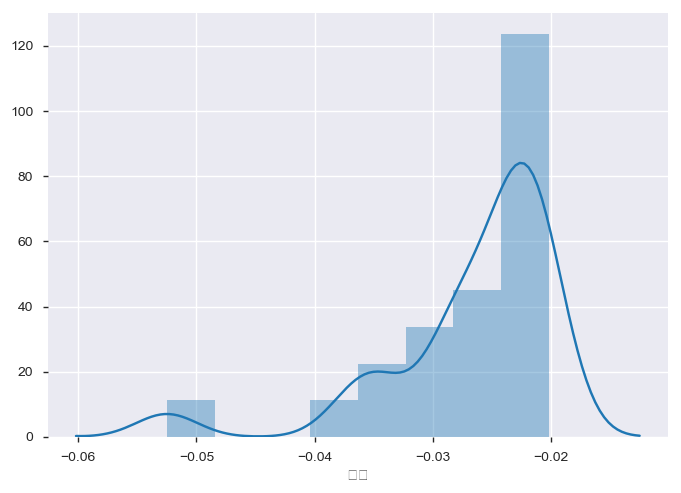

In [207]:
summary = summarys['A']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
print(len(check))
sns.distplot(check['傾き'])

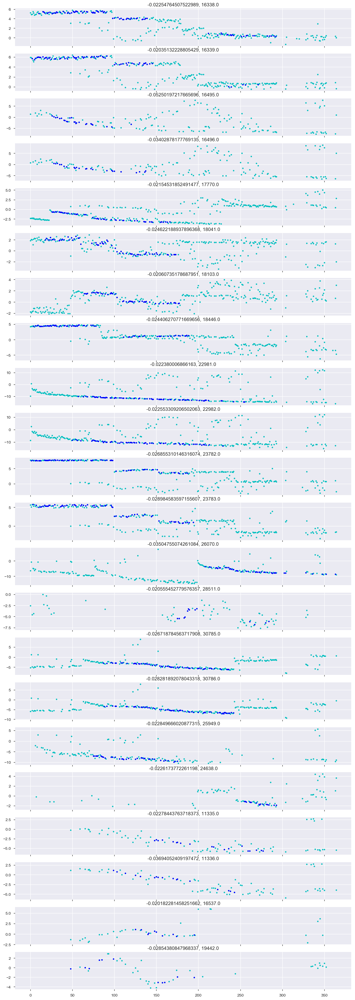

In [208]:
track = tracks['A']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['A']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

13


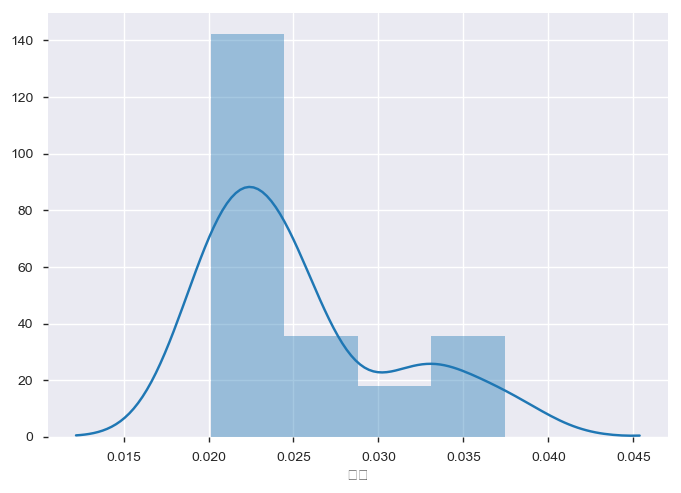

In [209]:
summary = summarys['A']
check = summary.loc[summary['傾き'] > 0.02]
print(len(check))
sns.distplot(check['傾き'])

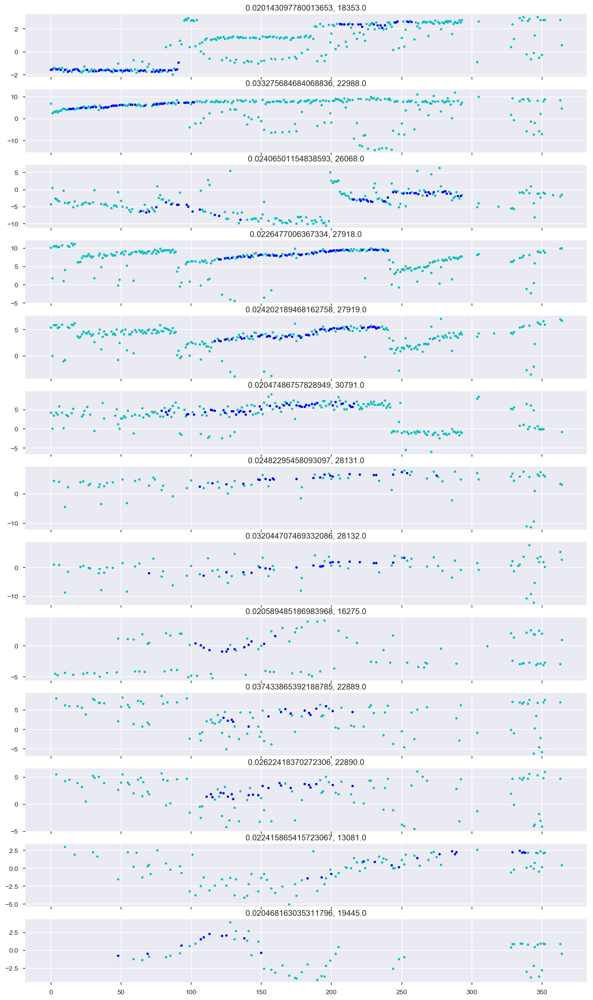

In [210]:
track = tracks['A']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['A']
check = summary[summary['傾き'] > 0.02]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

20


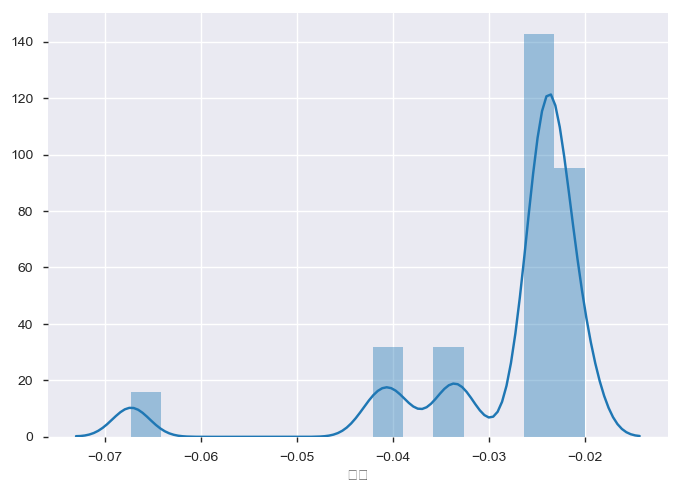

In [148]:
summary = summarys['B']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
print(len(check))
sns.distplot(check['傾き'])

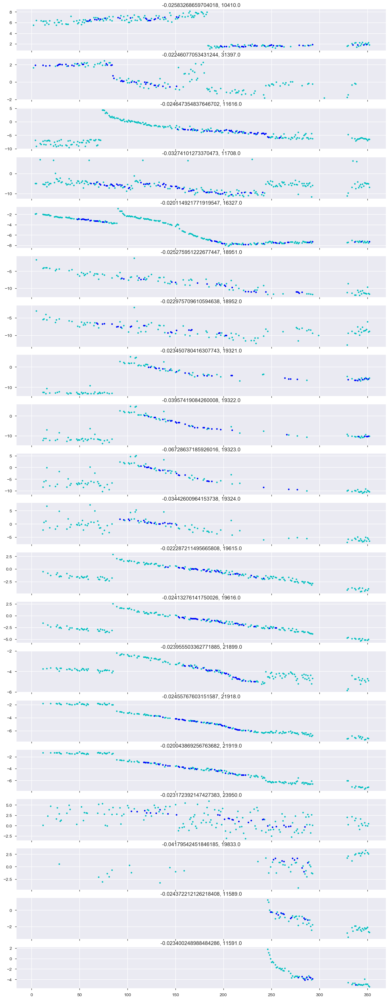

In [149]:
track = tracks['B']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['B']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

13


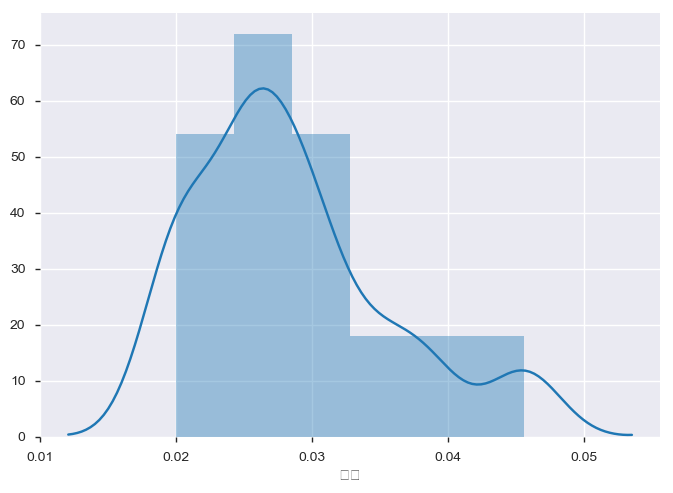

In [150]:
summary = summarys['B']
check = summary.loc[summary['傾き'] > 0.02]
print(len(check))
sns.distplot(check['傾き'])

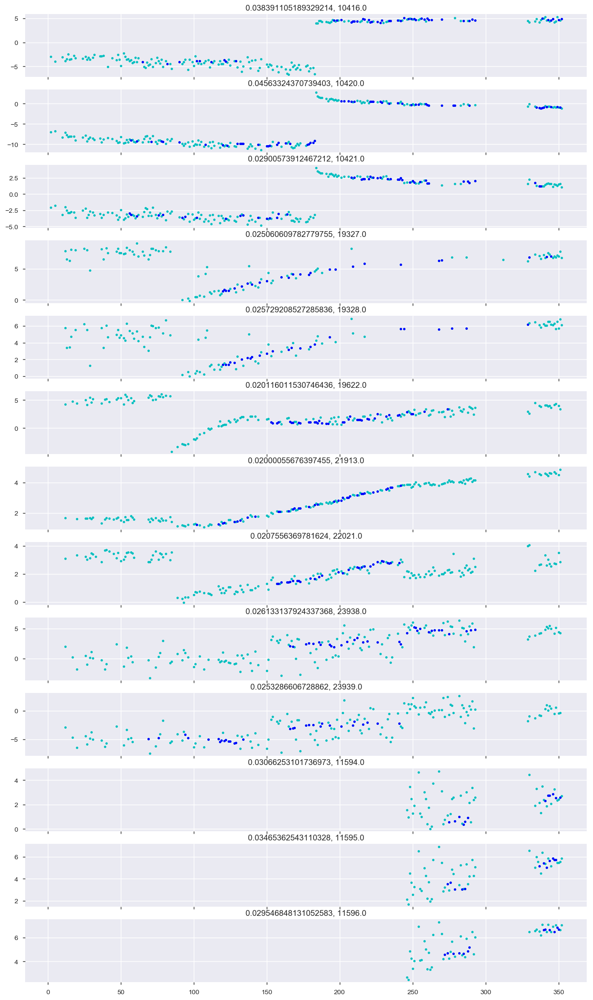

In [151]:
track = tracks['B']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['B']
check = summary[summary['傾き'] > 0.02]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

53


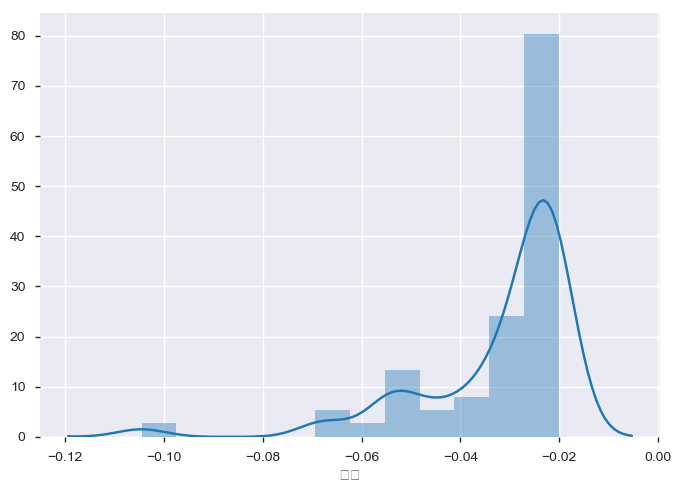

In [152]:
summary = summarys['C']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
print(len(check))
sns.distplot(check['傾き'])

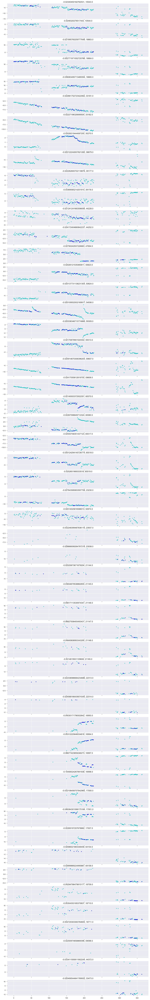

In [153]:
track = tracks['C']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['C']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

37


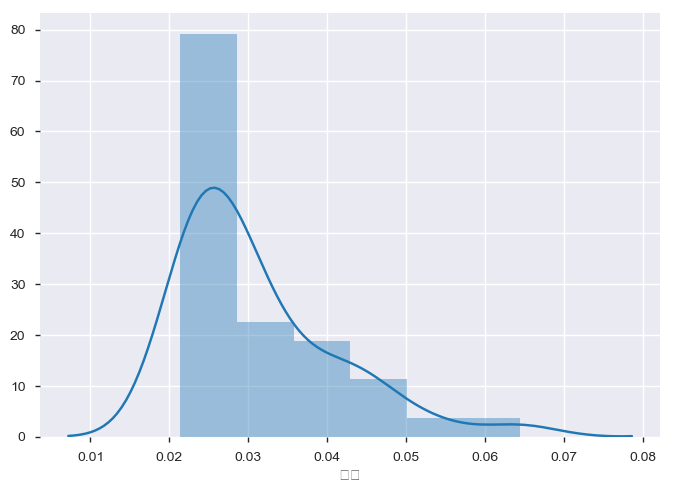

In [154]:
summary = summarys['C']
check = summary.loc[summary['傾き'] > 0.02]
print(len(check))
sns.distplot(check['傾き'])

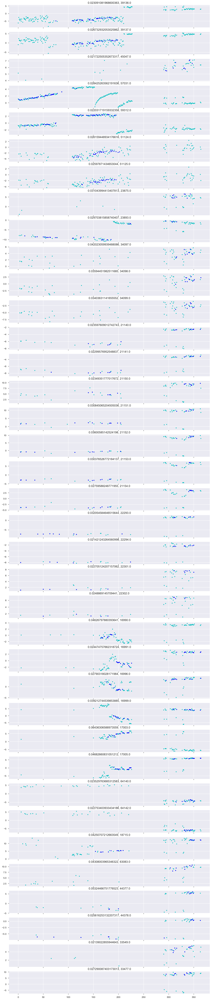

In [155]:
track = tracks['C']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['C']
check = summary[summary['傾き'] > 0.02]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

98


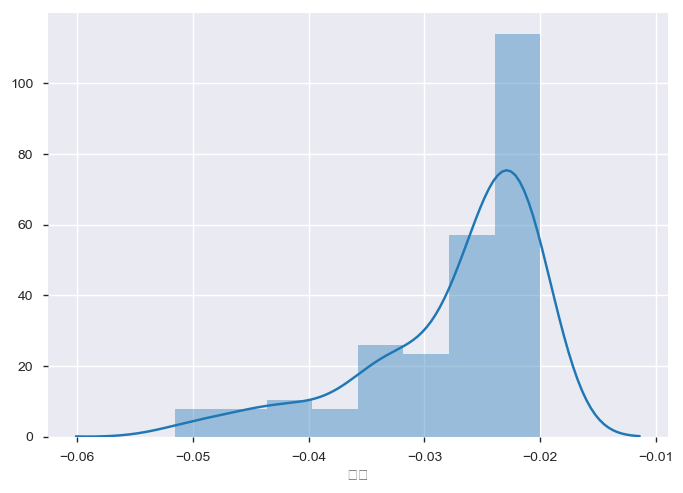

In [156]:
summary = summarys['D']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
print(len(check))
sns.distplot(check['傾き'])

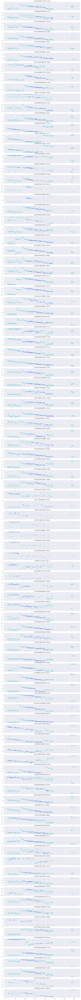

In [157]:
track = tracks['D']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['D']
check = summary.loc[summary['傾き'] < -0.02]
check = check.loc[check['傾き'] != -100]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

54


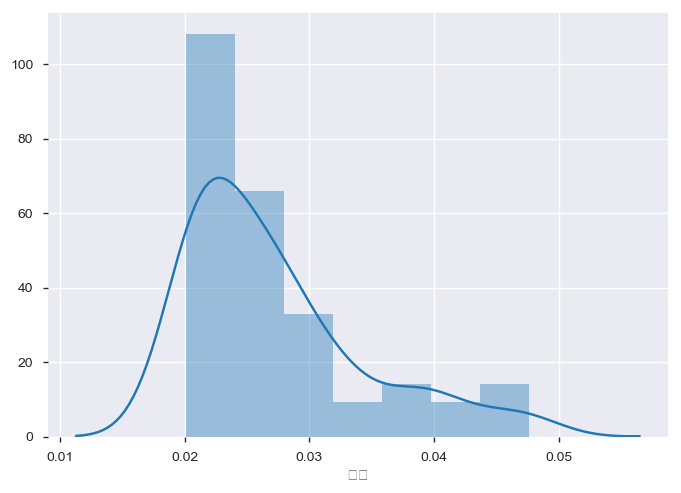

In [158]:
summary = summarys['D']
check = summary.loc[summary['傾き'] > 0.02]
print(len(check))
sns.distplot(check['傾き'])

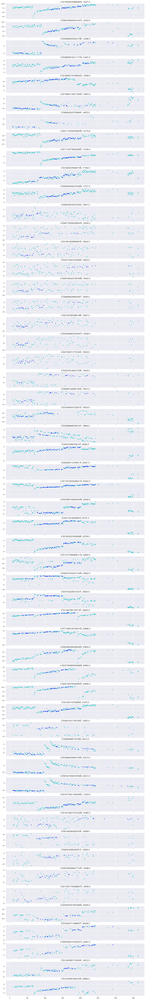

In [159]:
track = tracks['D']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['D']
check = summary[summary['傾き'] > 0.02]
check = check.reset_index(drop=True)
slopes = check['傾き'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

# 切片


16


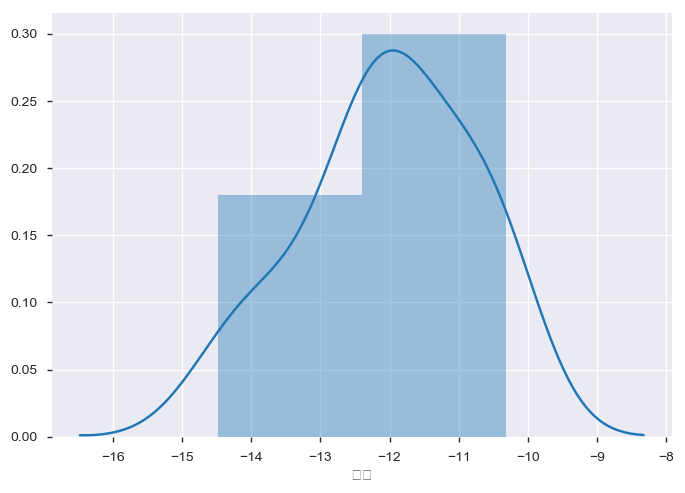

In [211]:
summary = summarys['A']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

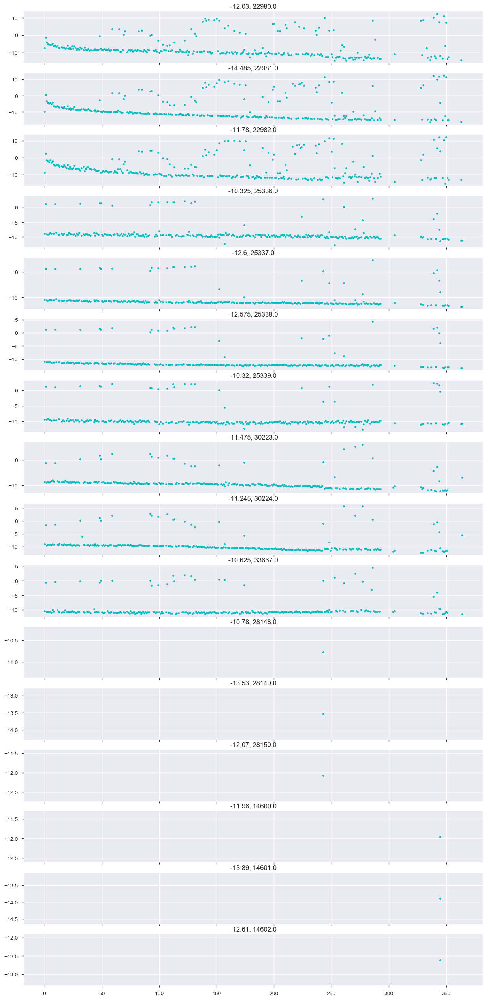

In [212]:
track = tracks['A']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['A']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

9


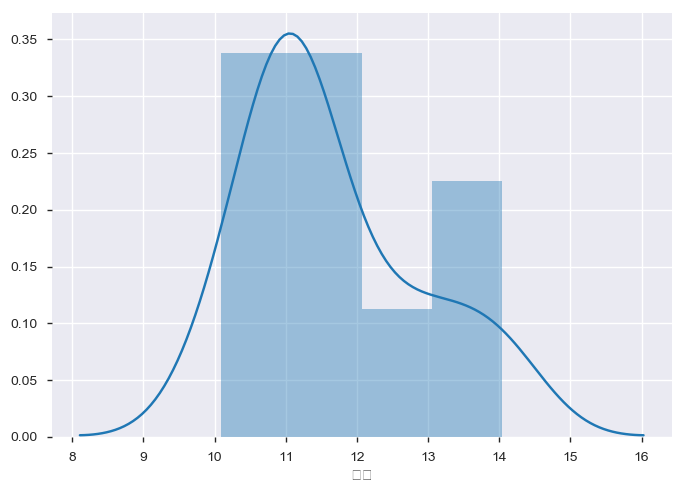

In [213]:
summary = summarys['A']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (8). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


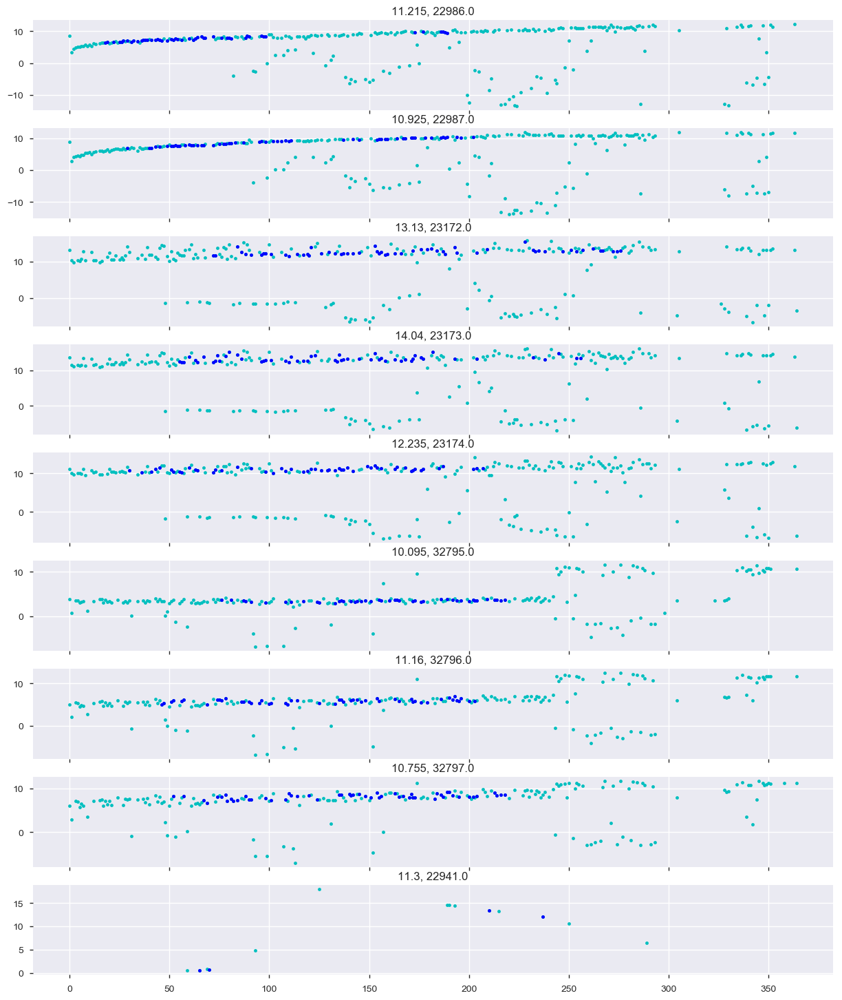

In [214]:
track = tracks['A']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['A']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

50


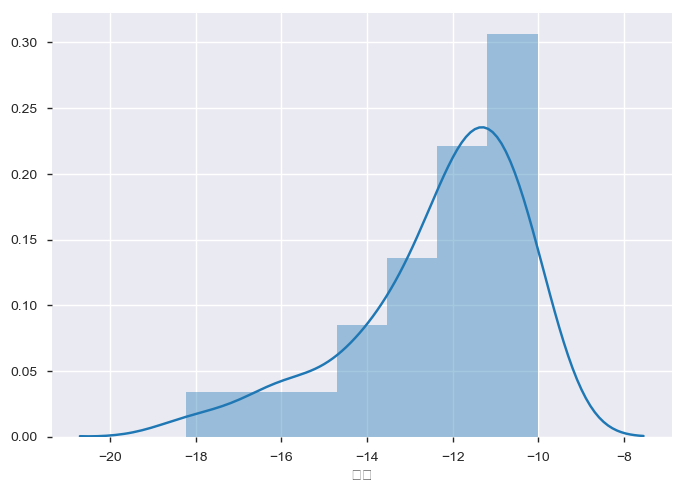

In [215]:
summary = summarys['B']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

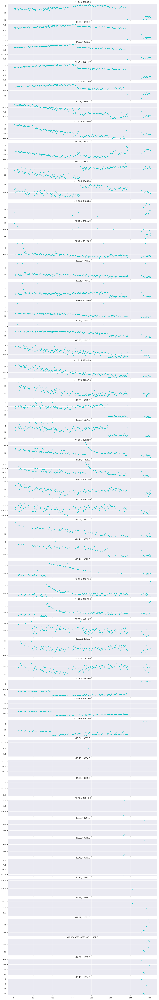

In [216]:
track = tracks['B']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['B']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

31


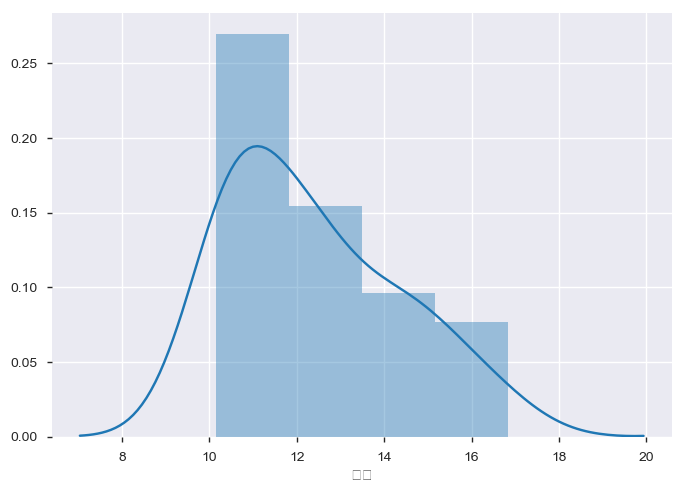

In [217]:
summary = summarys['B']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

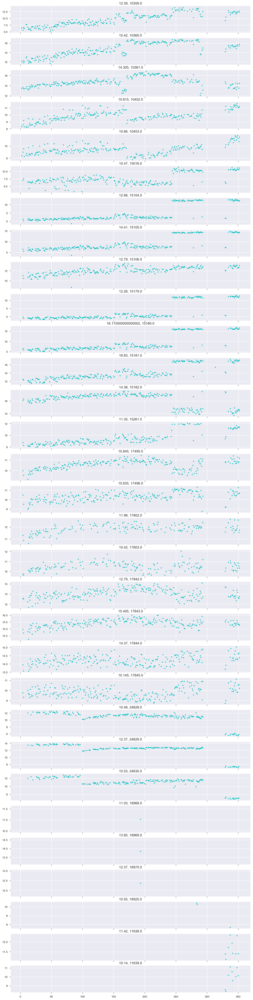

In [218]:
track = tracks['B']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['B']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

65


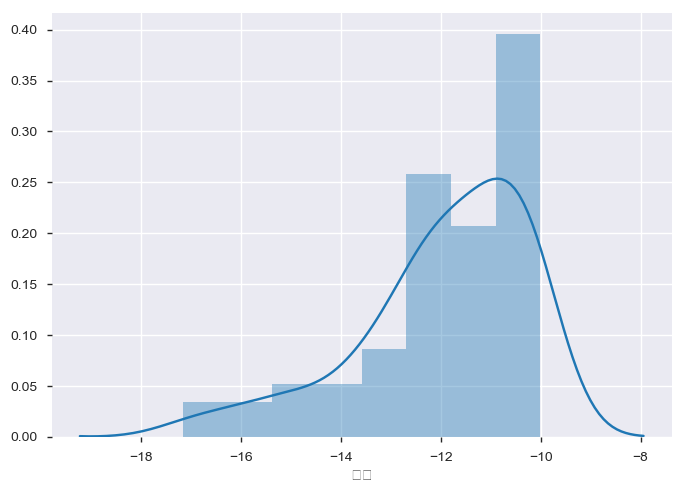

In [219]:
summary = summarys['C']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

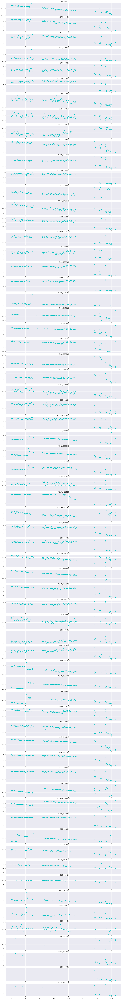

In [220]:
track = tracks['C']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['C']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

58


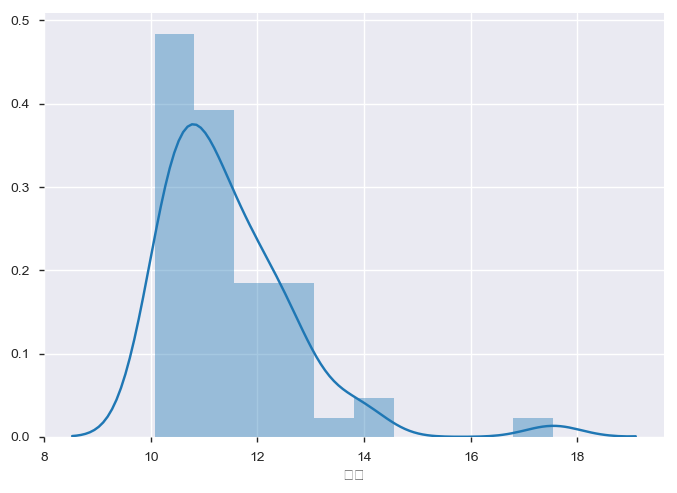

In [221]:
summary = summarys['C']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (19). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (11). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (12). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


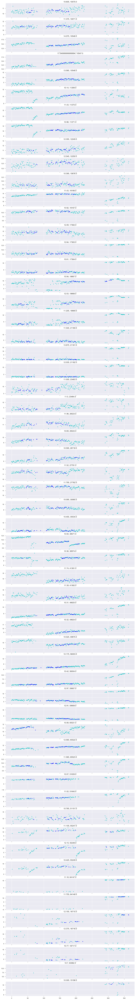

In [222]:
track = tracks['C']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['C']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

107


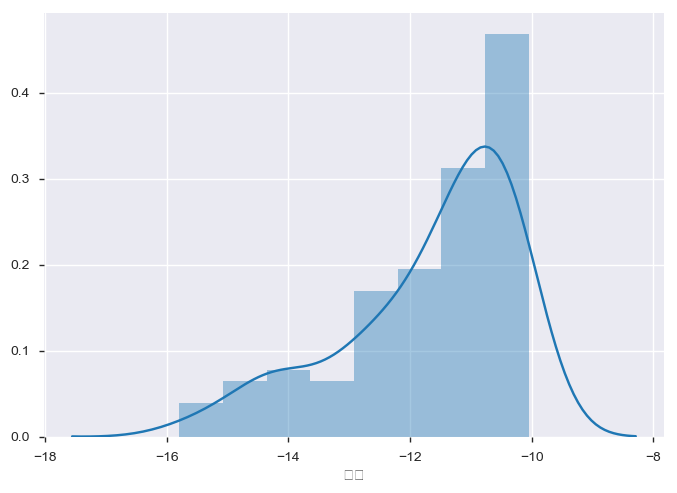

In [223]:
summary = summarys['D']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

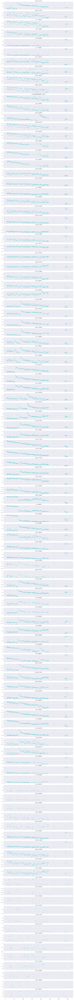

In [224]:
track = tracks['D']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['D']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

58


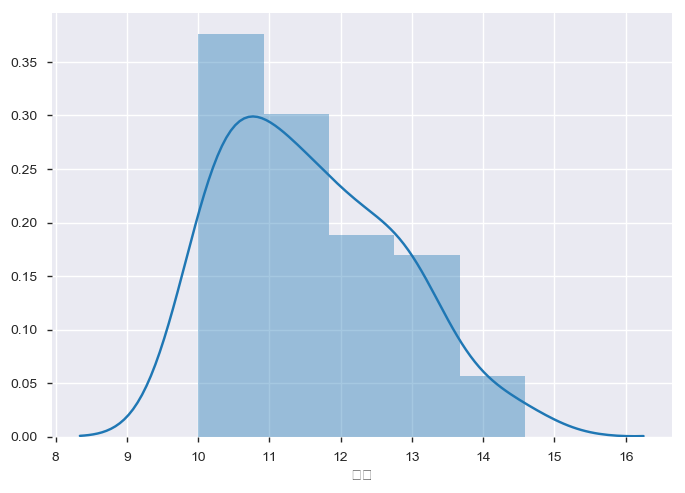

In [225]:
summary = summarys['D']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (16). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (17). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (2). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total

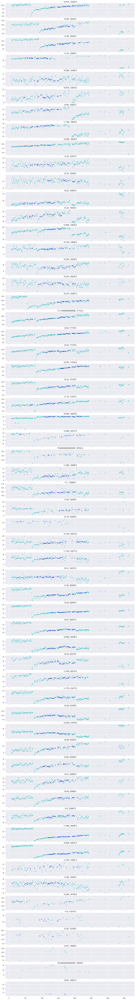

In [226]:
track = tracks['D']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['D']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

# 切片をラスト10日分の中央値にしてみる

In [299]:
'''
%%time
for no in tqdm(['A', 'B', 'C', 'D']):
    track = tracks[no]
    kilos = summarys[no]['キロ程'].values
    interceptions = []
    for i, kilo in tqdm(enumerate(kilos)):
        data = track.loc[track['キロ程'] == kilo, '高低左']
        data = data.dropna()
        data = data.reset_index(drop=True)
        interceptions.append(np.median(data.values[-10:]))
    summarys[no]['切片'] = interceptions
'''









  0%|          | 0/4 [00:00<?, ?it/s]








0it [00:00, ?it/s]








5it [00:00, 43.41it/s]








10it [00:00, 43.09it/s]








15it [00:00, 43.91it/s]








20it [00:00, 40.25it/s]








24it [00:00, 37.54it/s]








27it [00:00, 35.20it/s]








31it [00:00, 35.65it/s]








35it [00:01, 31.81it/s]








38it [00:01, 31.35it/s]








42it [00:01, 31.55it/s]








46it [00:01, 31.90it/s]








50it [00:01, 31.30it/s]








53it [00:01, 30.26it/s]








56it [00:02, 27.41it/s]








59it [00:02, 26.89it/s]








62it [00:02, 26.70it/s]








65it [00:02, 26.71it/s]








69it [00:02, 27.04it/s]








73it [00:02, 27.42it/s]








76it [00:02, 27.52it/s]








80it [00:02, 27.84it/s]








84it [00:03, 27.98it/s]








88it [00:03, 27.26it/s]








91it [00:03, 26.81it/s]








94it [00:03, 26.69it/s]








97it [00:03, 26.71it/s]








101it [00:03, 26.76it/s]








105it [00:03, 26.95it/s]








109it [00:04, 27.25it/

778it [00:37, 20.58it/s]








781it [00:37, 20.58it/s]








784it [00:38, 20.58it/s]








786it [00:38, 20.57it/s]








789it [00:38, 20.57it/s]








791it [00:38, 20.55it/s]








793it [00:38, 20.53it/s]








796it [00:38, 20.51it/s]








798it [00:38, 20.51it/s]








800it [00:39, 20.51it/s]








803it [00:39, 20.51it/s]








805it [00:39, 20.51it/s]








808it [00:39, 20.51it/s]








810it [00:39, 20.50it/s]








812it [00:39, 20.48it/s]








814it [00:39, 20.48it/s]








816it [00:39, 20.46it/s]








818it [00:39, 20.46it/s]








820it [00:40, 20.45it/s]








822it [00:40, 20.43it/s]








824it [00:40, 20.42it/s]








826it [00:40, 20.42it/s]








828it [00:40, 20.41it/s]








831it [00:40, 20.42it/s]








833it [00:40, 20.37it/s]








835it [00:40, 20.37it/s]








837it [00:41, 20.37it/s]








839it [00:41, 20.35it/s]








841it [00:41, 20.34it/s]








843it [00:41, 20.34it/s]








846it [00:

1101it [00:55, 19.86it/s]








1104it [00:55, 19.86it/s]








1106it [00:55, 19.85it/s]








1108it [00:55, 19.84it/s]








1110it [00:55, 19.84it/s]








1113it [00:56, 19.84it/s]








1115it [00:56, 19.84it/s]








1117it [00:56, 19.83it/s]








1120it [00:56, 19.84it/s]








1122it [00:56, 19.83it/s]








1124it [00:56, 19.83it/s]








1126it [00:56, 19.81it/s]








1128it [00:56, 19.81it/s]








1131it [00:57, 19.82it/s]








1133it [00:57, 19.81it/s]








1135it [00:57, 19.81it/s]








1137it [00:57, 19.80it/s]








1139it [00:57, 19.80it/s]








1141it [00:57, 19.80it/s]








1143it [00:57, 19.78it/s]








1146it [00:57, 19.79it/s]








1148it [00:58, 19.79it/s]








1151it [00:58, 19.78it/s]








1153it [00:58, 19.78it/s]








1155it [00:58, 19.78it/s]








1157it [00:58, 19.78it/s]








1159it [00:58, 19.77it/s]








1161it [00:58, 19.77it/s]








1163it [00:58, 19.76it/s]








1165it [00:58,

1763it [01:30, 19.50it/s]








1766it [01:30, 19.50it/s]








1769it [01:30, 19.50it/s]








1771it [01:30, 19.50it/s]








1774it [01:30, 19.50it/s]








1777it [01:31, 19.50it/s]








1780it [01:31, 19.50it/s]








1782it [01:31, 19.49it/s]








1784it [01:31, 19.49it/s]








1786it [01:31, 19.49it/s]








1789it [01:31, 19.49it/s]








1791it [01:31, 19.49it/s]








1793it [01:31, 19.49it/s]








1795it [01:32, 19.49it/s]








1797it [01:32, 19.49it/s]








1799it [01:32, 19.49it/s]








1801it [01:32, 19.48it/s]








1803it [01:32, 19.48it/s]








1806it [01:32, 19.48it/s]








1808it [01:32, 19.48it/s]








1810it [01:32, 19.48it/s]








1813it [01:33, 19.48it/s]








1816it [01:33, 19.48it/s]








1819it [01:33, 19.48it/s]








1821it [01:33, 19.48it/s]








1823it [01:33, 19.48it/s]








1825it [01:33, 19.47it/s]








1828it [01:33, 19.47it/s]








1831it [01:34, 19.47it/s]








1834it [01:34,

2467it [02:06, 19.47it/s]








2470it [02:06, 19.46it/s]








2473it [02:07, 19.47it/s]








2476it [02:07, 19.47it/s]








2479it [02:07, 19.47it/s]








2481it [02:07, 19.46it/s]








2484it [02:07, 19.47it/s]








2487it [02:07, 19.47it/s]








2490it [02:07, 19.47it/s]








2492it [02:08, 19.47it/s]








2495it [02:08, 19.47it/s]








2498it [02:08, 19.46it/s]








2501it [02:08, 19.46it/s]








2503it [02:08, 19.46it/s]








2505it [02:08, 19.46it/s]








2507it [02:08, 19.46it/s]








2510it [02:08, 19.46it/s]








2513it [02:09, 19.47it/s]








2516it [02:09, 19.46it/s]








2519it [02:09, 19.46it/s]








2521it [02:09, 19.45it/s]








2523it [02:09, 19.45it/s]








2525it [02:09, 19.45it/s]








2527it [02:09, 19.45it/s]








2529it [02:10, 19.45it/s]








2531it [02:10, 19.45it/s]








2534it [02:10, 19.45it/s]








2537it [02:10, 19.45it/s]








2540it [02:10, 19.45it/s]








2543it [02:10,

3151it [02:42, 19.41it/s]








3153it [02:42, 19.41it/s]








3156it [02:42, 19.41it/s]








3159it [02:42, 19.41it/s]








3162it [02:42, 19.41it/s]








3165it [02:43, 19.41it/s]








3168it [02:43, 19.42it/s]








3171it [02:43, 19.42it/s]








3174it [02:43, 19.42it/s]








3177it [02:43, 19.42it/s]








3180it [02:43, 19.42it/s]








3183it [02:43, 19.42it/s]








3186it [02:44, 19.42it/s]








3189it [02:44, 19.42it/s]








3192it [02:44, 19.42it/s]








3195it [02:44, 19.42it/s]








3198it [02:44, 19.42it/s]








3200it [02:44, 19.42it/s]








3202it [02:44, 19.42it/s]








3205it [02:44, 19.42it/s]








3208it [02:45, 19.43it/s]








3211it [02:45, 19.43it/s]








3214it [02:45, 19.43it/s]








3217it [02:45, 19.43it/s]








3219it [02:45, 19.43it/s]








3222it [02:45, 19.43it/s]








3224it [02:45, 19.42it/s]








3226it [02:46, 19.42it/s]








3228it [02:46, 19.42it/s]








3230it [02:46,

3860it [03:18, 19.44it/s]








3862it [03:18, 19.44it/s]








3864it [03:18, 19.44it/s]








3866it [03:18, 19.44it/s]








3869it [03:18, 19.44it/s]








3872it [03:19, 19.45it/s]








3875it [03:19, 19.45it/s]








3878it [03:19, 19.44it/s]








3881it [03:19, 19.44it/s]








3884it [03:19, 19.44it/s]








3886it [03:19, 19.44it/s]








3889it [03:20, 19.44it/s]








3891it [03:20, 19.44it/s]








3893it [03:20, 19.44it/s]








3896it [03:20, 19.44it/s]








3898it [03:20, 19.44it/s]








3900it [03:20, 19.44it/s]








3902it [03:20, 19.44it/s]








3904it [03:20, 19.44it/s]








3906it [03:20, 19.43it/s]








3909it [03:21, 19.44it/s]








3911it [03:21, 19.44it/s]








3913it [03:21, 19.43it/s]








3915it [03:21, 19.43it/s]








3917it [03:21, 19.43it/s]








3920it [03:21, 19.43it/s]








3922it [03:21, 19.43it/s]








3924it [03:21, 19.43it/s]








3926it [03:22, 19.43it/s]








3928it [03:22,

4568it [03:54, 19.44it/s]








4574it [03:55, 19.46it/s]








4579it [03:55, 19.47it/s]








4583it [03:55, 19.46it/s]








4586it [03:55, 19.46it/s]








4589it [03:55, 19.46it/s]








4592it [03:56, 19.46it/s]








4594it [03:56, 19.45it/s]








4597it [03:56, 19.46it/s]








4599it [03:56, 19.46it/s]








4601it [03:56, 19.46it/s]








4604it [03:56, 19.46it/s]








4607it [03:56, 19.46it/s]








4609it [03:56, 19.46it/s]








4612it [03:57, 19.46it/s]








4615it [03:57, 19.46it/s]








4618it [03:57, 19.46it/s]








4621it [03:57, 19.46it/s]








4623it [03:57, 19.46it/s]








4625it [03:57, 19.45it/s]








4628it [03:57, 19.45it/s]








4631it [03:58, 19.45it/s]








4634it [03:58, 19.45it/s]








4636it [03:58, 19.45it/s]








4639it [03:58, 19.45it/s]








4641it [03:58, 19.45it/s]








4643it [03:58, 19.45it/s]








4645it [03:58, 19.45it/s]








4648it [03:58, 19.45it/s]








4651it [03:59,

5274it [04:30, 19.47it/s]








5278it [04:31, 19.47it/s]








5281it [04:31, 19.47it/s]








5284it [04:31, 19.47it/s]








5287it [04:31, 19.47it/s]








5290it [04:31, 19.48it/s]








5293it [04:31, 19.47it/s]








5296it [04:31, 19.47it/s]








5298it [04:32, 19.47it/s]








5300it [04:32, 19.47it/s]








5303it [04:32, 19.47it/s]








5305it [04:32, 19.47it/s]








5307it [04:32, 19.47it/s]








5309it [04:32, 19.47it/s]








5311it [04:32, 19.47it/s]








5314it [04:32, 19.47it/s]








5316it [04:33, 19.47it/s]








5319it [04:33, 19.48it/s]








5322it [04:33, 19.48it/s]








5325it [04:33, 19.48it/s]








5328it [04:33, 19.48it/s]








5331it [04:33, 19.47it/s]








5334it [04:33, 19.47it/s]








5336it [04:34, 19.47it/s]








5339it [04:34, 19.47it/s]








5341it [04:34, 19.47it/s]








5343it [04:34, 19.47it/s]








5345it [04:34, 19.47it/s]








5347it [04:34, 19.47it/s]








5349it [04:34,

5951it [05:06, 19.43it/s]








5953it [05:06, 19.43it/s]








5955it [05:06, 19.43it/s]








5958it [05:06, 19.44it/s]








5961it [05:06, 19.43it/s]








5963it [05:06, 19.43it/s]








5966it [05:06, 19.44it/s]








5969it [05:07, 19.44it/s]








5972it [05:07, 19.44it/s]








5975it [05:07, 19.44it/s]








5978it [05:07, 19.44it/s]








5980it [05:07, 19.44it/s]








5982it [05:07, 19.43it/s]








5985it [05:07, 19.44it/s]








5987it [05:08, 19.43it/s]








5990it [05:08, 19.44it/s]








5992it [05:08, 19.44it/s]








5994it [05:08, 19.43it/s]








5997it [05:08, 19.43it/s]








5999it [05:08, 19.43it/s]








6001it [05:08, 19.43it/s]








6004it [05:08, 19.43it/s]








6007it [05:09, 19.44it/s]








6010it [05:09, 19.43it/s]








6013it [05:09, 19.43it/s]








6016it [05:09, 19.43it/s]








6019it [05:09, 19.43it/s]








6021it [05:09, 19.43it/s]








6023it [05:09, 19.43it/s]








6025it [05:10,

6637it [05:41, 19.41it/s]








6639it [05:42, 19.41it/s]








6641it [05:42, 19.41it/s]








6644it [05:42, 19.41it/s]








6647it [05:42, 19.41it/s]








6649it [05:42, 19.41it/s]








6651it [05:42, 19.41it/s]








6653it [05:42, 19.41it/s]








6655it [05:42, 19.41it/s]








6657it [05:42, 19.41it/s]








6660it [05:43, 19.41it/s]








6663it [05:43, 19.41it/s]








6666it [05:43, 19.41it/s]








6669it [05:43, 19.41it/s]








6672it [05:43, 19.41it/s]








6675it [05:43, 19.41it/s]








6677it [05:43, 19.41it/s]








6679it [05:44, 19.41it/s]








6681it [05:44, 19.41it/s]








6683it [05:44, 19.41it/s]








6686it [05:44, 19.41it/s]








6688it [05:44, 19.41it/s]








6691it [05:44, 19.41it/s]








6693it [05:44, 19.41it/s]








6696it [05:44, 19.41it/s]








6698it [05:45, 19.41it/s]








6701it [05:45, 19.41it/s]








6704it [05:45, 19.41it/s]








6706it [05:45, 19.41it/s]








6708it [05:45,

7339it [06:18, 19.41it/s]








7342it [06:18, 19.41it/s]








7345it [06:18, 19.41it/s]








7347it [06:18, 19.41it/s]








7349it [06:18, 19.41it/s]








7351it [06:18, 19.41it/s]








7354it [06:18, 19.41it/s]








7357it [06:19, 19.41it/s]








7361it [06:19, 19.42it/s]








7364it [06:19, 19.41it/s]








7367it [06:19, 19.41it/s]








7370it [06:19, 19.41it/s]








7373it [06:19, 19.41it/s]








7376it [06:19, 19.41it/s]








7379it [06:20, 19.41it/s]








7382it [06:20, 19.41it/s]








7385it [06:20, 19.41it/s]








7387it [06:20, 19.41it/s]








7390it [06:20, 19.41it/s]








7393it [06:20, 19.41it/s]








7395it [06:20, 19.41it/s]








7398it [06:21, 19.41it/s]








7400it [06:21, 19.41it/s]








7402it [06:21, 19.41it/s]








7404it [06:21, 19.41it/s]








7407it [06:21, 19.41it/s]








7409it [06:21, 19.41it/s]








7411it [06:21, 19.41it/s]








7414it [06:21, 19.41it/s]








7416it [06:22,

8037it [06:54, 19.41it/s]








8040it [06:54, 19.41it/s]








8042it [06:54, 19.41it/s]








8045it [06:54, 19.41it/s]








8047it [06:54, 19.41it/s]








8049it [06:54, 19.41it/s]








8051it [06:54, 19.41it/s]








8053it [06:54, 19.41it/s]








8056it [06:54, 19.41it/s]








8059it [06:55, 19.41it/s]








8062it [06:55, 19.41it/s]








8065it [06:55, 19.41it/s]








8068it [06:55, 19.41it/s]








8071it [06:55, 19.41it/s]








8073it [06:55, 19.41it/s]








8075it [06:55, 19.41it/s]








8077it [06:56, 19.41it/s]








8079it [06:56, 19.41it/s]








8081it [06:56, 19.41it/s]








8084it [06:56, 19.41it/s]








8086it [06:56, 19.41it/s]








8088it [06:56, 19.41it/s]








8090it [06:56, 19.41it/s]








8093it [06:56, 19.41it/s]








8096it [06:57, 19.41it/s]








8099it [06:57, 19.42it/s]








8102it [06:57, 19.42it/s]








8105it [06:57, 19.41it/s]








8108it [06:57, 19.41it/s]








8111it [06:57,

8737it [07:29, 19.43it/s]








8739it [07:29, 19.42it/s]








8741it [07:30, 19.42it/s]








8744it [07:30, 19.42it/s]








8746it [07:30, 19.42it/s]








8748it [07:30, 19.42it/s]








8751it [07:30, 19.42it/s]








8753it [07:30, 19.42it/s]








8755it [07:30, 19.42it/s]








8758it [07:30, 19.42it/s]








8761it [07:31, 19.42it/s]








8764it [07:31, 19.42it/s]








8767it [07:31, 19.42it/s]








8770it [07:31, 19.42it/s]








8773it [07:31, 19.43it/s]








8776it [07:31, 19.43it/s]








8779it [07:31, 19.43it/s]








8782it [07:32, 19.42it/s]








8785it [07:32, 19.43it/s]








8788it [07:32, 19.43it/s]








8791it [07:32, 19.43it/s]








8794it [07:32, 19.43it/s]








8797it [07:32, 19.43it/s]








8800it [07:32, 19.43it/s]








8803it [07:33, 19.43it/s]








8806it [07:33, 19.43it/s]








8809it [07:33, 19.43it/s]








8812it [07:33, 19.43it/s]








8815it [07:33, 19.43it/s]








8818it [07:33,

9451it [08:06, 19.43it/s]








9453it [08:06, 19.43it/s]








9456it [08:06, 19.43it/s]








9458it [08:06, 19.43it/s]








9460it [08:06, 19.43it/s]








9463it [08:07, 19.43it/s]








9466it [08:07, 19.43it/s]








9469it [08:07, 19.43it/s]








9472it [08:07, 19.43it/s]








9475it [08:07, 19.43it/s]








9478it [08:07, 19.43it/s]








9481it [08:07, 19.43it/s]








9484it [08:08, 19.43it/s]








9486it [08:08, 19.43it/s]








9488it [08:08, 19.43it/s]








9491it [08:08, 19.43it/s]








9494it [08:08, 19.43it/s]








9497it [08:08, 19.43it/s]








9499it [08:08, 19.43it/s]








9501it [08:08, 19.43it/s]








9504it [08:09, 19.43it/s]








9507it [08:09, 19.43it/s]








9510it [08:09, 19.43it/s]








9513it [08:09, 19.43it/s]








9516it [08:09, 19.43it/s]








9518it [08:09, 19.43it/s]








9521it [08:09, 19.43it/s]








9524it [08:10, 19.43it/s]








9527it [08:10, 19.43it/s]








9529it [08:10,

10146it [08:42, 19.42it/s]








10148it [08:42, 19.42it/s]








10151it [08:42, 19.42it/s]








10154it [08:42, 19.42it/s]








10157it [08:43, 19.42it/s]








10161it [08:43, 19.42it/s]








10164it [08:43, 19.42it/s]








10167it [08:43, 19.42it/s]








10170it [08:43, 19.42it/s]








10173it [08:43, 19.42it/s]








10176it [08:43, 19.42it/s]








10179it [08:44, 19.42it/s]








10182it [08:44, 19.42it/s]








10185it [08:44, 19.42it/s]








10187it [08:44, 19.42it/s]








10189it [08:44, 19.42it/s]








10192it [08:44, 19.42it/s]








10195it [08:44, 19.42it/s]








10199it [08:45, 19.43it/s]








10203it [08:45, 19.43it/s]








10206it [08:45, 19.43it/s]








10209it [08:45, 19.43it/s]








10212it [08:45, 19.43it/s]








10215it [08:45, 19.43it/s]








10218it [08:45, 19.43it/s]








10221it [08:46, 19.43it/s]








10224it [08:46, 19.43it/s]








10227it [08:46, 19.43it/s]








10230it [08:46, 19.4

10845it [09:18, 19.43it/s]








10847it [09:18, 19.43it/s]








10850it [09:18, 19.43it/s]








10853it [09:18, 19.43it/s]








10856it [09:18, 19.43it/s]








10859it [09:18, 19.43it/s]








10862it [09:18, 19.43it/s]








10865it [09:19, 19.43it/s]








10868it [09:19, 19.43it/s]








10871it [09:19, 19.43it/s]








10873it [09:19, 19.43it/s]








10875it [09:19, 19.43it/s]








10878it [09:19, 19.43it/s]








10881it [09:20, 19.43it/s]








10883it [09:20, 19.43it/s]








10885it [09:20, 19.43it/s]








10888it [09:20, 19.43it/s]








10891it [09:20, 19.43it/s]








10894it [09:20, 19.43it/s]








10896it [09:20, 19.43it/s]








10898it [09:20, 19.43it/s]








10901it [09:21, 19.43it/s]








10904it [09:21, 19.43it/s]








10907it [09:21, 19.43it/s]








10910it [09:21, 19.43it/s]








10913it [09:21, 19.43it/s]








10916it [09:21, 19.43it/s]








10919it [09:21, 19.43it/s]








10922it [09:22, 19.4

11511it [09:53, 19.41it/s]








11516it [09:53, 19.41it/s]








11519it [09:53, 19.41it/s]








11522it [09:53, 19.41it/s]








11524it [09:53, 19.41it/s]








11526it [09:53, 19.41it/s]








11528it [09:54, 19.41it/s]








11531it [09:54, 19.41it/s]








11533it [09:54, 19.41it/s]








11536it [09:54, 19.41it/s]








11538it [09:54, 19.41it/s]








11540it [09:54, 19.41it/s]








11543it [09:54, 19.41it/s]








11545it [09:54, 19.41it/s]








11547it [09:54, 19.41it/s]








11550it [09:55, 19.41it/s]








11552it [09:55, 19.41it/s]








11554it [09:55, 19.41it/s]








11557it [09:55, 19.41it/s]








11559it [09:55, 19.41it/s]








11561it [09:55, 19.41it/s]








11563it [09:55, 19.41it/s]








11565it [09:55, 19.41it/s]








11567it [09:56, 19.41it/s]








11569it [09:56, 19.41it/s]








11571it [09:56, 19.41it/s]








11573it [09:56, 19.41it/s]








11576it [09:56, 19.41it/s]








11578it [09:56, 19.4

13153it [10:23, 21.08it/s]








13160it [10:23, 21.09it/s]








13167it [10:24, 21.10it/s]








13174it [10:24, 21.11it/s]








13181it [10:24, 21.11it/s]








13188it [10:24, 21.12it/s]








13195it [10:24, 21.13it/s]








13202it [10:24, 21.14it/s]








13209it [10:24, 21.14it/s]








13216it [10:24, 21.15it/s]








13223it [10:24, 21.16it/s]








13230it [10:25, 21.16it/s]








13237it [10:25, 21.17it/s]








13244it [10:25, 21.18it/s]








13251it [10:25, 21.19it/s]








13258it [10:25, 21.19it/s]








13265it [10:25, 21.20it/s]








13272it [10:25, 21.21it/s]








13279it [10:25, 21.22it/s]








13286it [10:25, 21.22it/s]








13293it [10:26, 21.23it/s]








13300it [10:26, 21.24it/s]








13307it [10:26, 21.25it/s]








13314it [10:26, 21.25it/s]








13321it [10:26, 21.26it/s]








13328it [10:26, 21.27it/s]








13335it [10:26, 21.28it/s]








13342it [10:26, 21.28it/s]








13349it [10:27, 21.2

14995it [10:53, 22.94it/s]








15002it [10:53, 22.95it/s]








15009it [10:53, 22.95it/s]








15016it [10:54, 22.96it/s]








15023it [10:54, 22.97it/s]








15030it [10:54, 22.97it/s]








15037it [10:54, 22.98it/s]








15044it [10:54, 22.99it/s]








15051it [10:54, 22.99it/s]








15058it [10:54, 23.00it/s]








15065it [10:54, 23.01it/s]








15072it [10:54, 23.01it/s]








15079it [10:55, 23.02it/s]








15086it [10:55, 23.03it/s]








15093it [10:55, 23.03it/s]








15100it [10:55, 23.04it/s]








15107it [10:55, 23.05it/s]








15114it [10:55, 23.05it/s]








15121it [10:55, 23.06it/s]








15128it [10:55, 23.07it/s]








15135it [10:55, 23.07it/s]








15142it [10:56, 23.08it/s]








15149it [10:56, 23.09it/s]








15156it [10:56, 23.09it/s]








15163it [10:56, 23.10it/s]








15170it [10:56, 23.11it/s]








15177it [10:56, 23.11it/s]








15184it [10:56, 23.12it/s]








15191it [10:56, 23.1

16831it [11:23, 24.63it/s]








16838it [11:23, 24.64it/s]








16845it [11:23, 24.64it/s]








16852it [11:23, 24.65it/s]








16859it [11:23, 24.65it/s]








16866it [11:23, 24.66it/s]








16873it [11:24, 24.67it/s]








16880it [11:24, 24.67it/s]








16887it [11:24, 24.68it/s]








16894it [11:24, 24.68it/s]








16901it [11:24, 24.69it/s]








16908it [11:24, 24.70it/s]








16915it [11:24, 24.70it/s]








16922it [11:24, 24.71it/s]








16929it [11:24, 24.72it/s]








16936it [11:25, 24.72it/s]








16943it [11:25, 24.73it/s]








16950it [11:25, 24.73it/s]








16957it [11:25, 24.74it/s]








16964it [11:25, 24.75it/s]








16971it [11:25, 24.75it/s]








16978it [11:25, 24.76it/s]








16985it [11:25, 24.76it/s]








16992it [11:25, 24.77it/s]








16999it [11:26, 24.78it/s]








17006it [11:26, 24.78it/s]








17013it [11:26, 24.79it/s]








17020it [11:26, 24.80it/s]








17027it [11:26, 24.8

18679it [11:53, 26.19it/s]








18686it [11:53, 26.20it/s]








18693it [11:53, 26.21it/s]








18700it [11:53, 26.21it/s]








18707it [11:53, 26.22it/s]








18714it [11:53, 26.22it/s]








18721it [11:53, 26.23it/s]








18728it [11:53, 26.23it/s]








18735it [11:54, 26.24it/s]








18742it [11:54, 26.25it/s]








18749it [11:54, 26.25it/s]








18756it [11:54, 26.26it/s]








18763it [11:54, 26.26it/s]








18770it [11:54, 26.27it/s]








18777it [11:54, 26.27it/s]








18784it [11:54, 26.28it/s]








18791it [11:54, 26.28it/s]








18798it [11:55, 26.29it/s]








18805it [11:55, 26.30it/s]








18812it [11:55, 26.30it/s]








18819it [11:55, 26.31it/s]








18826it [11:55, 26.31it/s]








18833it [11:55, 26.32it/s]








18840it [11:55, 26.32it/s]








18847it [11:55, 26.33it/s]








18854it [11:55, 26.33it/s]








18861it [11:56, 26.34it/s]








18868it [11:56, 26.35it/s]








18875it [11:56, 26.3

20525it [12:22, 27.63it/s]








20532it [12:23, 27.63it/s]








20539it [12:23, 27.64it/s]








20546it [12:23, 27.64it/s]








20553it [12:23, 27.65it/s]








20560it [12:23, 27.65it/s]








20567it [12:23, 27.66it/s]








20574it [12:23, 27.66it/s]








20581it [12:23, 27.67it/s]








20588it [12:23, 27.67it/s]








20595it [12:24, 27.68it/s]








20602it [12:24, 27.68it/s]








20609it [12:24, 27.69it/s]








20616it [12:24, 27.69it/s]








20623it [12:24, 27.70it/s]








20630it [12:24, 27.71it/s]








20637it [12:24, 27.71it/s]








20644it [12:24, 27.72it/s]








20651it [12:24, 27.72it/s]








20658it [12:25, 27.73it/s]








20665it [12:25, 27.73it/s]








20672it [12:25, 27.74it/s]








20679it [12:25, 27.74it/s]








20686it [12:25, 27.75it/s]








20693it [12:25, 27.75it/s]








20700it [12:25, 27.76it/s]








20707it [12:25, 27.76it/s]








20714it [12:25, 27.77it/s]








20721it [12:26, 27.7

22343it [12:52, 28.91it/s]








22350it [12:52, 28.92it/s]








22357it [12:53, 28.92it/s]








22364it [12:53, 28.93it/s]








22371it [12:53, 28.93it/s]








22378it [12:53, 28.94it/s]








22385it [12:53, 28.94it/s]








22392it [12:53, 28.95it/s]








22399it [12:53, 28.95it/s]








22406it [12:53, 28.95it/s]








22413it [12:53, 28.96it/s]








22420it [12:54, 28.96it/s]








22427it [12:54, 28.97it/s]








22434it [12:54, 28.97it/s]








22441it [12:54, 28.98it/s]








22448it [12:54, 28.98it/s]








22455it [12:54, 28.99it/s]








22462it [12:54, 28.99it/s]








22469it [12:54, 29.00it/s]








22476it [12:54, 29.00it/s]








22483it [12:55, 29.01it/s]








22490it [12:55, 29.01it/s]








22497it [12:55, 29.02it/s]








22504it [12:55, 29.02it/s]








22511it [12:55, 29.03it/s]








22518it [12:55, 29.03it/s]








22525it [12:55, 29.04it/s]








22532it [12:55, 29.04it/s]








22539it [12:55, 29.0

24189it [13:22, 30.14it/s]








24196it [13:22, 30.14it/s]








24203it [13:22, 30.14it/s]








24210it [13:23, 30.15it/s]








24217it [13:23, 30.15it/s]








24224it [13:23, 30.16it/s]








24231it [13:23, 30.16it/s]








24238it [13:23, 30.17it/s]








24245it [13:23, 30.17it/s]








24252it [13:23, 30.18it/s]








24259it [13:23, 30.18it/s]








24266it [13:23, 30.19it/s]








24273it [13:24, 30.19it/s]








24280it [13:24, 30.19it/s]








24287it [13:24, 30.20it/s]








24294it [13:24, 30.20it/s]








24301it [13:24, 30.21it/s]








24308it [13:24, 30.21it/s]








24315it [13:24, 30.22it/s]








24322it [13:24, 30.22it/s]








24329it [13:24, 30.23it/s]








24336it [13:25, 30.23it/s]








24343it [13:25, 30.23it/s]








24350it [13:25, 30.24it/s]








24357it [13:25, 30.24it/s]








24364it [13:25, 30.25it/s]








24371it [13:25, 30.25it/s]








24378it [13:25, 30.26it/s]








24385it [13:25, 30.2

26037it [13:52, 31.28it/s]








26044it [13:52, 31.28it/s]








26051it [13:52, 31.29it/s]








26058it [13:52, 31.29it/s]








26065it [13:52, 31.30it/s]








26072it [13:52, 31.30it/s]








26079it [13:53, 31.30it/s]








26086it [13:53, 31.31it/s]








26093it [13:53, 31.31it/s]








26100it [13:53, 31.32it/s]








26107it [13:53, 31.32it/s]








26114it [13:53, 31.33it/s]








26121it [13:53, 31.33it/s]








26128it [13:53, 31.33it/s]








26135it [13:53, 31.34it/s]








26142it [13:54, 31.34it/s]








26149it [13:54, 31.35it/s]








26156it [13:54, 31.35it/s]








26163it [13:54, 31.35it/s]








26170it [13:54, 31.36it/s]








26177it [13:54, 31.36it/s]








26184it [13:54, 31.37it/s]








26191it [13:54, 31.37it/s]








26198it [13:54, 31.38it/s]








26205it [13:55, 31.38it/s]








26212it [13:55, 31.38it/s]








26219it [13:55, 31.39it/s]








26226it [13:55, 31.39it/s]








26233it [13:55, 31.4

126it [00:01, 67.79it/s]








134it [00:01, 68.34it/s]








142it [00:02, 68.88it/s]








150it [00:02, 69.34it/s]








158it [00:02, 69.77it/s]








166it [00:02, 70.14it/s]








174it [00:02, 70.52it/s]








182it [00:02, 70.84it/s]








190it [00:02, 70.85it/s]








198it [00:02, 71.11it/s]








206it [00:02, 71.39it/s]








214it [00:02, 71.66it/s]








222it [00:03, 71.90it/s]








230it [00:03, 72.14it/s]








238it [00:03, 72.24it/s]








246it [00:03, 72.41it/s]








254it [00:03, 72.53it/s]








262it [00:03, 72.38it/s]








270it [00:03, 72.47it/s]








278it [00:03, 72.62it/s]








286it [00:03, 72.70it/s]








294it [00:04, 72.76it/s]








302it [00:04, 72.78it/s]








310it [00:04, 72.92it/s]








318it [00:04, 73.00it/s]








326it [00:04, 73.07it/s]








334it [00:04, 73.19it/s]








342it [00:04, 73.07it/s]








350it [00:04, 73.12it/s]








358it [00:04, 73.23it/s]








366it [00:

2271it [00:30, 74.82it/s]








2279it [00:30, 74.83it/s]








2287it [00:30, 74.84it/s]








2295it [00:30, 74.81it/s]








2303it [00:30, 74.76it/s]








2311it [00:30, 74.73it/s]








2319it [00:31, 74.72it/s]








2327it [00:31, 74.71it/s]








2335it [00:31, 74.72it/s]








2343it [00:31, 74.73it/s]








2351it [00:31, 74.74it/s]








2359it [00:31, 74.76it/s]








2367it [00:31, 74.68it/s]








2375it [00:31, 74.66it/s]








2383it [00:31, 74.64it/s]








2391it [00:32, 74.64it/s]








2399it [00:32, 74.65it/s]








2407it [00:32, 74.66it/s]








2415it [00:32, 74.67it/s]








2423it [00:32, 74.69it/s]








2431it [00:32, 74.70it/s]








2439it [00:32, 74.69it/s]








2447it [00:32, 74.70it/s]








2455it [00:32, 74.72it/s]








2463it [00:32, 74.73it/s]








2471it [00:33, 74.73it/s]








2479it [00:33, 74.74it/s]








2487it [00:33, 74.75it/s]








2495it [00:33, 74.77it/s]








2503it [00:33,

4413it [00:58, 75.54it/s]








4421it [00:58, 75.55it/s]








4429it [00:58, 75.53it/s]








4437it [00:58, 75.53it/s]








4445it [00:58, 75.53it/s]








4453it [00:58, 75.54it/s]








4461it [00:59, 75.55it/s]








4469it [00:59, 75.55it/s]








4477it [00:59, 75.56it/s]








4485it [00:59, 75.56it/s]








4493it [00:59, 75.57it/s]








4501it [00:59, 75.57it/s]








4509it [00:59, 75.57it/s]








4517it [00:59, 75.57it/s]








4525it [00:59, 75.57it/s]








4533it [00:59, 75.57it/s]








4541it [01:00, 75.58it/s]








4549it [01:00, 75.59it/s]








4557it [01:00, 75.59it/s]








4565it [01:00, 75.60it/s]








4573it [01:00, 75.60it/s]








4581it [01:00, 75.59it/s]








4589it [01:00, 75.59it/s]








4597it [01:00, 75.60it/s]








4605it [01:00, 75.60it/s]








4613it [01:01, 75.60it/s]








4621it [01:01, 75.61it/s]








4629it [01:01, 75.61it/s]








4637it [01:01, 75.62it/s]








4645it [01:01,

6557it [01:26, 76.00it/s]








6565it [01:26, 76.01it/s]








6573it [01:26, 76.01it/s]








6581it [01:26, 76.01it/s]








6589it [01:26, 76.00it/s]








6597it [01:26, 76.01it/s]








6605it [01:26, 76.01it/s]








6613it [01:26, 76.01it/s]








6621it [01:27, 76.02it/s]








6629it [01:27, 76.02it/s]








6637it [01:27, 76.02it/s]








6645it [01:27, 76.02it/s]








6653it [01:27, 76.02it/s]








6661it [01:27, 76.01it/s]








6669it [01:27, 76.01it/s]








6677it [01:27, 76.01it/s]








6685it [01:27, 76.01it/s]








6693it [01:28, 76.01it/s]








6701it [01:28, 76.02it/s]








6709it [01:28, 76.02it/s]








6717it [01:28, 76.02it/s]








6725it [01:28, 76.02it/s]








6733it [01:28, 76.02it/s]








6741it [01:28, 76.02it/s]








6749it [01:28, 76.02it/s]








6757it [01:28, 76.02it/s]








6765it [01:28, 76.02it/s]








6773it [01:29, 76.03it/s]








6781it [01:29, 76.03it/s]








6789it [01:29,

8701it [01:54, 76.21it/s]








8709it [01:54, 76.22it/s]








8717it [01:54, 76.22it/s]








8725it [01:54, 76.22it/s]








8733it [01:54, 76.22it/s]








8741it [01:54, 76.21it/s]








8749it [01:54, 76.21it/s]








8757it [01:54, 76.22it/s]








8765it [01:54, 76.22it/s]








8773it [01:55, 76.22it/s]








8781it [01:55, 76.22it/s]








8789it [01:55, 76.23it/s]








8797it [01:55, 76.22it/s]








8805it [01:55, 76.22it/s]








8813it [01:55, 76.22it/s]








8821it [01:55, 76.22it/s]








8829it [01:55, 76.22it/s]








8837it [01:55, 76.23it/s]








8845it [01:56, 76.23it/s]








8853it [01:56, 76.23it/s]








8861it [01:56, 76.23it/s]








8869it [01:56, 76.23it/s]








8877it [01:56, 76.24it/s]








8885it [01:56, 76.24it/s]








8893it [01:56, 76.23it/s]








8901it [01:56, 76.23it/s]








8909it [01:56, 76.23it/s]








8917it [01:56, 76.23it/s]








8925it [01:57, 76.23it/s]








8933it [01:57,

10829it [02:21, 76.35it/s]








10837it [02:21, 76.35it/s]








10845it [02:22, 76.35it/s]








10853it [02:22, 76.35it/s]








10861it [02:22, 76.35it/s]








10869it [02:22, 76.35it/s]








10877it [02:22, 76.35it/s]








10885it [02:22, 76.36it/s]








10893it [02:22, 76.35it/s]








10901it [02:22, 76.35it/s]








10909it [02:22, 76.35it/s]








10917it [02:22, 76.35it/s]








10925it [02:23, 76.36it/s]








10933it [02:23, 76.36it/s]








10941it [02:23, 76.36it/s]








10949it [02:23, 76.36it/s]








10957it [02:23, 76.36it/s]








10965it [02:23, 76.36it/s]








10973it [02:23, 76.36it/s]








10981it [02:23, 76.36it/s]








10989it [02:23, 76.36it/s]








10997it [02:24, 76.36it/s]








11005it [02:24, 76.37it/s]








11013it [02:24, 76.37it/s]








11021it [02:24, 76.37it/s]








11029it [02:24, 76.37it/s]








11037it [02:24, 76.37it/s]








11045it [02:24, 76.36it/s]








11053it [02:24, 76.3

12927it [02:49, 76.17it/s]








12935it [02:49, 76.17it/s]








12943it [02:49, 76.17it/s]








12951it [02:50, 76.17it/s]








12959it [02:50, 76.17it/s]








12967it [02:50, 76.17it/s]








12975it [02:50, 76.18it/s]








12983it [02:50, 76.18it/s]








12991it [02:50, 76.18it/s]








12999it [02:50, 76.18it/s]








13007it [02:50, 76.17it/s]








13015it [02:50, 76.17it/s]








13023it [02:50, 76.17it/s]








13031it [02:51, 76.17it/s]








13039it [02:51, 76.17it/s]








13047it [02:51, 76.18it/s]








13055it [02:51, 76.18it/s]








13063it [02:51, 76.18it/s]








13071it [02:51, 76.18it/s]








13079it [02:51, 76.18it/s]








13087it [02:51, 76.18it/s]








13095it [02:51, 76.18it/s]








13103it [02:52, 76.18it/s]








13111it [02:52, 76.18it/s]








13119it [02:52, 76.18it/s]








13127it [02:52, 76.18it/s]








13135it [02:52, 76.18it/s]








13143it [02:52, 76.18it/s]








13151it [02:52, 76.1

15039it [03:17, 76.31it/s]








15047it [03:17, 76.31it/s]








15055it [03:17, 76.31it/s]








15063it [03:17, 76.31it/s]








15071it [03:17, 76.31it/s]








15079it [03:17, 76.31it/s]








15087it [03:17, 76.31it/s]








15095it [03:17, 76.31it/s]








15103it [03:17, 76.31it/s]








15111it [03:18, 76.31it/s]








15119it [03:18, 76.31it/s]








15127it [03:18, 76.31it/s]








15135it [03:18, 76.32it/s]








15143it [03:18, 76.32it/s]








15151it [03:18, 76.32it/s]








15159it [03:18, 76.32it/s]








15167it [03:18, 76.32it/s]








15175it [03:18, 76.32it/s]








15183it [03:18, 76.32it/s]








15191it [03:19, 76.32it/s]








15199it [03:19, 76.32it/s]








15207it [03:19, 76.32it/s]








15215it [03:19, 76.32it/s]








15223it [03:19, 76.33it/s]








15231it [03:19, 76.33it/s]








15239it [03:19, 76.33it/s]








15247it [03:19, 76.33it/s]








15255it [03:19, 76.33it/s]








15263it [03:19, 76.3

17151it [03:44, 76.40it/s]








17159it [03:44, 76.40it/s]








17167it [03:44, 76.40it/s]








17175it [03:44, 76.40it/s]








17183it [03:44, 76.40it/s]








17191it [03:45, 76.40it/s]








17199it [03:45, 76.40it/s]








17207it [03:45, 76.40it/s]








17215it [03:45, 76.41it/s]








17223it [03:45, 76.41it/s]








17231it [03:45, 76.41it/s]








17239it [03:45, 76.40it/s]








17247it [03:45, 76.41it/s]








17255it [03:45, 76.41it/s]








17263it [03:45, 76.41it/s]








17271it [03:46, 76.41it/s]








17279it [03:46, 76.41it/s]








17287it [03:46, 76.41it/s]








17295it [03:46, 76.41it/s]








17303it [03:46, 76.41it/s]








17311it [03:46, 76.41it/s]








17319it [03:46, 76.41it/s]








17327it [03:46, 76.41it/s]








17335it [03:46, 76.41it/s]








17343it [03:46, 76.41it/s]








17351it [03:47, 76.41it/s]








17359it [03:47, 76.41it/s]








17367it [03:47, 76.41it/s]








17375it [03:47, 76.4

19263it [04:11, 76.48it/s]








19271it [04:11, 76.48it/s]








19279it [04:12, 76.48it/s]








19287it [04:12, 76.48it/s]








19295it [04:12, 76.48it/s]








19303it [04:12, 76.48it/s]








19311it [04:12, 76.48it/s]








19319it [04:12, 76.48it/s]








19327it [04:12, 76.48it/s]








19335it [04:12, 76.48it/s]








19343it [04:12, 76.48it/s]








19351it [04:13, 76.48it/s]








19359it [04:13, 76.48it/s]








19367it [04:13, 76.48it/s]








19375it [04:13, 76.48it/s]








19383it [04:13, 76.48it/s]








19391it [04:13, 76.48it/s]








19399it [04:13, 76.48it/s]








19407it [04:13, 76.48it/s]








19415it [04:13, 76.48it/s]








19423it [04:13, 76.48it/s]








19431it [04:14, 76.48it/s]








19439it [04:14, 76.48it/s]








19447it [04:14, 76.48it/s]








19455it [04:14, 76.49it/s]








19463it [04:14, 76.49it/s]








19471it [04:14, 76.49it/s]








19479it [04:14, 76.48it/s]








19487it [04:14, 76.4

69it [00:02, 27.10it/s]








73it [00:02, 27.34it/s]








77it [00:02, 27.58it/s]








81it [00:02, 27.79it/s]








85it [00:03, 28.02it/s]








89it [00:03, 28.23it/s]








93it [00:03, 28.41it/s]








97it [00:03, 28.50it/s]








101it [00:03, 28.58it/s]








105it [00:03, 28.64it/s]








109it [00:03, 28.77it/s]








113it [00:03, 28.90it/s]








117it [00:04, 29.01it/s]








121it [00:04, 29.12it/s]








125it [00:04, 29.22it/s]








129it [00:04, 29.26it/s]








133it [00:04, 29.12it/s]








136it [00:04, 29.13it/s]








139it [00:04, 29.03it/s]








142it [00:04, 28.92it/s]








145it [00:05, 28.94it/s]








149it [00:05, 28.93it/s]








152it [00:05, 28.62it/s]








155it [00:05, 28.29it/s]








159it [00:05, 28.38it/s]








162it [00:05, 28.24it/s]








166it [00:05, 28.34it/s]








170it [00:05, 28.43it/s]








174it [00:06, 28.51it/s]








177it [00:06, 28.52it/s]








181it [00:06, 28.6

1145it [00:36, 31.75it/s]








1149it [00:36, 31.75it/s]








1153it [00:36, 31.76it/s]








1157it [00:36, 31.76it/s]








1161it [00:36, 31.76it/s]








1165it [00:36, 31.77it/s]








1169it [00:36, 31.77it/s]








1173it [00:36, 31.78it/s]








1177it [00:37, 31.78it/s]








1181it [00:37, 31.79it/s]








1185it [00:37, 31.79it/s]








1189it [00:37, 31.78it/s]








1193it [00:37, 31.79it/s]








1197it [00:37, 31.79it/s]








1201it [00:37, 31.80it/s]








1205it [00:37, 31.80it/s]








1209it [00:38, 31.80it/s]








1213it [00:38, 31.81it/s]








1217it [00:38, 31.81it/s]








1221it [00:38, 31.81it/s]








1225it [00:38, 31.81it/s]








1229it [00:38, 31.82it/s]








1233it [00:38, 31.82it/s]








1237it [00:38, 31.82it/s]








1241it [00:38, 31.83it/s]








1245it [00:39, 31.83it/s]








1249it [00:39, 31.83it/s]








1253it [00:39, 31.83it/s]








1257it [00:39, 31.83it/s]








1261it [00:39,

2216it [01:08, 32.18it/s]








2220it [01:08, 32.18it/s]








2224it [01:09, 32.19it/s]








2228it [01:09, 32.19it/s]








2232it [01:09, 32.19it/s]








2236it [01:09, 32.19it/s]








2240it [01:09, 32.19it/s]








2244it [01:09, 32.19it/s]








2248it [01:09, 32.19it/s]








2252it [01:09, 32.20it/s]








2256it [01:10, 32.20it/s]








2260it [01:10, 32.20it/s]








2264it [01:10, 32.20it/s]








2268it [01:10, 32.20it/s]








2272it [01:10, 32.20it/s]








2276it [01:10, 32.20it/s]








2280it [01:10, 32.20it/s]








2284it [01:10, 32.21it/s]








2288it [01:11, 32.21it/s]








2292it [01:11, 32.21it/s]








2296it [01:11, 32.21it/s]








2300it [01:11, 32.21it/s]








2304it [01:11, 32.21it/s]








2308it [01:11, 32.21it/s]








2312it [01:11, 32.22it/s]








2316it [01:11, 32.22it/s]








2320it [01:12, 32.22it/s]








2324it [01:12, 32.22it/s]








2328it [01:12, 32.22it/s]








2332it [01:12,

3288it [01:41, 32.37it/s]








3292it [01:41, 32.37it/s]








3296it [01:41, 32.37it/s]








3300it [01:41, 32.37it/s]








3304it [01:42, 32.38it/s]








3308it [01:42, 32.37it/s]








3312it [01:42, 32.38it/s]








3316it [01:42, 32.37it/s]








3320it [01:42, 32.37it/s]








3324it [01:42, 32.37it/s]








3328it [01:42, 32.38it/s]








3332it [01:42, 32.38it/s]








3336it [01:43, 32.38it/s]








3340it [01:43, 32.38it/s]








3344it [01:43, 32.38it/s]








3348it [01:43, 32.38it/s]








3352it [01:43, 32.38it/s]








3356it [01:43, 32.38it/s]








3360it [01:43, 32.38it/s]








3364it [01:43, 32.38it/s]








3368it [01:44, 32.38it/s]








3372it [01:44, 32.38it/s]








3376it [01:44, 32.39it/s]








3380it [01:44, 32.38it/s]








3384it [01:44, 32.39it/s]








3388it [01:44, 32.39it/s]








3392it [01:44, 32.39it/s]








3396it [01:44, 32.39it/s]








3400it [01:44, 32.39it/s]








3404it [01:45,

4360it [02:14, 32.46it/s]








4364it [02:14, 32.45it/s]








4368it [02:14, 32.45it/s]








4372it [02:14, 32.44it/s]








4375it [02:14, 32.43it/s]








4378it [02:15, 32.42it/s]








4382it [02:15, 32.42it/s]








4385it [02:15, 32.41it/s]








4388it [02:15, 32.39it/s]








4391it [02:15, 32.38it/s]








4394it [02:15, 32.38it/s]








4397it [02:15, 32.37it/s]








4401it [02:15, 32.37it/s]








4405it [02:16, 32.37it/s]








4409it [02:16, 32.37it/s]








4413it [02:16, 32.37it/s]








4417it [02:16, 32.36it/s]








4420it [02:16, 32.36it/s]








4423it [02:16, 32.36it/s]








4427it [02:16, 32.36it/s]








4431it [02:16, 32.36it/s]








4435it [02:17, 32.36it/s]








4439it [02:17, 32.35it/s]








4443it [02:17, 32.35it/s]








4447it [02:17, 32.35it/s]








4451it [02:17, 32.35it/s]








4455it [02:17, 32.35it/s]








4459it [02:17, 32.35it/s]








4463it [02:17, 32.35it/s]








4467it [02:18,

5423it [02:47, 32.40it/s]








5427it [02:47, 32.40it/s]








5431it [02:47, 32.40it/s]








5435it [02:47, 32.40it/s]








5439it [02:47, 32.40it/s]








5443it [02:47, 32.40it/s]








5447it [02:48, 32.40it/s]








5451it [02:48, 32.41it/s]








5455it [02:48, 32.41it/s]








5459it [02:48, 32.40it/s]








5463it [02:48, 32.41it/s]








5467it [02:48, 32.41it/s]








5471it [02:48, 32.41it/s]








5475it [02:48, 32.41it/s]








5479it [02:49, 32.41it/s]








5483it [02:49, 32.41it/s]








5487it [02:49, 32.41it/s]








5491it [02:49, 32.41it/s]








5495it [02:49, 32.41it/s]








5499it [02:49, 32.41it/s]








5503it [02:49, 32.41it/s]








5507it [02:49, 32.41it/s]








5511it [02:50, 32.41it/s]








5515it [02:50, 32.41it/s]








5519it [02:50, 32.41it/s]








5523it [02:50, 32.41it/s]








5527it [02:50, 32.41it/s]








5531it [02:50, 32.41it/s]








5535it [02:50, 32.41it/s]








5539it [02:50,

6495it [03:20, 32.47it/s]








6499it [03:20, 32.48it/s]








6503it [03:20, 32.48it/s]








6507it [03:20, 32.47it/s]








6511it [03:20, 32.47it/s]








6515it [03:20, 32.47it/s]








6519it [03:20, 32.48it/s]








6523it [03:20, 32.48it/s]








6527it [03:20, 32.48it/s]








6531it [03:21, 32.48it/s]








6535it [03:21, 32.48it/s]








6539it [03:21, 32.48it/s]








6543it [03:21, 32.48it/s]








6547it [03:21, 32.48it/s]








6551it [03:21, 32.48it/s]








6555it [03:21, 32.48it/s]








6559it [03:21, 32.48it/s]








6563it [03:22, 32.48it/s]








6567it [03:22, 32.48it/s]








6571it [03:22, 32.48it/s]








6575it [03:22, 32.48it/s]








6579it [03:22, 32.48it/s]








6583it [03:22, 32.48it/s]








6587it [03:22, 32.48it/s]








6591it [03:22, 32.48it/s]








6595it [03:23, 32.48it/s]








6599it [03:23, 32.48it/s]








6603it [03:23, 32.48it/s]








6607it [03:23, 32.48it/s]








6611it [03:23,

7567it [03:52, 32.52it/s]








7571it [03:52, 32.53it/s]








7575it [03:52, 32.53it/s]








7579it [03:53, 32.53it/s]








7583it [03:53, 32.53it/s]








7587it [03:53, 32.53it/s]








7591it [03:53, 32.53it/s]








7595it [03:53, 32.53it/s]








7599it [03:53, 32.53it/s]








7603it [03:53, 32.53it/s]








7607it [03:53, 32.53it/s]








7611it [03:53, 32.53it/s]








7615it [03:54, 32.53it/s]








7619it [03:54, 32.53it/s]








7623it [03:54, 32.53it/s]








7627it [03:54, 32.53it/s]








7631it [03:54, 32.53it/s]








7635it [03:54, 32.53it/s]








7639it [03:54, 32.53it/s]








7643it [03:54, 32.53it/s]








7647it [03:55, 32.53it/s]








7651it [03:55, 32.53it/s]








7655it [03:55, 32.53it/s]








7659it [03:55, 32.53it/s]








7663it [03:55, 32.53it/s]








7667it [03:55, 32.53it/s]








7671it [03:55, 32.53it/s]








7675it [03:55, 32.53it/s]








7679it [03:56, 32.53it/s]








7683it [03:56,

8634it [04:25, 32.53it/s]








8637it [04:25, 32.53it/s]








8641it [04:25, 32.53it/s]








8644it [04:25, 32.52it/s]








8648it [04:25, 32.52it/s]








8651it [04:26, 32.52it/s]








8655it [04:26, 32.52it/s]








8659it [04:26, 32.52it/s]








8663it [04:26, 32.52it/s]








8666it [04:26, 32.51it/s]








8669it [04:26, 32.51it/s]








8673it [04:26, 32.51it/s]








8677it [04:26, 32.51it/s]








8681it [04:27, 32.51it/s]








8685it [04:27, 32.51it/s]








8689it [04:27, 32.51it/s]








8693it [04:27, 32.51it/s]








8697it [04:27, 32.51it/s]








8701it [04:27, 32.50it/s]








8705it [04:27, 32.51it/s]








8709it [04:27, 32.51it/s]








8713it [04:28, 32.51it/s]








8717it [04:28, 32.51it/s]








8721it [04:28, 32.51it/s]








8725it [04:28, 32.51it/s]








8729it [04:28, 32.51it/s]








8733it [04:28, 32.51it/s]








8737it [04:28, 32.51it/s]








8741it [04:28, 32.51it/s]








8745it [04:29,

9701it [04:58, 32.53it/s]








9705it [04:58, 32.53it/s]








9709it [04:58, 32.53it/s]








9713it [04:58, 32.53it/s]








9717it [04:58, 32.53it/s]








9721it [04:58, 32.53it/s]








9725it [04:58, 32.53it/s]








9729it [04:59, 32.53it/s]








9733it [04:59, 32.53it/s]








9737it [04:59, 32.53it/s]








9741it [04:59, 32.53it/s]








9745it [04:59, 32.53it/s]








9749it [04:59, 32.53it/s]








9753it [04:59, 32.53it/s]








9757it [04:59, 32.53it/s]








9761it [05:00, 32.53it/s]








9765it [05:00, 32.53it/s]








9769it [05:00, 32.53it/s]








9773it [05:00, 32.53it/s]








9777it [05:00, 32.53it/s]








9781it [05:00, 32.53it/s]








9785it [05:00, 32.53it/s]








9789it [05:00, 32.53it/s]








9793it [05:01, 32.53it/s]








9797it [05:01, 32.53it/s]








9801it [05:01, 32.53it/s]








9805it [05:01, 32.53it/s]








9809it [05:01, 32.53it/s]








9813it [05:01, 32.53it/s]








9817it [05:01,

10761it [05:30, 32.56it/s]








10765it [05:30, 32.56it/s]








10769it [05:30, 32.56it/s]








10773it [05:30, 32.56it/s]








10777it [05:30, 32.56it/s]








10781it [05:31, 32.56it/s]








10785it [05:31, 32.56it/s]








10789it [05:31, 32.56it/s]








10793it [05:31, 32.56it/s]








10797it [05:31, 32.56it/s]








10801it [05:31, 32.56it/s]








10805it [05:31, 32.57it/s]








10809it [05:31, 32.57it/s]








10813it [05:32, 32.57it/s]








10817it [05:32, 32.57it/s]








10821it [05:32, 32.57it/s]








10825it [05:32, 32.56it/s]








10829it [05:32, 32.56it/s]








10833it [05:32, 32.56it/s]








10837it [05:32, 32.56it/s]








10841it [05:32, 32.56it/s]








10845it [05:33, 32.56it/s]








10849it [05:33, 32.56it/s]








10853it [05:33, 32.56it/s]








10857it [05:33, 32.56it/s]








10861it [05:33, 32.56it/s]








10865it [05:33, 32.56it/s]








10869it [05:33, 32.56it/s]








10873it [05:33, 32.5

11811it [06:02, 32.57it/s]








11815it [06:02, 32.57it/s]








11819it [06:02, 32.57it/s]








11823it [06:03, 32.57it/s]








11827it [06:03, 32.57it/s]








11831it [06:03, 32.57it/s]








11835it [06:03, 32.57it/s]








11839it [06:03, 32.57it/s]








11843it [06:03, 32.57it/s]








11847it [06:03, 32.57it/s]








11851it [06:03, 32.57it/s]








11855it [06:03, 32.57it/s]








11859it [06:04, 32.57it/s]








11863it [06:04, 32.57it/s]








11867it [06:04, 32.57it/s]








11871it [06:04, 32.57it/s]








11875it [06:04, 32.57it/s]








11879it [06:04, 32.57it/s]








11883it [06:04, 32.57it/s]








11887it [06:04, 32.57it/s]








11891it [06:05, 32.57it/s]








11895it [06:05, 32.57it/s]








11899it [06:05, 32.57it/s]








11903it [06:05, 32.57it/s]








11907it [06:05, 32.57it/s]








11911it [06:05, 32.57it/s]








11915it [06:05, 32.57it/s]








11919it [06:05, 32.57it/s]








11923it [06:06, 32.5

12867it [06:34, 32.58it/s]








12870it [06:35, 32.58it/s]








12874it [06:35, 32.58it/s]








12877it [06:35, 32.58it/s]








12880it [06:35, 32.57it/s]








12884it [06:35, 32.57it/s]








12888it [06:35, 32.57it/s]








12892it [06:35, 32.57it/s]








12896it [06:35, 32.57it/s]








12900it [06:36, 32.57it/s]








12904it [06:36, 32.57it/s]








12908it [06:36, 32.57it/s]








12911it [06:36, 32.56it/s]








12914it [06:36, 32.56it/s]








12917it [06:36, 32.56it/s]








12921it [06:36, 32.56it/s]








12925it [06:36, 32.56it/s]








12929it [06:37, 32.56it/s]








12933it [06:37, 32.56it/s]








12937it [06:37, 32.56it/s]








12941it [06:37, 32.56it/s]








12945it [06:37, 32.56it/s]








12949it [06:37, 32.56it/s]








12953it [06:37, 32.56it/s]








12957it [06:37, 32.56it/s]








12961it [06:38, 32.56it/s]








12965it [06:38, 32.56it/s]








12969it [06:38, 32.56it/s]








12973it [06:38, 32.5

13917it [07:07, 32.56it/s]








13921it [07:07, 32.56it/s]








13925it [07:07, 32.56it/s]








13929it [07:07, 32.56it/s]








13933it [07:07, 32.56it/s]








13937it [07:08, 32.56it/s]








13941it [07:08, 32.56it/s]








13945it [07:08, 32.56it/s]








13949it [07:08, 32.56it/s]








13953it [07:08, 32.56it/s]








13957it [07:08, 32.56it/s]








13961it [07:08, 32.56it/s]








13965it [07:08, 32.56it/s]








13969it [07:08, 32.56it/s]








13973it [07:09, 32.56it/s]








13977it [07:09, 32.56it/s]








13981it [07:09, 32.56it/s]








13985it [07:09, 32.56it/s]








13989it [07:09, 32.56it/s]








13993it [07:09, 32.56it/s]








13997it [07:09, 32.56it/s]








14001it [07:09, 32.56it/s]








14005it [07:10, 32.56it/s]








14009it [07:10, 32.57it/s]








14013it [07:10, 32.57it/s]








14017it [07:10, 32.56it/s]








14021it [07:10, 32.56it/s]








14025it [07:10, 32.57it/s]








14029it [07:10, 32.5

14973it [07:39, 32.59it/s]








14977it [07:39, 32.59it/s]








14981it [07:39, 32.59it/s]








14985it [07:39, 32.59it/s]








14989it [07:39, 32.59it/s]








14993it [07:40, 32.59it/s]








14997it [07:40, 32.59it/s]








15001it [07:40, 32.59it/s]








15005it [07:40, 32.59it/s]








15009it [07:40, 32.59it/s]








15013it [07:40, 32.59it/s]








15017it [07:40, 32.59it/s]








15021it [07:40, 32.59it/s]








15025it [07:41, 32.59it/s]








15029it [07:41, 32.59it/s]








15033it [07:41, 32.59it/s]








15037it [07:41, 32.59it/s]








15041it [07:41, 32.59it/s]








15045it [07:41, 32.59it/s]








15049it [07:41, 32.59it/s]








15053it [07:41, 32.59it/s]








15057it [07:41, 32.59it/s]








15061it [07:42, 32.59it/s]








15065it [07:42, 32.59it/s]








15069it [07:42, 32.59it/s]








15073it [07:42, 32.59it/s]








15077it [07:42, 32.59it/s]








15081it [07:42, 32.59it/s]








15085it [07:42, 32.5

16029it [08:11, 32.61it/s]








16033it [08:11, 32.61it/s]








16037it [08:11, 32.61it/s]








16041it [08:11, 32.61it/s]








16045it [08:12, 32.61it/s]








16049it [08:12, 32.61it/s]








16053it [08:12, 32.61it/s]








16057it [08:12, 32.61it/s]








16061it [08:12, 32.61it/s]








16065it [08:12, 32.61it/s]








16069it [08:12, 32.61it/s]








16073it [08:12, 32.61it/s]








16077it [08:13, 32.61it/s]








16081it [08:13, 32.61it/s]








16085it [08:13, 32.61it/s]








16089it [08:13, 32.61it/s]








16093it [08:13, 32.61it/s]








16097it [08:13, 32.61it/s]








16101it [08:13, 32.61it/s]








16105it [08:13, 32.61it/s]








16109it [08:14, 32.61it/s]








16113it [08:14, 32.61it/s]








16117it [08:14, 32.61it/s]








16121it [08:14, 32.61it/s]








16125it [08:14, 32.61it/s]








16129it [08:14, 32.61it/s]








16133it [08:14, 32.61it/s]








16137it [08:14, 32.61it/s]








16141it [08:14, 32.6

17085it [08:43, 32.62it/s]








17089it [08:43, 32.62it/s]








17093it [08:44, 32.62it/s]








17097it [08:44, 32.62it/s]








17101it [08:44, 32.62it/s]








17105it [08:44, 32.62it/s]








17109it [08:44, 32.62it/s]








17113it [08:44, 32.62it/s]








17117it [08:44, 32.62it/s]








17120it [08:44, 32.61it/s]








17124it [08:45, 32.61it/s]








17127it [08:45, 32.61it/s]








17130it [08:45, 32.61it/s]








17133it [08:45, 32.61it/s]








17137it [08:45, 32.61it/s]








17140it [08:45, 32.60it/s]








17144it [08:45, 32.60it/s]








17148it [08:45, 32.60it/s]








17152it [08:46, 32.60it/s]








17156it [08:46, 32.60it/s]








17160it [08:46, 32.60it/s]








17164it [08:46, 32.60it/s]








17167it [08:46, 32.60it/s]








17171it [08:46, 32.60it/s]








17174it [08:46, 32.60it/s]








17178it [08:46, 32.60it/s]








17182it [08:47, 32.60it/s]








17186it [08:47, 32.60it/s]








17190it [08:47, 32.6

18132it [09:16, 32.61it/s]








18136it [09:16, 32.61it/s]








18140it [09:16, 32.61it/s]








18144it [09:16, 32.61it/s]








18148it [09:16, 32.61it/s]








18152it [09:16, 32.61it/s]








18156it [09:16, 32.61it/s]








18160it [09:16, 32.61it/s]








18164it [09:17, 32.61it/s]








18168it [09:17, 32.61it/s]








18172it [09:17, 32.61it/s]








18176it [09:17, 32.61it/s]








18180it [09:17, 32.61it/s]








18184it [09:17, 32.61it/s]








18188it [09:17, 32.61it/s]








18192it [09:17, 32.61it/s]








18196it [09:18, 32.61it/s]








18200it [09:18, 32.61it/s]








18204it [09:18, 32.61it/s]








18208it [09:18, 32.61it/s]








18212it [09:18, 32.61it/s]








18216it [09:18, 32.61it/s]








18220it [09:18, 32.61it/s]








18224it [09:18, 32.61it/s]








18228it [09:18, 32.61it/s]








18232it [09:19, 32.61it/s]








18236it [09:19, 32.61it/s]








18240it [09:19, 32.61it/s]








18244it [09:19, 32.6

19188it [09:48, 32.63it/s]








19192it [09:48, 32.63it/s]








19196it [09:48, 32.63it/s]








19200it [09:48, 32.63it/s]








19204it [09:48, 32.63it/s]








19208it [09:48, 32.63it/s]








19212it [09:48, 32.63it/s]








19216it [09:48, 32.63it/s]








19220it [09:49, 32.63it/s]








19224it [09:49, 32.63it/s]








19228it [09:49, 32.63it/s]








19232it [09:49, 32.63it/s]








19236it [09:49, 32.63it/s]








19240it [09:49, 32.63it/s]








19244it [09:49, 32.63it/s]








19248it [09:49, 32.63it/s]








19252it [09:50, 32.63it/s]








19256it [09:50, 32.63it/s]








19260it [09:50, 32.63it/s]








19264it [09:50, 32.63it/s]








19268it [09:50, 32.63it/s]








19272it [09:50, 32.63it/s]








19276it [09:50, 32.63it/s]








19280it [09:50, 32.63it/s]








19284it [09:51, 32.63it/s]








19288it [09:51, 32.63it/s]








19292it [09:51, 32.63it/s]








19296it [09:51, 32.63it/s]








19300it [09:51, 32.6

20244it [10:20, 32.64it/s]








20248it [10:20, 32.64it/s]








20252it [10:20, 32.64it/s]








20256it [10:20, 32.64it/s]








20260it [10:20, 32.64it/s]








20264it [10:20, 32.64it/s]








20268it [10:20, 32.64it/s]








20272it [10:21, 32.64it/s]








20276it [10:21, 32.64it/s]








20280it [10:21, 32.64it/s]








20284it [10:21, 32.64it/s]








20288it [10:21, 32.64it/s]








20292it [10:21, 32.64it/s]








20296it [10:21, 32.64it/s]








20300it [10:21, 32.64it/s]








20304it [10:22, 32.64it/s]








20308it [10:22, 32.64it/s]








20312it [10:22, 32.64it/s]








20316it [10:22, 32.64it/s]








20320it [10:22, 32.64it/s]








20324it [10:22, 32.64it/s]








20328it [10:22, 32.64it/s]








20332it [10:22, 32.64it/s]








20336it [10:22, 32.64it/s]








20340it [10:23, 32.64it/s]








20344it [10:23, 32.64it/s]








20348it [10:23, 32.64it/s]








20352it [10:23, 32.64it/s]








20356it [10:23, 32.6

21296it [10:52, 32.65it/s]








21300it [10:52, 32.65it/s]








21304it [10:52, 32.65it/s]








21308it [10:52, 32.65it/s]








21312it [10:52, 32.65it/s]








21316it [10:52, 32.65it/s]








21320it [10:53, 32.65it/s]








21324it [10:53, 32.65it/s]








21328it [10:53, 32.65it/s]








21332it [10:53, 32.65it/s]








21336it [10:53, 32.65it/s]








21340it [10:53, 32.65it/s]








21344it [10:53, 32.65it/s]








21348it [10:53, 32.65it/s]








21352it [10:54, 32.65it/s]








21356it [10:54, 32.65it/s]








21360it [10:54, 32.65it/s]








21364it [10:54, 32.64it/s]








21368it [10:54, 32.64it/s]








21371it [10:54, 32.64it/s]








21374it [10:54, 32.64it/s]








21377it [10:54, 32.64it/s]








21381it [10:55, 32.64it/s]








21384it [10:55, 32.63it/s]








21387it [10:55, 32.63it/s]








21390it [10:55, 32.63it/s]








21394it [10:55, 32.63it/s]








21397it [10:55, 32.63it/s]








21401it [10:55, 32.6

22342it [11:24, 32.63it/s]








22346it [11:24, 32.63it/s]








22350it [11:25, 32.63it/s]








22354it [11:25, 32.63it/s]








22358it [11:25, 32.63it/s]








22362it [11:25, 32.63it/s]








22366it [11:25, 32.63it/s]








22370it [11:25, 32.63it/s]








22374it [11:25, 32.63it/s]








22378it [11:25, 32.63it/s]








22382it [11:25, 32.63it/s]








22386it [11:26, 32.63it/s]








22390it [11:26, 32.63it/s]








22394it [11:26, 32.63it/s]








22398it [11:26, 32.63it/s]








22402it [11:26, 32.63it/s]








22406it [11:26, 32.63it/s]








22410it [11:26, 32.63it/s]








22414it [11:26, 32.63it/s]








22418it [11:27, 32.63it/s]








22422it [11:27, 32.63it/s]








22426it [11:27, 32.63it/s]








22430it [11:27, 32.63it/s]








22434it [11:27, 32.63it/s]








22438it [11:27, 32.63it/s]








22442it [11:27, 32.63it/s]








22446it [11:27, 32.63it/s]








22450it [11:28, 32.63it/s]








22454it [11:28, 32.6

23398it [11:56, 32.64it/s]








23402it [11:57, 32.64it/s]








23406it [11:57, 32.64it/s]








23410it [11:57, 32.64it/s]








23414it [11:57, 32.64it/s]








23418it [11:57, 32.64it/s]








23422it [11:57, 32.64it/s]








23426it [11:57, 32.64it/s]








23430it [11:57, 32.64it/s]








23434it [11:57, 32.64it/s]








23438it [11:58, 32.64it/s]








23442it [11:58, 32.64it/s]








23446it [11:58, 32.64it/s]








23450it [11:58, 32.64it/s]








23454it [11:58, 32.64it/s]








23458it [11:58, 32.64it/s]








23462it [11:58, 32.64it/s]








23466it [11:58, 32.64it/s]








23470it [11:59, 32.64it/s]








23474it [11:59, 32.64it/s]








23478it [11:59, 32.64it/s]








23482it [11:59, 32.64it/s]








23486it [11:59, 32.64it/s]








23490it [11:59, 32.64it/s]








23494it [11:59, 32.64it/s]








23498it [11:59, 32.64it/s]








23502it [12:00, 32.64it/s]








23506it [12:00, 32.64it/s]








23510it [12:00, 32.6

24454it [12:28, 32.65it/s]








24458it [12:29, 32.65it/s]








24462it [12:29, 32.65it/s]








24466it [12:29, 32.65it/s]








24470it [12:29, 32.65it/s]








24474it [12:29, 32.65it/s]








24478it [12:29, 32.65it/s]








24482it [12:29, 32.65it/s]








24486it [12:29, 32.65it/s]








24490it [12:30, 32.65it/s]








24494it [12:30, 32.65it/s]








24498it [12:30, 32.65it/s]








24502it [12:30, 32.65it/s]








24506it [12:30, 32.65it/s]








24510it [12:30, 32.65it/s]








24514it [12:30, 32.65it/s]








24518it [12:30, 32.65it/s]








24522it [12:31, 32.65it/s]








24526it [12:31, 32.65it/s]








24530it [12:31, 32.65it/s]








24534it [12:31, 32.65it/s]








24538it [12:31, 32.65it/s]








24542it [12:31, 32.65it/s]








24546it [12:31, 32.65it/s]








24550it [12:31, 32.65it/s]








24554it [12:31, 32.65it/s]








24558it [12:32, 32.65it/s]








24562it [12:32, 32.65it/s]








24566it [12:32, 32.6

25510it [13:01, 32.66it/s]








25514it [13:01, 32.66it/s]








25518it [13:01, 32.66it/s]








25522it [13:01, 32.66it/s]








25526it [13:01, 32.66it/s]








25530it [13:01, 32.66it/s]








25534it [13:01, 32.66it/s]








25538it [13:01, 32.66it/s]








25542it [13:02, 32.66it/s]








25546it [13:02, 32.66it/s]








25550it [13:02, 32.66it/s]








25554it [13:02, 32.66it/s]








25558it [13:02, 32.66it/s]








25562it [13:02, 32.66it/s]








25566it [13:02, 32.66it/s]








25570it [13:02, 32.66it/s]








25574it [13:03, 32.66it/s]








25578it [13:03, 32.66it/s]








25582it [13:03, 32.66it/s]








25586it [13:03, 32.66it/s]








25590it [13:03, 32.66it/s]








25594it [13:03, 32.66it/s]








25598it [13:03, 32.66it/s]








25602it [13:03, 32.66it/s]








25606it [13:04, 32.66it/s]








25610it [13:04, 32.66it/s]








25614it [13:04, 32.66it/s]








25618it [13:04, 32.66it/s]








25622it [13:04, 32.6

26558it [13:33, 32.64it/s]








26562it [13:33, 32.64it/s]








26566it [13:33, 32.64it/s]








26570it [13:33, 32.64it/s]








26574it [13:34, 32.64it/s]








26578it [13:34, 32.64it/s]








26582it [13:34, 32.65it/s]








26586it [13:34, 32.64it/s]








26590it [13:34, 32.64it/s]








26594it [13:34, 32.65it/s]








26598it [13:34, 32.65it/s]








26602it [13:34, 32.65it/s]








26606it [13:35, 32.65it/s]








26610it [13:35, 32.65it/s]








26614it [13:35, 32.65it/s]








26618it [13:35, 32.65it/s]








26622it [13:35, 32.64it/s]








26626it [13:35, 32.64it/s]








26630it [13:35, 32.64it/s]








26634it [13:35, 32.64it/s]








26638it [13:35, 32.64it/s]








26642it [13:36, 32.64it/s]








26646it [13:36, 32.65it/s]








26650it [13:36, 32.65it/s]








26654it [13:36, 32.64it/s]








26658it [13:36, 32.64it/s]








26662it [13:36, 32.65it/s]








26666it [13:36, 32.65it/s]








26670it [13:36, 32.6

27614it [14:05, 32.65it/s]








27618it [14:05, 32.65it/s]








27622it [14:05, 32.65it/s]








27626it [14:06, 32.65it/s]








27630it [14:06, 32.65it/s]








27634it [14:06, 32.65it/s]








27638it [14:06, 32.65it/s]








27642it [14:06, 32.65it/s]








27646it [14:06, 32.65it/s]








27650it [14:06, 32.65it/s]








27654it [14:06, 32.65it/s]








27658it [14:07, 32.65it/s]








27662it [14:07, 32.65it/s]








27666it [14:07, 32.65it/s]








27670it [14:07, 32.65it/s]








27674it [14:07, 32.65it/s]








27678it [14:07, 32.65it/s]








27682it [14:07, 32.65it/s]








27686it [14:07, 32.65it/s]








27690it [14:08, 32.65it/s]








27694it [14:08, 32.65it/s]








27698it [14:08, 32.65it/s]








27702it [14:08, 32.65it/s]








27706it [14:08, 32.65it/s]








27710it [14:08, 32.65it/s]








27714it [14:08, 32.65it/s]








27718it [14:08, 32.65it/s]








27722it [14:09, 32.65it/s]








27726it [14:09, 32.6

28670it [14:37, 32.66it/s]








28674it [14:37, 32.66it/s]








28678it [14:38, 32.66it/s]








28682it [14:38, 32.66it/s]








28686it [14:38, 32.66it/s]








28690it [14:38, 32.66it/s]








28694it [14:38, 32.66it/s]








28698it [14:38, 32.66it/s]








28702it [14:38, 32.66it/s]








28706it [14:38, 32.66it/s]








28710it [14:39, 32.66it/s]








28714it [14:39, 32.66it/s]








28718it [14:39, 32.66it/s]








28722it [14:39, 32.66it/s]








28726it [14:39, 32.66it/s]








28730it [14:39, 32.66it/s]








28734it [14:39, 32.66it/s]








28738it [14:39, 32.66it/s]








28742it [14:39, 32.66it/s]








28746it [14:40, 32.66it/s]








28750it [14:40, 32.66it/s]








28754it [14:40, 32.66it/s]








28758it [14:40, 32.66it/s]








28762it [14:40, 32.66it/s]








28766it [14:40, 32.66it/s]








28770it [14:40, 32.66it/s]








28774it [14:40, 32.66it/s]








28778it [14:41, 32.66it/s]








28782it [14:41, 32.6

29726it [15:09, 32.67it/s]








29730it [15:10, 32.67it/s]








29734it [15:10, 32.67it/s]








29738it [15:10, 32.67it/s]








29742it [15:10, 32.67it/s]








29746it [15:10, 32.67it/s]








29750it [15:10, 32.67it/s]








29754it [15:10, 32.67it/s]








29758it [15:10, 32.67it/s]








29762it [15:11, 32.67it/s]








29766it [15:11, 32.67it/s]








29770it [15:11, 32.67it/s]








29774it [15:11, 32.67it/s]








29778it [15:11, 32.67it/s]








29782it [15:11, 32.67it/s]








29786it [15:11, 32.67it/s]








29790it [15:11, 32.67it/s]








29794it [15:12, 32.67it/s]








29798it [15:12, 32.67it/s]








29802it [15:12, 32.67it/s]








29806it [15:12, 32.67it/s]








29810it [15:12, 32.67it/s]








29814it [15:12, 32.67it/s]








29818it [15:12, 32.67it/s]








29822it [15:12, 32.67it/s]








29826it [15:12, 32.67it/s]








29830it [15:13, 32.67it/s]








29834it [15:13, 32.67it/s]








29838it [15:13, 32.6

30772it [15:42, 32.65it/s]








30776it [15:42, 32.65it/s]








30780it [15:42, 32.65it/s]








30784it [15:42, 32.65it/s]








30788it [15:43, 32.65it/s]








30792it [15:43, 32.65it/s]








30796it [15:43, 32.65it/s]








30800it [15:43, 32.65it/s]








30804it [15:43, 32.65it/s]








30808it [15:43, 32.65it/s]








30812it [15:43, 32.65it/s]








30816it [15:43, 32.65it/s]








30820it [15:44, 32.65it/s]








30824it [15:44, 32.65it/s]








30828it [15:44, 32.65it/s]








30832it [15:44, 32.65it/s]








30836it [15:44, 32.65it/s]








30840it [15:44, 32.65it/s]








30844it [15:44, 32.65it/s]








30848it [15:44, 32.65it/s]








30852it [15:44, 32.65it/s]








30856it [15:45, 32.65it/s]








30860it [15:45, 32.65it/s]








30864it [15:45, 32.65it/s]








30868it [15:45, 32.65it/s]








30872it [15:45, 32.65it/s]








30876it [15:45, 32.65it/s]








30880it [15:45, 32.65it/s]








30884it [15:45, 32.6

31828it [16:14, 32.66it/s]








31832it [16:14, 32.66it/s]








31836it [16:14, 32.66it/s]








31840it [16:14, 32.66it/s]








31844it [16:15, 32.66it/s]








31848it [16:15, 32.66it/s]








31852it [16:15, 32.66it/s]








31856it [16:15, 32.66it/s]








31860it [16:15, 32.66it/s]








31864it [16:15, 32.66it/s]








31868it [16:15, 32.66it/s]








31872it [16:15, 32.66it/s]








31876it [16:16, 32.66it/s]








31880it [16:16, 32.66it/s]








31884it [16:16, 32.66it/s]








31888it [16:16, 32.66it/s]








31892it [16:16, 32.66it/s]








31896it [16:16, 32.66it/s]








31900it [16:16, 32.66it/s]








31904it [16:16, 32.66it/s]








31908it [16:17, 32.66it/s]








31912it [16:17, 32.66it/s]








31916it [16:17, 32.66it/s]








31920it [16:17, 32.66it/s]








31924it [16:17, 32.66it/s]








31928it [16:17, 32.66it/s]








31932it [16:17, 32.66it/s]








31936it [16:17, 32.66it/s]








31940it [16:18, 32.6

32884it [16:46, 32.67it/s]








32888it [16:46, 32.67it/s]








32892it [16:46, 32.67it/s]








32896it [16:46, 32.67it/s]








32900it [16:47, 32.67it/s]








32904it [16:47, 32.67it/s]








32908it [16:47, 32.67it/s]








32912it [16:47, 32.67it/s]








32916it [16:47, 32.67it/s]








32920it [16:47, 32.67it/s]








32924it [16:47, 32.67it/s]








32928it [16:47, 32.67it/s]








32932it [16:48, 32.67it/s]








32936it [16:48, 32.67it/s]








32940it [16:48, 32.67it/s]








32944it [16:48, 32.67it/s]








32948it [16:48, 32.67it/s]








32952it [16:48, 32.67it/s]








32956it [16:48, 32.67it/s]








32960it [16:48, 32.67it/s]








32964it [16:49, 32.67it/s]








32968it [16:49, 32.67it/s]








32972it [16:49, 32.67it/s]








32976it [16:49, 32.67it/s]








32980it [16:49, 32.67it/s]








32984it [16:49, 32.67it/s]








32988it [16:49, 32.67it/s]








32992it [16:49, 32.67it/s]








32996it [16:50, 32.6

33940it [17:18, 32.67it/s]








33944it [17:18, 32.67it/s]








33948it [17:18, 32.67it/s]








33952it [17:19, 32.67it/s]








33956it [17:19, 32.67it/s]








33960it [17:19, 32.67it/s]








33964it [17:19, 32.67it/s]








33968it [17:19, 32.67it/s]








33972it [17:19, 32.67it/s]








33976it [17:19, 32.67it/s]








33980it [17:19, 32.67it/s]








33984it [17:20, 32.67it/s]








33988it [17:20, 32.67it/s]








33992it [17:20, 32.67it/s]








33996it [17:20, 32.67it/s]








34000it [17:20, 32.67it/s]








34004it [17:20, 32.67it/s]








34008it [17:20, 32.67it/s]








34012it [17:20, 32.67it/s]








34016it [17:21, 32.67it/s]








34020it [17:21, 32.67it/s]








34024it [17:21, 32.67it/s]








34028it [17:21, 32.67it/s]








34032it [17:21, 32.67it/s]








34036it [17:21, 32.67it/s]








34040it [17:21, 32.67it/s]








34044it [17:21, 32.67it/s]








34048it [17:22, 32.67it/s]








34052it [17:22, 32.6

34986it [17:51, 32.66it/s]








34990it [17:51, 32.66it/s]








34994it [17:51, 32.66it/s]








34998it [17:51, 32.66it/s]








35002it [17:51, 32.66it/s]








35006it [17:51, 32.66it/s]








35010it [17:51, 32.66it/s]








35014it [17:52, 32.66it/s]








35018it [17:52, 32.66it/s]








35022it [17:52, 32.66it/s]








35026it [17:52, 32.66it/s]








35030it [17:52, 32.66it/s]








35034it [17:52, 32.66it/s]








35038it [17:52, 32.66it/s]








35042it [17:52, 32.66it/s]








35046it [17:53, 32.66it/s]








35050it [17:53, 32.66it/s]








35054it [17:53, 32.66it/s]








35058it [17:53, 32.66it/s]








35062it [17:53, 32.66it/s]








35066it [17:53, 32.66it/s]








35070it [17:53, 32.66it/s]








35074it [17:53, 32.66it/s]








35078it [17:53, 32.66it/s]








35082it [17:54, 32.66it/s]








35086it [17:54, 32.66it/s]








35090it [17:54, 32.66it/s]








35094it [17:54, 32.66it/s]








35098it [17:54, 32.6

36042it [18:23, 32.67it/s]








36046it [18:23, 32.67it/s]








36050it [18:23, 32.67it/s]








36054it [18:23, 32.67it/s]








36058it [18:23, 32.67it/s]








36062it [18:23, 32.67it/s]








36066it [18:24, 32.67it/s]








36070it [18:24, 32.67it/s]








36074it [18:24, 32.67it/s]








36078it [18:24, 32.67it/s]








36082it [18:24, 32.67it/s]








36086it [18:24, 32.67it/s]








36090it [18:24, 32.67it/s]








36094it [18:24, 32.67it/s]








36098it [18:25, 32.67it/s]








36102it [18:25, 32.67it/s]








36106it [18:25, 32.67it/s]








36110it [18:25, 32.67it/s]








36114it [18:25, 32.67it/s]








36118it [18:25, 32.67it/s]








36122it [18:25, 32.67it/s]








36126it [18:25, 32.67it/s]








36130it [18:26, 32.67it/s]








36134it [18:26, 32.67it/s]








36138it [18:26, 32.67it/s]








36142it [18:26, 32.67it/s]








36146it [18:26, 32.67it/s]








36150it [18:26, 32.67it/s]








36154it [18:26, 32.6

37098it [18:55, 32.67it/s]








37102it [18:55, 32.67it/s]








37106it [18:55, 32.67it/s]








37110it [18:55, 32.67it/s]








37114it [18:55, 32.67it/s]








37118it [18:56, 32.67it/s]








37122it [18:56, 32.67it/s]








37126it [18:56, 32.67it/s]








37130it [18:56, 32.67it/s]








37134it [18:56, 32.67it/s]








37138it [18:56, 32.67it/s]








37142it [18:56, 32.67it/s]








37146it [18:56, 32.67it/s]








37150it [18:57, 32.67it/s]








37154it [18:57, 32.67it/s]








37158it [18:57, 32.67it/s]








37162it [18:57, 32.67it/s]








37166it [18:57, 32.67it/s]








37170it [18:57, 32.67it/s]








37174it [18:57, 32.67it/s]








37178it [18:57, 32.67it/s]








37182it [18:57, 32.67it/s]








37186it [18:58, 32.67it/s]








37190it [18:58, 32.67it/s]








37194it [18:58, 32.67it/s]








37198it [18:58, 32.67it/s]








37202it [18:58, 32.67it/s]








37206it [18:58, 32.67it/s]








37210it [18:58, 32.6

38154it [19:27, 32.68it/s]








38158it [19:27, 32.68it/s]








38162it [19:27, 32.68it/s]








38166it [19:27, 32.68it/s]








38170it [19:27, 32.68it/s]








38174it [19:28, 32.68it/s]








38178it [19:28, 32.68it/s]








38182it [19:28, 32.68it/s]








38186it [19:28, 32.68it/s]








38190it [19:28, 32.68it/s]








38194it [19:28, 32.68it/s]








38198it [19:28, 32.68it/s]








38202it [19:28, 32.68it/s]








38206it [19:29, 32.68it/s]








38210it [19:29, 32.68it/s]








38214it [19:29, 32.68it/s]








38218it [19:29, 32.68it/s]








38222it [19:29, 32.68it/s]








38226it [19:29, 32.68it/s]








38230it [19:29, 32.68it/s]








38234it [19:29, 32.68it/s]








38238it [19:30, 32.68it/s]








38242it [19:30, 32.68it/s]








38246it [19:30, 32.68it/s]








38250it [19:30, 32.68it/s]








38254it [19:30, 32.68it/s]








38258it [19:30, 32.68it/s]








38262it [19:30, 32.68it/s]








38266it [19:30, 32.6

39202it [19:59, 32.67it/s]








39206it [20:00, 32.67it/s]








39210it [20:00, 32.67it/s]








39214it [20:00, 32.67it/s]








39218it [20:00, 32.67it/s]








39222it [20:00, 32.67it/s]








39226it [20:00, 32.67it/s]








39230it [20:00, 32.67it/s]








39234it [20:00, 32.67it/s]








39238it [20:01, 32.67it/s]








39242it [20:01, 32.67it/s]








39246it [20:01, 32.67it/s]








39250it [20:01, 32.67it/s]








39254it [20:01, 32.67it/s]








39258it [20:01, 32.67it/s]








39262it [20:01, 32.67it/s]








39266it [20:01, 32.67it/s]








39270it [20:01, 32.67it/s]








39274it [20:02, 32.67it/s]








39278it [20:02, 32.67it/s]








39282it [20:02, 32.67it/s]








39286it [20:02, 32.67it/s]








39290it [20:02, 32.67it/s]








39294it [20:02, 32.67it/s]








39298it [20:02, 32.67it/s]








39302it [20:02, 32.67it/s]








39306it [20:03, 32.67it/s]








39310it [20:03, 32.67it/s]








39314it [20:03, 32.6

40258it [20:32, 32.68it/s]








40262it [20:32, 32.68it/s]








40266it [20:32, 32.68it/s]








40270it [20:32, 32.68it/s]








40274it [20:32, 32.68it/s]








40278it [20:32, 32.68it/s]








40282it [20:32, 32.68it/s]








40286it [20:32, 32.68it/s]








40290it [20:33, 32.68it/s]








40294it [20:33, 32.68it/s]








40298it [20:33, 32.68it/s]








40302it [20:33, 32.68it/s]








40306it [20:33, 32.68it/s]








40310it [20:33, 32.68it/s]








40314it [20:33, 32.68it/s]








40318it [20:33, 32.68it/s]








40322it [20:34, 32.68it/s]








40326it [20:34, 32.68it/s]








40330it [20:34, 32.68it/s]








40334it [20:34, 32.68it/s]








40338it [20:34, 32.68it/s]








40342it [20:34, 32.68it/s]








40346it [20:34, 32.68it/s]








40350it [20:34, 32.68it/s]








40354it [20:34, 32.68it/s]








40358it [20:35, 32.68it/s]








40362it [20:35, 32.68it/s]








40366it [20:35, 32.68it/s]








40370it [20:35, 32.6

41309it [21:04, 32.68it/s]








41313it [21:04, 32.68it/s]








41317it [21:04, 32.68it/s]








41321it [21:04, 32.68it/s]








41325it [21:04, 32.68it/s]








41329it [21:04, 32.68it/s]








41333it [21:04, 32.68it/s]








41337it [21:05, 32.68it/s]








41341it [21:05, 32.68it/s]








41345it [21:05, 32.68it/s]








41349it [21:05, 32.68it/s]








41353it [21:05, 32.68it/s]








41357it [21:05, 32.68it/s]








41361it [21:05, 32.68it/s]








41365it [21:05, 32.68it/s]








41369it [21:05, 32.68it/s]








41373it [21:06, 32.68it/s]








41377it [21:06, 32.68it/s]








41381it [21:06, 32.68it/s]








41385it [21:06, 32.68it/s]








41389it [21:06, 32.68it/s]








41393it [21:06, 32.68it/s]








41397it [21:06, 32.68it/s]








41401it [21:06, 32.68it/s]








41405it [21:07, 32.68it/s]








41409it [21:07, 32.68it/s]








41413it [21:07, 32.68it/s]








41417it [21:07, 32.68it/s]








41421it [21:07, 32.6

42365it [21:36, 32.68it/s]








42369it [21:36, 32.68it/s]








42373it [21:36, 32.68it/s]








42377it [21:36, 32.68it/s]








42381it [21:36, 32.68it/s]








42385it [21:36, 32.68it/s]








42389it [21:37, 32.68it/s]








42393it [21:37, 32.68it/s]








42397it [21:37, 32.68it/s]








42401it [21:37, 32.68it/s]








42405it [21:37, 32.68it/s]








42409it [21:37, 32.68it/s]








42413it [21:37, 32.68it/s]








42417it [21:37, 32.68it/s]








42421it [21:38, 32.68it/s]








42425it [21:38, 32.68it/s]








42429it [21:38, 32.68it/s]








42433it [21:38, 32.68it/s]








42437it [21:38, 32.68it/s]








42441it [21:38, 32.68it/s]








42445it [21:38, 32.68it/s]








42449it [21:38, 32.68it/s]








42453it [21:39, 32.68it/s]








42457it [21:39, 32.68it/s]








42461it [21:39, 32.68it/s]








42465it [21:39, 32.68it/s]








42469it [21:39, 32.68it/s]








42473it [21:39, 32.68it/s]








42477it [21:39, 32.6

43412it [22:08, 32.67it/s]








43416it [22:09, 32.67it/s]








43420it [22:09, 32.67it/s]








43424it [22:09, 32.67it/s]








43428it [22:09, 32.67it/s]








43432it [22:09, 32.67it/s]








43436it [22:09, 32.67it/s]








43440it [22:09, 32.67it/s]








43444it [22:09, 32.67it/s]








43448it [22:10, 32.67it/s]








43452it [22:10, 32.67it/s]








43456it [22:10, 32.67it/s]








43460it [22:10, 32.67it/s]








43464it [22:10, 32.67it/s]








43468it [22:10, 32.67it/s]








43472it [22:10, 32.67it/s]








43476it [22:10, 32.67it/s]








43480it [22:11, 32.67it/s]








43484it [22:11, 32.67it/s]








43488it [22:11, 32.67it/s]








43492it [22:11, 32.67it/s]








43496it [22:11, 32.67it/s]








43500it [22:11, 32.67it/s]








43504it [22:11, 32.67it/s]








43508it [22:11, 32.67it/s]








43512it [22:11, 32.67it/s]








43516it [22:12, 32.67it/s]








43520it [22:12, 32.67it/s]








43524it [22:12, 32.6

44468it [22:41, 32.67it/s]








44472it [22:41, 32.67it/s]








44476it [22:41, 32.67it/s]








44480it [22:41, 32.67it/s]








44484it [22:41, 32.67it/s]








44488it [22:41, 32.67it/s]








44492it [22:41, 32.67it/s]








44496it [22:41, 32.67it/s]








44500it [22:42, 32.67it/s]








44504it [22:42, 32.67it/s]








44508it [22:42, 32.67it/s]








44512it [22:42, 32.67it/s]








44516it [22:42, 32.67it/s]








44520it [22:42, 32.67it/s]








44524it [22:42, 32.67it/s]








44528it [22:42, 32.67it/s]








44532it [22:43, 32.67it/s]








44536it [22:43, 32.67it/s]








44540it [22:43, 32.67it/s]








44544it [22:43, 32.67it/s]








44548it [22:43, 32.67it/s]








44552it [22:43, 32.67it/s]








44556it [22:43, 32.67it/s]








44560it [22:43, 32.67it/s]








44564it [22:44, 32.67it/s]








44568it [22:44, 32.67it/s]








44572it [22:44, 32.67it/s]








44576it [22:44, 32.67it/s]








44580it [22:44, 32.6

45524it [23:13, 32.67it/s]








45528it [23:13, 32.67it/s]








45532it [23:13, 32.67it/s]








45536it [23:13, 32.67it/s]








45540it [23:13, 32.67it/s]








45544it [23:13, 32.67it/s]








45548it [23:14, 32.67it/s]








45552it [23:14, 32.67it/s]








45556it [23:14, 32.67it/s]








45560it [23:14, 32.67it/s]








45564it [23:14, 32.67it/s]








45568it [23:14, 32.67it/s]








45572it [23:14, 32.67it/s]








45576it [23:14, 32.67it/s]








45580it [23:15, 32.67it/s]








45584it [23:15, 32.67it/s]








45588it [23:15, 32.67it/s]








45592it [23:15, 32.67it/s]








45596it [23:15, 32.67it/s]








45600it [23:15, 32.67it/s]








45604it [23:15, 32.67it/s]








45608it [23:15, 32.67it/s]








45612it [23:15, 32.67it/s]








45616it [23:16, 32.67it/s]








45620it [23:16, 32.67it/s]








45624it [23:16, 32.67it/s]








45628it [23:16, 32.67it/s]








45632it [23:16, 32.67it/s]








45636it [23:16, 32.6

46580it [23:45, 32.68it/s]








46584it [23:45, 32.68it/s]








46588it [23:45, 32.68it/s]








46592it [23:45, 32.68it/s]








46596it [23:45, 32.68it/s]








46600it [23:46, 32.68it/s]








46604it [23:46, 32.68it/s]








46608it [23:46, 32.68it/s]








46612it [23:46, 32.68it/s]








46616it [23:46, 32.68it/s]








46620it [23:46, 32.68it/s]








46624it [23:46, 32.68it/s]








46628it [23:46, 32.68it/s]








46632it [23:47, 32.68it/s]








46636it [23:47, 32.68it/s]








46640it [23:47, 32.68it/s]








46644it [23:47, 32.68it/s]








46648it [23:47, 32.68it/s]








46652it [23:47, 32.68it/s]








46656it [23:47, 32.68it/s]








46660it [23:47, 32.68it/s]








46664it [23:47, 32.68it/s]








46668it [23:48, 32.68it/s]








46672it [23:48, 32.68it/s]








46676it [23:48, 32.68it/s]








46680it [23:48, 32.68it/s]








46684it [23:48, 32.68it/s]








46688it [23:48, 32.68it/s]








46692it [23:48, 32.6

47631it [24:18, 32.67it/s]








47635it [24:18, 32.67it/s]








47639it [24:18, 32.67it/s]








47643it [24:18, 32.67it/s]








47647it [24:18, 32.67it/s]








47651it [24:18, 32.67it/s]








47655it [24:18, 32.67it/s]








47659it [24:18, 32.67it/s]








47663it [24:19, 32.67it/s]








47667it [24:19, 32.67it/s]








47671it [24:19, 32.67it/s]








47675it [24:19, 32.67it/s]








47679it [24:19, 32.67it/s]








47683it [24:19, 32.67it/s]








47687it [24:19, 32.67it/s]








47691it [24:19, 32.67it/s]








47695it [24:20, 32.67it/s]








47699it [24:20, 32.67it/s]








47703it [24:20, 32.67it/s]








47707it [24:20, 32.67it/s]








47711it [24:20, 32.67it/s]








47715it [24:20, 32.67it/s]








47719it [24:20, 32.67it/s]








47723it [24:20, 32.67it/s]








47727it [24:20, 32.67it/s]








47731it [24:21, 32.67it/s]








47735it [24:21, 32.67it/s]








47739it [24:21, 32.67it/s]








47743it [24:21, 32.6

48687it [24:50, 32.67it/s]








48691it [24:50, 32.67it/s]








48695it [24:50, 32.67it/s]








48699it [24:50, 32.67it/s]








48703it [24:50, 32.67it/s]








48707it [24:50, 32.67it/s]








48711it [24:50, 32.67it/s]








48715it [24:50, 32.67it/s]








48719it [24:51, 32.67it/s]








48723it [24:51, 32.67it/s]








48727it [24:51, 32.67it/s]








48731it [24:51, 32.67it/s]








48735it [24:51, 32.67it/s]








48739it [24:51, 32.67it/s]








48743it [24:51, 32.67it/s]








48747it [24:51, 32.67it/s]








48751it [24:52, 32.67it/s]








48755it [24:52, 32.67it/s]








48759it [24:52, 32.67it/s]








48763it [24:52, 32.67it/s]








48767it [24:52, 32.67it/s]








48771it [24:52, 32.67it/s]








48775it [24:52, 32.67it/s]








48779it [24:52, 32.67it/s]








48783it [24:53, 32.67it/s]








48787it [24:53, 32.67it/s]








48791it [24:53, 32.67it/s]








48795it [24:53, 32.67it/s]








48799it [24:53, 32.6

49743it [25:22, 32.68it/s]








49747it [25:22, 32.68it/s]








49751it [25:22, 32.68it/s]








49755it [25:22, 32.68it/s]








49759it [25:22, 32.68it/s]








49763it [25:22, 32.68it/s]








49767it [25:23, 32.68it/s]








49771it [25:23, 32.68it/s]








49775it [25:23, 32.68it/s]








49779it [25:23, 32.68it/s]








49783it [25:23, 32.68it/s]








49787it [25:23, 32.68it/s]








49791it [25:23, 32.68it/s]








49795it [25:23, 32.68it/s]








49799it [25:23, 32.68it/s]








49803it [25:24, 32.68it/s]








49807it [25:24, 32.68it/s]








49811it [25:24, 32.68it/s]








49815it [25:24, 32.68it/s]








49819it [25:24, 32.68it/s]








49823it [25:24, 32.68it/s]








49827it [25:24, 32.68it/s]








49831it [25:24, 32.68it/s]








49835it [25:25, 32.68it/s]








49839it [25:25, 32.68it/s]








49843it [25:25, 32.68it/s]








49847it [25:25, 32.68it/s]








49851it [25:25, 32.68it/s]








49855it [25:25, 32.6

50792it [25:54, 32.68it/s]








50796it [25:54, 32.68it/s]








50800it [25:54, 32.68it/s]








50804it [25:54, 32.68it/s]








50808it [25:54, 32.68it/s]








50812it [25:55, 32.68it/s]








50816it [25:55, 32.68it/s]








50820it [25:55, 32.68it/s]








50824it [25:55, 32.68it/s]








50828it [25:55, 32.68it/s]








50832it [25:55, 32.68it/s]








50836it [25:55, 32.68it/s]








50840it [25:55, 32.68it/s]








50844it [25:56, 32.68it/s]








50848it [25:56, 32.68it/s]








50852it [25:56, 32.68it/s]








50856it [25:56, 32.68it/s]








50860it [25:56, 32.68it/s]








50864it [25:56, 32.68it/s]








50868it [25:56, 32.68it/s]








50872it [25:56, 32.68it/s]








50876it [25:56, 32.68it/s]








50880it [25:57, 32.68it/s]








50884it [25:57, 32.68it/s]








50888it [25:57, 32.68it/s]








50892it [25:57, 32.68it/s]








50896it [25:57, 32.68it/s]








50900it [25:57, 32.68it/s]








50904it [25:57, 32.6

51842it [26:26, 32.67it/s]








51846it [26:27, 32.67it/s]








51850it [26:27, 32.67it/s]








51854it [26:27, 32.67it/s]








51858it [26:27, 32.67it/s]








51862it [26:27, 32.67it/s]








51866it [26:27, 32.67it/s]








51870it [26:27, 32.67it/s]








51874it [26:27, 32.67it/s]








51878it [26:28, 32.67it/s]








51882it [26:28, 32.67it/s]








51886it [26:28, 32.67it/s]








51890it [26:28, 32.67it/s]








51894it [26:28, 32.67it/s]








51898it [26:28, 32.67it/s]








51902it [26:28, 32.67it/s]








51906it [26:28, 32.67it/s]








51910it [26:29, 32.67it/s]








51914it [26:29, 32.67it/s]








51918it [26:29, 32.67it/s]








51922it [26:29, 32.67it/s]








51926it [26:29, 32.67it/s]








51930it [26:29, 32.67it/s]








51934it [26:29, 32.67it/s]








51938it [26:29, 32.67it/s]








51942it [26:29, 32.67it/s]








51946it [26:30, 32.67it/s]








51950it [26:30, 32.67it/s]








51954it [26:30, 32.6

52898it [26:58, 32.67it/s]








52902it [26:59, 32.67it/s]








52906it [26:59, 32.67it/s]








52910it [26:59, 32.67it/s]








52914it [26:59, 32.67it/s]








52918it [26:59, 32.67it/s]








52922it [26:59, 32.67it/s]








52926it [26:59, 32.67it/s]








52930it [26:59, 32.67it/s]








52934it [27:00, 32.67it/s]








52938it [27:00, 32.67it/s]








52942it [27:00, 32.67it/s]








52946it [27:00, 32.67it/s]








52950it [27:00, 32.67it/s]








52954it [27:00, 32.67it/s]








52958it [27:00, 32.67it/s]








52962it [27:00, 32.67it/s]








52966it [27:01, 32.67it/s]








52970it [27:01, 32.67it/s]








52974it [27:01, 32.67it/s]








52978it [27:01, 32.67it/s]








52982it [27:01, 32.67it/s]








52986it [27:01, 32.67it/s]








52990it [27:01, 32.67it/s]








52994it [27:01, 32.67it/s]








52998it [27:02, 32.67it/s]








53002it [27:02, 32.67it/s]








53006it [27:02, 32.67it/s]








53010it [27:02, 32.6

53954it [27:31, 32.68it/s]








53958it [27:31, 32.68it/s]








53962it [27:31, 32.68it/s]








53966it [27:31, 32.68it/s]








53970it [27:31, 32.68it/s]








53974it [27:31, 32.68it/s]








53978it [27:31, 32.68it/s]








53982it [27:32, 32.68it/s]








53986it [27:32, 32.68it/s]








53990it [27:32, 32.68it/s]








53994it [27:32, 32.68it/s]








53998it [27:32, 32.68it/s]








54002it [27:32, 32.68it/s]








54006it [27:32, 32.68it/s]








54010it [27:32, 32.68it/s]








54014it [27:32, 32.68it/s]








54018it [27:33, 32.68it/s]








54022it [27:33, 32.68it/s]








54026it [27:33, 32.68it/s]








54030it [27:33, 32.68it/s]








54034it [27:33, 32.68it/s]








54038it [27:33, 32.68it/s]








54042it [27:33, 32.68it/s]








54046it [27:33, 32.68it/s]








54050it [27:34, 32.68it/s]








54054it [27:34, 32.68it/s]








54058it [27:34, 32.68it/s]








54062it [27:34, 32.68it/s]








54066it [27:34, 32.6

55010it [28:03, 32.68it/s]








55014it [28:03, 32.68it/s]








55018it [28:03, 32.68it/s]








55022it [28:03, 32.68it/s]








55026it [28:03, 32.68it/s]








55030it [28:03, 32.68it/s]








55034it [28:03, 32.68it/s]








55038it [28:04, 32.68it/s]








55042it [28:04, 32.68it/s]








55046it [28:04, 32.68it/s]








55050it [28:04, 32.68it/s]








55054it [28:04, 32.68it/s]








55058it [28:04, 32.68it/s]








55062it [28:04, 32.68it/s]








55066it [28:04, 32.68it/s]








55070it [28:05, 32.68it/s]








55074it [28:05, 32.68it/s]








55078it [28:05, 32.68it/s]








55082it [28:05, 32.68it/s]








55086it [28:05, 32.68it/s]








55090it [28:05, 32.68it/s]








55094it [28:05, 32.68it/s]








55098it [28:05, 32.68it/s]








55102it [28:05, 32.68it/s]








55106it [28:06, 32.68it/s]








55110it [28:06, 32.68it/s]








55114it [28:06, 32.68it/s]








55118it [28:06, 32.68it/s]








55122it [28:06, 32.6

1770it [00:17, 99.67it/s]








1781it [00:17, 99.68it/s]








1792it [00:17, 99.71it/s]








1803it [00:18, 99.76it/s]








1814it [00:18, 99.78it/s]








1825it [00:18, 99.81it/s]








1836it [00:18, 99.85it/s]








1847it [00:18, 99.90it/s]








1858it [00:18, 99.90it/s]








1869it [00:18, 99.94it/s]








1880it [00:18, 99.93it/s]








1891it [00:18, 99.98it/s]








1902it [00:19, 100.02it/s]








1913it [00:19, 100.07it/s]








1924it [00:19, 100.11it/s]








1935it [00:19, 100.13it/s]








1946it [00:19, 100.17it/s]








1957it [00:19, 100.21it/s]








1968it [00:19, 100.25it/s]








1979it [00:19, 100.24it/s]








1990it [00:19, 100.27it/s]








2001it [00:19, 100.29it/s]








2012it [00:20, 100.33it/s]








2023it [00:20, 100.37it/s]








2034it [00:20, 100.40it/s]








2045it [00:20, 100.44it/s]








2056it [00:20, 100.48it/s]








2067it [00:20, 100.52it/s]








2078it [00:20, 100.55it/s]







4674it [00:45, 103.31it/s]








4685it [00:45, 103.32it/s]








4696it [00:45, 103.33it/s]








4707it [00:45, 103.32it/s]








4718it [00:45, 103.32it/s]








4729it [00:45, 103.29it/s]








4740it [00:45, 103.29it/s]








4751it [00:45, 103.29it/s]








4762it [00:46, 103.31it/s]








4773it [00:46, 103.32it/s]








4784it [00:46, 103.33it/s]








4795it [00:46, 103.33it/s]








4806it [00:46, 103.34it/s]








4817it [00:46, 103.35it/s]








4828it [00:46, 103.36it/s]








4839it [00:46, 103.33it/s]








4850it [00:46, 103.33it/s]








4861it [00:47, 103.34it/s]








4872it [00:47, 103.35it/s]








4883it [00:47, 103.36it/s]








4894it [00:47, 103.37it/s]








4905it [00:47, 103.38it/s]








4916it [00:47, 103.39it/s]








4927it [00:47, 103.40it/s]








4938it [00:47, 103.39it/s]








4949it [00:47, 103.40it/s]








4960it [00:47, 103.41it/s]








4971it [00:48, 103.42it/s]








4982it [00:48, 103.4

7576it [01:12, 104.16it/s]








7587it [01:12, 104.16it/s]








7598it [01:12, 104.16it/s]








7609it [01:13, 104.16it/s]








7620it [01:13, 104.16it/s]








7631it [01:13, 104.16it/s]








7642it [01:13, 104.17it/s]








7653it [01:13, 104.17it/s]








7664it [01:13, 104.17it/s]








7675it [01:13, 104.17it/s]








7686it [01:13, 104.16it/s]








7697it [01:13, 104.17it/s]








7708it [01:13, 104.17it/s]








7719it [01:14, 104.17it/s]








7730it [01:14, 104.18it/s]








7741it [01:14, 104.18it/s]








7752it [01:14, 104.19it/s]








7763it [01:14, 104.18it/s]








7774it [01:14, 104.19it/s]








7785it [01:14, 104.19it/s]








7796it [01:14, 104.18it/s]








7807it [01:14, 104.18it/s]








7818it [01:15, 104.19it/s]








7829it [01:15, 104.19it/s]








7840it [01:15, 104.19it/s]








7851it [01:15, 104.20it/s]








7862it [01:15, 104.20it/s]








7873it [01:15, 104.20it/s]








7884it [01:15, 104.2

10469it [01:40, 104.58it/s]








10480it [01:40, 104.58it/s]








10491it [01:40, 104.58it/s]








10502it [01:40, 104.59it/s]








10513it [01:40, 104.59it/s]








10524it [01:40, 104.60it/s]








10535it [01:40, 104.60it/s]








10546it [01:40, 104.59it/s]








10557it [01:40, 104.60it/s]








10568it [01:41, 104.60it/s]








10579it [01:41, 104.60it/s]








10590it [01:41, 104.60it/s]








10601it [01:41, 104.61it/s]








10612it [01:41, 104.61it/s]








10623it [01:41, 104.61it/s]








10634it [01:41, 104.61it/s]








10645it [01:41, 104.61it/s]








10656it [01:41, 104.61it/s]








10667it [01:41, 104.61it/s]








10678it [01:42, 104.61it/s]








10689it [01:42, 104.61it/s]








10700it [01:42, 104.61it/s]








10711it [01:42, 104.62it/s]








10722it [01:42, 104.62it/s]








10733it [01:42, 104.63it/s]








10744it [01:42, 104.63it/s]








10755it [01:42, 104.62it/s]








10766it [01:42, 104.63it/s]


13329it [02:07, 104.78it/s]








13340it [02:07, 104.78it/s]








13351it [02:07, 104.79it/s]








13362it [02:07, 104.79it/s]








13373it [02:07, 104.79it/s]








13384it [02:07, 104.79it/s]








13395it [02:07, 104.79it/s]








13406it [02:07, 104.79it/s]








13417it [02:08, 104.79it/s]








13428it [02:08, 104.79it/s]








13439it [02:08, 104.80it/s]








13450it [02:08, 104.80it/s]








13461it [02:08, 104.80it/s]








13472it [02:08, 104.81it/s]








13483it [02:08, 104.81it/s]








13494it [02:08, 104.80it/s]








13505it [02:08, 104.80it/s]








13516it [02:08, 104.80it/s]








13527it [02:09, 104.81it/s]








13538it [02:09, 104.81it/s]








13549it [02:09, 104.81it/s]








13560it [02:09, 104.81it/s]








13571it [02:09, 104.81it/s]








13582it [02:09, 104.81it/s]








13593it [02:09, 104.81it/s]








13604it [02:09, 104.80it/s]








13615it [02:09, 104.77it/s]








13625it [02:10, 104.76it/s]


In [372]:
summarys['A']

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
0,A,10000.0,-0.002443,-0.250,3.795202,261.0,63.0,1,1,3,0,0,13.607,0,1
1,A,10001.0,-0.002372,2.165,3.165688,260.0,53.0,1,1,3,0,0,13.607,0,1
2,A,10002.0,-0.002152,4.610,3.497406,259.0,43.0,1,1,3,0,0,13.607,0,1
3,A,10003.0,-0.003085,5.765,4.083893,259.0,44.0,1,1,3,0,0,13.607,0,1
4,A,10004.0,-0.001037,4.990,3.805207,261.0,61.0,1,1,1,0,0,13.607,0,1
5,A,10005.0,0.000754,1.905,2.261965,261.0,58.0,1,1,1,0,0,13.607,0,1
6,A,10006.0,0.001475,-2.715,2.588153,257.0,57.0,1,1,1,0,0,13.607,0,1
7,A,10007.0,0.001710,-6.800,4.033433,255.0,61.0,1,1,1,0,0,13.607,0,1
8,A,10008.0,0.002739,-8.600,4.599720,251.0,61.0,1,1,1,0,0,13.607,0,1
9,A,10009.0,0.000384,-7.215,3.482811,251.0,46.0,1,1,1,0,0,13.607,0,1


In [301]:
summarys['A']

,路線,キロ程,傾き,切片,標本標準偏差,測定回数,データ数,バラスト,ロングレール,マクラギ種別,橋りょう,踏切,通トン,曲線半径,フラグ
0,A,10000.0,-0.002443,-0.250,3.795202,261.0,63.0,1,1,3,0,0,13.607,0,1
1,A,10001.0,-0.002372,2.165,3.165688,260.0,53.0,1,1,3,0,0,13.607,0,1
2,A,10002.0,-0.002152,4.610,3.497406,259.0,43.0,1,1,3,0,0,13.607,0,1
3,A,10003.0,-0.003085,5.765,4.083893,259.0,44.0,1,1,3,0,0,13.607,0,1
4,A,10004.0,-0.001037,4.990,3.805207,261.0,61.0,1,1,1,0,0,13.607,0,1
5,A,10005.0,0.000754,1.905,2.261965,261.0,58.0,1,1,1,0,0,13.607,0,1
6,A,10006.0,0.001475,-2.715,2.588153,257.0,57.0,1,1,1,0,0,13.607,0,1
7,A,10007.0,0.001710,-6.800,4.033433,255.0,61.0,1,1,1,0,0,13.607,0,1
8,A,10008.0,0.002739,-8.600,4.599720,251.0,61.0,1,1,1,0,0,13.607,0,1
9,A,10009.0,0.000384,-7.215,3.482811,251.0,46.0,1,1,1,0,0,13.607,0,1


14


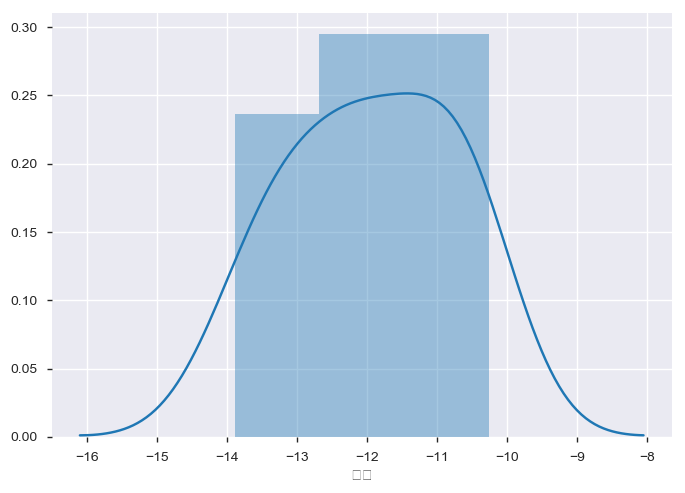

In [302]:
summary = summarys['A']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

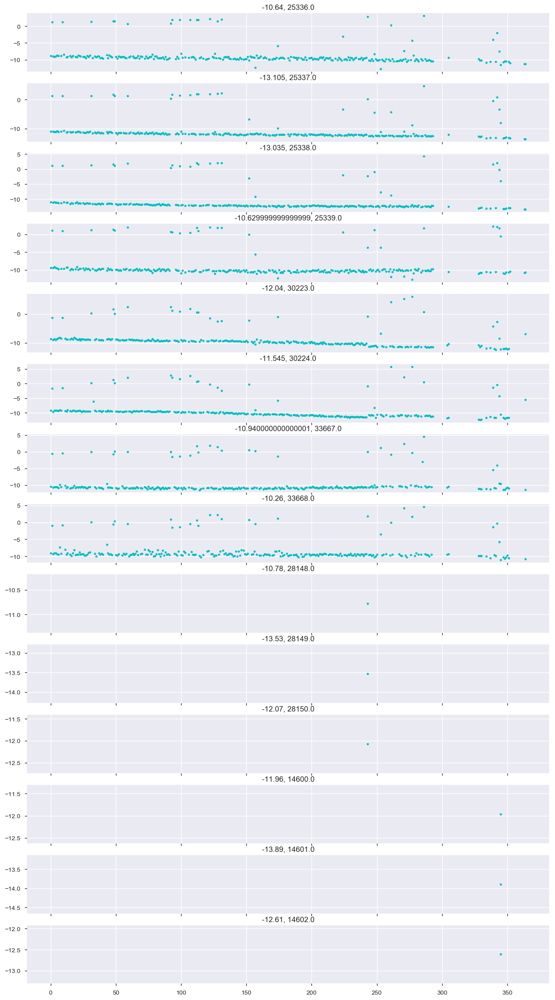

In [303]:
track = tracks['A']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['A']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

6


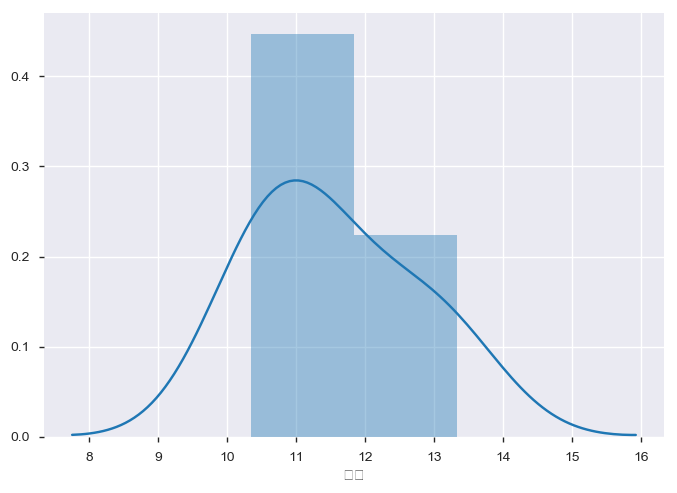

In [304]:
summary = summarys['A']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (8). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))


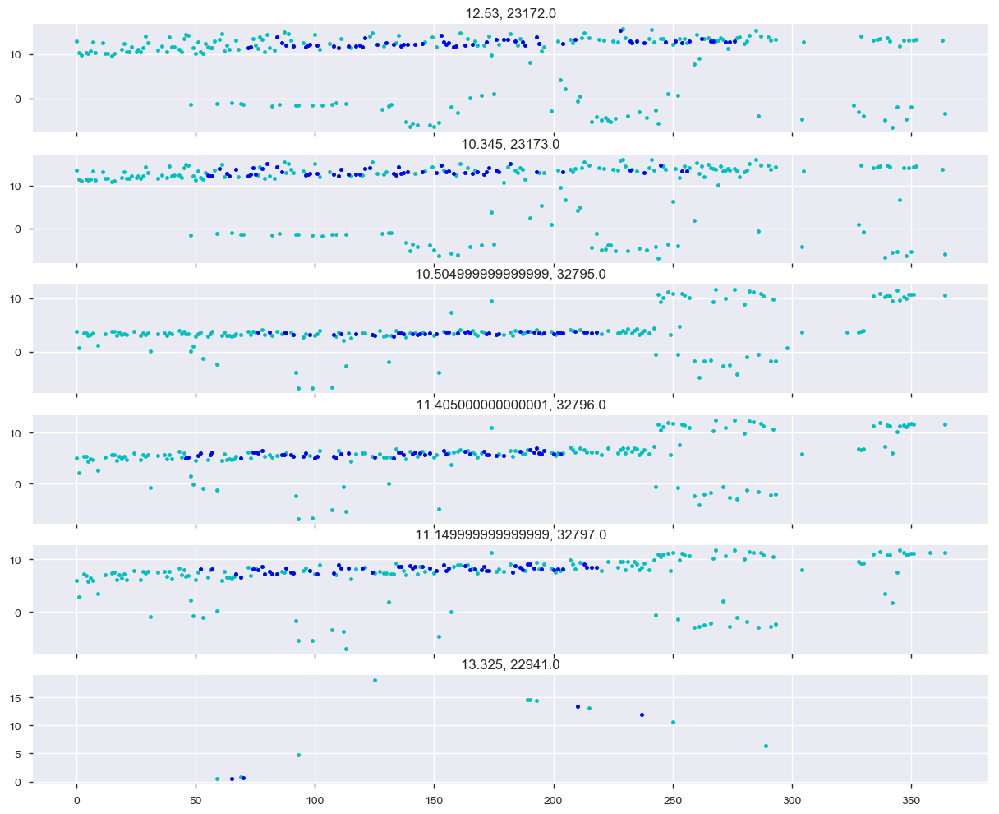

In [305]:
track = tracks['A']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['A']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

49


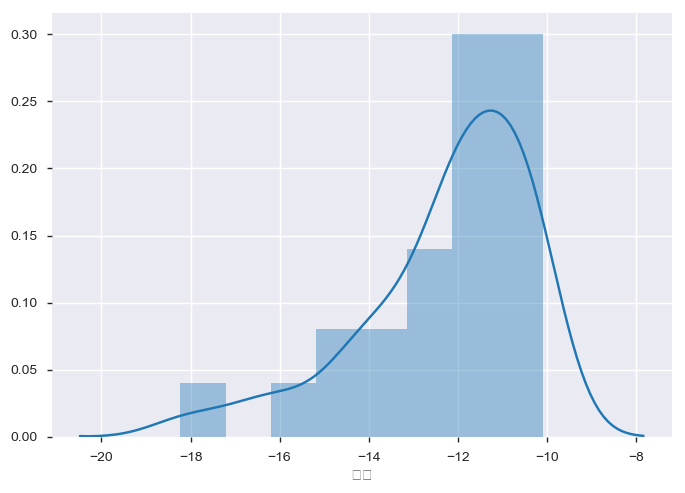

In [306]:
summary = summarys['B']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

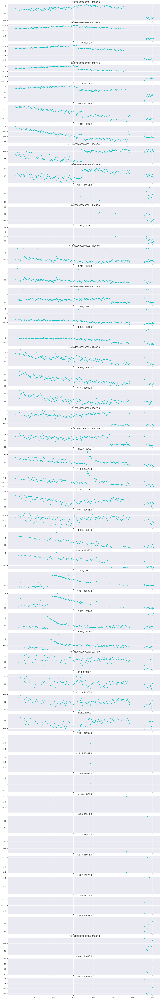

In [307]:
track = tracks['B']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['B']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

29


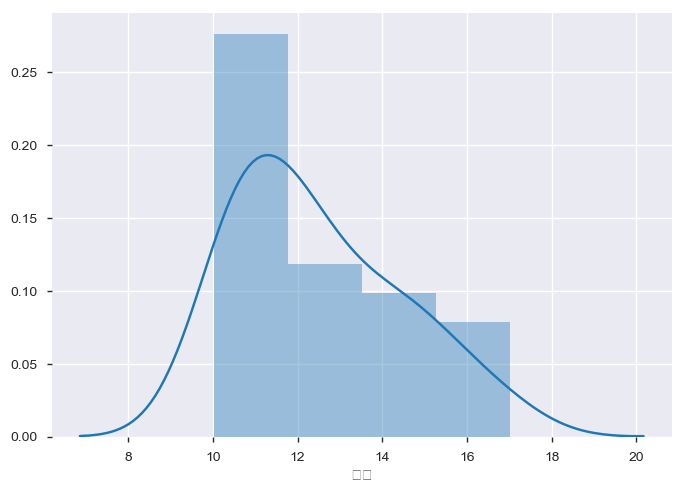

In [308]:
summary = summarys['B']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

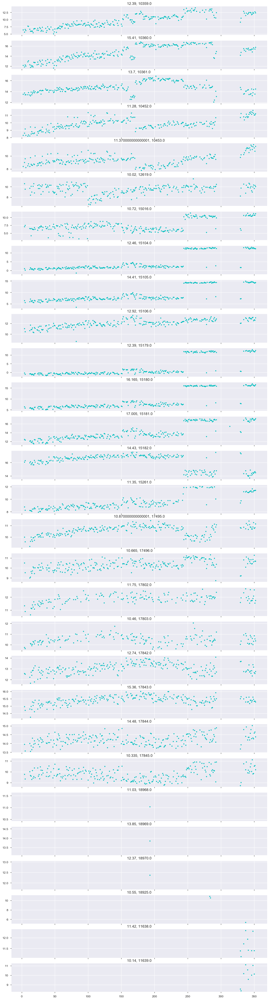

In [309]:
track = tracks['B']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['B']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

73


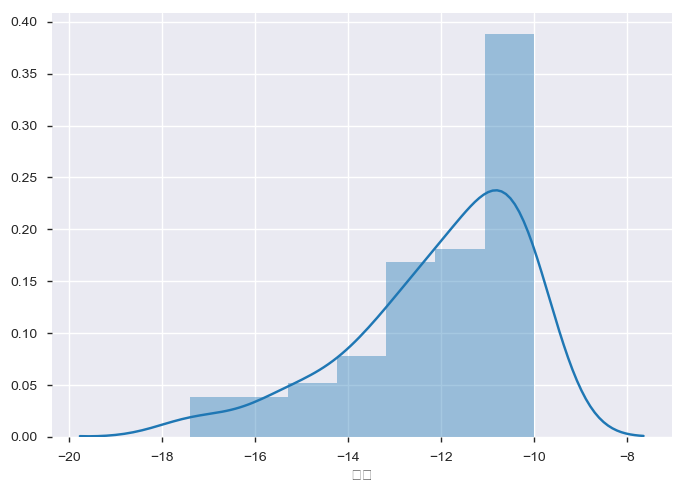

In [310]:
summary = summarys['C']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

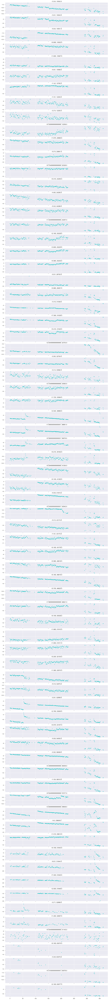

In [311]:
track = tracks['C']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['C']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

65


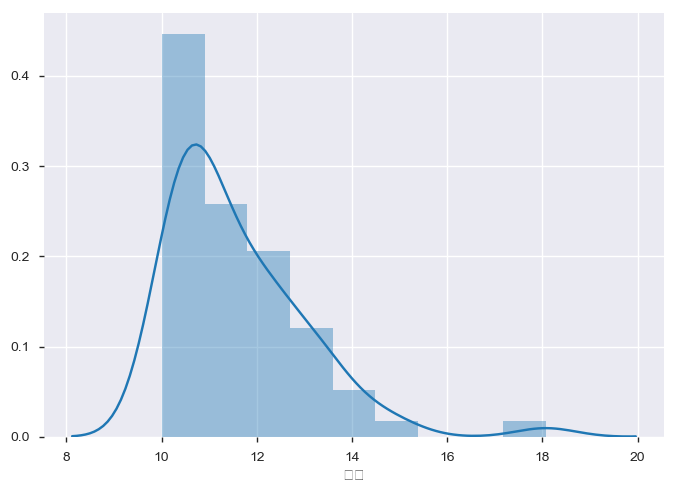

In [312]:
summary = summarys['C']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (19). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (11). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (12). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the tota

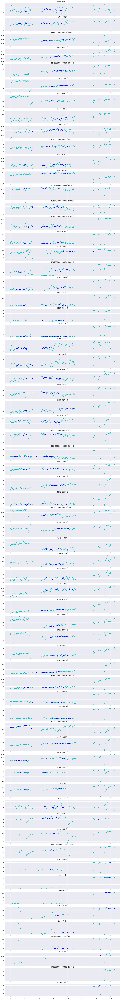

In [313]:
track = tracks['C']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['C']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

102


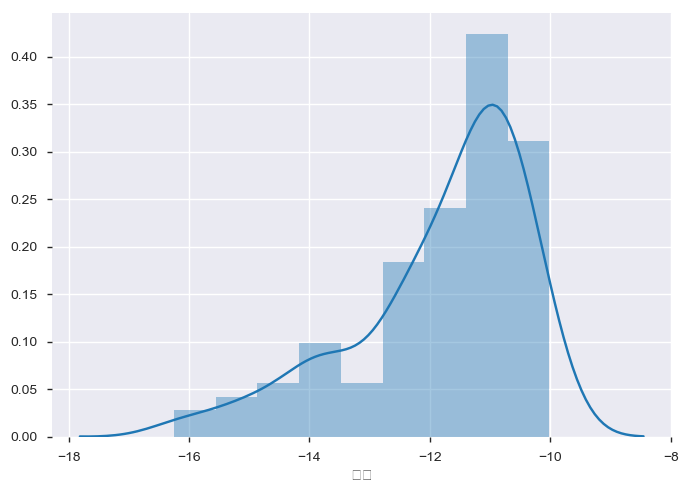

In [314]:
summary = summarys['D']
check = summary.loc[summary['切片'] < -10]
print(len(check))
sns.distplot(check['切片'])

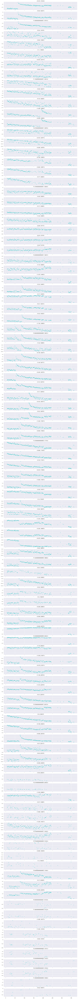

In [315]:
track = tracks['D']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['D']
check = summary.loc[summary['切片'] < -10]
check = check.reset_index(drop=True)
inters = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

#    normal_id = remove_outliers(data)
#    data = data.loc[normal_id]
#    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')
    inter = inters[i]
    axes[i].set_title(f'{inter}, {kilo}')

55


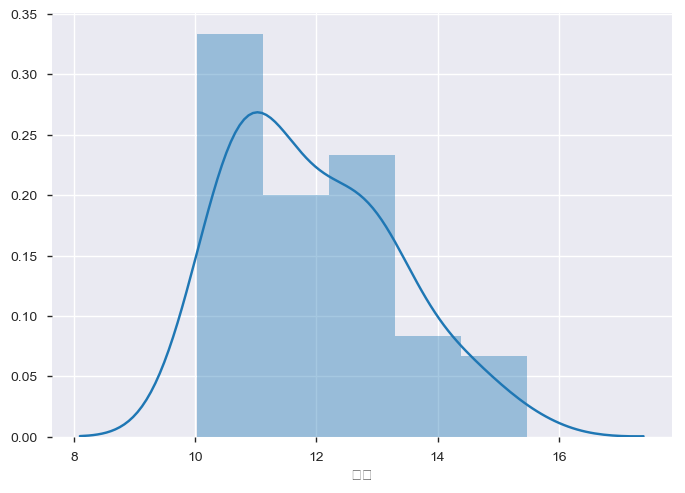

In [316]:
summary = summarys['D']
check = summary.loc[summary['切片'] > 10]
print(len(check))
sns.distplot(check['切片'])

/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (16). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (17). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total number of samples (2). n_neighbors will be set to (n_samples - 1) for estimation.
  % (self.n_neighbors, n_samples))
/Users/a0082273/.pyenv/versions/anaconda3-5.1.0/lib/python3.6/site-packages/sklearn/neighbors/lof.py:180: UserWarning: n_neighbors (20) is greater than the total

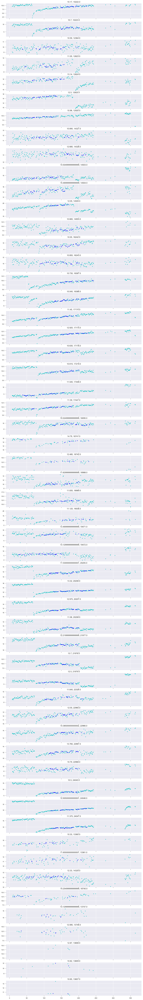

In [317]:
track = tracks['D']
track = track.dropna(subset=['高低左'])
track = track.reset_index(drop=True)
summary = summarys['D']
check = summary[summary['切片'] > 10]
check = check.reset_index(drop=True)
slopes = check['切片'].values
kilos = check['キロ程'].values
num = len(kilos)

fig, axes = plt.subplots(num, 1, figsize=(15, 2*num), sharex=True)

for i, kilo in enumerate(kilos):
    data = track.loc[track['キロ程'] == kilo, ['date', '高低左']]
    data = data.dropna(subset=['高低左'])
    data = data.reset_index(drop=True)
    data['day'] = get_day(data['date'])
    data = data.drop(['date'], axis=1)
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='c')

    normal_id = remove_outliers(data)
    data = data.loc[normal_id]
    axes[i].plot(data['day'], data['高低左'], marker='.', linewidth=0, c='b')

    slope = slopes[i]
    axes[i].set_title(f'{slope}, {kilo}')

In [348]:
%%time
submit = pd.DataFrame()
for no in ['A', 'B', 'C', 'D']:
    track = tracks[no]
    summary = summarys[no]
    summary = summary.dropna()

    sub = pd.DataFrame()
    sub['キロ程'] = track['キロ程'].unique()
    sub['路線'] = no

    kilos = summary['キロ程'].values
    inds = kilos.astype(int) - 10000

    sub.loc[inds, '傾き'] = summary['傾き'].values
    sub.loc[inds, '切片'] = summary['切片'].values
    
    submit = pd.concat([submit, sub], axis=0)
submit = submit.reset_index(drop=True)

CPU times: user 2.5 s, sys: 748 ms, total: 3.25 s
Wall time: 4.08 s


In [318]:
%%time
submit = pd.DataFrame()
for no in ['A', 'B', 'C', 'D']:
    track = tracks[no]
    summary = summarys[no]

    sub = pd.DataFrame()
    sub['キロ程'] = track['キロ程'].unique()
    sub['路線'] = no

    kilos = summary['キロ程'].values
    for i, kilo in tqdm(enumerate(kilos)):
        sub.loc[sub['キロ程'] == kilo, '傾き'] = summary.loc[i, '傾き']
        sub.loc[sub['キロ程'] == kilo, '切片'] = summary.loc[i, '切片']

    submit = pd.concat([submit, sub], axis=0)
submit = submit.reset_index(drop=True)









0it [00:00, ?it/s]







10it [00:00, 93.47it/s]







21it [00:00, 100.75it/s]







27it [00:00, 80.64it/s] 







33it [00:00, 69.04it/s]







44it [00:00, 75.36it/s]







56it [00:00, 81.69it/s]







65it [00:00, 74.14it/s]







75it [00:00, 76.73it/s]







83it [00:01, 75.69it/s]







91it [00:01, 68.22it/s]







98it [00:01, 62.73it/s]







104it [00:01, 60.75it/s]







110it [00:01, 60.22it/s]







117it [00:01, 60.29it/s]







125it [00:02, 61.12it/s]







133it [00:02, 61.66it/s]







142it [00:02, 62.91it/s]







151it [00:02, 63.89it/s]







160it [00:02, 64.57it/s]







168it [00:02, 63.72it/s]







175it [00:02, 61.75it/s]







181it [00:03, 60.09it/s]







187it [00:03, 58.96it/s]







192it [00:03, 57.23it/s]







198it [00:03, 56.97it/s]







205it [00:03, 57.34it/s]







211it [00:03, 57.33it/s]







218it [00:03, 57.58it/s]







224it [00:03, 56.98it/s]







234it [00:04, 58.05it/s]







245it [00:04, 5

2242it [00:35, 64.02it/s]







2249it [00:35, 64.01it/s]







2256it [00:35, 64.00it/s]







2263it [00:35, 64.01it/s]







2271it [00:35, 64.05it/s]







2278it [00:35, 64.05it/s]







2285it [00:35, 64.04it/s]







2292it [00:35, 64.05it/s]







2299it [00:35, 64.02it/s]







2307it [00:36, 64.05it/s]







2315it [00:36, 64.08it/s]







2323it [00:36, 64.12it/s]







2331it [00:36, 64.13it/s]







2339it [00:36, 64.18it/s]







2347it [00:36, 64.18it/s]







2355it [00:36, 64.20it/s]







2363it [00:36, 64.23it/s]







2371it [00:36, 64.22it/s]







2379it [00:37, 64.23it/s]







2386it [00:37, 64.23it/s]







2393it [00:37, 64.23it/s]







2400it [00:37, 64.23it/s]







2407it [00:37, 64.22it/s]







2415it [00:37, 64.24it/s]







2422it [00:37, 64.20it/s]







2429it [00:37, 64.21it/s]







2436it [00:37, 64.17it/s]







2443it [00:38, 64.19it/s]







2450it [00:38, 64.18it/s]







2459it [00:38, 64.22it/s]







2466it [00

4231it [01:08, 62.18it/s]







4238it [01:08, 62.19it/s]







4247it [01:08, 62.22it/s]







4255it [01:08, 62.22it/s]







4262it [01:08, 62.22it/s]







4269it [01:08, 62.23it/s]







4276it [01:08, 62.23it/s]







4284it [01:08, 62.25it/s]







4291it [01:08, 62.24it/s]







4298it [01:09, 62.23it/s]







4306it [01:09, 62.25it/s]







4314it [01:09, 62.27it/s]







4322it [01:09, 62.29it/s]







4330it [01:09, 62.30it/s]







4339it [01:09, 62.32it/s]







4347it [01:09, 62.34it/s]







4355it [01:09, 62.34it/s]







4363it [01:09, 62.33it/s]







4370it [01:10, 62.34it/s]







4377it [01:10, 62.35it/s]







4384it [01:10, 62.34it/s]







4391it [01:10, 62.35it/s]







4398it [01:10, 62.34it/s]







4405it [01:10, 62.32it/s]







4412it [01:10, 62.31it/s]







4418it [01:10, 62.30it/s]







4426it [01:11, 62.32it/s]







4434it [01:11, 62.33it/s]







4441it [01:11, 62.31it/s]







4448it [01:11, 62.31it/s]







4455it [01

6525it [01:41, 64.20it/s]







6535it [01:41, 64.22it/s]







6543it [01:41, 64.21it/s]







6550it [01:42, 64.21it/s]







6558it [01:42, 64.23it/s]







6566it [01:42, 64.24it/s]







6576it [01:42, 64.27it/s]







6584it [01:42, 64.27it/s]







6592it [01:42, 64.29it/s]







6600it [01:42, 64.29it/s]







6608it [01:42, 64.30it/s]







6616it [01:42, 64.28it/s]







6623it [01:43, 64.28it/s]







6631it [01:43, 64.29it/s]







6638it [01:43, 64.29it/s]







6645it [01:43, 64.28it/s]







6652it [01:43, 64.28it/s]







6659it [01:43, 64.28it/s]







6666it [01:43, 64.28it/s]







6673it [01:43, 64.27it/s]







6680it [01:43, 64.26it/s]







6687it [01:44, 64.26it/s]







6694it [01:44, 64.27it/s]







6701it [01:44, 64.27it/s]







6708it [01:44, 64.27it/s]







6716it [01:44, 64.28it/s]







6723it [01:44, 64.28it/s]







6733it [01:44, 64.30it/s]







6741it [01:44, 64.30it/s]







6749it [01:44, 64.31it/s]







6757it [01

8572it [02:16, 62.77it/s]







8582it [02:16, 62.79it/s]







8591it [02:16, 62.81it/s]







8600it [02:16, 62.82it/s]







8609it [02:17, 62.84it/s]







8618it [02:17, 62.85it/s]







8629it [02:17, 62.88it/s]







8639it [02:17, 62.90it/s]







8649it [02:17, 62.92it/s]







8658it [02:17, 62.94it/s]







8668it [02:17, 62.97it/s]







8678it [02:17, 62.99it/s]







8687it [02:17, 63.00it/s]







8696it [02:17, 63.02it/s]







8705it [02:18, 63.04it/s]







8714it [02:18, 63.05it/s]







8723it [02:18, 63.05it/s]







8731it [02:18, 63.01it/s]







8738it [02:18, 62.95it/s]







8744it [02:18, 62.92it/s]







8749it [02:19, 62.90it/s]







8755it [02:19, 62.89it/s]







8761it [02:19, 62.88it/s]







8767it [02:19, 62.87it/s]







8776it [02:19, 62.89it/s]







8784it [02:19, 62.90it/s]







8794it [02:19, 62.92it/s]







8802it [02:19, 62.93it/s]







8812it [02:19, 62.95it/s]







8822it [02:20, 62.98it/s]







8832it [02

10598it [02:52, 61.43it/s]







10605it [02:52, 61.43it/s]







10614it [02:52, 61.44it/s]







10621it [02:52, 61.44it/s]







10628it [02:52, 61.44it/s]







10635it [02:53, 61.44it/s]







10643it [02:53, 61.45it/s]







10650it [02:53, 61.45it/s]







10657it [02:53, 61.44it/s]







10664it [02:53, 61.45it/s]







10673it [02:53, 61.46it/s]







10680it [02:53, 61.45it/s]







10687it [02:53, 61.44it/s]







10694it [02:54, 61.44it/s]







10701it [02:54, 61.44it/s]







10708it [02:54, 61.44it/s]







10715it [02:54, 61.43it/s]







10721it [02:54, 61.42it/s]







10727it [02:54, 61.41it/s]







10733it [02:55, 61.31it/s]







10738it [02:55, 61.18it/s]







10742it [02:55, 61.14it/s]







10745it [02:55, 61.12it/s]







10749it [02:56, 61.06it/s]







10752it [02:56, 60.99it/s]







10758it [02:56, 60.99it/s]







10762it [02:56, 60.95it/s]







10765it [02:56, 60.93it/s]







10772it [02:56, 60.93it/s]







10778it [02:56

12912it [03:28, 61.96it/s]







12920it [03:28, 61.96it/s]







12928it [03:28, 61.97it/s]







12937it [03:28, 61.98it/s]







12951it [03:28, 62.01it/s]







12967it [03:28, 62.05it/s]







12981it [03:29, 62.09it/s]







12997it [03:29, 62.14it/s]







13013it [03:29, 62.18it/s]







13029it [03:29, 62.23it/s]







13046it [03:29, 62.28it/s]







13063it [03:29, 62.33it/s]







13079it [03:29, 62.37it/s]







13095it [03:29, 62.42it/s]







13111it [03:29, 62.46it/s]







13127it [03:30, 62.51it/s]







13144it [03:30, 62.56it/s]







13161it [03:30, 62.61it/s]







13177it [03:30, 62.65it/s]







13194it [03:30, 62.70it/s]







13211it [03:30, 62.69it/s]







13224it [03:31, 62.67it/s]







13235it [03:31, 62.63it/s]







13244it [03:31, 62.61it/s]







13252it [03:31, 62.61it/s]







13259it [03:31, 62.61it/s]







13266it [03:31, 62.61it/s]







13274it [03:31, 62.62it/s]







13282it [03:32, 62.62it/s]







13290it [03:32

15144it [04:02, 62.32it/s]







15150it [04:03, 62.32it/s]







15155it [04:03, 62.31it/s]







15160it [04:03, 62.30it/s]







15165it [04:03, 62.29it/s]







15170it [04:03, 62.25it/s]







15174it [04:03, 62.24it/s]







15178it [04:03, 62.21it/s]







15182it [04:04, 62.17it/s]







15185it [04:04, 62.16it/s]







15188it [04:04, 62.14it/s]







15192it [04:04, 62.13it/s]







15196it [04:04, 62.12it/s]







15202it [04:04, 62.12it/s]







15208it [04:04, 62.10it/s]







15215it [04:04, 62.10it/s]







15222it [04:05, 62.11it/s]







15228it [04:05, 62.10it/s]







15234it [04:05, 62.10it/s]







15241it [04:05, 62.10it/s]







15248it [04:05, 62.10it/s]







15254it [04:05, 62.09it/s]







15262it [04:05, 62.10it/s]







15269it [04:05, 62.09it/s]







15275it [04:06, 62.09it/s]







15281it [04:06, 62.09it/s]







15289it [04:06, 62.09it/s]







15297it [04:06, 62.10it/s]







15304it [04:06, 62.09it/s]







15311it [04:06

17116it [04:38, 61.53it/s]







17123it [04:38, 61.49it/s]







17131it [04:38, 61.49it/s]







17143it [04:38, 61.51it/s]







17153it [04:38, 61.53it/s]







17162it [04:38, 61.52it/s]







17171it [04:39, 61.53it/s]







17179it [04:39, 61.53it/s]







17187it [04:39, 61.53it/s]







17196it [04:39, 61.54it/s]







17208it [04:39, 61.56it/s]







17220it [04:39, 61.58it/s]







17232it [04:39, 61.60it/s]







17245it [04:39, 61.62it/s]







17256it [04:39, 61.63it/s]







17269it [04:40, 61.65it/s]







17281it [04:40, 61.67it/s]







17294it [04:40, 61.70it/s]







17307it [04:40, 61.72it/s]







17320it [04:40, 61.75it/s]







17333it [04:40, 61.77it/s]







17346it [04:40, 61.79it/s]







17359it [04:41, 61.74it/s]







17369it [04:41, 61.74it/s]







17381it [04:41, 61.76it/s]







17391it [04:41, 61.77it/s]







17401it [04:41, 61.75it/s]







17409it [04:41, 61.74it/s]







17416it [04:42, 61.73it/s]







17425it [04:42

20441it [05:16, 64.48it/s]







20457it [05:17, 64.51it/s]







20473it [05:17, 64.54it/s]







20488it [05:17, 64.57it/s]







20505it [05:17, 64.60it/s]







20522it [05:17, 64.63it/s]







20538it [05:17, 64.66it/s]







20554it [05:17, 64.67it/s]







20568it [05:17, 64.69it/s]







20584it [05:18, 64.72it/s]







20598it [05:18, 64.71it/s]







20610it [05:18, 64.72it/s]







20624it [05:18, 64.75it/s]







20636it [05:18, 64.75it/s]







20647it [05:18, 64.77it/s]







20660it [05:18, 64.79it/s]







20676it [05:18, 64.82it/s]







20690it [05:19, 64.84it/s]







20703it [05:19, 64.84it/s]







20718it [05:19, 64.87it/s]







20733it [05:19, 64.89it/s]







20746it [05:19, 64.90it/s]







20758it [05:19, 64.91it/s]







20771it [05:19, 64.93it/s]







20783it [05:20, 64.94it/s]







20794it [05:20, 64.94it/s]







20810it [05:20, 64.97it/s]







20825it [05:20, 65.00it/s]







20838it [05:20, 65.00it/s]







20852it [05:20

23707it [05:51, 67.35it/s]







23714it [05:52, 67.34it/s]







23721it [05:52, 67.34it/s]







23731it [05:52, 67.35it/s]







23740it [05:52, 67.35it/s]







23748it [05:52, 67.34it/s]







23755it [05:52, 67.33it/s]







23762it [05:53, 67.30it/s]







23769it [05:53, 67.30it/s]







23775it [05:53, 67.29it/s]







23781it [05:53, 67.27it/s]







23786it [05:53, 67.25it/s]







23791it [05:53, 67.23it/s]







23795it [05:54, 67.22it/s]







23802it [05:54, 67.21it/s]







23811it [05:54, 67.22it/s]







23823it [05:54, 67.23it/s]







23831it [05:54, 67.24it/s]







23840it [05:54, 67.24it/s]







23851it [05:54, 67.25it/s]







23863it [05:54, 67.26it/s]







23873it [05:54, 67.27it/s]







23884it [05:54, 67.28it/s]







23896it [05:55, 67.30it/s]







23907it [05:55, 67.31it/s]







23918it [05:55, 67.31it/s]







23928it [05:55, 67.31it/s]







23937it [05:55, 67.32it/s]







23948it [05:55, 67.33it/s]







23962it [05:55

25708it [06:29, 66.08it/s]







25717it [06:29, 66.08it/s]







25723it [06:29, 66.07it/s]







25731it [06:29, 66.07it/s]







25737it [06:29, 66.07it/s]







25743it [06:29, 66.07it/s]







25749it [06:29, 66.06it/s]







25755it [06:29, 66.06it/s]







25762it [06:29, 66.06it/s]







25768it [06:30, 66.04it/s]







25773it [06:30, 66.02it/s]







25778it [06:30, 66.00it/s]







25782it [06:30, 65.99it/s]







25787it [06:30, 65.99it/s]







25794it [06:30, 65.99it/s]







25800it [06:31, 65.98it/s]







25805it [06:31, 65.96it/s]







25810it [06:31, 65.95it/s]







25815it [06:31, 65.95it/s]







25821it [06:31, 65.95it/s]







25828it [06:31, 65.94it/s]







25833it [06:31, 65.94it/s]







25838it [06:31, 65.92it/s]







25843it [06:32, 65.92it/s]







25850it [06:32, 65.91it/s]







25856it [06:32, 65.91it/s]







25863it [06:32, 65.91it/s]







25871it [06:32, 65.91it/s]







25879it [06:32, 65.92it/s]







25886it [06:32

27696it [07:05, 65.08it/s]







27700it [07:05, 65.07it/s]







27710it [07:05, 65.08it/s]







27716it [07:05, 65.06it/s]







27723it [07:06, 65.06it/s]







27729it [07:06, 65.06it/s]







27736it [07:06, 65.06it/s]







27742it [07:06, 65.06it/s]







27749it [07:06, 65.06it/s]







27755it [07:06, 65.06it/s]







27761it [07:06, 65.05it/s]







27767it [07:07, 65.01it/s]







27772it [07:07, 65.01it/s]







27778it [07:07, 65.01it/s]







27783it [07:07, 64.99it/s]







27788it [07:07, 64.99it/s]







27794it [07:07, 64.99it/s]







27801it [07:07, 64.98it/s]







27807it [07:07, 64.98it/s]







27812it [07:08, 64.97it/s]







27818it [07:08, 64.97it/s]







27825it [07:08, 64.97it/s]







27831it [07:08, 64.97it/s]







27837it [07:08, 64.96it/s]







27843it [07:08, 64.96it/s]







27850it [07:08, 64.96it/s]







27856it [07:08, 64.96it/s]







27862it [07:08, 64.95it/s]







27868it [07:09, 64.95it/s]







27874it [07:09

707it [00:13, 51.58it/s]







716it [00:13, 51.85it/s]







723it [00:13, 51.84it/s]







730it [00:14, 51.93it/s]







737it [00:14, 52.03it/s]







744it [00:14, 52.08it/s]







751it [00:14, 52.14it/s]







758it [00:14, 52.24it/s]







768it [00:14, 52.57it/s]







776it [00:14, 52.58it/s]







783it [00:14, 52.58it/s]







790it [00:14, 52.70it/s]







797it [00:15, 52.75it/s]







804it [00:15, 52.80it/s]







811it [00:15, 52.90it/s]







818it [00:15, 52.91it/s]







827it [00:15, 53.07it/s]







834it [00:15, 53.07it/s]







841it [00:15, 53.09it/s]







847it [00:15, 53.09it/s]







856it [00:16, 53.31it/s]







863it [00:16, 53.38it/s]







871it [00:16, 53.53it/s]







880it [00:16, 53.64it/s]







887it [00:16, 53.70it/s]







894it [00:16, 53.66it/s]







902it [00:16, 53.70it/s]







909it [00:16, 53.78it/s]







918it [00:17, 53.97it/s]







925it [00:17, 53.98it/s]







933it [00:17, 54.11it/s]







941it [0

2912it [00:48, 59.48it/s]







2920it [00:49, 59.48it/s]







2927it [00:49, 59.33it/s]







2933it [00:49, 59.19it/s]







2938it [00:49, 59.12it/s]







2943it [00:49, 59.00it/s]







2949it [00:50, 58.97it/s]







2954it [00:50, 58.90it/s]







2959it [00:50, 58.89it/s]







2965it [00:50, 58.87it/s]







2970it [00:50, 58.79it/s]







2975it [00:50, 58.73it/s]







2980it [00:50, 58.57it/s]







2984it [00:50, 58.51it/s]







2991it [00:51, 58.52it/s]







2997it [00:51, 58.52it/s]







3006it [00:51, 58.56it/s]







3013it [00:51, 58.55it/s]







3019it [00:51, 58.55it/s]







3026it [00:51, 58.57it/s]







3032it [00:51, 58.47it/s]







3038it [00:52, 58.38it/s]







3043it [00:52, 58.35it/s]







3048it [00:52, 58.34it/s]







3057it [00:52, 58.39it/s]







3065it [00:52, 58.42it/s]







3072it [00:52, 58.40it/s]







3081it [00:52, 58.46it/s]







3088it [00:53, 58.06it/s]







3094it [00:53, 58.01it/s]







3102it [00

5061it [01:24, 59.70it/s]







5069it [01:24, 59.71it/s]







5078it [01:25, 59.74it/s]







5087it [01:25, 59.77it/s]







5097it [01:25, 59.81it/s]







5106it [01:25, 59.83it/s]







5116it [01:25, 59.87it/s]







5125it [01:25, 59.89it/s]







5134it [01:25, 59.92it/s]







5143it [01:25, 59.93it/s]







5153it [01:25, 59.97it/s]







5162it [01:26, 60.00it/s]







5171it [01:26, 60.03it/s]







5181it [01:26, 60.07it/s]







5190it [01:26, 60.09it/s]







5199it [01:26, 60.12it/s]







5208it [01:26, 60.14it/s]







5217it [01:26, 60.17it/s]







5226it [01:26, 60.18it/s]







5234it [01:26, 60.20it/s]







5242it [01:27, 60.22it/s]







5250it [01:27, 60.24it/s]







5261it [01:27, 60.29it/s]







5270it [01:27, 60.29it/s]







5278it [01:27, 60.30it/s]







5286it [01:27, 60.31it/s]







5294it [01:27, 60.32it/s]







5302it [01:27, 60.34it/s]







5310it [01:27, 60.35it/s]







5317it [01:28, 60.35it/s]







5324it [01

7343it [01:59, 61.28it/s]







7349it [01:59, 61.27it/s]







7356it [02:00, 61.27it/s]







7362it [02:00, 61.26it/s]







7369it [02:00, 61.26it/s]







7375it [02:00, 61.26it/s]







7381it [02:00, 61.25it/s]







7387it [02:00, 61.25it/s]







7393it [02:00, 61.23it/s]







7399it [02:00, 61.22it/s]







7405it [02:00, 61.21it/s]







7411it [02:01, 61.20it/s]







7417it [02:01, 61.20it/s]







7423it [02:01, 61.20it/s]







7429it [02:01, 61.19it/s]







7435it [02:01, 61.19it/s]







7441it [02:01, 61.18it/s]







7447it [02:01, 61.16it/s]







7453it [02:01, 61.15it/s]







7460it [02:01, 61.15it/s]







7467it [02:02, 61.16it/s]







7473it [02:02, 61.15it/s]







7479it [02:02, 61.13it/s]







7485it [02:02, 61.12it/s]







7491it [02:02, 61.12it/s]







7497it [02:02, 61.11it/s]







7503it [02:02, 61.09it/s]







7509it [02:02, 61.08it/s]







7515it [02:03, 61.07it/s]







7521it [02:03, 61.06it/s]







7527it [02

9191it [02:34, 59.61it/s]







9198it [02:34, 59.61it/s]







9205it [02:34, 59.61it/s]







9213it [02:34, 59.62it/s]







9220it [02:34, 59.62it/s]







9227it [02:34, 59.63it/s]







9235it [02:34, 59.63it/s]







9242it [02:34, 59.64it/s]







9249it [02:35, 59.64it/s]







9256it [02:35, 59.64it/s]







9263it [02:35, 59.64it/s]







9270it [02:35, 59.64it/s]







9278it [02:35, 59.65it/s]







9285it [02:35, 59.65it/s]







9292it [02:35, 59.66it/s]







9301it [02:35, 59.67it/s]







9309it [02:35, 59.68it/s]







9317it [02:36, 59.68it/s]







9324it [02:36, 59.69it/s]







9331it [02:36, 59.69it/s]







9338it [02:36, 59.68it/s]







9345it [02:36, 59.68it/s]







9351it [02:36, 59.65it/s]







9357it [02:36, 59.64it/s]







9363it [02:37, 59.63it/s]







9370it [02:37, 59.64it/s]







9379it [02:37, 59.65it/s]







9387it [02:37, 59.66it/s]







9395it [02:37, 59.68it/s]







9403it [02:37, 59.69it/s]







9411it [02

12497it [03:07, 66.52it/s]







12511it [03:07, 66.55it/s]







12525it [03:08, 66.59it/s]







12540it [03:08, 66.63it/s]







12555it [03:08, 66.68it/s]







12570it [03:08, 66.72it/s]







12585it [03:08, 66.76it/s]







12600it [03:08, 66.81it/s]







12615it [03:08, 66.79it/s]







12627it [03:08, 66.82it/s]







12639it [03:09, 66.75it/s]







12649it [03:09, 66.75it/s]







12658it [03:09, 66.70it/s]







12665it [03:09, 66.67it/s]







12671it [03:10, 66.65it/s]







12678it [03:10, 66.65it/s]







12684it [03:10, 66.64it/s]







12690it [03:10, 66.62it/s]







12699it [03:10, 66.63it/s]







12714it [03:10, 66.68it/s]







12727it [03:10, 66.71it/s]







12740it [03:10, 66.74it/s]







12751it [03:11, 66.75it/s]







12761it [03:11, 66.76it/s]







12771it [03:11, 66.78it/s]







12781it [03:11, 66.78it/s]







12793it [03:11, 66.81it/s]







12805it [03:11, 66.84it/s]







12816it [03:11, 66.85it/s]







12827it [03:11

16532it [03:38, 75.50it/s]







16547it [03:39, 75.54it/s]







16563it [03:39, 75.58it/s]







16578it [03:39, 75.61it/s]







16593it [03:39, 75.64it/s]







16608it [03:39, 75.67it/s]







16623it [03:39, 75.71it/s]







16638it [03:39, 75.74it/s]







16653it [03:39, 75.77it/s]







16668it [03:39, 75.78it/s]







16681it [03:40, 75.79it/s]







16693it [03:40, 75.80it/s]







16704it [03:40, 75.80it/s]







16717it [03:40, 75.82it/s]







16731it [03:40, 75.85it/s]







16746it [03:40, 75.88it/s]







16760it [03:40, 75.91it/s]







16773it [03:40, 75.93it/s]







16786it [03:41, 75.95it/s]







16801it [03:41, 75.98it/s]







16816it [03:41, 76.02it/s]







16831it [03:41, 76.05it/s]







16846it [03:41, 76.08it/s]







16861it [03:41, 76.11it/s]







16876it [03:41, 76.15it/s]







16891it [03:41, 76.18it/s]







16906it [03:41, 76.21it/s]







16921it [03:41, 76.24it/s]







16937it [03:42, 76.28it/s]







16952it [03:42

20534it [04:11, 81.77it/s]







20548it [04:11, 81.80it/s]







20563it [04:11, 81.82it/s]







20577it [04:11, 81.84it/s]







20593it [04:11, 81.87it/s]







20609it [04:11, 81.90it/s]







20624it [04:11, 81.93it/s]







20639it [04:11, 81.95it/s]







20655it [04:11, 81.98it/s]







20671it [04:12, 82.01it/s]







20687it [04:12, 82.04it/s]







20703it [04:12, 82.07it/s]







20718it [04:12, 82.08it/s]







20733it [04:12, 82.11it/s]







20747it [04:12, 82.13it/s]







20761it [04:12, 82.14it/s]







20774it [04:12, 82.16it/s]







20790it [04:12, 82.19it/s]







20807it [04:13, 82.22it/s]







20824it [04:13, 82.26it/s]







20841it [04:13, 82.29it/s]







20857it [04:13, 82.32it/s]







20873it [04:13, 82.35it/s]







20890it [04:13, 82.38it/s]







20907it [04:13, 82.41it/s]







20923it [04:13, 82.44it/s]







20939it [04:13, 82.47it/s]







20955it [04:14, 82.50it/s]







20972it [04:14, 82.53it/s]







20989it [04:14

3217it [00:24, 133.69it/s]







3232it [00:24, 133.75it/s]







3247it [00:24, 133.79it/s]







3262it [00:24, 133.83it/s]







3277it [00:24, 133.88it/s]







3292it [00:24, 133.90it/s]







3307it [00:24, 133.83it/s]







3321it [00:24, 133.84it/s]







3337it [00:24, 133.91it/s]







3352it [00:25, 133.91it/s]







3366it [00:25, 133.93it/s]







3381it [00:25, 133.99it/s]







3396it [00:25, 134.00it/s]







3411it [00:25, 133.96it/s]







3425it [00:25, 133.96it/s]







3439it [00:25, 133.93it/s]







3453it [00:25, 133.87it/s]







3467it [00:25, 133.88it/s]







3481it [00:26, 133.86it/s]







3495it [00:26, 133.83it/s]







3508it [00:26, 133.81it/s]







3522it [00:26, 133.82it/s]







3536it [00:26, 133.79it/s]







3550it [00:26, 133.79it/s]







3564it [00:26, 133.81it/s]







3578it [00:26, 133.82it/s]







3592it [00:26, 133.80it/s]







3607it [00:26, 133.83it/s]







3621it [00:27, 133.66it/s]







3635it [00:27,

6885it [00:57, 120.67it/s]







6891it [00:57, 120.42it/s]







6896it [00:57, 120.24it/s]







6901it [00:57, 120.09it/s]







6906it [00:57, 119.86it/s]







6911it [00:57, 119.74it/s]







6916it [00:57, 119.58it/s]







6922it [00:57, 119.47it/s]







6928it [00:58, 119.36it/s]







6936it [00:58, 119.28it/s]







6945it [00:58, 119.23it/s]







6952it [00:58, 119.14it/s]







6962it [00:58, 119.09it/s]







6972it [00:58, 119.04it/s]







6981it [00:58, 118.87it/s]







6989it [00:58, 118.62it/s]







6996it [00:59, 118.53it/s]







7008it [00:59, 118.53it/s]







7017it [00:59, 118.32it/s]







7025it [00:59, 118.24it/s]







7033it [00:59, 118.11it/s]







7040it [00:59, 118.00it/s]







7047it [00:59, 117.86it/s]







7054it [00:59, 117.76it/s]







7061it [01:00, 117.53it/s]







7067it [01:00, 117.41it/s]







7073it [01:00, 117.26it/s]







7080it [01:00, 117.16it/s]







7086it [01:00, 117.05it/s]







7092it [01:00,

8775it [01:31, 96.40it/s]







8781it [01:31, 96.35it/s]







8789it [01:31, 96.33it/s]







8799it [01:31, 96.33it/s]







8811it [01:31, 96.35it/s]







8820it [01:31, 96.26it/s]







8828it [01:31, 96.20it/s]







8839it [01:31, 96.21it/s]







8852it [01:31, 96.25it/s]







8863it [01:32, 96.25it/s]







8876it [01:32, 96.29it/s]







8889it [01:32, 96.32it/s]







8902it [01:32, 96.35it/s]







8914it [01:32, 96.37it/s]







8926it [01:32, 96.33it/s]







8937it [01:32, 96.26it/s]







8946it [01:33, 96.18it/s]







8954it [01:33, 96.14it/s]







8962it [01:33, 96.04it/s]







8969it [01:33, 96.01it/s]







8976it [01:33, 95.95it/s]







8983it [01:33, 95.89it/s]







8989it [01:33, 95.84it/s]







8995it [01:33, 95.75it/s]







9001it [01:34, 95.67it/s]







9006it [01:34, 95.60it/s]







9012it [01:34, 95.56it/s]







9018it [01:34, 95.51it/s]







9024it [01:34, 95.46it/s]







9033it [01:34, 95.45it/s]







9041it [01

11990it [02:08, 93.63it/s]







11999it [02:08, 93.62it/s]







12008it [02:08, 93.56it/s]







12016it [02:08, 93.45it/s]







12025it [02:08, 93.44it/s]







12036it [02:08, 93.45it/s]







12047it [02:08, 93.46it/s]







12057it [02:09, 93.46it/s]







12067it [02:09, 93.46it/s]







12077it [02:09, 93.46it/s]







12087it [02:09, 93.45it/s]







12096it [02:09, 93.27it/s]







12104it [02:09, 93.17it/s]







12111it [02:10, 93.14it/s]







12118it [02:10, 93.08it/s]







12124it [02:10, 93.03it/s]







12130it [02:10, 92.97it/s]







12135it [02:10, 92.91it/s]







12142it [02:10, 92.89it/s]







12148it [02:10, 92.80it/s]







12158it [02:11, 92.79it/s]







12164it [02:11, 92.75it/s]







12170it [02:11, 92.72it/s]







12183it [02:11, 92.74it/s]







12191it [02:11, 92.64it/s]







12198it [02:11, 92.62it/s]







12208it [02:11, 92.60it/s]







12216it [02:11, 92.57it/s]







12223it [02:12, 92.36it/s]







12229it [02:12

14904it [02:45, 90.10it/s]







14919it [02:45, 90.14it/s]







14934it [02:45, 90.17it/s]







14948it [02:45, 90.18it/s]







14961it [02:45, 90.16it/s]







14973it [02:46, 90.16it/s]







14984it [02:46, 90.09it/s]







14993it [02:46, 90.08it/s]







15008it [02:46, 90.11it/s]







15023it [02:46, 90.15it/s]







15037it [02:46, 90.18it/s]







15050it [02:46, 90.13it/s]







15061it [02:47, 90.14it/s]







15076it [02:47, 90.17it/s]







15091it [02:47, 90.20it/s]







15106it [02:47, 90.24it/s]







15120it [02:47, 90.26it/s]







15134it [02:47, 90.22it/s]







15145it [02:47, 90.22it/s]







15156it [02:47, 90.23it/s]







15167it [02:48, 90.24it/s]







15181it [02:48, 90.26it/s]







15193it [02:48, 90.25it/s]







15204it [02:48, 90.20it/s]







15218it [02:48, 90.23it/s]







15234it [02:48, 90.27it/s]







15246it [02:48, 90.28it/s]







15258it [02:49, 90.23it/s]







15273it [02:49, 90.26it/s]







15288it [02:49

18338it [03:21, 90.89it/s]







18342it [03:21, 90.85it/s]







18346it [03:22, 90.78it/s]







18352it [03:22, 90.77it/s]







18359it [03:22, 90.75it/s]







18373it [03:22, 90.78it/s]







18386it [03:22, 90.80it/s]







18397it [03:22, 90.80it/s]







18410it [03:22, 90.82it/s]







18425it [03:22, 90.85it/s]







18439it [03:22, 90.87it/s]







18452it [03:23, 90.88it/s]







18464it [03:23, 90.89it/s]







18478it [03:23, 90.92it/s]







18493it [03:23, 90.94it/s]







18508it [03:23, 90.97it/s]







18522it [03:23, 90.96it/s]







18537it [03:23, 90.99it/s]







18552it [03:23, 91.02it/s]







18568it [03:23, 91.05it/s]







18582it [03:24, 91.07it/s]







18597it [03:24, 91.10it/s]







18611it [03:24, 91.12it/s]







18625it [03:24, 91.05it/s]







18636it [03:24, 91.01it/s]







18646it [03:24, 91.00it/s]







18657it [03:25, 91.00it/s]







18672it [03:25, 91.03it/s]







18688it [03:25, 91.06it/s]







18703it [03:25

22038it [03:56, 93.06it/s]







22053it [03:56, 93.08it/s]







22068it [03:57, 93.10it/s]







22083it [03:57, 93.13it/s]







22099it [03:57, 93.15it/s]







22115it [03:57, 93.18it/s]







22130it [03:57, 93.20it/s]







22145it [03:57, 93.22it/s]







22160it [03:57, 93.25it/s]







22175it [03:57, 93.27it/s]







22190it [03:57, 93.28it/s]







22204it [03:58, 93.27it/s]







22217it [03:58, 93.28it/s]







22232it [03:58, 93.30it/s]







22245it [03:58, 93.31it/s]







22258it [03:58, 93.32it/s]







22272it [03:58, 93.33it/s]







22286it [03:58, 93.35it/s]







22300it [03:58, 93.37it/s]







22315it [03:58, 93.39it/s]







22329it [03:59, 93.39it/s]







22342it [03:59, 93.41it/s]







22356it [03:59, 93.42it/s]







22371it [03:59, 93.45it/s]







22385it [03:59, 93.47it/s]







22400it [03:59, 93.49it/s]







22415it [03:59, 93.51it/s]







22430it [03:59, 93.53it/s]







22445it [03:59, 93.56it/s]







22460it [04:00

25907it [04:30, 95.76it/s]







25920it [04:30, 95.77it/s]







25935it [04:30, 95.79it/s]







25951it [04:30, 95.82it/s]







25965it [04:30, 95.83it/s]







25979it [04:31, 95.83it/s]







25993it [04:31, 95.85it/s]







26008it [04:31, 95.87it/s]







26023it [04:31, 95.89it/s]







26039it [04:31, 95.91it/s]







26055it [04:31, 95.93it/s]







26071it [04:31, 95.95it/s]







26087it [04:31, 95.98it/s]







26103it [04:31, 96.00it/s]







26119it [04:32, 96.01it/s]







26134it [04:32, 96.03it/s]







26149it [04:32, 96.05it/s]







26164it [04:32, 96.07it/s]







26179it [04:32, 96.09it/s]







26194it [04:32, 96.11it/s]







26209it [04:32, 96.12it/s]







26223it [04:32, 96.11it/s]







26235it [04:33, 96.09it/s]







26246it [04:33, 96.08it/s]







26256it [04:33, 96.07it/s]







26266it [04:33, 96.08it/s]







26276it [04:33, 96.07it/s]







26286it [04:33, 96.07it/s]







26297it [04:33, 96.08it/s]







26311it [04:33

28842it [05:07, 93.74it/s]







28857it [05:07, 93.75it/s]







28872it [05:07, 93.77it/s]







28887it [05:08, 93.79it/s]







28901it [05:08, 93.80it/s]







28915it [05:08, 93.81it/s]







28929it [05:08, 93.82it/s]







28942it [05:08, 93.80it/s]







28957it [05:08, 93.81it/s]







28973it [05:08, 93.83it/s]







28986it [05:08, 93.82it/s]







28998it [05:09, 93.81it/s]







29013it [05:09, 93.82it/s]







29028it [05:09, 93.84it/s]







29041it [05:09, 93.85it/s]







29053it [05:09, 93.83it/s]







29065it [05:09, 93.83it/s]







29081it [05:09, 93.85it/s]







29096it [05:09, 93.87it/s]







29109it [05:10, 93.85it/s]







29120it [05:10, 93.82it/s]







29133it [05:10, 93.83it/s]







29146it [05:10, 93.84it/s]







29159it [05:10, 93.85it/s]







29171it [05:10, 93.86it/s]







29183it [05:10, 93.87it/s]







29195it [05:11, 93.87it/s]







29206it [05:11, 93.87it/s]







29219it [05:11, 93.88it/s]







29230it [05:11

32657it [05:41, 95.50it/s]







32672it [05:42, 95.51it/s]







32688it [05:42, 95.53it/s]







32704it [05:42, 95.55it/s]







32719it [05:42, 95.56it/s]







32735it [05:42, 95.58it/s]







32751it [05:42, 95.60it/s]







32767it [05:42, 95.61it/s]







32783it [05:42, 95.63it/s]







32799it [05:42, 95.65it/s]







32815it [05:43, 95.66it/s]







32830it [05:43, 95.68it/s]







32846it [05:43, 95.69it/s]







32862it [05:43, 95.71it/s]







32878it [05:43, 95.73it/s]







32894it [05:43, 95.74it/s]







32910it [05:43, 95.76it/s]







32926it [05:43, 95.78it/s]







32942it [05:43, 95.80it/s]







32958it [05:43, 95.81it/s]







32974it [05:44, 95.82it/s]







32990it [05:44, 95.84it/s]







33006it [05:44, 95.86it/s]







33022it [05:44, 95.88it/s]







33038it [05:44, 95.89it/s]







33054it [05:44, 95.91it/s]







33070it [05:44, 95.93it/s]







33086it [05:44, 95.95it/s]







33102it [05:44, 95.96it/s]







33118it [05:45

36887it [06:13, 98.70it/s]







36901it [06:13, 98.69it/s]







36914it [06:14, 98.67it/s]







36928it [06:14, 98.68it/s]







36943it [06:14, 98.70it/s]







36959it [06:14, 98.71it/s]







36975it [06:14, 98.72it/s]







36990it [06:14, 98.74it/s]







37004it [06:14, 98.75it/s]







37018it [06:14, 98.76it/s]







37034it [06:14, 98.77it/s]







37048it [06:15, 98.77it/s]







37064it [06:15, 98.79it/s]







37080it [06:15, 98.80it/s]







37096it [06:15, 98.82it/s]







37112it [06:15, 98.83it/s]







37127it [06:15, 98.85it/s]







37143it [06:15, 98.86it/s]







37159it [06:15, 98.88it/s]







37175it [06:15, 98.89it/s]







37191it [06:16, 98.90it/s]







37206it [06:16, 98.91it/s]







37220it [06:16, 98.91it/s]







37235it [06:16, 98.93it/s]







37250it [06:16, 98.94it/s]







37265it [06:16, 98.95it/s]







37280it [06:16, 98.97it/s]







37296it [06:16, 98.98it/s]







37312it [06:16, 99.00it/s]







37327it [06:17

41101it [06:44, 101.51it/s]







41113it [06:44, 101.52it/s]







41125it [06:45, 101.52it/s]







41140it [06:45, 101.53it/s]







41153it [06:45, 101.52it/s]







41165it [06:45, 101.53it/s]







41180it [06:45, 101.54it/s]







41196it [06:45, 101.55it/s]







41211it [06:45, 101.56it/s]







41225it [06:45, 101.55it/s]







41237it [06:46, 101.55it/s]







41252it [06:46, 101.57it/s]







41267it [06:46, 101.58it/s]







41282it [06:46, 101.59it/s]







41296it [06:46, 101.58it/s]







41309it [06:46, 101.58it/s]







41325it [06:46, 101.59it/s]







41341it [06:46, 101.61it/s]







41355it [06:46, 101.62it/s]







41369it [06:47, 101.60it/s]







41383it [06:47, 101.61it/s]







41396it [06:47, 101.62it/s]







41409it [06:47, 101.62it/s]







41423it [06:47, 101.63it/s]







41437it [06:47, 101.64it/s]







41453it [06:47, 101.65it/s]







41469it [06:47, 101.66it/s]







41484it [06:48, 101.67it/s]







41498it [06:48, 101.

45277it [07:16, 103.84it/s]







45292it [07:16, 103.85it/s]







45307it [07:16, 103.86it/s]







45323it [07:16, 103.87it/s]







45339it [07:16, 103.89it/s]







45355it [07:16, 103.90it/s]







45371it [07:16, 103.91it/s]







45387it [07:16, 103.92it/s]







45403it [07:16, 103.93it/s]







45419it [07:16, 103.94it/s]







45435it [07:17, 103.95it/s]







45450it [07:17, 103.96it/s]







45466it [07:17, 103.97it/s]







45481it [07:17, 103.98it/s]







45497it [07:17, 103.99it/s]







45513it [07:17, 104.00it/s]







45529it [07:17, 104.02it/s]







45545it [07:17, 104.00it/s]







45558it [07:18, 103.99it/s]







45573it [07:18, 104.00it/s]







45588it [07:18, 104.01it/s]







45604it [07:18, 104.02it/s]







45620it [07:18, 104.03it/s]







45635it [07:18, 104.03it/s]







45649it [07:18, 104.04it/s]







45664it [07:18, 104.05it/s]







45680it [07:18, 104.06it/s]







45695it [07:19, 104.06it/s]







45710it [07:19, 104.

48983it [07:50, 104.10it/s]







48995it [07:50, 104.08it/s]







49005it [07:50, 104.08it/s]







49021it [07:50, 104.09it/s]







49034it [07:51, 104.09it/s]







49049it [07:51, 104.10it/s]







49064it [07:51, 104.11it/s]







49078it [07:51, 104.12it/s]







49092it [07:51, 104.12it/s]







49105it [07:51, 104.09it/s]







49116it [07:51, 104.09it/s]







49131it [07:51, 104.10it/s]







49143it [07:52, 104.10it/s]







49158it [07:52, 104.11it/s]







49173it [07:52, 104.12it/s]







49187it [07:52, 104.12it/s]







49201it [07:52, 104.11it/s]







49213it [07:52, 104.09it/s]







49225it [07:52, 104.09it/s]







49240it [07:53, 104.10it/s]







49253it [07:53, 104.10it/s]







49265it [07:53, 104.09it/s]







49276it [07:53, 104.09it/s]







49289it [07:53, 104.09it/s]







49304it [07:53, 104.10it/s]







49319it [07:53, 104.11it/s]







49334it [07:53, 104.12it/s]







49349it [07:53, 104.13it/s]







49363it [07:54, 104.

52924it [08:23, 105.02it/s]







52933it [08:24, 105.00it/s]







52941it [08:24, 104.99it/s]







52950it [08:24, 104.99it/s]







52958it [08:24, 104.96it/s]







52969it [08:24, 104.96it/s]







52977it [08:24, 104.94it/s]







52985it [08:24, 104.94it/s]







52998it [08:25, 104.94it/s]







53013it [08:25, 104.95it/s]







53028it [08:25, 104.96it/s]







53040it [08:25, 104.96it/s]







53054it [08:25, 104.97it/s]







53067it [08:25, 104.96it/s]







53078it [08:25, 104.96it/s]







53093it [08:25, 104.96it/s]







53109it [08:25, 104.97it/s]







53122it [08:26, 104.98it/s]







53138it [08:26, 104.99it/s]







53152it [08:26, 104.99it/s]







53166it [08:26, 105.00it/s]







53181it [08:26, 105.01it/s]







53197it [08:26, 105.02it/s]







53213it [08:26, 105.03it/s]







53229it [08:26, 105.04it/s]







53244it [08:26, 105.05it/s]







53259it [08:27, 105.03it/s]







53272it [08:27, 105.03it/s]







53287it [08:27, 105.

1372it [00:08, 160.69it/s]







1388it [00:08, 160.64it/s]







1404it [00:08, 160.52it/s]







1421it [00:08, 160.56it/s]







1437it [00:08, 160.55it/s]







1454it [00:09, 160.59it/s]







1471it [00:09, 160.61it/s]







1488it [00:09, 160.62it/s]







1505it [00:09, 160.36it/s]







1521it [00:09, 160.31it/s]







1537it [00:09, 160.30it/s]







1553it [00:09, 160.29it/s]







1570it [00:09, 160.31it/s]







1587it [00:09, 160.32it/s]







1604it [00:10, 160.33it/s]







1621it [00:10, 160.34it/s]







1638it [00:10, 160.35it/s]







1655it [00:10, 160.38it/s]







1672it [00:10, 160.11it/s]







1689it [00:10, 160.12it/s]







1705it [00:10, 160.11it/s]







1721it [00:10, 160.08it/s]







1738it [00:10, 160.10it/s]







1754it [00:10, 160.06it/s]







1770it [00:11, 160.05it/s]







1786it [00:11, 159.83it/s]







1802it [00:11, 159.75it/s]







1818it [00:11, 159.50it/s]







1833it [00:11, 159.41it/s]







1850it [00:11,

5785it [00:41, 139.38it/s]







5796it [00:41, 139.20it/s]







5806it [00:41, 138.98it/s]







5815it [00:41, 138.86it/s]







5830it [00:41, 138.88it/s]







5848it [00:42, 138.96it/s]







5864it [00:42, 139.01it/s]







5878it [00:42, 138.65it/s]







5890it [00:42, 138.60it/s]







5902it [00:42, 138.49it/s]







5914it [00:42, 138.37it/s]







5928it [00:42, 138.36it/s]







5945it [00:42, 138.43it/s]







5962it [00:43, 138.49it/s]







5977it [00:43, 138.37it/s]







5990it [00:43, 138.07it/s]







6002it [00:43, 137.98it/s]







6013it [00:43, 137.87it/s]







6027it [00:43, 137.87it/s]







6044it [00:43, 137.94it/s]







6061it [00:43, 138.01it/s]







6078it [00:44, 138.07it/s]







6094it [00:44, 138.11it/s]







6110it [00:44, 138.14it/s]







6125it [00:44, 138.11it/s]







6141it [00:44, 138.15it/s]







6158it [00:44, 138.22it/s]







6175it [00:44, 138.29it/s]







6192it [00:44, 138.35it/s]







6209it [00:44,

9901it [01:17, 128.51it/s]







9908it [01:17, 128.42it/s]







9915it [01:17, 128.29it/s]







9921it [01:17, 128.11it/s]







9927it [01:17, 127.99it/s]







9933it [01:17, 127.89it/s]







9939it [01:17, 127.77it/s]







9946it [01:17, 127.69it/s]







9953it [01:17, 127.60it/s]







9959it [01:18, 127.52it/s]







9967it [01:18, 127.44it/s]







9974it [01:18, 127.36it/s]







9981it [01:18, 127.25it/s]







9988it [01:18, 127.13it/s]







9996it [01:18, 127.05it/s]







10004it [01:18, 126.96it/s]







10011it [01:18, 126.87it/s]







10018it [01:19, 126.78it/s]







10025it [01:19, 126.69it/s]







10032it [01:19, 126.60it/s]







10039it [01:19, 126.42it/s]







10045it [01:19, 126.28it/s]







10051it [01:19, 126.17it/s]







10057it [01:19, 126.08it/s]







10064it [01:19, 126.01it/s]







10071it [01:19, 125.93it/s]







10078it [01:20, 125.85it/s]







10085it [01:20, 125.75it/s]







10092it [01:20, 125.59it/s]









11977it [01:48, 110.32it/s]







11986it [01:48, 110.28it/s]







11994it [01:48, 110.24it/s]







12002it [01:48, 110.20it/s]







12010it [01:49, 110.16it/s]







12018it [01:49, 110.11it/s]







12026it [01:49, 110.08it/s]







12034it [01:49, 110.03it/s]







12042it [01:49, 109.99it/s]







12052it [01:49, 109.97it/s]







12060it [01:49, 109.94it/s]







12068it [01:49, 109.90it/s]







12076it [01:49, 109.86it/s]







12084it [01:50, 109.83it/s]







12092it [01:50, 109.78it/s]







12100it [01:50, 109.74it/s]







12108it [01:50, 109.68it/s]







12115it [01:50, 109.64it/s]







12122it [01:50, 109.59it/s]







12129it [01:50, 109.55it/s]







12138it [01:50, 109.51it/s]







12145it [01:50, 109.48it/s]







12153it [01:51, 109.44it/s]







12161it [01:51, 109.41it/s]







12169it [01:51, 109.36it/s]







12179it [01:51, 109.35it/s]







12188it [01:51, 109.32it/s]







12196it [01:51, 109.26it/s]







12204it [01:51, 109.

14222it [02:19, 101.71it/s]







14231it [02:19, 101.69it/s]







14240it [02:20, 101.68it/s]







14249it [02:20, 101.65it/s]







14258it [02:20, 101.64it/s]







14267it [02:20, 101.60it/s]







14275it [02:20, 101.58it/s]







14283it [02:20, 101.56it/s]







14292it [02:20, 101.55it/s]







14300it [02:20, 101.51it/s]







14308it [02:20, 101.49it/s]







14316it [02:21, 101.46it/s]







14324it [02:21, 101.44it/s]







14332it [02:21, 101.41it/s]







14340it [02:21, 101.38it/s]







14349it [02:21, 101.37it/s]







14357it [02:21, 101.36it/s]







14365it [02:21, 101.33it/s]







14374it [02:21, 101.31it/s]







14382it [02:21, 101.28it/s]







14390it [02:22, 101.26it/s]







14398it [02:22, 101.24it/s]







14406it [02:22, 101.21it/s]







14414it [02:22, 101.17it/s]







14421it [02:22, 101.14it/s]







14428it [02:22, 101.11it/s]







14435it [02:22, 101.08it/s]







14442it [02:22, 101.05it/s]







14449it [02:23, 101.

15361it [02:35, 98.64it/s]







15369it [02:35, 98.62it/s]







15378it [02:35, 98.61it/s]







15386it [02:36, 98.59it/s]







15394it [02:36, 98.57it/s]







15402it [02:36, 98.55it/s]







15410it [02:36, 98.51it/s]







15417it [02:36, 98.49it/s]







15424it [02:36, 98.47it/s]







15431it [02:36, 98.44it/s]







15438it [02:36, 98.42it/s]







15445it [02:36, 98.40it/s]







15454it [02:37, 98.40it/s]







15462it [02:37, 98.38it/s]







15470it [02:37, 98.37it/s]







15478it [02:37, 98.34it/s]







15487it [02:37, 98.33it/s]







15496it [02:37, 98.32it/s]







15504it [02:37, 98.30it/s]







15512it [02:37, 98.28it/s]







15520it [02:37, 98.27it/s]







15528it [02:38, 98.24it/s]







15536it [02:38, 98.22it/s]







15544it [02:38, 98.20it/s]







15552it [02:38, 98.17it/s]







15559it [02:38, 98.14it/s]







15566it [02:38, 98.11it/s]







15574it [02:38, 98.09it/s]







15582it [02:38, 98.08it/s]







15589it [02:38

In [349]:
submit

,キロ程,路線,傾き,切片
0,10000,A,-0.002443,-0.250
1,10001,A,-0.002372,2.165
2,10002,A,-0.002152,4.610
3,10003,A,-0.003085,5.765
4,10004,A,-0.001037,4.990
5,10005,A,0.000754,1.905
6,10006,A,0.001475,-2.715
7,10007,A,0.001710,-6.800
8,10008,A,0.002739,-8.600
9,10009,A,0.000384,-7.215


In [321]:
submit.loc[submit['傾き'] == -100, '傾き'] = np.median(submit.loc[submit['傾き'].notnull(), '傾き'])
submit.loc[submit['傾き'].isnull(), '傾き'] = np.median(submit.loc[submit['傾き'].notnull(), '傾き'])
submit.loc[submit['切片'].isnull(), '切片'] = np.median(submit.loc[submit['切片'].notnull(), '切片'])

In [322]:
pdp.ProfileReport(submit)

Number of variables,4
Number of observations,120812
Total Missing (%),0.0%
Total size in memory,3.7 MiB
Average record size in memory,32.0 B
Numeric,3
Categorical,1
Boolean,0
Date,0
Text (Unique),0
Rejected,0


In [323]:
submit

,キロ程,路線,傾き,切片
0,10000,A,-0.002443,-0.250
1,10001,A,-0.002372,2.165
2,10002,A,-0.002152,4.610
3,10003,A,-0.003085,5.765
4,10004,A,-0.001037,4.990
5,10005,A,0.000754,1.905
6,10006,A,0.001475,-2.715
7,10007,A,0.001710,-6.800
8,10008,A,0.002739,-8.600
9,10009,A,0.000384,-7.215


In [324]:
p = []
last_median_day = 30
for no in ['A', 'B', 'C', 'D']:
    tmp = submit[submit['路線'] == no]
    for i in range(91):
        day = tmp['切片'].values + tmp['傾き'].values*(i+last_median_day//2)
        p.extend(day)

submision = pd.DataFrame(p)
print(sum(submision.isnull()))
submision = submision.fillna(0)
submision = submision.apply(lambda x:x.round(2)) #サイズが大きいため予測値を桁落とし

0


In [325]:
submision.max()

0    19.87
dtype: float64

In [326]:
submision.min()

0   -19.04
dtype: float64

In [327]:
submision.loc[submision[0] > 16, 0] = 16
submision.loc[submision[0] < -16, 0] = -16

In [328]:
submision.max()

0    16.0
dtype: float64

In [329]:
submision.min()

0   -16.0
dtype: float64

In [330]:
submision

,0
0,-0.29
1,2.13
2,4.58
3,5.72
4,4.97
5,1.92
6,-2.69
7,-6.77
8,-8.56
9,-7.21


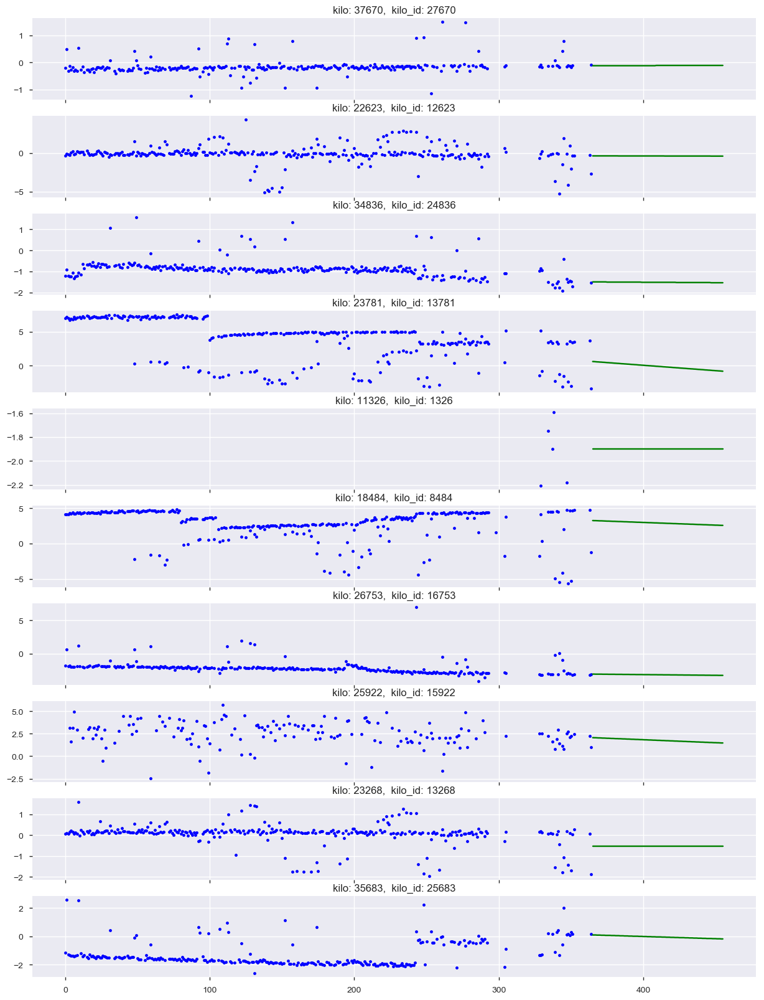

In [331]:
random.seed(0)

fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)

track = tracks['A']
#track = track.dropna(subset=['高低左'])
kilos = track['キロ程'].unique()
for i, kilo in enumerate(random.sample(list(kilos), 10)):
    data = track[track['キロ程'] == kilo]
    data = data.reset_index(drop=True)
    days = get_day(data['date'])
    axes[i].plot(days, data['高低左'], marker='.', linewidth=0, c='b')

    kilo_id = kilo - 10000
#    print(len(kilos))
    hoge = [kilo_id + i*len(kilos) for i in range(91)]
    piyo = submision.loc[hoge, 0]

    axes[i].plot(range(365, 365 + 91), piyo, c='g')

    axes[i].set_title(f'kilo: {kilo},  kilo_id: {kilo_id}')

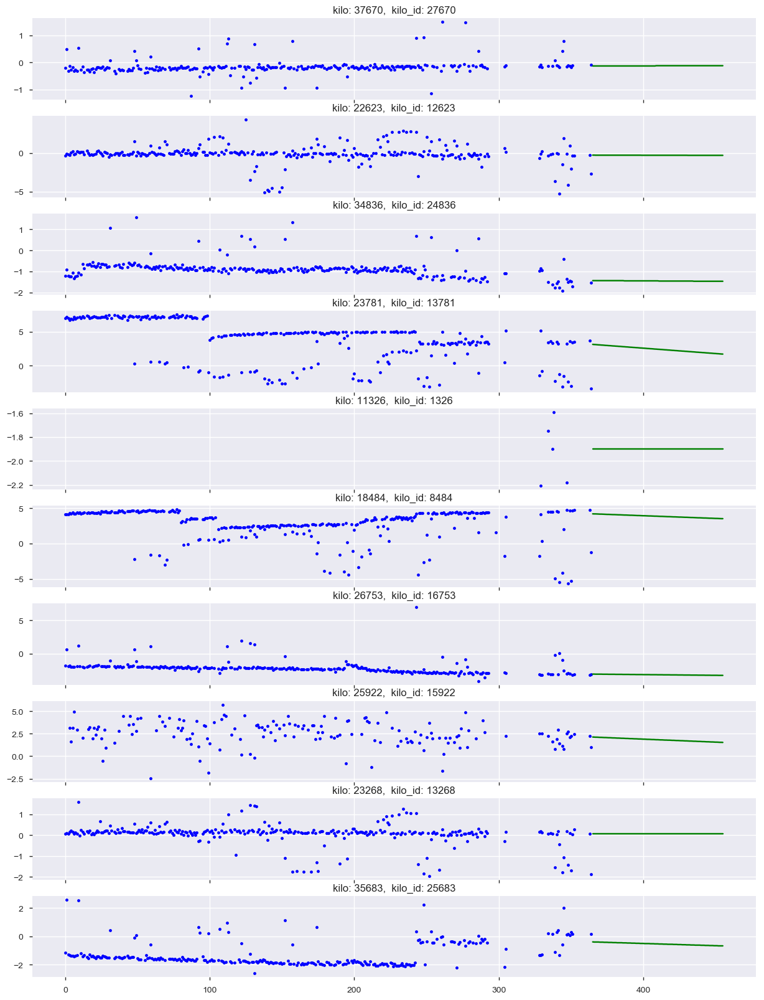

In [264]:
random.seed(0)

fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)

track = tracks['A']
#track = track.dropna(subset=['高低左'])
kilos = track['キロ程'].unique()
for i, kilo in enumerate(random.sample(list(kilos), 10)):
    data = track[track['キロ程'] == kilo]
    data = data.reset_index(drop=True)
    days = get_day(data['date'])
    axes[i].plot(days, data['高低左'], marker='.', linewidth=0, c='b')

    kilo_id = kilo - 10000
#    print(len(kilos))
    hoge = [kilo_id + i*len(kilos) for i in range(91)]
    piyo = submision.loc[hoge, 0]

    axes[i].plot(range(365, 365 + 91), piyo, c='g')

    axes[i].set_title(f'kilo: {kilo},  kilo_id: {kilo_id}')

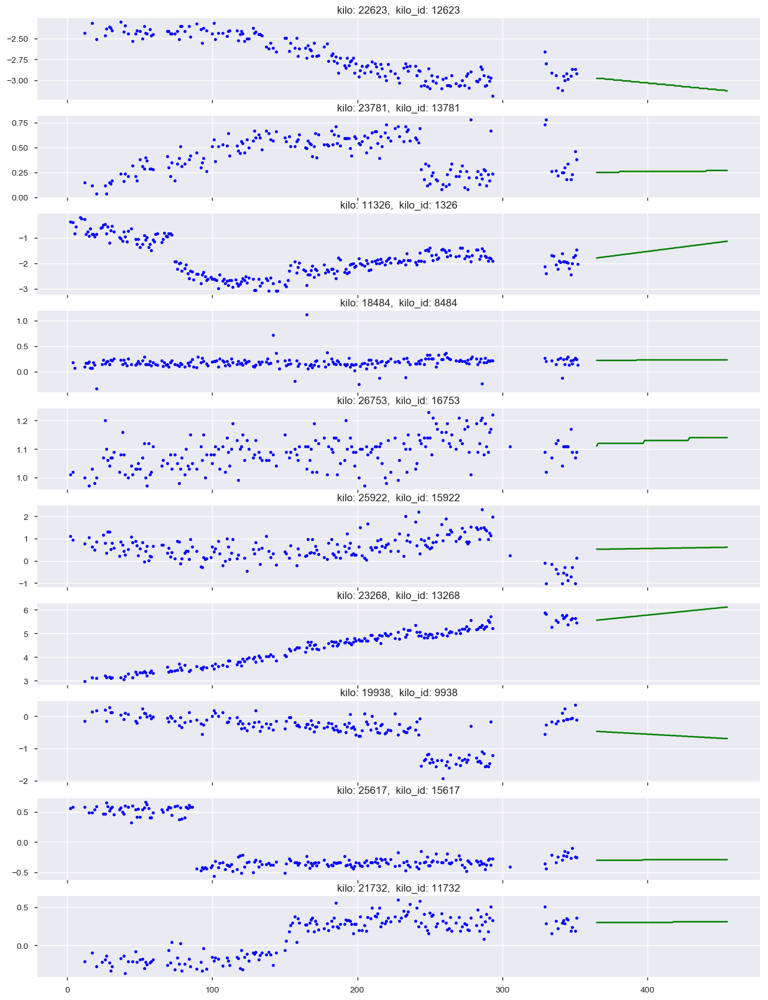

In [282]:
random.seed(0)

fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)

track = tracks['B']
kilos = track['キロ程'].unique()
for i, kilo in enumerate(random.sample(list(kilos), 10)):
    data = track[track['キロ程'] == kilo]
    data = data.reset_index(drop=True)
    days = get_day(data['date'])
    axes[i].plot(days, data['高低左'], marker='.', linewidth=0, c='b')

    kilo_id = kilo - 10000
    hoge = [kilo_id + i*len(kilos) for i in range(91)]
    hoge = np.array(hoge) + len(tracks['A']['キロ程'].unique())*91
    piyo = submision.loc[hoge, 0]

    axes[i].plot(range(365, 365 + 91), piyo, c='g')

    axes[i].set_title(f'kilo: {kilo},  kilo_id: {kilo_id}')

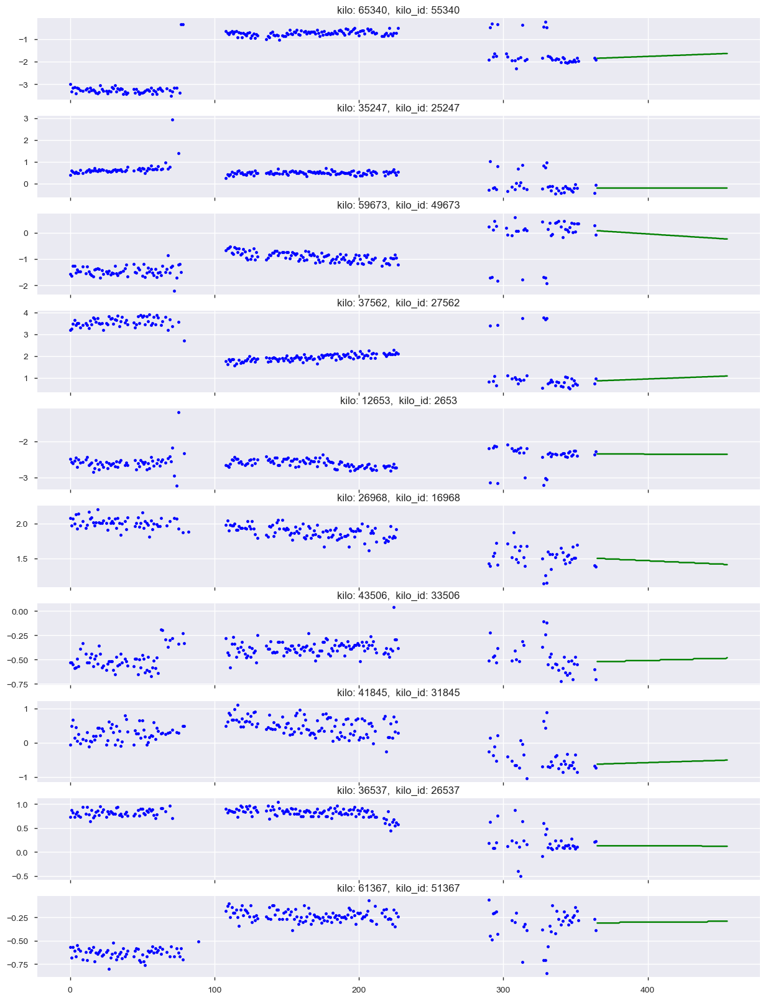

In [283]:
random.seed(0)

fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)

track = tracks['C']
kilos = track['キロ程'].unique()
for i, kilo in enumerate(random.sample(list(kilos), 10)):
    data = track[track['キロ程'] == kilo]
    data = data.reset_index(drop=True)
    days = get_day(data['date'])
    axes[i].plot(days, data['高低左'], marker='.', linewidth=0, c='b')

    kilo_id = kilo - 10000
    hoge = [kilo_id + i*len(kilos) for i in range(91)]
    hoge = np.array(hoge) + len(tracks['A']['キロ程'].unique())*91 + len(tracks['B']['キロ程'].unique())*91
    piyo = submision.loc[hoge, 0]

    axes[i].plot(range(365, 365 + 91), piyo, c='g')

    axes[i].set_title(f'kilo: {kilo},  kilo_id: {kilo_id}')

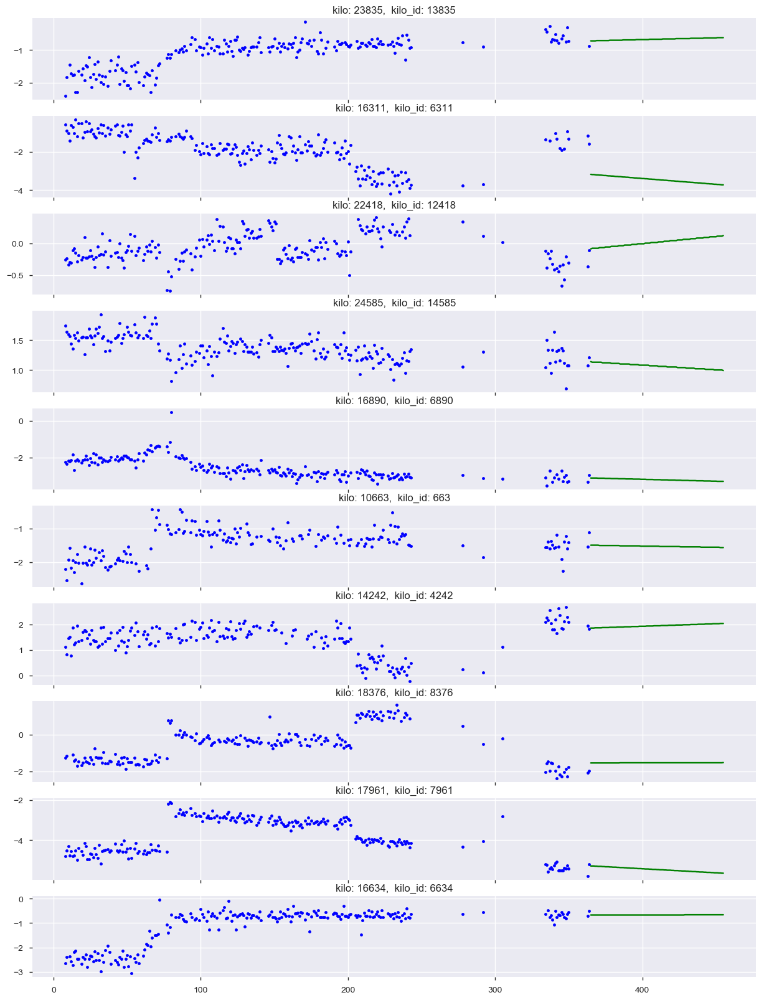

In [284]:
random.seed(0)

fig, axes = plt.subplots(10, 1, figsize=(15, 20), sharex=True)

track = tracks['D']
kilos = track['キロ程'].unique()
for i, kilo in enumerate(random.sample(list(kilos), 10)):
    data = track[track['キロ程'] == kilo]
    data = data.reset_index(drop=True)
    days = get_day(data['date'])
    axes[i].plot(days, data['高低左'], marker='.', linewidth=0, c='b')

    kilo_id = kilo - 10000
    hoge = [kilo_id + i*len(kilos) for i in range(91)]
    hoge = np.array(hoge) + len(tracks['A']['キロ程'].unique())*91 + len(tracks['B']['キロ程'].unique())*91 + len(tracks['C']['キロ程'].unique())*91
    piyo = submision.loc[hoge, 0]

    axes[i].plot(range(365, 365 + 91), piyo, c='g')

    axes[i].set_title(f'kilo: {kilo},  kilo_id: {kilo_id}')

In [332]:
submision.to_csv("submit3.csv", header=None)